# Face Generation
In this project, you'll use generative adversarial networks to generate new images of faces.
### Get the Data
You'll be using two datasets in this project:
- MNIST
- CelebA

Since the celebA dataset is complex and you're doing GANs in a project for the first time, we want you to test your neural network on MNIST before CelebA.  Running the GANs on MNIST will allow you to see how well your model trains sooner.

If you're using [FloydHub](https://www.floydhub.com/), set `data_dir` to "/input" and use the [FloydHub data ID](http://docs.floydhub.com/home/using_datasets/) "R5KrjnANiKVhLWAkpXhNBe".

In [1]:
data_dir = './data'

# FloydHub - Use with data ID "R5KrjnANiKVhLWAkpXhNBe"
#data_dir = '/input'


"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
import helper

helper.download_extract('mnist', data_dir)
helper.download_extract('celeba', data_dir)

Found mnist Data
Found celeba Data


## Explore the Data
### MNIST
As you're aware, the [MNIST](http://yann.lecun.com/exdb/mnist/) dataset contains images of handwritten digits. You can view the first number of examples by changing `show_n_images`. 

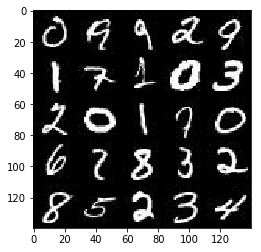

In [2]:
show_n_images = 25

"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
%matplotlib inline
import os
from glob import glob
from matplotlib import pyplot

mnist_images = helper.get_batch(glob(os.path.join(data_dir, 'mnist/*.jpg'))[:show_n_images], 28, 28, 'L')
pyplot.imshow(helper.images_square_grid(mnist_images, 'L'), cmap='gray')

### CelebA
The [CelebFaces Attributes Dataset (CelebA)](http://mmlab.ie.cuhk.edu.hk/projects/CelebA.html) dataset contains over 200,000 celebrity images with annotations.  Since you're going to be generating faces, you won't need the annotations.  You can view the first number of examples by changing `show_n_images`.

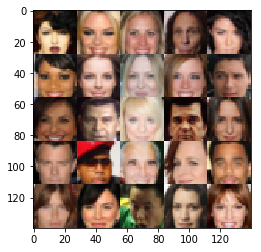

In [3]:
show_n_images = 25

"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
mnist_images = helper.get_batch(glob(os.path.join(data_dir, 'img_align_celeba/*.jpg'))[:show_n_images], 28, 28, 'RGB')
pyplot.imshow(helper.images_square_grid(mnist_images, 'RGB'))

## Preprocess the Data
Since the project's main focus is on building the GANs, we'll preprocess the data for you.  The values of the MNIST and CelebA dataset will be in the range of -0.5 to 0.5 of 28x28 dimensional images.  The CelebA images will be cropped to remove parts of the image that don't include a face, then resized down to 28x28.

The MNIST images are black and white images with a single [color channel](https://en.wikipedia.org/wiki/Channel_(digital_image%29) while the CelebA images have [3 color channels (RGB color channel)](https://en.wikipedia.org/wiki/Channel_(digital_image%29#RGB_Images).
## Build the Neural Network
You'll build the components necessary to build a GANs by implementing the following functions below:
- `model_inputs`
- `discriminator`
- `generator`
- `model_loss`
- `model_opt`
- `train`

### Check the Version of TensorFlow and Access to GPU
This will check to make sure you have the correct version of TensorFlow and access to a GPU

In [5]:
"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
from distutils.version import LooseVersion
import warnings
import tensorflow as tf

# Check TensorFlow Version
assert LooseVersion(tf.__version__) >= LooseVersion('1.0'), 'Please use TensorFlow version 1.0 or newer.  You are using {}'.format(tf.__version__)
print('TensorFlow Version: {}'.format(tf.__version__))

# Check for a GPU
if not tf.test.gpu_device_name():
    warnings.warn('No GPU found. Please use a GPU to train your neural network.')
else:
    print('Default GPU Device: {}'.format(tf.test.gpu_device_name()))

TensorFlow Version: 1.1.0
Default GPU Device: /gpu:0


### Input
Implement the `model_inputs` function to create TF Placeholders for the Neural Network. It should create the following placeholders:
- Real input images placeholder with rank 4 using `image_width`, `image_height`, and `image_channels`.
- Z input placeholder with rank 2 using `z_dim`.
- Learning rate placeholder with rank 0.

Return the placeholders in the following the tuple (tensor of real input images, tensor of z data)

In [6]:
import problem_unittests as tests

def model_inputs(image_width, image_height, image_channels, z_dim):
    """
    Create the model inputs
    :param image_width: The input image width
    :param image_height: The input image height
    :param image_channels: The number of image channels
    :param z_dim: The dimension of Z
    :return: Tuple of (tensor of real input images, tensor of z data, learning rate)
    """
    # TODO: Implement Function
    input_real = tf.placeholder(tf.float32, shape=(None, image_height, image_width, image_channels), name='input_real')
    input_z = tf.placeholder(tf.float32, shape=(None, z_dim), name='input_z')
    lr = tf.placeholder(tf.float32, name = 'learning_rate')
    return input_real, input_z, lr

"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_inputs(model_inputs)

Tests Passed


### Discriminator
Implement `discriminator` to create a discriminator neural network that discriminates on `images`.  This function should be able to reuse the variables in the neural network.  Use [`tf.variable_scope`](https://www.tensorflow.org/api_docs/python/tf/variable_scope) with a scope name of "discriminator" to allow the variables to be reused.  The function should return a tuple of (tensor output of the discriminator, tensor logits of the discriminator).

In [7]:
def discriminator(images, reuse=False):
    """
    Create the discriminator network
    :param images: Tensor of input image(s)
    :param reuse: Boolean if the weights should be reused
    :return: Tuple of (tensor output of the discriminator, tensor logits of the discriminator)
    """
    alpha = 0.2
    with tf.variable_scope('discriminator', reuse=reuse):
        x1 = tf.layers.conv2d(images, 64, 5, strides=2, padding='same')
        relu1 = tf.maximum(alpha * x1, x1) 
        
        x2 = tf.layers.conv2d(relu1, 128, 5, strides=2, padding='same')
        bn2 = tf.layers.batch_normalization(x2, training=True)
        relu2 = tf.maximum(alpha * bn2, bn2)
        
        x3 = tf.layers.conv2d(relu2, 256, 5, strides=2, padding='same')
        bn3 = tf.layers.batch_normalization(x3, training=True)
        relu3 = tf.maximum(alpha * bn3, bn3)
        
        # Flatten it
        relu3_shape = relu3.get_shape().as_list()
        flat = tf.reshape(relu3, (-1, relu3_shape[1] * relu3_shape[2] * relu3_shape[3]))
        logits = tf.layers.dense(flat, 1)
        out = tf.sigmoid(logits)
        
        return out, logits

"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_discriminator(discriminator, tf)

Tests Passed


### Generator
Implement `generator` to generate an image using `z`. This function should be able to reuse the variables in the neural network.  Use [`tf.variable_scope`](https://www.tensorflow.org/api_docs/python/tf/variable_scope) with a scope name of "generator" to allow the variables to be reused. The function should return the generated 28 x 28 x `out_channel_dim` images.

In [9]:
def generator(z, out_channel_dim, is_train=True):
    """
    Create the generator network
    :param z: Input z
    :param out_channel_dim: The number of channels in the output image
    :param is_train: Boolean if generator is being used for training
    :return: The tensor output of the generator
    """
    alpha = 0.2
    with tf.variable_scope('generator', reuse=not is_train):
        # First fully connected layer
        x1 = tf.layers.dense(z, 7*7*256)
        # Reshape it to start the convolutional stack
        x1 = tf.reshape(x1, (-1, 7, 7, 256))
        x1 = tf.layers.batch_normalization(x1, training=is_train)
        x1 = tf.maximum(alpha * x1, x1)
        # 7x7x256 now
        
        x2 = tf.layers.conv2d_transpose(x1, 128, 5, strides=2, padding='same')
        x2 = tf.layers.batch_normalization(x2, training=is_train)
        x2 = tf.maximum(alpha * x2, x2)
        # 14x14x128 now
        
        # Output layer
        logits = tf.layers.conv2d_transpose(x2, out_channel_dim, 5, strides=2, padding='same')
        # 28x28xoutput_channel_dim now
        
        out = tf.tanh(logits) * 0.5
        
        return out


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_generator(generator, tf)

Tests Passed


### Loss
Implement `model_loss` to build the GANs for training and calculate the loss.  The function should return a tuple of (discriminator loss, generator loss).  Use the following functions you implemented:
- `discriminator(images, reuse=False)`
- `generator(z, out_channel_dim, is_train=True)`

In [10]:
def model_loss(input_real, input_z, out_channel_dim):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, out_channel_dim)
    d_model_real, d_logits_real = discriminator(input_real)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_loss(model_loss)

Tests Passed


### Optimization
Implement `model_opt` to create the optimization operations for the GANs. Use [`tf.trainable_variables`](https://www.tensorflow.org/api_docs/python/tf/trainable_variables) to get all the trainable variables.  Filter the variables with names that are in the discriminator and generator scope names.  The function should return a tuple of (discriminator training operation, generator training operation).

In [11]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_opt(model_opt, tf)

Tests Passed


## Neural Network Training
### Show Output
Use this function to show the current output of the generator during training. It will help you determine how well the GANs is training.

In [12]:
"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
import numpy as np

def show_generator_output(sess, n_images, input_z, out_channel_dim, image_mode):
    """
    Show example output for the generator
    :param sess: TensorFlow session
    :param n_images: Number of Images to display
    :param input_z: Input Z Tensor
    :param out_channel_dim: The number of channels in the output image
    :param image_mode: The mode to use for images ("RGB" or "L")
    """
    cmap = None if image_mode == 'RGB' else 'gray'
    z_dim = input_z.get_shape().as_list()[-1]
    example_z = np.random.uniform(-1, 1, size=[n_images, z_dim])

    samples = sess.run(
        generator(input_z, out_channel_dim, False),
        feed_dict={input_z: example_z})

    images_grid = helper.images_square_grid(samples, image_mode)
    pyplot.imshow(images_grid, cmap=cmap)
    pyplot.show()

### Train
Implement `train` to build and train the GANs.  Use the following functions you implemented:
- `model_inputs(image_width, image_height, image_channels, z_dim)`
- `model_loss(input_real, input_z, out_channel_dim)`
- `model_opt(d_loss, g_loss, learning_rate, beta1)`

Use the `show_generator_output` to show `generator` output while you train. Running `show_generator_output` for every batch will drastically increase training time and increase the size of the notebook.  It's recommended to print the `generator` output every 100 batches.

In [13]:
def train(epoch_count, batch_size, z_dim, learning_rate, beta1, get_batches, data_shape, data_image_mode):
    """
    Train the GAN
    :param epoch_count: Number of epochs
    :param batch_size: Batch Size
    :param z_dim: Z dimension
    :param learning_rate: Learning Rate
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :param get_batches: Function to get batches
    :param data_shape: Shape of the data
    :param data_image_mode: The image mode to use for images ("RGB" or "L")
    """
    # TODO: Build Model
    image_height = data_shape[1]
    image_width = data_shape[2]
    image_channels = data_shape[3]
    input_real, input_z, lr = model_inputs(image_width, image_height, image_channels, z_dim)
    d_loss, g_loss = model_loss(input_real, input_z, image_channels)
    d_opt, g_opt = model_opt(d_loss, g_loss, lr, beta1)
    
    steps = 0
    print_every = 10
    show_every = 100
    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for epoch_i in range(epoch_count):
            for batch_images in get_batches(batch_size):
                steps += 1
                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_dim))

                # Run optimizers
                _ = sess.run(d_opt, feed_dict={input_real: batch_images, input_z: batch_z, lr: learning_rate})
                _ = sess.run(g_opt, feed_dict={input_z: batch_z, input_real: batch_images, lr: learning_rate})
                
                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = d_loss.eval({input_z: batch_z, input_real: batch_images})
                    train_loss_g = g_loss.eval({input_z: batch_z})

                    print("Epoch {}/{}...".format(epoch_i+1, epoch_count),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))

                if steps % show_every == 0:
                    show_generator_output(sess, 16, input_z, image_channels, data_image_mode)

### MNIST
Test your GANs architecture on MNIST.  After 2 epochs, the GANs should be able to generate images that look like handwritten digits.  Make sure the loss of the generator is lower than the loss of the discriminator or close to 0.

Epoch 1/25... Discriminator Loss: 0.3943... Generator Loss: 1.7889
Epoch 1/25... Discriminator Loss: 1.1163... Generator Loss: 0.7544
Epoch 1/25... Discriminator Loss: 0.9047... Generator Loss: 0.8782
Epoch 1/25... Discriminator Loss: 0.9375... Generator Loss: 0.8695
Epoch 1/25... Discriminator Loss: 0.4683... Generator Loss: 2.2254
Epoch 1/25... Discriminator Loss: 1.1759... Generator Loss: 0.5307
Epoch 1/25... Discriminator Loss: 0.9147... Generator Loss: 2.4810
Epoch 1/25... Discriminator Loss: 0.7874... Generator Loss: 1.5141
Epoch 1/25... Discriminator Loss: 0.7497... Generator Loss: 1.0280
Epoch 1/25... Discriminator Loss: 1.0926... Generator Loss: 2.7762


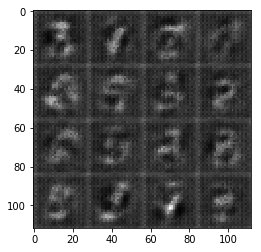

Epoch 1/25... Discriminator Loss: 0.7072... Generator Loss: 1.6795
Epoch 1/25... Discriminator Loss: 0.6742... Generator Loss: 1.2029
Epoch 1/25... Discriminator Loss: 1.1069... Generator Loss: 0.5473
Epoch 1/25... Discriminator Loss: 0.9921... Generator Loss: 2.8227
Epoch 1/25... Discriminator Loss: 0.6826... Generator Loss: 1.9244
Epoch 1/25... Discriminator Loss: 0.5735... Generator Loss: 1.5094
Epoch 1/25... Discriminator Loss: 0.8795... Generator Loss: 0.7172
Epoch 1/25... Discriminator Loss: 0.9383... Generator Loss: 0.6429
Epoch 1/25... Discriminator Loss: 0.6273... Generator Loss: 1.2429
Epoch 1/25... Discriminator Loss: 0.5814... Generator Loss: 1.6497


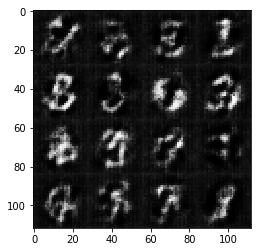

Epoch 1/25... Discriminator Loss: 0.6091... Generator Loss: 1.1137
Epoch 1/25... Discriminator Loss: 0.6191... Generator Loss: 1.7619
Epoch 1/25... Discriminator Loss: 0.6683... Generator Loss: 2.6647
Epoch 1/25... Discriminator Loss: 0.5395... Generator Loss: 1.1531
Epoch 1/25... Discriminator Loss: 0.4941... Generator Loss: 1.6899
Epoch 1/25... Discriminator Loss: 0.5182... Generator Loss: 2.2555
Epoch 1/25... Discriminator Loss: 0.5148... Generator Loss: 2.7495
Epoch 1/25... Discriminator Loss: 0.8821... Generator Loss: 0.6524
Epoch 1/25... Discriminator Loss: 0.4255... Generator Loss: 1.6988
Epoch 1/25... Discriminator Loss: 0.8698... Generator Loss: 0.6913


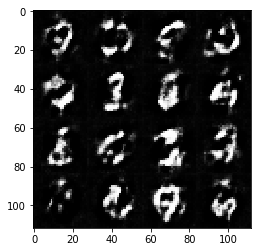

Epoch 1/25... Discriminator Loss: 0.3663... Generator Loss: 1.9280
Epoch 1/25... Discriminator Loss: 0.4391... Generator Loss: 2.9298
Epoch 1/25... Discriminator Loss: 0.3815... Generator Loss: 1.7967
Epoch 1/25... Discriminator Loss: 0.4775... Generator Loss: 1.4025
Epoch 1/25... Discriminator Loss: 0.3799... Generator Loss: 2.4995
Epoch 1/25... Discriminator Loss: 0.4515... Generator Loss: 1.3989
Epoch 1/25... Discriminator Loss: 0.3731... Generator Loss: 1.7814
Epoch 1/25... Discriminator Loss: 0.5261... Generator Loss: 1.2066
Epoch 1/25... Discriminator Loss: 0.4396... Generator Loss: 2.7773
Epoch 1/25... Discriminator Loss: 0.3140... Generator Loss: 1.8194


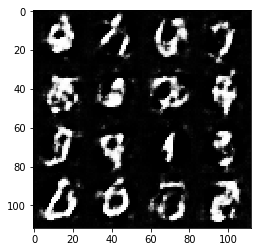

Epoch 1/25... Discriminator Loss: 0.5799... Generator Loss: 3.1307
Epoch 1/25... Discriminator Loss: 0.4911... Generator Loss: 1.2923
Epoch 1/25... Discriminator Loss: 0.3332... Generator Loss: 2.4736
Epoch 1/25... Discriminator Loss: 1.0068... Generator Loss: 3.8734
Epoch 1/25... Discriminator Loss: 0.3940... Generator Loss: 1.8086
Epoch 1/25... Discriminator Loss: 0.4262... Generator Loss: 2.4882
Epoch 2/25... Discriminator Loss: 0.3480... Generator Loss: 1.9827
Epoch 2/25... Discriminator Loss: 0.3534... Generator Loss: 2.0258
Epoch 2/25... Discriminator Loss: 0.6379... Generator Loss: 1.0529
Epoch 2/25... Discriminator Loss: 1.6272... Generator Loss: 4.9524


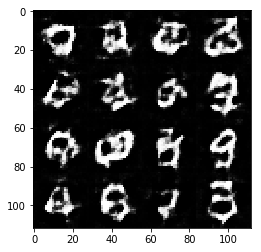

Epoch 2/25... Discriminator Loss: 0.4149... Generator Loss: 1.7192
Epoch 2/25... Discriminator Loss: 0.4071... Generator Loss: 2.5706
Epoch 2/25... Discriminator Loss: 0.4613... Generator Loss: 2.4818
Epoch 2/25... Discriminator Loss: 0.8566... Generator Loss: 0.7237
Epoch 2/25... Discriminator Loss: 0.5410... Generator Loss: 1.2212
Epoch 2/25... Discriminator Loss: 0.6087... Generator Loss: 1.0733
Epoch 2/25... Discriminator Loss: 0.4815... Generator Loss: 1.6083
Epoch 2/25... Discriminator Loss: 0.4215... Generator Loss: 1.5381
Epoch 2/25... Discriminator Loss: 0.5301... Generator Loss: 1.3103
Epoch 2/25... Discriminator Loss: 0.5567... Generator Loss: 1.6369


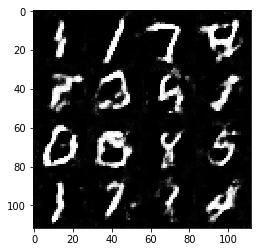

Epoch 2/25... Discriminator Loss: 0.4419... Generator Loss: 2.3104
Epoch 2/25... Discriminator Loss: 0.7554... Generator Loss: 2.8265
Epoch 2/25... Discriminator Loss: 0.5052... Generator Loss: 1.4301
Epoch 2/25... Discriminator Loss: 0.4942... Generator Loss: 1.3055
Epoch 2/25... Discriminator Loss: 0.7605... Generator Loss: 0.7982
Epoch 2/25... Discriminator Loss: 0.5526... Generator Loss: 1.3678
Epoch 2/25... Discriminator Loss: 0.4947... Generator Loss: 1.9844
Epoch 2/25... Discriminator Loss: 0.5323... Generator Loss: 1.2527
Epoch 2/25... Discriminator Loss: 0.6879... Generator Loss: 0.9419
Epoch 2/25... Discriminator Loss: 0.5625... Generator Loss: 1.1949


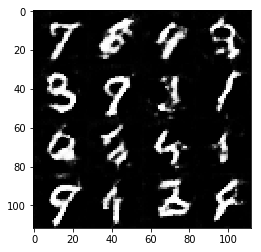

Epoch 2/25... Discriminator Loss: 0.5006... Generator Loss: 1.3341
Epoch 2/25... Discriminator Loss: 1.0329... Generator Loss: 0.5968
Epoch 2/25... Discriminator Loss: 0.4505... Generator Loss: 1.4407
Epoch 2/25... Discriminator Loss: 0.4448... Generator Loss: 2.2443
Epoch 2/25... Discriminator Loss: 1.2416... Generator Loss: 0.4762
Epoch 2/25... Discriminator Loss: 0.4687... Generator Loss: 2.0821
Epoch 2/25... Discriminator Loss: 0.5100... Generator Loss: 1.2817
Epoch 2/25... Discriminator Loss: 0.5598... Generator Loss: 2.7556
Epoch 2/25... Discriminator Loss: 1.1681... Generator Loss: 2.2152
Epoch 2/25... Discriminator Loss: 0.5462... Generator Loss: 1.2752


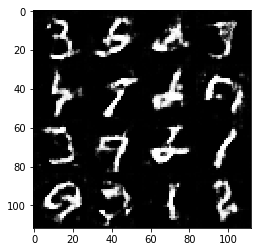

Epoch 2/25... Discriminator Loss: 0.5592... Generator Loss: 1.1562
Epoch 2/25... Discriminator Loss: 0.5374... Generator Loss: 1.3394
Epoch 2/25... Discriminator Loss: 0.4235... Generator Loss: 1.5773
Epoch 2/25... Discriminator Loss: 0.4443... Generator Loss: 1.6650
Epoch 2/25... Discriminator Loss: 0.4939... Generator Loss: 1.2119
Epoch 2/25... Discriminator Loss: 0.4277... Generator Loss: 1.5550
Epoch 2/25... Discriminator Loss: 1.1621... Generator Loss: 0.4982
Epoch 2/25... Discriminator Loss: 0.4808... Generator Loss: 1.6837
Epoch 2/25... Discriminator Loss: 0.3987... Generator Loss: 1.8622
Epoch 2/25... Discriminator Loss: 0.5240... Generator Loss: 1.2254


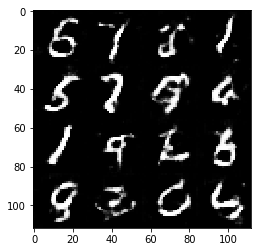

Epoch 2/25... Discriminator Loss: 0.5851... Generator Loss: 1.0603
Epoch 2/25... Discriminator Loss: 0.3901... Generator Loss: 1.6093
Epoch 2/25... Discriminator Loss: 0.3789... Generator Loss: 1.6677
Epoch 3/25... Discriminator Loss: 0.3481... Generator Loss: 1.9135
Epoch 3/25... Discriminator Loss: 0.4604... Generator Loss: 1.7257
Epoch 3/25... Discriminator Loss: 0.4345... Generator Loss: 1.4593
Epoch 3/25... Discriminator Loss: 0.3829... Generator Loss: 1.7678
Epoch 3/25... Discriminator Loss: 0.4968... Generator Loss: 1.2638
Epoch 3/25... Discriminator Loss: 1.7179... Generator Loss: 4.1864
Epoch 3/25... Discriminator Loss: 0.6766... Generator Loss: 1.6267


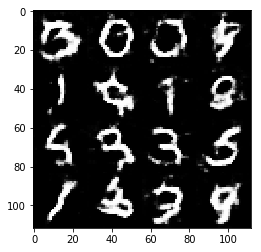

Epoch 3/25... Discriminator Loss: 0.5303... Generator Loss: 1.2440
Epoch 3/25... Discriminator Loss: 0.3927... Generator Loss: 1.5911
Epoch 3/25... Discriminator Loss: 0.3517... Generator Loss: 1.8776
Epoch 3/25... Discriminator Loss: 0.3721... Generator Loss: 1.6044
Epoch 3/25... Discriminator Loss: 0.3357... Generator Loss: 1.7387
Epoch 3/25... Discriminator Loss: 0.3705... Generator Loss: 1.7194
Epoch 3/25... Discriminator Loss: 0.3722... Generator Loss: 1.5335
Epoch 3/25... Discriminator Loss: 0.4822... Generator Loss: 1.2710
Epoch 3/25... Discriminator Loss: 0.5242... Generator Loss: 1.1384
Epoch 3/25... Discriminator Loss: 0.3744... Generator Loss: 1.5527


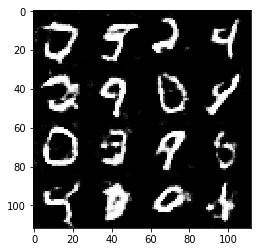

Epoch 3/25... Discriminator Loss: 0.3409... Generator Loss: 2.0401
Epoch 3/25... Discriminator Loss: 0.3606... Generator Loss: 1.6665
Epoch 3/25... Discriminator Loss: 0.3448... Generator Loss: 1.6444
Epoch 3/25... Discriminator Loss: 0.4187... Generator Loss: 1.4129
Epoch 3/25... Discriminator Loss: 0.5440... Generator Loss: 1.1047
Epoch 3/25... Discriminator Loss: 0.3692... Generator Loss: 1.5958
Epoch 3/25... Discriminator Loss: 1.9320... Generator Loss: 2.7732
Epoch 3/25... Discriminator Loss: 0.7894... Generator Loss: 1.3847
Epoch 3/25... Discriminator Loss: 0.4720... Generator Loss: 1.7502
Epoch 3/25... Discriminator Loss: 0.5245... Generator Loss: 1.2366


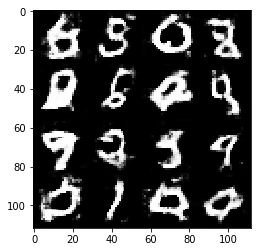

Epoch 3/25... Discriminator Loss: 0.5131... Generator Loss: 1.2411
Epoch 3/25... Discriminator Loss: 0.4220... Generator Loss: 1.5485
Epoch 3/25... Discriminator Loss: 0.4583... Generator Loss: 1.4197
Epoch 3/25... Discriminator Loss: 0.3932... Generator Loss: 1.5647
Epoch 3/25... Discriminator Loss: 0.3962... Generator Loss: 1.7545
Epoch 3/25... Discriminator Loss: 0.3417... Generator Loss: 1.7603
Epoch 3/25... Discriminator Loss: 0.4186... Generator Loss: 1.4972
Epoch 3/25... Discriminator Loss: 0.4149... Generator Loss: 1.5900
Epoch 3/25... Discriminator Loss: 0.5229... Generator Loss: 1.1871
Epoch 3/25... Discriminator Loss: 0.3557... Generator Loss: 1.9341


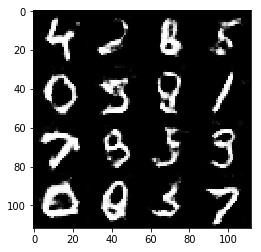

Epoch 3/25... Discriminator Loss: 1.6606... Generator Loss: 4.1906
Epoch 3/25... Discriminator Loss: 1.2686... Generator Loss: 0.4441
Epoch 3/25... Discriminator Loss: 1.2124... Generator Loss: 0.4820
Epoch 3/25... Discriminator Loss: 0.7821... Generator Loss: 2.4077
Epoch 3/25... Discriminator Loss: 0.7760... Generator Loss: 2.3861
Epoch 3/25... Discriminator Loss: 0.7848... Generator Loss: 0.8031
Epoch 3/25... Discriminator Loss: 0.4441... Generator Loss: 1.4172
Epoch 3/25... Discriminator Loss: 0.4819... Generator Loss: 1.3697
Epoch 3/25... Discriminator Loss: 0.4749... Generator Loss: 1.2863
Epoch 3/25... Discriminator Loss: 0.3202... Generator Loss: 1.8115


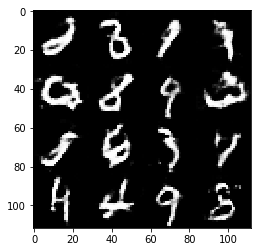

Epoch 4/25... Discriminator Loss: 0.6420... Generator Loss: 4.0512
Epoch 4/25... Discriminator Loss: 0.2559... Generator Loss: 2.1172
Epoch 4/25... Discriminator Loss: 0.4252... Generator Loss: 1.5930
Epoch 4/25... Discriminator Loss: 0.3877... Generator Loss: 1.5065
Epoch 4/25... Discriminator Loss: 0.4885... Generator Loss: 1.2851
Epoch 4/25... Discriminator Loss: 0.3778... Generator Loss: 1.6186
Epoch 4/25... Discriminator Loss: 0.3103... Generator Loss: 2.0641
Epoch 4/25... Discriminator Loss: 0.4755... Generator Loss: 1.4777
Epoch 4/25... Discriminator Loss: 0.4955... Generator Loss: 1.2040
Epoch 4/25... Discriminator Loss: 0.3428... Generator Loss: 1.7403


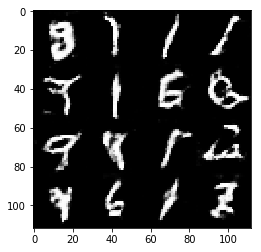

Epoch 4/25... Discriminator Loss: 0.3577... Generator Loss: 1.5508
Epoch 4/25... Discriminator Loss: 0.9174... Generator Loss: 0.6779
Epoch 4/25... Discriminator Loss: 5.7092... Generator Loss: 0.0077
Epoch 4/25... Discriminator Loss: 0.9497... Generator Loss: 0.8213
Epoch 4/25... Discriminator Loss: 0.8443... Generator Loss: 0.8655
Epoch 4/25... Discriminator Loss: 0.7059... Generator Loss: 1.0744
Epoch 4/25... Discriminator Loss: 0.4800... Generator Loss: 1.8861
Epoch 4/25... Discriminator Loss: 0.5237... Generator Loss: 1.2513
Epoch 4/25... Discriminator Loss: 0.4587... Generator Loss: 1.3405
Epoch 4/25... Discriminator Loss: 0.4707... Generator Loss: 1.3672


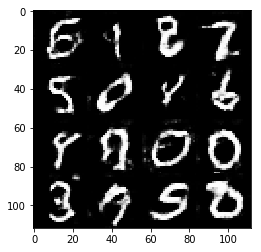

Epoch 4/25... Discriminator Loss: 0.5127... Generator Loss: 1.2351
Epoch 4/25... Discriminator Loss: 0.3647... Generator Loss: 1.7699
Epoch 4/25... Discriminator Loss: 0.3609... Generator Loss: 1.6458
Epoch 4/25... Discriminator Loss: 0.4705... Generator Loss: 1.3345
Epoch 4/25... Discriminator Loss: 0.5591... Generator Loss: 1.1487
Epoch 4/25... Discriminator Loss: 0.3426... Generator Loss: 1.7035
Epoch 4/25... Discriminator Loss: 0.4120... Generator Loss: 1.4750
Epoch 4/25... Discriminator Loss: 0.3975... Generator Loss: 1.4610
Epoch 4/25... Discriminator Loss: 0.3086... Generator Loss: 2.0053
Epoch 4/25... Discriminator Loss: 0.3442... Generator Loss: 1.7581


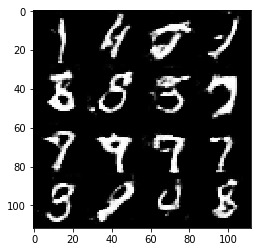

Epoch 4/25... Discriminator Loss: 0.2937... Generator Loss: 1.9301
Epoch 4/25... Discriminator Loss: 0.3616... Generator Loss: 1.5383
Epoch 4/25... Discriminator Loss: 1.5567... Generator Loss: 2.6870
Epoch 4/25... Discriminator Loss: 1.1719... Generator Loss: 0.5265
Epoch 4/25... Discriminator Loss: 0.7782... Generator Loss: 1.5769
Epoch 4/25... Discriminator Loss: 0.9727... Generator Loss: 0.6549
Epoch 4/25... Discriminator Loss: 0.6491... Generator Loss: 1.3675
Epoch 4/25... Discriminator Loss: 1.2705... Generator Loss: 3.7199
Epoch 4/25... Discriminator Loss: 0.4287... Generator Loss: 2.1091
Epoch 4/25... Discriminator Loss: 0.6210... Generator Loss: 1.0840


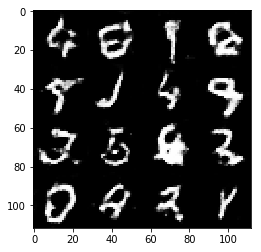

Epoch 4/25... Discriminator Loss: 0.3956... Generator Loss: 2.0489
Epoch 4/25... Discriminator Loss: 0.3643... Generator Loss: 1.6793
Epoch 4/25... Discriminator Loss: 0.3821... Generator Loss: 2.5497
Epoch 4/25... Discriminator Loss: 0.3113... Generator Loss: 1.8013
Epoch 4/25... Discriminator Loss: 0.3207... Generator Loss: 1.6873
Epoch 4/25... Discriminator Loss: 0.3182... Generator Loss: 1.8006
Epoch 4/25... Discriminator Loss: 0.8676... Generator Loss: 0.7313
Epoch 5/25... Discriminator Loss: 0.5159... Generator Loss: 1.2500
Epoch 5/25... Discriminator Loss: 0.3270... Generator Loss: 1.7028
Epoch 5/25... Discriminator Loss: 0.5325... Generator Loss: 1.1568


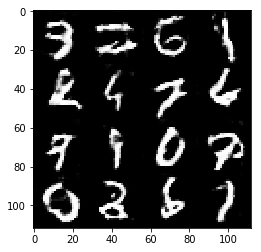

Epoch 5/25... Discriminator Loss: 0.6215... Generator Loss: 0.9984
Epoch 5/25... Discriminator Loss: 0.4000... Generator Loss: 1.5392
Epoch 5/25... Discriminator Loss: 0.5290... Generator Loss: 1.2231
Epoch 5/25... Discriminator Loss: 0.5612... Generator Loss: 1.1004
Epoch 5/25... Discriminator Loss: 0.2989... Generator Loss: 1.8030
Epoch 5/25... Discriminator Loss: 1.4023... Generator Loss: 3.7112
Epoch 5/25... Discriminator Loss: 0.5205... Generator Loss: 1.3887
Epoch 5/25... Discriminator Loss: 0.5535... Generator Loss: 1.1480
Epoch 5/25... Discriminator Loss: 0.4874... Generator Loss: 1.3145
Epoch 5/25... Discriminator Loss: 0.3202... Generator Loss: 1.7304


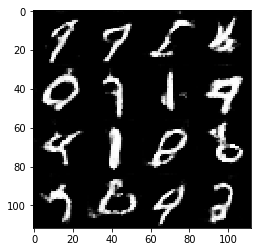

Epoch 5/25... Discriminator Loss: 0.5742... Generator Loss: 1.1028
Epoch 5/25... Discriminator Loss: 0.3487... Generator Loss: 1.6052
Epoch 5/25... Discriminator Loss: 0.4628... Generator Loss: 1.2606
Epoch 5/25... Discriminator Loss: 0.9213... Generator Loss: 0.7047
Epoch 5/25... Discriminator Loss: 0.4039... Generator Loss: 1.4825
Epoch 5/25... Discriminator Loss: 0.4757... Generator Loss: 1.2759
Epoch 5/25... Discriminator Loss: 0.3504... Generator Loss: 1.5325
Epoch 5/25... Discriminator Loss: 0.4557... Generator Loss: 1.3107
Epoch 5/25... Discriminator Loss: 0.3538... Generator Loss: 1.7681
Epoch 5/25... Discriminator Loss: 0.4155... Generator Loss: 1.5151


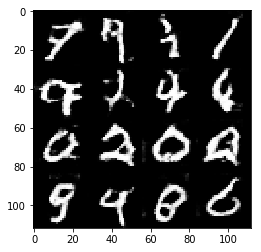

Epoch 5/25... Discriminator Loss: 1.1860... Generator Loss: 4.1782
Epoch 5/25... Discriminator Loss: 1.0611... Generator Loss: 1.2705
Epoch 5/25... Discriminator Loss: 0.8499... Generator Loss: 2.0774
Epoch 5/25... Discriminator Loss: 1.0440... Generator Loss: 0.6276
Epoch 5/25... Discriminator Loss: 0.5493... Generator Loss: 1.2569
Epoch 5/25... Discriminator Loss: 0.5225... Generator Loss: 2.1983
Epoch 5/25... Discriminator Loss: 0.8814... Generator Loss: 0.8523
Epoch 5/25... Discriminator Loss: 0.3232... Generator Loss: 1.9602
Epoch 5/25... Discriminator Loss: 0.3073... Generator Loss: 1.7732
Epoch 5/25... Discriminator Loss: 0.4051... Generator Loss: 1.5327


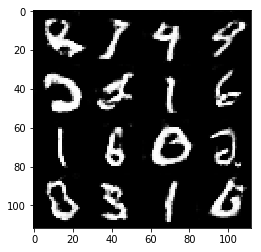

Epoch 5/25... Discriminator Loss: 0.4060... Generator Loss: 1.6055
Epoch 5/25... Discriminator Loss: 0.3540... Generator Loss: 1.8556
Epoch 5/25... Discriminator Loss: 0.2923... Generator Loss: 1.9649
Epoch 5/25... Discriminator Loss: 0.4487... Generator Loss: 1.3102
Epoch 5/25... Discriminator Loss: 0.3005... Generator Loss: 1.7843
Epoch 5/25... Discriminator Loss: 0.5143... Generator Loss: 1.2015
Epoch 5/25... Discriminator Loss: 0.5187... Generator Loss: 1.1878
Epoch 5/25... Discriminator Loss: 0.7543... Generator Loss: 2.1175
Epoch 5/25... Discriminator Loss: 0.3758... Generator Loss: 2.0399
Epoch 5/25... Discriminator Loss: 0.3839... Generator Loss: 1.5149


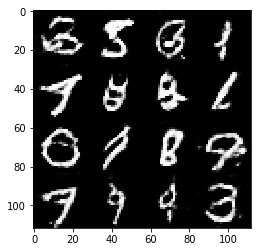

Epoch 5/25... Discriminator Loss: 0.2324... Generator Loss: 2.1322
Epoch 5/25... Discriminator Loss: 0.4818... Generator Loss: 1.3185
Epoch 5/25... Discriminator Loss: 0.4116... Generator Loss: 1.5261
Epoch 5/25... Discriminator Loss: 0.5254... Generator Loss: 1.2598
Epoch 6/25... Discriminator Loss: 0.3958... Generator Loss: 3.4119
Epoch 6/25... Discriminator Loss: 0.3903... Generator Loss: 1.4978
Epoch 6/25... Discriminator Loss: 0.4459... Generator Loss: 1.3805
Epoch 6/25... Discriminator Loss: 0.3013... Generator Loss: 1.7496
Epoch 6/25... Discriminator Loss: 0.3791... Generator Loss: 1.5462
Epoch 6/25... Discriminator Loss: 0.2013... Generator Loss: 2.4481


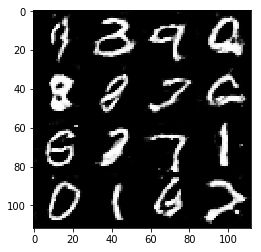

Epoch 6/25... Discriminator Loss: 0.5967... Generator Loss: 1.0813
Epoch 6/25... Discriminator Loss: 0.3632... Generator Loss: 1.5087
Epoch 6/25... Discriminator Loss: 0.4011... Generator Loss: 1.4446
Epoch 6/25... Discriminator Loss: 0.3191... Generator Loss: 1.8135
Epoch 6/25... Discriminator Loss: 0.3636... Generator Loss: 1.6440
Epoch 6/25... Discriminator Loss: 0.5409... Generator Loss: 1.1870
Epoch 6/25... Discriminator Loss: 0.3321... Generator Loss: 1.7367
Epoch 6/25... Discriminator Loss: 0.4313... Generator Loss: 1.4398
Epoch 6/25... Discriminator Loss: 0.4574... Generator Loss: 1.2746
Epoch 6/25... Discriminator Loss: 0.3004... Generator Loss: 1.8265


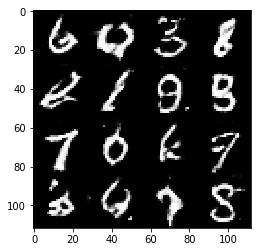

Epoch 6/25... Discriminator Loss: 1.9399... Generator Loss: 0.3124
Epoch 6/25... Discriminator Loss: 0.6323... Generator Loss: 1.2232
Epoch 6/25... Discriminator Loss: 0.3972... Generator Loss: 1.9023
Epoch 6/25... Discriminator Loss: 0.4195... Generator Loss: 2.0769
Epoch 6/25... Discriminator Loss: 0.4086... Generator Loss: 1.3671
Epoch 6/25... Discriminator Loss: 0.3453... Generator Loss: 1.6668
Epoch 6/25... Discriminator Loss: 0.4176... Generator Loss: 1.4418
Epoch 6/25... Discriminator Loss: 0.4503... Generator Loss: 1.3943
Epoch 6/25... Discriminator Loss: 0.5539... Generator Loss: 1.1896
Epoch 6/25... Discriminator Loss: 0.5900... Generator Loss: 1.1169


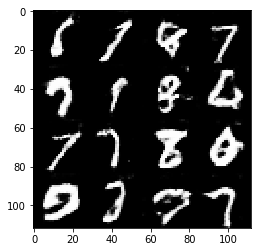

Epoch 6/25... Discriminator Loss: 0.3733... Generator Loss: 1.6004
Epoch 6/25... Discriminator Loss: 0.5063... Generator Loss: 1.1785
Epoch 6/25... Discriminator Loss: 0.5516... Generator Loss: 1.1697
Epoch 6/25... Discriminator Loss: 0.3617... Generator Loss: 1.6521
Epoch 6/25... Discriminator Loss: 0.2635... Generator Loss: 1.9422
Epoch 6/25... Discriminator Loss: 1.2980... Generator Loss: 2.6691
Epoch 6/25... Discriminator Loss: 0.6719... Generator Loss: 2.2400
Epoch 6/25... Discriminator Loss: 0.5257... Generator Loss: 1.4002
Epoch 6/25... Discriminator Loss: 0.4191... Generator Loss: 2.8023
Epoch 6/25... Discriminator Loss: 0.3667... Generator Loss: 2.0845


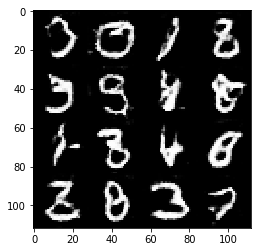

Epoch 6/25... Discriminator Loss: 0.7647... Generator Loss: 1.3570
Epoch 6/25... Discriminator Loss: 0.6432... Generator Loss: 1.8993
Epoch 6/25... Discriminator Loss: 0.6111... Generator Loss: 1.0861
Epoch 6/25... Discriminator Loss: 0.9333... Generator Loss: 3.2707
Epoch 6/25... Discriminator Loss: 0.3579... Generator Loss: 2.2157
Epoch 6/25... Discriminator Loss: 0.7246... Generator Loss: 0.8981
Epoch 6/25... Discriminator Loss: 0.3126... Generator Loss: 2.2416
Epoch 6/25... Discriminator Loss: 0.3686... Generator Loss: 1.6090
Epoch 6/25... Discriminator Loss: 0.2510... Generator Loss: 2.1046
Epoch 6/25... Discriminator Loss: 0.3127... Generator Loss: 1.7570


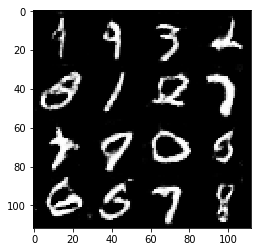

Epoch 7/25... Discriminator Loss: 0.2472... Generator Loss: 2.1275
Epoch 7/25... Discriminator Loss: 0.2461... Generator Loss: 2.3076
Epoch 7/25... Discriminator Loss: 0.2687... Generator Loss: 1.9876
Epoch 7/25... Discriminator Loss: 0.2115... Generator Loss: 2.2999
Epoch 7/25... Discriminator Loss: 0.4510... Generator Loss: 1.3831
Epoch 7/25... Discriminator Loss: 0.3457... Generator Loss: 1.6846
Epoch 7/25... Discriminator Loss: 0.3409... Generator Loss: 1.6309
Epoch 7/25... Discriminator Loss: 0.1881... Generator Loss: 2.2533
Epoch 7/25... Discriminator Loss: 0.3814... Generator Loss: 1.5292
Epoch 7/25... Discriminator Loss: 0.7921... Generator Loss: 2.9338


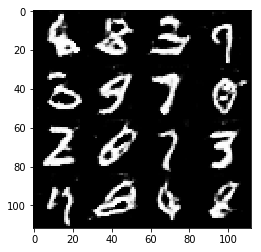

Epoch 7/25... Discriminator Loss: 0.5926... Generator Loss: 1.2828
Epoch 7/25... Discriminator Loss: 0.7963... Generator Loss: 0.8413
Epoch 7/25... Discriminator Loss: 0.3395... Generator Loss: 1.9199
Epoch 7/25... Discriminator Loss: 0.4123... Generator Loss: 1.5118
Epoch 7/25... Discriminator Loss: 0.2959... Generator Loss: 3.3069
Epoch 7/25... Discriminator Loss: 0.8334... Generator Loss: 0.8225
Epoch 7/25... Discriminator Loss: 0.6960... Generator Loss: 1.0054
Epoch 7/25... Discriminator Loss: 0.8344... Generator Loss: 3.9341
Epoch 7/25... Discriminator Loss: 0.5843... Generator Loss: 1.1290
Epoch 7/25... Discriminator Loss: 0.5024... Generator Loss: 1.3238


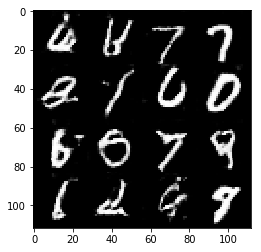

Epoch 7/25... Discriminator Loss: 0.6783... Generator Loss: 0.9885
Epoch 7/25... Discriminator Loss: 0.3104... Generator Loss: 1.8134
Epoch 7/25... Discriminator Loss: 0.4606... Generator Loss: 1.3621
Epoch 7/25... Discriminator Loss: 0.2622... Generator Loss: 1.9513
Epoch 7/25... Discriminator Loss: 0.3622... Generator Loss: 1.6475
Epoch 7/25... Discriminator Loss: 0.2506... Generator Loss: 1.9730
Epoch 7/25... Discriminator Loss: 0.2205... Generator Loss: 2.0551
Epoch 7/25... Discriminator Loss: 0.8806... Generator Loss: 2.2107
Epoch 7/25... Discriminator Loss: 0.4759... Generator Loss: 1.7576
Epoch 7/25... Discriminator Loss: 0.6735... Generator Loss: 0.9623


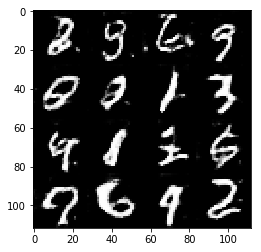

Epoch 7/25... Discriminator Loss: 0.4287... Generator Loss: 1.5153
Epoch 7/25... Discriminator Loss: 0.9057... Generator Loss: 0.7334
Epoch 7/25... Discriminator Loss: 0.3984... Generator Loss: 1.4802
Epoch 7/25... Discriminator Loss: 0.3711... Generator Loss: 1.5917
Epoch 7/25... Discriminator Loss: 0.3487... Generator Loss: 1.6885
Epoch 7/25... Discriminator Loss: 0.2665... Generator Loss: 2.0511
Epoch 7/25... Discriminator Loss: 0.2705... Generator Loss: 2.0216
Epoch 7/25... Discriminator Loss: 0.2514... Generator Loss: 1.9333
Epoch 7/25... Discriminator Loss: 0.3933... Generator Loss: 1.4682
Epoch 7/25... Discriminator Loss: 0.3442... Generator Loss: 1.7369


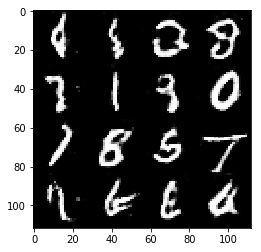

Epoch 7/25... Discriminator Loss: 0.4523... Generator Loss: 1.3975
Epoch 7/25... Discriminator Loss: 0.5032... Generator Loss: 1.2614
Epoch 7/25... Discriminator Loss: 0.1570... Generator Loss: 3.0349
Epoch 7/25... Discriminator Loss: 0.4563... Generator Loss: 1.4516
Epoch 7/25... Discriminator Loss: 0.3794... Generator Loss: 1.5054
Epoch 7/25... Discriminator Loss: 0.3558... Generator Loss: 1.6555
Epoch 7/25... Discriminator Loss: 0.3134... Generator Loss: 1.6826
Epoch 8/25... Discriminator Loss: 3.0149... Generator Loss: 0.1775
Epoch 8/25... Discriminator Loss: 0.4115... Generator Loss: 1.7370
Epoch 8/25... Discriminator Loss: 0.5395... Generator Loss: 1.2358


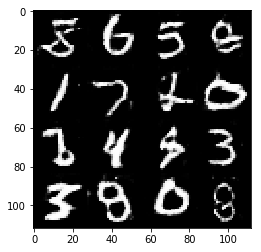

Epoch 8/25... Discriminator Loss: 0.2734... Generator Loss: 1.9118
Epoch 8/25... Discriminator Loss: 0.3252... Generator Loss: 1.7273
Epoch 8/25... Discriminator Loss: 0.2961... Generator Loss: 1.9994
Epoch 8/25... Discriminator Loss: 0.8407... Generator Loss: 1.2530
Epoch 8/25... Discriminator Loss: 0.7674... Generator Loss: 0.9860
Epoch 8/25... Discriminator Loss: 0.7420... Generator Loss: 1.0721
Epoch 8/25... Discriminator Loss: 0.6024... Generator Loss: 2.1239
Epoch 8/25... Discriminator Loss: 0.6947... Generator Loss: 2.5682
Epoch 8/25... Discriminator Loss: 0.9403... Generator Loss: 3.6127
Epoch 8/25... Discriminator Loss: 0.4630... Generator Loss: 1.4442


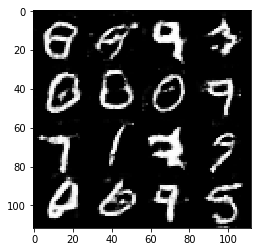

Epoch 8/25... Discriminator Loss: 0.3431... Generator Loss: 2.0881
Epoch 8/25... Discriminator Loss: 0.3809... Generator Loss: 2.6325
Epoch 8/25... Discriminator Loss: 0.3661... Generator Loss: 1.6706
Epoch 8/25... Discriminator Loss: 0.2218... Generator Loss: 2.3485
Epoch 8/25... Discriminator Loss: 0.3166... Generator Loss: 1.9434
Epoch 8/25... Discriminator Loss: 0.3873... Generator Loss: 1.4946
Epoch 8/25... Discriminator Loss: 0.2940... Generator Loss: 1.8557
Epoch 8/25... Discriminator Loss: 0.3506... Generator Loss: 1.5875
Epoch 8/25... Discriminator Loss: 0.3737... Generator Loss: 1.4963
Epoch 8/25... Discriminator Loss: 0.3464... Generator Loss: 1.6419


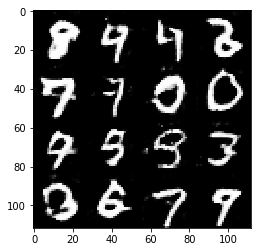

Epoch 8/25... Discriminator Loss: 0.2706... Generator Loss: 1.8836
Epoch 8/25... Discriminator Loss: 0.3312... Generator Loss: 1.8159
Epoch 8/25... Discriminator Loss: 0.4196... Generator Loss: 1.4110
Epoch 8/25... Discriminator Loss: 0.6268... Generator Loss: 0.9804
Epoch 8/25... Discriminator Loss: 0.4078... Generator Loss: 1.4766
Epoch 8/25... Discriminator Loss: 0.2641... Generator Loss: 1.8729
Epoch 8/25... Discriminator Loss: 0.2867... Generator Loss: 1.8507
Epoch 8/25... Discriminator Loss: 0.1946... Generator Loss: 2.3425
Epoch 8/25... Discriminator Loss: 0.2067... Generator Loss: 2.4624
Epoch 8/25... Discriminator Loss: 0.2082... Generator Loss: 2.9288


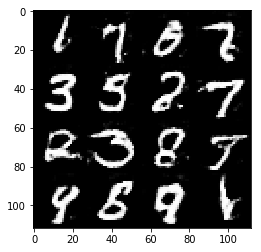

Epoch 8/25... Discriminator Loss: 2.8116... Generator Loss: 4.3672
Epoch 8/25... Discriminator Loss: 0.4598... Generator Loss: 2.3212
Epoch 8/25... Discriminator Loss: 0.4023... Generator Loss: 1.7368
Epoch 8/25... Discriminator Loss: 0.3108... Generator Loss: 1.8055
Epoch 8/25... Discriminator Loss: 0.3469... Generator Loss: 1.5904
Epoch 8/25... Discriminator Loss: 0.3412... Generator Loss: 1.6985
Epoch 8/25... Discriminator Loss: 0.3870... Generator Loss: 1.9361
Epoch 8/25... Discriminator Loss: 0.2065... Generator Loss: 2.3005
Epoch 8/25... Discriminator Loss: 0.2584... Generator Loss: 2.0112
Epoch 8/25... Discriminator Loss: 0.2765... Generator Loss: 2.0036


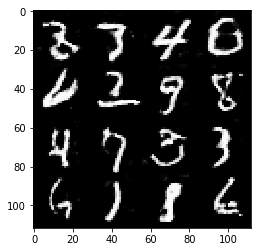

Epoch 8/25... Discriminator Loss: 0.2787... Generator Loss: 1.9342
Epoch 8/25... Discriminator Loss: 0.3881... Generator Loss: 1.5154
Epoch 8/25... Discriminator Loss: 0.4104... Generator Loss: 1.4288
Epoch 8/25... Discriminator Loss: 0.2280... Generator Loss: 2.0950
Epoch 9/25... Discriminator Loss: 1.3158... Generator Loss: 3.4123
Epoch 9/25... Discriminator Loss: 0.8018... Generator Loss: 0.8679
Epoch 9/25... Discriminator Loss: 0.3975... Generator Loss: 1.7711
Epoch 9/25... Discriminator Loss: 0.3103... Generator Loss: 1.9003
Epoch 9/25... Discriminator Loss: 0.3058... Generator Loss: 1.9243
Epoch 9/25... Discriminator Loss: 0.3786... Generator Loss: 1.4818


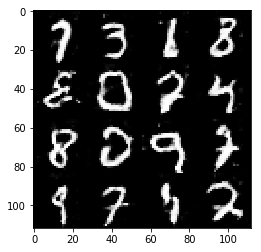

Epoch 9/25... Discriminator Loss: 0.2919... Generator Loss: 1.7932
Epoch 9/25... Discriminator Loss: 0.4517... Generator Loss: 1.3946
Epoch 9/25... Discriminator Loss: 0.4088... Generator Loss: 1.4347
Epoch 9/25... Discriminator Loss: 0.3613... Generator Loss: 1.5122
Epoch 9/25... Discriminator Loss: 0.3275... Generator Loss: 1.7005
Epoch 9/25... Discriminator Loss: 0.4605... Generator Loss: 1.3193
Epoch 9/25... Discriminator Loss: 0.4806... Generator Loss: 1.3037
Epoch 9/25... Discriminator Loss: 0.2615... Generator Loss: 1.8395
Epoch 9/25... Discriminator Loss: 0.3007... Generator Loss: 1.7407
Epoch 9/25... Discriminator Loss: 0.2280... Generator Loss: 2.0522


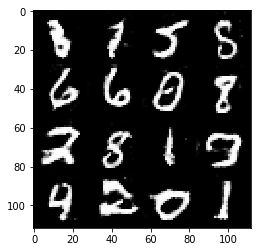

Epoch 9/25... Discriminator Loss: 0.2750... Generator Loss: 1.8763
Epoch 9/25... Discriminator Loss: 0.2280... Generator Loss: 2.1257
Epoch 9/25... Discriminator Loss: 0.3377... Generator Loss: 1.6841
Epoch 9/25... Discriminator Loss: 0.2236... Generator Loss: 2.0851
Epoch 9/25... Discriminator Loss: 0.3824... Generator Loss: 1.5238
Epoch 9/25... Discriminator Loss: 0.3761... Generator Loss: 1.5579
Epoch 9/25... Discriminator Loss: 0.2576... Generator Loss: 2.0111
Epoch 9/25... Discriminator Loss: 0.3407... Generator Loss: 1.6538
Epoch 9/25... Discriminator Loss: 0.3953... Generator Loss: 1.4663
Epoch 9/25... Discriminator Loss: 0.2857... Generator Loss: 1.7419


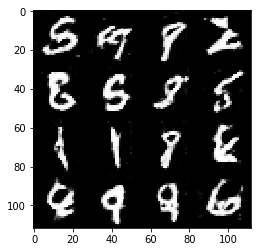

Epoch 9/25... Discriminator Loss: 0.5397... Generator Loss: 1.1935
Epoch 9/25... Discriminator Loss: 0.3324... Generator Loss: 1.6520
Epoch 9/25... Discriminator Loss: 0.3664... Generator Loss: 1.5439
Epoch 9/25... Discriminator Loss: 0.2646... Generator Loss: 1.9736
Epoch 9/25... Discriminator Loss: 0.4990... Generator Loss: 1.3060
Epoch 9/25... Discriminator Loss: 0.4119... Generator Loss: 1.7879
Epoch 9/25... Discriminator Loss: 1.3754... Generator Loss: 3.0435
Epoch 9/25... Discriminator Loss: 0.7287... Generator Loss: 1.0261
Epoch 9/25... Discriminator Loss: 0.5717... Generator Loss: 1.1726
Epoch 9/25... Discriminator Loss: 0.4784... Generator Loss: 1.3055


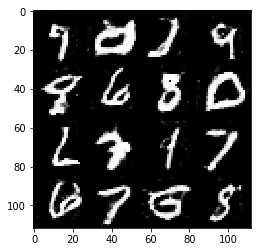

Epoch 9/25... Discriminator Loss: 6.0300... Generator Loss: 0.0057
Epoch 9/25... Discriminator Loss: 0.5942... Generator Loss: 1.6725
Epoch 9/25... Discriminator Loss: 0.5052... Generator Loss: 1.6482
Epoch 9/25... Discriminator Loss: 0.4399... Generator Loss: 1.5670
Epoch 9/25... Discriminator Loss: 0.6432... Generator Loss: 1.0997
Epoch 9/25... Discriminator Loss: 0.2765... Generator Loss: 1.9705
Epoch 9/25... Discriminator Loss: 0.7400... Generator Loss: 1.2154
Epoch 9/25... Discriminator Loss: 0.3785... Generator Loss: 1.7360
Epoch 9/25... Discriminator Loss: 0.3184... Generator Loss: 2.6369
Epoch 9/25... Discriminator Loss: 0.3838... Generator Loss: 1.5428


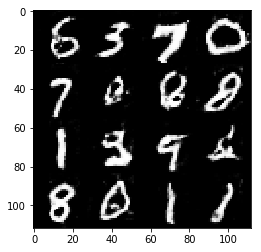

Epoch 9/25... Discriminator Loss: 0.7062... Generator Loss: 0.9421
Epoch 10/25... Discriminator Loss: 0.2579... Generator Loss: 2.4976
Epoch 10/25... Discriminator Loss: 0.3473... Generator Loss: 1.5521
Epoch 10/25... Discriminator Loss: 0.3662... Generator Loss: 1.6356
Epoch 10/25... Discriminator Loss: 0.5495... Generator Loss: 1.1084
Epoch 10/25... Discriminator Loss: 0.1925... Generator Loss: 2.3875
Epoch 10/25... Discriminator Loss: 0.4715... Generator Loss: 1.2769
Epoch 10/25... Discriminator Loss: 0.3995... Generator Loss: 1.5447
Epoch 10/25... Discriminator Loss: 0.3100... Generator Loss: 1.7339
Epoch 10/25... Discriminator Loss: 0.2268... Generator Loss: 2.0628


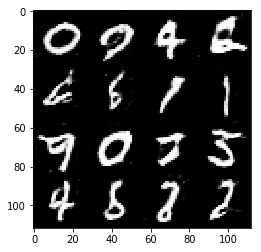

Epoch 10/25... Discriminator Loss: 0.6174... Generator Loss: 1.0922
Epoch 10/25... Discriminator Loss: 0.3993... Generator Loss: 1.4033
Epoch 10/25... Discriminator Loss: 0.2486... Generator Loss: 2.0606
Epoch 10/25... Discriminator Loss: 0.2600... Generator Loss: 1.9552
Epoch 10/25... Discriminator Loss: 0.4055... Generator Loss: 1.3853
Epoch 10/25... Discriminator Loss: 0.3635... Generator Loss: 1.6111
Epoch 10/25... Discriminator Loss: 0.4269... Generator Loss: 1.3526
Epoch 10/25... Discriminator Loss: 0.8267... Generator Loss: 0.8163
Epoch 10/25... Discriminator Loss: 0.2288... Generator Loss: 2.0408
Epoch 10/25... Discriminator Loss: 0.4022... Generator Loss: 1.4632


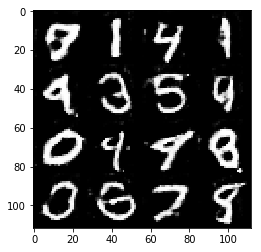

Epoch 10/25... Discriminator Loss: 0.2896... Generator Loss: 1.9389
Epoch 10/25... Discriminator Loss: 0.5344... Generator Loss: 1.2416
Epoch 10/25... Discriminator Loss: 0.3480... Generator Loss: 1.5950
Epoch 10/25... Discriminator Loss: 0.3705... Generator Loss: 1.5591
Epoch 10/25... Discriminator Loss: 0.2538... Generator Loss: 2.0260
Epoch 10/25... Discriminator Loss: 0.2638... Generator Loss: 1.8485
Epoch 10/25... Discriminator Loss: 0.4305... Generator Loss: 1.3742
Epoch 10/25... Discriminator Loss: 0.3088... Generator Loss: 1.8394
Epoch 10/25... Discriminator Loss: 0.4606... Generator Loss: 1.3683
Epoch 10/25... Discriminator Loss: 0.3043... Generator Loss: 1.7514


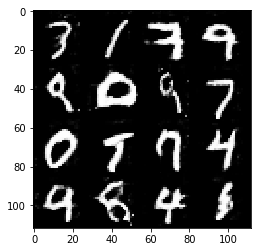

Epoch 10/25... Discriminator Loss: 0.3263... Generator Loss: 1.7884
Epoch 10/25... Discriminator Loss: 0.2278... Generator Loss: 2.0861
Epoch 10/25... Discriminator Loss: 0.2501... Generator Loss: 1.9092
Epoch 10/25... Discriminator Loss: 0.2369... Generator Loss: 1.9965
Epoch 10/25... Discriminator Loss: 0.3394... Generator Loss: 1.7229
Epoch 10/25... Discriminator Loss: 0.2116... Generator Loss: 2.0958
Epoch 10/25... Discriminator Loss: 0.2101... Generator Loss: 2.1934
Epoch 10/25... Discriminator Loss: 0.4029... Generator Loss: 1.9828
Epoch 10/25... Discriminator Loss: 0.5130... Generator Loss: 2.5160
Epoch 10/25... Discriminator Loss: 0.5947... Generator Loss: 1.1247


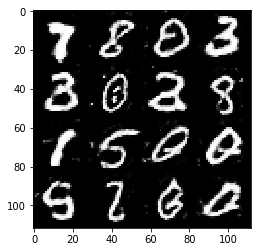

Epoch 10/25... Discriminator Loss: 0.2948... Generator Loss: 2.7148
Epoch 10/25... Discriminator Loss: 3.2331... Generator Loss: 0.1859
Epoch 10/25... Discriminator Loss: 0.4310... Generator Loss: 2.4960
Epoch 10/25... Discriminator Loss: 0.3781... Generator Loss: 1.8716
Epoch 10/25... Discriminator Loss: 0.2437... Generator Loss: 2.9356
Epoch 10/25... Discriminator Loss: 0.3481... Generator Loss: 1.9970
Epoch 10/25... Discriminator Loss: 0.3375... Generator Loss: 1.7998
Epoch 10/25... Discriminator Loss: 0.4470... Generator Loss: 1.3317
Epoch 11/25... Discriminator Loss: 0.5272... Generator Loss: 1.1860
Epoch 11/25... Discriminator Loss: 0.3059... Generator Loss: 3.7654


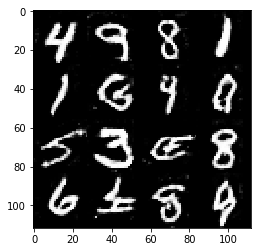

Epoch 11/25... Discriminator Loss: 0.4827... Generator Loss: 1.3717
Epoch 11/25... Discriminator Loss: 0.5412... Generator Loss: 2.4513
Epoch 11/25... Discriminator Loss: 0.6788... Generator Loss: 2.6690
Epoch 11/25... Discriminator Loss: 0.3088... Generator Loss: 2.2922
Epoch 11/25... Discriminator Loss: 0.7321... Generator Loss: 1.0387
Epoch 11/25... Discriminator Loss: 0.3289... Generator Loss: 1.9890
Epoch 11/25... Discriminator Loss: 0.3349... Generator Loss: 1.7030
Epoch 11/25... Discriminator Loss: 0.3456... Generator Loss: 1.6143
Epoch 11/25... Discriminator Loss: 0.4460... Generator Loss: 1.4032
Epoch 11/25... Discriminator Loss: 0.3444... Generator Loss: 1.6595


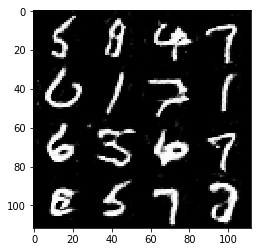

Epoch 11/25... Discriminator Loss: 0.2988... Generator Loss: 1.7334
Epoch 11/25... Discriminator Loss: 0.2507... Generator Loss: 2.0067
Epoch 11/25... Discriminator Loss: 0.3876... Generator Loss: 1.5507
Epoch 11/25... Discriminator Loss: 0.2819... Generator Loss: 1.8127
Epoch 11/25... Discriminator Loss: 0.1831... Generator Loss: 2.3543
Epoch 11/25... Discriminator Loss: 0.3790... Generator Loss: 1.4939
Epoch 11/25... Discriminator Loss: 0.2951... Generator Loss: 1.7321
Epoch 11/25... Discriminator Loss: 0.2937... Generator Loss: 1.8125
Epoch 11/25... Discriminator Loss: 0.2285... Generator Loss: 2.0892
Epoch 11/25... Discriminator Loss: 0.2420... Generator Loss: 2.0761


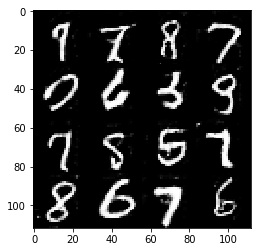

Epoch 11/25... Discriminator Loss: 0.4814... Generator Loss: 1.3014
Epoch 11/25... Discriminator Loss: 0.3688... Generator Loss: 1.6062
Epoch 11/25... Discriminator Loss: 0.3774... Generator Loss: 1.5426
Epoch 11/25... Discriminator Loss: 0.3570... Generator Loss: 1.6080
Epoch 11/25... Discriminator Loss: 2.7908... Generator Loss: 0.1397
Epoch 11/25... Discriminator Loss: 0.3674... Generator Loss: 1.6501
Epoch 11/25... Discriminator Loss: 0.4734... Generator Loss: 2.5271
Epoch 11/25... Discriminator Loss: 0.2713... Generator Loss: 2.5630
Epoch 11/25... Discriminator Loss: 0.3355... Generator Loss: 1.6682
Epoch 11/25... Discriminator Loss: 0.8714... Generator Loss: 4.5656


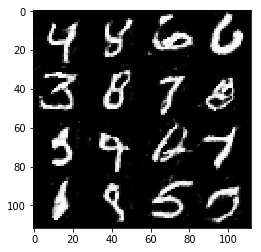

Epoch 11/25... Discriminator Loss: 0.6384... Generator Loss: 1.1064
Epoch 11/25... Discriminator Loss: 0.3765... Generator Loss: 1.6668
Epoch 11/25... Discriminator Loss: 0.3806... Generator Loss: 1.5944
Epoch 11/25... Discriminator Loss: 0.4035... Generator Loss: 1.4827
Epoch 11/25... Discriminator Loss: 0.3945... Generator Loss: 1.5468
Epoch 11/25... Discriminator Loss: 0.3483... Generator Loss: 1.6241
Epoch 11/25... Discriminator Loss: 0.2370... Generator Loss: 2.0648
Epoch 11/25... Discriminator Loss: 0.3082... Generator Loss: 1.8587
Epoch 11/25... Discriminator Loss: 0.1842... Generator Loss: 2.2557
Epoch 11/25... Discriminator Loss: 0.4141... Generator Loss: 1.4635


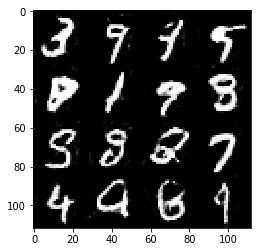

Epoch 11/25... Discriminator Loss: 0.2611... Generator Loss: 1.9280
Epoch 11/25... Discriminator Loss: 0.2864... Generator Loss: 1.7970
Epoch 11/25... Discriminator Loss: 0.2482... Generator Loss: 2.0758
Epoch 11/25... Discriminator Loss: 0.3211... Generator Loss: 1.7389
Epoch 12/25... Discriminator Loss: 0.2326... Generator Loss: 2.1607
Epoch 12/25... Discriminator Loss: 0.2316... Generator Loss: 1.9693
Epoch 12/25... Discriminator Loss: 0.2774... Generator Loss: 1.8287
Epoch 12/25... Discriminator Loss: 0.1276... Generator Loss: 2.8104
Epoch 12/25... Discriminator Loss: 0.3969... Generator Loss: 1.5138
Epoch 12/25... Discriminator Loss: 0.4108... Generator Loss: 1.4748


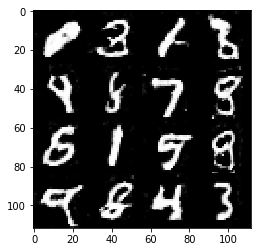

Epoch 12/25... Discriminator Loss: 0.4633... Generator Loss: 1.3088
Epoch 12/25... Discriminator Loss: 0.1832... Generator Loss: 2.4242
Epoch 12/25... Discriminator Loss: 0.3266... Generator Loss: 1.6927
Epoch 12/25... Discriminator Loss: 0.3120... Generator Loss: 1.7418
Epoch 12/25... Discriminator Loss: 0.3368... Generator Loss: 1.6156
Epoch 12/25... Discriminator Loss: 0.2026... Generator Loss: 2.2906
Epoch 12/25... Discriminator Loss: 0.2110... Generator Loss: 2.1499
Epoch 12/25... Discriminator Loss: 0.2812... Generator Loss: 1.8634
Epoch 12/25... Discriminator Loss: 0.2504... Generator Loss: 1.9871
Epoch 12/25... Discriminator Loss: 0.2973... Generator Loss: 1.8114


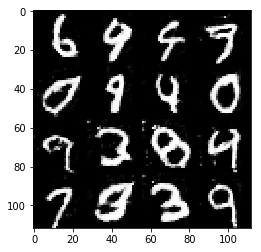

Epoch 12/25... Discriminator Loss: 0.5704... Generator Loss: 1.1584
Epoch 12/25... Discriminator Loss: 0.3073... Generator Loss: 1.7423
Epoch 12/25... Discriminator Loss: 0.1439... Generator Loss: 2.5939
Epoch 12/25... Discriminator Loss: 0.3655... Generator Loss: 1.5074
Epoch 12/25... Discriminator Loss: 0.3185... Generator Loss: 1.7410
Epoch 12/25... Discriminator Loss: 0.2350... Generator Loss: 1.9977
Epoch 12/25... Discriminator Loss: 0.2343... Generator Loss: 2.0569
Epoch 12/25... Discriminator Loss: 0.2337... Generator Loss: 1.9886
Epoch 12/25... Discriminator Loss: 0.3290... Generator Loss: 1.6701
Epoch 12/25... Discriminator Loss: 0.3055... Generator Loss: 1.7189


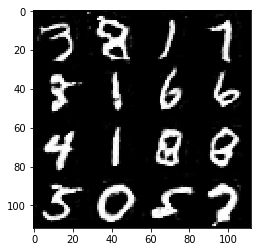

Epoch 12/25... Discriminator Loss: 0.1482... Generator Loss: 2.6527
Epoch 12/25... Discriminator Loss: 0.2646... Generator Loss: 2.0212
Epoch 12/25... Discriminator Loss: 0.1878... Generator Loss: 2.5049
Epoch 12/25... Discriminator Loss: 1.1237... Generator Loss: 3.8196
Epoch 12/25... Discriminator Loss: 0.3470... Generator Loss: 2.4389
Epoch 12/25... Discriminator Loss: 2.2217... Generator Loss: 0.5188
Epoch 12/25... Discriminator Loss: 0.6208... Generator Loss: 1.2534
Epoch 12/25... Discriminator Loss: 0.3573... Generator Loss: 2.0209
Epoch 12/25... Discriminator Loss: 0.2639... Generator Loss: 2.2905
Epoch 12/25... Discriminator Loss: 0.4494... Generator Loss: 1.2956


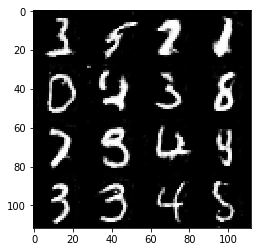

Epoch 12/25... Discriminator Loss: 0.2447... Generator Loss: 3.3685
Epoch 12/25... Discriminator Loss: 0.1575... Generator Loss: 2.5910
Epoch 12/25... Discriminator Loss: 0.2701... Generator Loss: 1.8969
Epoch 12/25... Discriminator Loss: 0.3116... Generator Loss: 1.8408
Epoch 12/25... Discriminator Loss: 0.5438... Generator Loss: 1.1977
Epoch 12/25... Discriminator Loss: 0.4363... Generator Loss: 1.3849
Epoch 12/25... Discriminator Loss: 0.1737... Generator Loss: 2.3792
Epoch 12/25... Discriminator Loss: 0.2088... Generator Loss: 2.1884
Epoch 12/25... Discriminator Loss: 0.3417... Generator Loss: 1.7192
Epoch 12/25... Discriminator Loss: 0.2797... Generator Loss: 1.8704


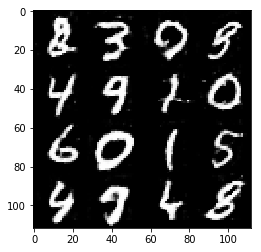

Epoch 12/25... Discriminator Loss: 0.2734... Generator Loss: 1.8996
Epoch 13/25... Discriminator Loss: 0.2126... Generator Loss: 2.2982
Epoch 13/25... Discriminator Loss: 0.2664... Generator Loss: 1.9752
Epoch 13/25... Discriminator Loss: 0.2124... Generator Loss: 2.0577
Epoch 13/25... Discriminator Loss: 0.2502... Generator Loss: 1.8250
Epoch 13/25... Discriminator Loss: 0.2940... Generator Loss: 1.8475
Epoch 13/25... Discriminator Loss: 0.3402... Generator Loss: 1.6869
Epoch 13/25... Discriminator Loss: 0.1428... Generator Loss: 2.5767
Epoch 13/25... Discriminator Loss: 0.3408... Generator Loss: 1.7028
Epoch 13/25... Discriminator Loss: 0.2448... Generator Loss: 2.0890


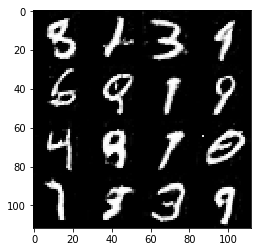

Epoch 13/25... Discriminator Loss: 0.1912... Generator Loss: 2.2484
Epoch 13/25... Discriminator Loss: 0.2573... Generator Loss: 1.9414
Epoch 13/25... Discriminator Loss: 0.2320... Generator Loss: 2.0487
Epoch 13/25... Discriminator Loss: 0.2907... Generator Loss: 1.8709
Epoch 13/25... Discriminator Loss: 0.1401... Generator Loss: 2.7008
Epoch 13/25... Discriminator Loss: 0.3151... Generator Loss: 1.7158
Epoch 13/25... Discriminator Loss: 0.2726... Generator Loss: 1.9344
Epoch 13/25... Discriminator Loss: 0.1383... Generator Loss: 2.6133
Epoch 13/25... Discriminator Loss: 0.2067... Generator Loss: 2.2221
Epoch 13/25... Discriminator Loss: 0.2162... Generator Loss: 2.2308


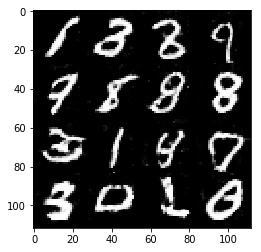

Epoch 13/25... Discriminator Loss: 0.2875... Generator Loss: 1.9714
Epoch 13/25... Discriminator Loss: 6.2500... Generator Loss: 9.7860
Epoch 13/25... Discriminator Loss: 0.5610... Generator Loss: 1.9440
Epoch 13/25... Discriminator Loss: 0.3506... Generator Loss: 1.8004
Epoch 13/25... Discriminator Loss: 0.3003... Generator Loss: 1.8120
Epoch 13/25... Discriminator Loss: 2.4639... Generator Loss: 4.5285
Epoch 13/25... Discriminator Loss: 0.6214... Generator Loss: 1.3240
Epoch 13/25... Discriminator Loss: 0.6767... Generator Loss: 2.6086
Epoch 13/25... Discriminator Loss: 0.4351... Generator Loss: 1.5038
Epoch 13/25... Discriminator Loss: 0.5606... Generator Loss: 2.9728


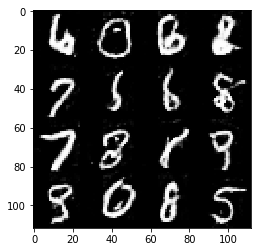

Epoch 13/25... Discriminator Loss: 0.6907... Generator Loss: 1.0582
Epoch 13/25... Discriminator Loss: 0.2547... Generator Loss: 2.4368
Epoch 13/25... Discriminator Loss: 0.3052... Generator Loss: 3.4138
Epoch 13/25... Discriminator Loss: 0.2746... Generator Loss: 2.7392
Epoch 13/25... Discriminator Loss: 0.5531... Generator Loss: 1.2129
Epoch 13/25... Discriminator Loss: 0.2007... Generator Loss: 2.6698
Epoch 13/25... Discriminator Loss: 0.1991... Generator Loss: 2.7798
Epoch 13/25... Discriminator Loss: 0.6310... Generator Loss: 1.1326
Epoch 13/25... Discriminator Loss: 0.2126... Generator Loss: 2.2518
Epoch 13/25... Discriminator Loss: 0.2605... Generator Loss: 1.9120


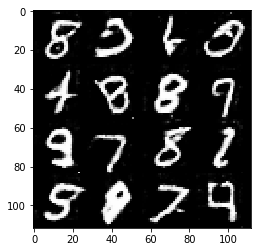

Epoch 13/25... Discriminator Loss: 0.3779... Generator Loss: 1.5722
Epoch 13/25... Discriminator Loss: 0.2084... Generator Loss: 2.4241
Epoch 13/25... Discriminator Loss: 0.1608... Generator Loss: 2.6215
Epoch 13/25... Discriminator Loss: 0.3501... Generator Loss: 1.5627
Epoch 13/25... Discriminator Loss: 0.3252... Generator Loss: 1.7068
Epoch 13/25... Discriminator Loss: 0.3418... Generator Loss: 1.6858
Epoch 13/25... Discriminator Loss: 0.4248... Generator Loss: 1.4157
Epoch 13/25... Discriminator Loss: 0.1895... Generator Loss: 2.3374
Epoch 14/25... Discriminator Loss: 0.9455... Generator Loss: 5.1232
Epoch 14/25... Discriminator Loss: 0.7392... Generator Loss: 1.1203


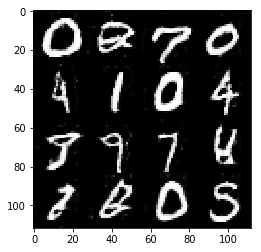

Epoch 14/25... Discriminator Loss: 0.8610... Generator Loss: 0.8501
Epoch 14/25... Discriminator Loss: 0.5630... Generator Loss: 1.6694
Epoch 14/25... Discriminator Loss: 0.4706... Generator Loss: 1.5104
Epoch 14/25... Discriminator Loss: 0.6487... Generator Loss: 2.7015
Epoch 14/25... Discriminator Loss: 0.3549... Generator Loss: 2.5550
Epoch 14/25... Discriminator Loss: 0.3672... Generator Loss: 1.7941
Epoch 14/25... Discriminator Loss: 0.6473... Generator Loss: 1.0427
Epoch 14/25... Discriminator Loss: 0.6586... Generator Loss: 1.0219
Epoch 14/25... Discriminator Loss: 0.4048... Generator Loss: 2.9109
Epoch 14/25... Discriminator Loss: 3.2602... Generator Loss: 8.0064


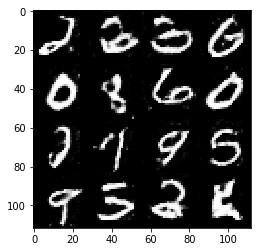

Epoch 14/25... Discriminator Loss: 0.3567... Generator Loss: 1.7887
Epoch 14/25... Discriminator Loss: 0.1980... Generator Loss: 2.4153
Epoch 14/25... Discriminator Loss: 0.6145... Generator Loss: 1.2985
Epoch 14/25... Discriminator Loss: 0.2239... Generator Loss: 2.2096
Epoch 14/25... Discriminator Loss: 0.1899... Generator Loss: 2.2638
Epoch 14/25... Discriminator Loss: 0.3162... Generator Loss: 1.8241
Epoch 14/25... Discriminator Loss: 0.3667... Generator Loss: 1.5805
Epoch 14/25... Discriminator Loss: 0.2663... Generator Loss: 1.8949
Epoch 14/25... Discriminator Loss: 0.2624... Generator Loss: 1.9613
Epoch 14/25... Discriminator Loss: 0.2113... Generator Loss: 2.2399


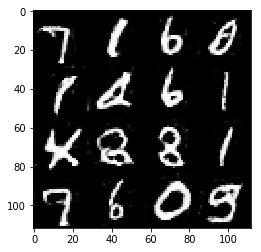

Epoch 14/25... Discriminator Loss: 0.2099... Generator Loss: 2.2034
Epoch 14/25... Discriminator Loss: 0.3159... Generator Loss: 1.6996
Epoch 14/25... Discriminator Loss: 0.2990... Generator Loss: 1.9333
Epoch 14/25... Discriminator Loss: 0.3078... Generator Loss: 1.8057
Epoch 14/25... Discriminator Loss: 0.1627... Generator Loss: 2.4822
Epoch 14/25... Discriminator Loss: 0.3253... Generator Loss: 1.7543
Epoch 14/25... Discriminator Loss: 0.2378... Generator Loss: 1.9980
Epoch 14/25... Discriminator Loss: 0.1755... Generator Loss: 2.2878
Epoch 14/25... Discriminator Loss: 0.2540... Generator Loss: 1.9071
Epoch 14/25... Discriminator Loss: 0.2086... Generator Loss: 2.0711


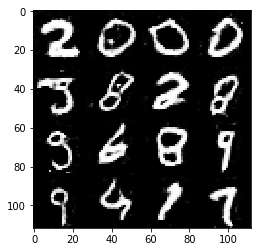

Epoch 14/25... Discriminator Loss: 0.4216... Generator Loss: 1.4551
Epoch 14/25... Discriminator Loss: 0.2507... Generator Loss: 2.0152
Epoch 14/25... Discriminator Loss: 0.2374... Generator Loss: 1.9772
Epoch 14/25... Discriminator Loss: 0.2875... Generator Loss: 1.8045
Epoch 14/25... Discriminator Loss: 0.2080... Generator Loss: 2.1781
Epoch 14/25... Discriminator Loss: 0.2318... Generator Loss: 2.1331
Epoch 14/25... Discriminator Loss: 0.2580... Generator Loss: 1.9724
Epoch 14/25... Discriminator Loss: 0.2985... Generator Loss: 1.8411
Epoch 14/25... Discriminator Loss: 0.1325... Generator Loss: 2.7451
Epoch 14/25... Discriminator Loss: 0.3507... Generator Loss: 1.6440


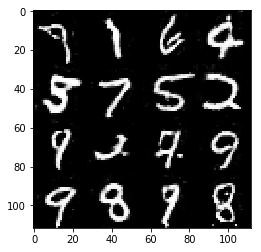

Epoch 14/25... Discriminator Loss: 0.3052... Generator Loss: 1.7157
Epoch 14/25... Discriminator Loss: 5.3768... Generator Loss: 6.3772
Epoch 14/25... Discriminator Loss: 1.3023... Generator Loss: 0.5862
Epoch 14/25... Discriminator Loss: 1.4704... Generator Loss: 0.3862
Epoch 14/25... Discriminator Loss: 1.1419... Generator Loss: 1.8960
Epoch 15/25... Discriminator Loss: 0.7595... Generator Loss: 2.7098
Epoch 15/25... Discriminator Loss: 0.8038... Generator Loss: 3.0292
Epoch 15/25... Discriminator Loss: 0.5369... Generator Loss: 1.2796
Epoch 15/25... Discriminator Loss: 0.5037... Generator Loss: 1.4340
Epoch 15/25... Discriminator Loss: 0.9471... Generator Loss: 5.0225


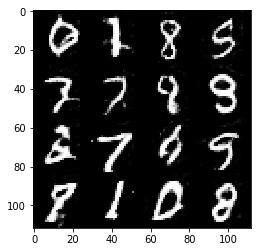

Epoch 15/25... Discriminator Loss: 0.8695... Generator Loss: 0.8113
Epoch 15/25... Discriminator Loss: 0.3135... Generator Loss: 1.9135
Epoch 15/25... Discriminator Loss: 0.1926... Generator Loss: 3.3839
Epoch 15/25... Discriminator Loss: 0.1489... Generator Loss: 2.6642
Epoch 15/25... Discriminator Loss: 0.2912... Generator Loss: 2.1114
Epoch 15/25... Discriminator Loss: 0.3757... Generator Loss: 1.5269
Epoch 15/25... Discriminator Loss: 0.2391... Generator Loss: 2.1091
Epoch 15/25... Discriminator Loss: 0.2230... Generator Loss: 2.2015
Epoch 15/25... Discriminator Loss: 0.2585... Generator Loss: 1.9775
Epoch 15/25... Discriminator Loss: 0.2178... Generator Loss: 2.1850


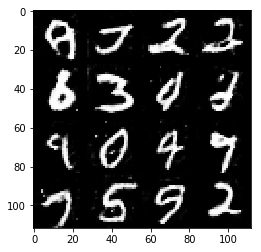

Epoch 15/25... Discriminator Loss: 0.2047... Generator Loss: 2.2327
Epoch 15/25... Discriminator Loss: 0.4607... Generator Loss: 1.3193
Epoch 15/25... Discriminator Loss: 0.2661... Generator Loss: 1.9357
Epoch 15/25... Discriminator Loss: 0.2361... Generator Loss: 2.0710
Epoch 15/25... Discriminator Loss: 0.1879... Generator Loss: 2.2278
Epoch 15/25... Discriminator Loss: 0.2730... Generator Loss: 1.9091
Epoch 15/25... Discriminator Loss: 0.2527... Generator Loss: 1.9286
Epoch 15/25... Discriminator Loss: 0.3446... Generator Loss: 1.5976
Epoch 15/25... Discriminator Loss: 0.1832... Generator Loss: 2.3262
Epoch 15/25... Discriminator Loss: 0.2550... Generator Loss: 2.0285


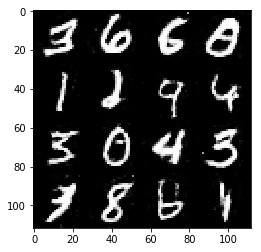

Epoch 15/25... Discriminator Loss: 0.3187... Generator Loss: 1.7975
Epoch 15/25... Discriminator Loss: 0.3590... Generator Loss: 1.5909
Epoch 15/25... Discriminator Loss: 0.3341... Generator Loss: 1.7047
Epoch 15/25... Discriminator Loss: 0.2689... Generator Loss: 1.8806
Epoch 15/25... Discriminator Loss: 0.3184... Generator Loss: 1.7053
Epoch 15/25... Discriminator Loss: 0.1601... Generator Loss: 2.3766
Epoch 15/25... Discriminator Loss: 0.1794... Generator Loss: 2.2598
Epoch 15/25... Discriminator Loss: 0.1528... Generator Loss: 2.5413
Epoch 15/25... Discriminator Loss: 0.2376... Generator Loss: 2.0358
Epoch 15/25... Discriminator Loss: 0.2123... Generator Loss: 2.0154


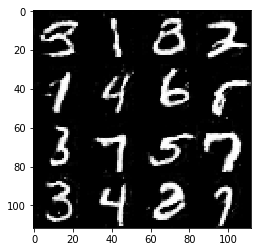

Epoch 15/25... Discriminator Loss: 0.2048... Generator Loss: 2.1717
Epoch 15/25... Discriminator Loss: 0.2437... Generator Loss: 2.0480
Epoch 15/25... Discriminator Loss: 0.2246... Generator Loss: 1.9862
Epoch 15/25... Discriminator Loss: 0.3406... Generator Loss: 1.7667
Epoch 15/25... Discriminator Loss: 0.2061... Generator Loss: 2.1188
Epoch 15/25... Discriminator Loss: 0.3083... Generator Loss: 1.7759
Epoch 15/25... Discriminator Loss: 0.2899... Generator Loss: 1.8904
Epoch 15/25... Discriminator Loss: 0.1596... Generator Loss: 2.4144
Epoch 15/25... Discriminator Loss: 0.1723... Generator Loss: 2.3210
Epoch 15/25... Discriminator Loss: 0.3985... Generator Loss: 1.5171


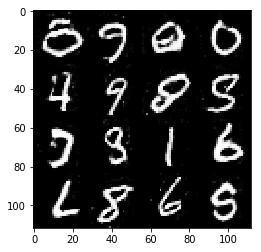

Epoch 15/25... Discriminator Loss: 0.3422... Generator Loss: 1.6183
Epoch 15/25... Discriminator Loss: 0.1505... Generator Loss: 2.6756
Epoch 16/25... Discriminator Loss: 0.3720... Generator Loss: 1.5993
Epoch 16/25... Discriminator Loss: 0.2277... Generator Loss: 2.0490
Epoch 16/25... Discriminator Loss: 0.3095... Generator Loss: 1.7314
Epoch 16/25... Discriminator Loss: 3.1037... Generator Loss: 0.2639
Epoch 16/25... Discriminator Loss: 0.6425... Generator Loss: 1.2900
Epoch 16/25... Discriminator Loss: 0.7803... Generator Loss: 4.4052
Epoch 16/25... Discriminator Loss: 0.6870... Generator Loss: 1.0511
Epoch 16/25... Discriminator Loss: 0.1909... Generator Loss: 2.3355


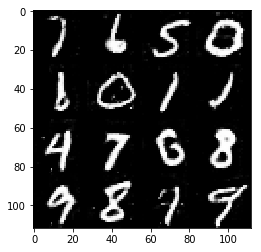

Epoch 16/25... Discriminator Loss: 0.2477... Generator Loss: 2.0713
Epoch 16/25... Discriminator Loss: 0.2415... Generator Loss: 2.0908
Epoch 16/25... Discriminator Loss: 0.3624... Generator Loss: 1.5824
Epoch 16/25... Discriminator Loss: 0.2386... Generator Loss: 2.0212
Epoch 16/25... Discriminator Loss: 0.2338... Generator Loss: 2.0947
Epoch 16/25... Discriminator Loss: 0.2006... Generator Loss: 2.2839
Epoch 16/25... Discriminator Loss: 0.1871... Generator Loss: 2.3202
Epoch 16/25... Discriminator Loss: 0.2417... Generator Loss: 2.0686
Epoch 16/25... Discriminator Loss: 0.1071... Generator Loss: 3.0355
Epoch 16/25... Discriminator Loss: 0.2253... Generator Loss: 2.1666


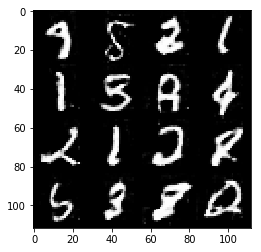

Epoch 16/25... Discriminator Loss: 0.2637... Generator Loss: 1.8884
Epoch 16/25... Discriminator Loss: 0.2214... Generator Loss: 2.1278
Epoch 16/25... Discriminator Loss: 0.1770... Generator Loss: 2.3974
Epoch 16/25... Discriminator Loss: 0.1784... Generator Loss: 2.2738
Epoch 16/25... Discriminator Loss: 0.2819... Generator Loss: 2.0058
Epoch 16/25... Discriminator Loss: 0.2528... Generator Loss: 2.0045
Epoch 16/25... Discriminator Loss: 0.2636... Generator Loss: 1.9106
Epoch 16/25... Discriminator Loss: 0.2375... Generator Loss: 2.0139
Epoch 16/25... Discriminator Loss: 0.1967... Generator Loss: 2.1373
Epoch 16/25... Discriminator Loss: 0.2701... Generator Loss: 1.8865


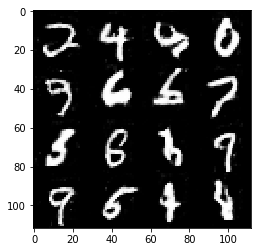

Epoch 16/25... Discriminator Loss: 0.1659... Generator Loss: 2.4288
Epoch 16/25... Discriminator Loss: 0.2946... Generator Loss: 1.8259
Epoch 16/25... Discriminator Loss: 0.2409... Generator Loss: 1.9696
Epoch 16/25... Discriminator Loss: 0.2475... Generator Loss: 2.1123
Epoch 16/25... Discriminator Loss: 0.2062... Generator Loss: 2.2291
Epoch 16/25... Discriminator Loss: 0.1608... Generator Loss: 2.3866
Epoch 16/25... Discriminator Loss: 0.2675... Generator Loss: 1.8977
Epoch 16/25... Discriminator Loss: 0.3783... Generator Loss: 1.5327
Epoch 16/25... Discriminator Loss: 0.2093... Generator Loss: 2.1460
Epoch 16/25... Discriminator Loss: 0.2947... Generator Loss: 1.9710


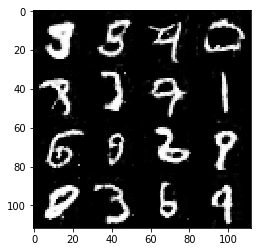

Epoch 16/25... Discriminator Loss: 0.2030... Generator Loss: 2.1329
Epoch 16/25... Discriminator Loss: 0.2257... Generator Loss: 2.1064
Epoch 16/25... Discriminator Loss: 0.1702... Generator Loss: 2.3822
Epoch 16/25... Discriminator Loss: 0.3928... Generator Loss: 1.5362
Epoch 16/25... Discriminator Loss: 3.0271... Generator Loss: 7.5004
Epoch 16/25... Discriminator Loss: 1.3428... Generator Loss: 3.1505
Epoch 16/25... Discriminator Loss: 0.6620... Generator Loss: 2.1106
Epoch 16/25... Discriminator Loss: 0.4314... Generator Loss: 2.1120
Epoch 17/25... Discriminator Loss: 1.1665... Generator Loss: 3.7528
Epoch 17/25... Discriminator Loss: 0.9060... Generator Loss: 4.0292


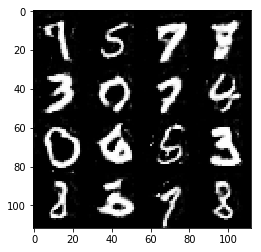

Epoch 17/25... Discriminator Loss: 0.7351... Generator Loss: 0.9154
Epoch 17/25... Discriminator Loss: 0.4995... Generator Loss: 2.2415
Epoch 17/25... Discriminator Loss: 0.5585... Generator Loss: 1.1504
Epoch 17/25... Discriminator Loss: 0.2916... Generator Loss: 2.0392
Epoch 17/25... Discriminator Loss: 0.5640... Generator Loss: 1.4420
Epoch 17/25... Discriminator Loss: 0.2191... Generator Loss: 2.4884
Epoch 17/25... Discriminator Loss: 0.3812... Generator Loss: 1.6429
Epoch 17/25... Discriminator Loss: 0.3215... Generator Loss: 1.7506
Epoch 17/25... Discriminator Loss: 0.3090... Generator Loss: 1.8364
Epoch 17/25... Discriminator Loss: 0.1757... Generator Loss: 2.7913


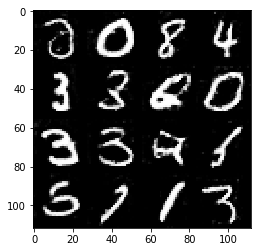

Epoch 17/25... Discriminator Loss: 0.1509... Generator Loss: 2.5525
Epoch 17/25... Discriminator Loss: 0.1865... Generator Loss: 2.4505
Epoch 17/25... Discriminator Loss: 0.2545... Generator Loss: 3.1906
Epoch 17/25... Discriminator Loss: 0.4127... Generator Loss: 2.0199
Epoch 17/25... Discriminator Loss: 0.3650... Generator Loss: 1.7459
Epoch 17/25... Discriminator Loss: 2.4007... Generator Loss: 0.2209
Epoch 17/25... Discriminator Loss: 0.3992... Generator Loss: 2.3096
Epoch 17/25... Discriminator Loss: 1.3692... Generator Loss: 6.0844
Epoch 17/25... Discriminator Loss: 0.4142... Generator Loss: 1.5093
Epoch 17/25... Discriminator Loss: 0.2656... Generator Loss: 2.0190


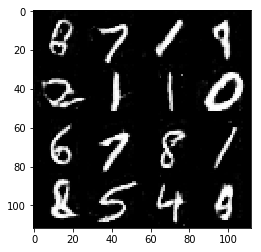

Epoch 17/25... Discriminator Loss: 0.6726... Generator Loss: 3.9078
Epoch 17/25... Discriminator Loss: 0.2463... Generator Loss: 2.5205
Epoch 17/25... Discriminator Loss: 0.3590... Generator Loss: 1.6528
Epoch 17/25... Discriminator Loss: 0.2187... Generator Loss: 2.2064
Epoch 17/25... Discriminator Loss: 0.1768... Generator Loss: 2.3159
Epoch 17/25... Discriminator Loss: 0.2285... Generator Loss: 2.0894
Epoch 17/25... Discriminator Loss: 0.2509... Generator Loss: 2.0609
Epoch 17/25... Discriminator Loss: 0.4107... Generator Loss: 1.5216
Epoch 17/25... Discriminator Loss: 0.2638... Generator Loss: 1.9734
Epoch 17/25... Discriminator Loss: 0.2973... Generator Loss: 1.7846


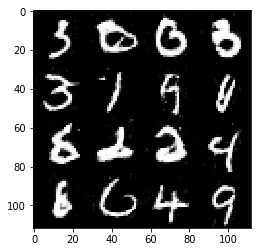

Epoch 17/25... Discriminator Loss: 0.2508... Generator Loss: 2.0063
Epoch 17/25... Discriminator Loss: 0.4921... Generator Loss: 1.3512
Epoch 17/25... Discriminator Loss: 0.2900... Generator Loss: 1.8704
Epoch 17/25... Discriminator Loss: 0.2661... Generator Loss: 1.9342
Epoch 17/25... Discriminator Loss: 0.1628... Generator Loss: 2.6567
Epoch 17/25... Discriminator Loss: 0.1889... Generator Loss: 2.4243
Epoch 17/25... Discriminator Loss: 0.2356... Generator Loss: 1.9842
Epoch 17/25... Discriminator Loss: 0.2398... Generator Loss: 1.9982
Epoch 17/25... Discriminator Loss: 0.5111... Generator Loss: 1.2568
Epoch 17/25... Discriminator Loss: 0.3466... Generator Loss: 1.5991


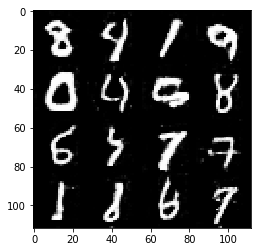

Epoch 17/25... Discriminator Loss: 0.1700... Generator Loss: 2.3535
Epoch 17/25... Discriminator Loss: 0.1527... Generator Loss: 2.5169
Epoch 17/25... Discriminator Loss: 0.2383... Generator Loss: 1.9794
Epoch 17/25... Discriminator Loss: 0.3718... Generator Loss: 1.5431
Epoch 17/25... Discriminator Loss: 0.3163... Generator Loss: 1.7442
Epoch 18/25... Discriminator Loss: 0.1826... Generator Loss: 2.3138
Epoch 18/25... Discriminator Loss: 0.2617... Generator Loss: 1.9011
Epoch 18/25... Discriminator Loss: 0.2373... Generator Loss: 2.0576
Epoch 18/25... Discriminator Loss: 0.1654... Generator Loss: 2.3741
Epoch 18/25... Discriminator Loss: 0.1475... Generator Loss: 2.5130


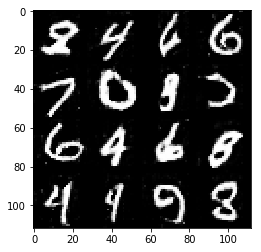

Epoch 18/25... Discriminator Loss: 0.3895... Generator Loss: 1.4698
Epoch 18/25... Discriminator Loss: 0.2501... Generator Loss: 1.9199
Epoch 18/25... Discriminator Loss: 0.2595... Generator Loss: 2.0147
Epoch 18/25... Discriminator Loss: 0.2336... Generator Loss: 2.0986
Epoch 18/25... Discriminator Loss: 0.1576... Generator Loss: 2.5440
Epoch 18/25... Discriminator Loss: 0.1247... Generator Loss: 2.8837
Epoch 18/25... Discriminator Loss: 0.2475... Generator Loss: 1.9347
Epoch 18/25... Discriminator Loss: 0.1754... Generator Loss: 2.3138
Epoch 18/25... Discriminator Loss: 0.1507... Generator Loss: 2.5164
Epoch 18/25... Discriminator Loss: 0.2813... Generator Loss: 1.9189


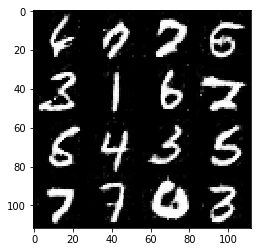

Epoch 18/25... Discriminator Loss: 0.1857... Generator Loss: 2.3707
Epoch 18/25... Discriminator Loss: 0.9038... Generator Loss: 3.5663
Epoch 18/25... Discriminator Loss: 0.2965... Generator Loss: 1.9037
Epoch 18/25... Discriminator Loss: 0.2306... Generator Loss: 2.0959
Epoch 18/25... Discriminator Loss: 0.2659... Generator Loss: 2.1294
Epoch 18/25... Discriminator Loss: 1.1695... Generator Loss: 0.6580
Epoch 18/25... Discriminator Loss: 0.5187... Generator Loss: 2.6562
Epoch 18/25... Discriminator Loss: 1.8272... Generator Loss: 0.7361
Epoch 18/25... Discriminator Loss: 0.2647... Generator Loss: 2.2317
Epoch 18/25... Discriminator Loss: 0.5152... Generator Loss: 2.1183


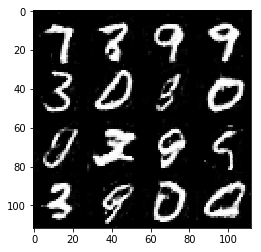

Epoch 18/25... Discriminator Loss: 0.2957... Generator Loss: 1.9894
Epoch 18/25... Discriminator Loss: 0.7506... Generator Loss: 0.9610
Epoch 18/25... Discriminator Loss: 2.2263... Generator Loss: 0.2672
Epoch 18/25... Discriminator Loss: 0.3992... Generator Loss: 1.9833
Epoch 18/25... Discriminator Loss: 0.3810... Generator Loss: 1.7051
Epoch 18/25... Discriminator Loss: 0.1802... Generator Loss: 2.9290
Epoch 18/25... Discriminator Loss: 0.1577... Generator Loss: 2.8249
Epoch 18/25... Discriminator Loss: 0.2531... Generator Loss: 1.9721
Epoch 18/25... Discriminator Loss: 0.3351... Generator Loss: 1.6457
Epoch 18/25... Discriminator Loss: 0.2689... Generator Loss: 1.9984


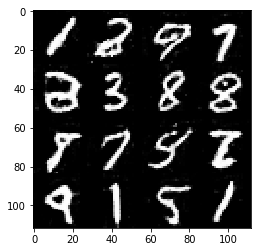

Epoch 18/25... Discriminator Loss: 0.2291... Generator Loss: 2.1693
Epoch 18/25... Discriminator Loss: 0.2736... Generator Loss: 2.0104
Epoch 18/25... Discriminator Loss: 0.3012... Generator Loss: 1.8090
Epoch 18/25... Discriminator Loss: 0.3629... Generator Loss: 1.5463
Epoch 18/25... Discriminator Loss: 0.4557... Generator Loss: 1.3993
Epoch 18/25... Discriminator Loss: 0.2107... Generator Loss: 2.1232
Epoch 18/25... Discriminator Loss: 0.3966... Generator Loss: 1.4568
Epoch 18/25... Discriminator Loss: 0.2660... Generator Loss: 1.9483
Epoch 18/25... Discriminator Loss: 0.2146... Generator Loss: 2.1725
Epoch 18/25... Discriminator Loss: 0.3075... Generator Loss: 1.7808


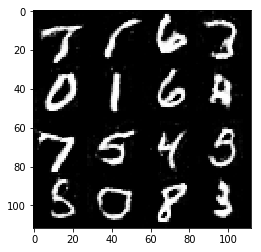

Epoch 18/25... Discriminator Loss: 0.3425... Generator Loss: 1.6223
Epoch 18/25... Discriminator Loss: 0.2254... Generator Loss: 2.0834
Epoch 19/25... Discriminator Loss: 0.2620... Generator Loss: 1.9803
Epoch 19/25... Discriminator Loss: 0.2531... Generator Loss: 1.9974
Epoch 19/25... Discriminator Loss: 0.2084... Generator Loss: 2.1054
Epoch 19/25... Discriminator Loss: 0.3464... Generator Loss: 1.6308
Epoch 19/25... Discriminator Loss: 0.2173... Generator Loss: 2.0883
Epoch 19/25... Discriminator Loss: 0.3204... Generator Loss: 1.6806
Epoch 19/25... Discriminator Loss: 0.1867... Generator Loss: 2.3123
Epoch 19/25... Discriminator Loss: 0.2502... Generator Loss: 1.9653


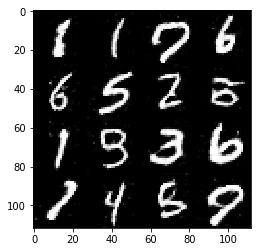

Epoch 19/25... Discriminator Loss: 0.1833... Generator Loss: 2.4162
Epoch 19/25... Discriminator Loss: 0.2947... Generator Loss: 1.7417
Epoch 19/25... Discriminator Loss: 0.2314... Generator Loss: 2.1292
Epoch 19/25... Discriminator Loss: 0.4293... Generator Loss: 1.5684
Epoch 19/25... Discriminator Loss: 0.2699... Generator Loss: 1.8879
Epoch 19/25... Discriminator Loss: 0.2491... Generator Loss: 1.9873
Epoch 19/25... Discriminator Loss: 0.3590... Generator Loss: 1.4997
Epoch 19/25... Discriminator Loss: 0.2236... Generator Loss: 2.0994
Epoch 19/25... Discriminator Loss: 0.1964... Generator Loss: 2.2301
Epoch 19/25... Discriminator Loss: 0.2837... Generator Loss: 1.9058


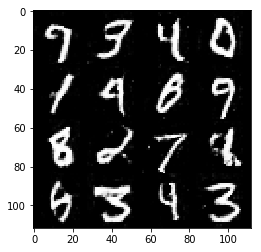

Epoch 19/25... Discriminator Loss: 0.3186... Generator Loss: 1.7637
Epoch 19/25... Discriminator Loss: 0.2163... Generator Loss: 2.1384
Epoch 19/25... Discriminator Loss: 0.1860... Generator Loss: 2.4854
Epoch 19/25... Discriminator Loss: 0.2396... Generator Loss: 1.9717
Epoch 19/25... Discriminator Loss: 0.1606... Generator Loss: 2.3503
Epoch 19/25... Discriminator Loss: 0.2875... Generator Loss: 1.7710
Epoch 19/25... Discriminator Loss: 0.2312... Generator Loss: 2.1134
Epoch 19/25... Discriminator Loss: 0.1995... Generator Loss: 2.3227
Epoch 19/25... Discriminator Loss: 1.4012... Generator Loss: 0.4618
Epoch 19/25... Discriminator Loss: 1.1376... Generator Loss: 0.6283


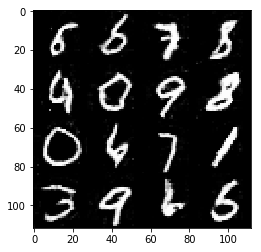

Epoch 19/25... Discriminator Loss: 0.5252... Generator Loss: 1.4182
Epoch 19/25... Discriminator Loss: 0.6309... Generator Loss: 1.1619
Epoch 19/25... Discriminator Loss: 0.2364... Generator Loss: 2.4128
Epoch 19/25... Discriminator Loss: 0.5147... Generator Loss: 2.6138
Epoch 19/25... Discriminator Loss: 0.4013... Generator Loss: 1.7201
Epoch 19/25... Discriminator Loss: 0.4225... Generator Loss: 1.5919
Epoch 19/25... Discriminator Loss: 0.2858... Generator Loss: 1.8924
Epoch 19/25... Discriminator Loss: 0.3041... Generator Loss: 1.8004
Epoch 19/25... Discriminator Loss: 0.2209... Generator Loss: 2.2219
Epoch 19/25... Discriminator Loss: 0.2531... Generator Loss: 1.9544


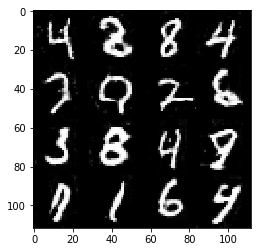

Epoch 19/25... Discriminator Loss: 0.2332... Generator Loss: 3.2543
Epoch 19/25... Discriminator Loss: 0.7610... Generator Loss: 1.3921
Epoch 19/25... Discriminator Loss: 0.5913... Generator Loss: 1.3597
Epoch 19/25... Discriminator Loss: 0.5641... Generator Loss: 2.5656
Epoch 19/25... Discriminator Loss: 0.4892... Generator Loss: 1.9953
Epoch 19/25... Discriminator Loss: 0.5581... Generator Loss: 3.0488
Epoch 19/25... Discriminator Loss: 0.4414... Generator Loss: 2.9492
Epoch 19/25... Discriminator Loss: 2.0843... Generator Loss: 0.2350
Epoch 19/25... Discriminator Loss: 0.4883... Generator Loss: 1.3335
Epoch 20/25... Discriminator Loss: 0.2600... Generator Loss: 1.9863


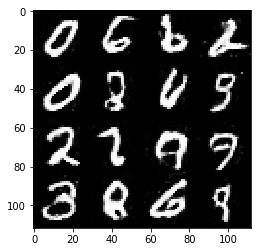

Epoch 20/25... Discriminator Loss: 0.1940... Generator Loss: 2.3341
Epoch 20/25... Discriminator Loss: 0.1477... Generator Loss: 2.5161
Epoch 20/25... Discriminator Loss: 0.3494... Generator Loss: 1.6996
Epoch 20/25... Discriminator Loss: 0.2405... Generator Loss: 2.0255
Epoch 20/25... Discriminator Loss: 0.6851... Generator Loss: 0.9541
Epoch 20/25... Discriminator Loss: 0.3858... Generator Loss: 1.5914
Epoch 20/25... Discriminator Loss: 0.2475... Generator Loss: 2.0155
Epoch 20/25... Discriminator Loss: 0.1117... Generator Loss: 2.8505
Epoch 20/25... Discriminator Loss: 0.4113... Generator Loss: 1.5098
Epoch 20/25... Discriminator Loss: 0.2635... Generator Loss: 1.9921


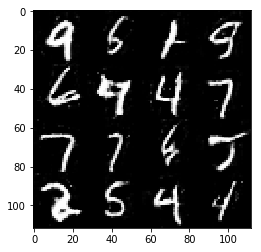

Epoch 20/25... Discriminator Loss: 0.2872... Generator Loss: 1.8420
Epoch 20/25... Discriminator Loss: 0.2721... Generator Loss: 1.8107
Epoch 20/25... Discriminator Loss: 0.4300... Generator Loss: 1.4155
Epoch 20/25... Discriminator Loss: 0.1917... Generator Loss: 2.2334
Epoch 20/25... Discriminator Loss: 0.2685... Generator Loss: 1.9015
Epoch 20/25... Discriminator Loss: 0.7684... Generator Loss: 0.9050
Epoch 20/25... Discriminator Loss: 0.2083... Generator Loss: 2.1239
Epoch 20/25... Discriminator Loss: 0.3772... Generator Loss: 1.5333
Epoch 20/25... Discriminator Loss: 0.2432... Generator Loss: 1.9893
Epoch 20/25... Discriminator Loss: 0.3156... Generator Loss: 1.6933


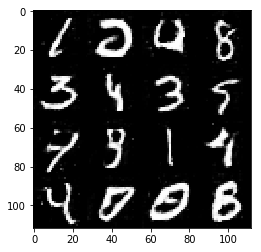

Epoch 20/25... Discriminator Loss: 0.3251... Generator Loss: 1.7481
Epoch 20/25... Discriminator Loss: 0.4077... Generator Loss: 1.4455
Epoch 20/25... Discriminator Loss: 0.2445... Generator Loss: 1.9913
Epoch 20/25... Discriminator Loss: 0.3055... Generator Loss: 1.7709
Epoch 20/25... Discriminator Loss: 0.3200... Generator Loss: 1.7128
Epoch 20/25... Discriminator Loss: 0.3119... Generator Loss: 1.7509
Epoch 20/25... Discriminator Loss: 0.6374... Generator Loss: 1.0148
Epoch 20/25... Discriminator Loss: 0.3838... Generator Loss: 1.5917
Epoch 20/25... Discriminator Loss: 0.5148... Generator Loss: 1.2929
Epoch 20/25... Discriminator Loss: 0.2743... Generator Loss: 1.8644


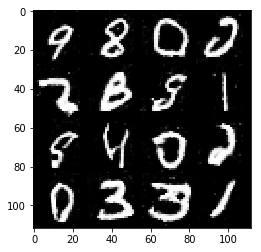

Epoch 20/25... Discriminator Loss: 0.2669... Generator Loss: 1.9125
Epoch 20/25... Discriminator Loss: 0.1790... Generator Loss: 2.3520
Epoch 20/25... Discriminator Loss: 0.2666... Generator Loss: 1.9241
Epoch 20/25... Discriminator Loss: 0.2477... Generator Loss: 1.9271
Epoch 20/25... Discriminator Loss: 0.1639... Generator Loss: 2.5482
Epoch 20/25... Discriminator Loss: 0.3410... Generator Loss: 1.6164
Epoch 20/25... Discriminator Loss: 0.2322... Generator Loss: 2.0070
Epoch 20/25... Discriminator Loss: 0.4485... Generator Loss: 1.4131
Epoch 20/25... Discriminator Loss: 0.2851... Generator Loss: 1.7324
Epoch 20/25... Discriminator Loss: 0.3595... Generator Loss: 1.6408


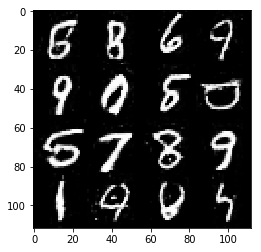

Epoch 20/25... Discriminator Loss: 0.2567... Generator Loss: 1.8726
Epoch 20/25... Discriminator Loss: 0.2310... Generator Loss: 2.0407
Epoch 20/25... Discriminator Loss: 0.1467... Generator Loss: 2.6284
Epoch 20/25... Discriminator Loss: 0.3858... Generator Loss: 1.5128
Epoch 20/25... Discriminator Loss: 0.2215... Generator Loss: 2.0490
Epoch 20/25... Discriminator Loss: 0.2325... Generator Loss: 2.1320
Epoch 21/25... Discriminator Loss: 0.2833... Generator Loss: 1.8182
Epoch 21/25... Discriminator Loss: 0.2613... Generator Loss: 1.9374
Epoch 21/25... Discriminator Loss: 0.2808... Generator Loss: 1.8263
Epoch 21/25... Discriminator Loss: 0.1495... Generator Loss: 2.5319


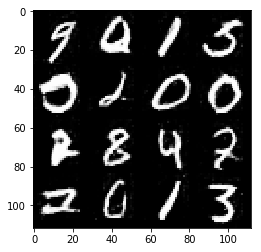

Epoch 21/25... Discriminator Loss: 0.3839... Generator Loss: 1.6394
Epoch 21/25... Discriminator Loss: 0.1710... Generator Loss: 2.8613
Epoch 21/25... Discriminator Loss: 1.8936... Generator Loss: 0.3652
Epoch 21/25... Discriminator Loss: 0.9360... Generator Loss: 1.5952
Epoch 21/25... Discriminator Loss: 0.5403... Generator Loss: 1.4792
Epoch 21/25... Discriminator Loss: 0.3965... Generator Loss: 2.0636
Epoch 21/25... Discriminator Loss: 1.0020... Generator Loss: 0.6777
Epoch 21/25... Discriminator Loss: 0.2375... Generator Loss: 2.3202
Epoch 21/25... Discriminator Loss: 0.2304... Generator Loss: 2.6950
Epoch 21/25... Discriminator Loss: 0.5247... Generator Loss: 1.9835


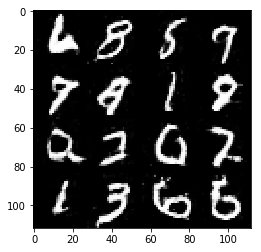

Epoch 21/25... Discriminator Loss: 0.7790... Generator Loss: 3.9275
Epoch 21/25... Discriminator Loss: 0.6178... Generator Loss: 4.5937
Epoch 21/25... Discriminator Loss: 0.1175... Generator Loss: 3.0857
Epoch 21/25... Discriminator Loss: 0.2579... Generator Loss: 2.0547
Epoch 21/25... Discriminator Loss: 0.2796... Generator Loss: 1.9283
Epoch 21/25... Discriminator Loss: 0.2889... Generator Loss: 1.9044
Epoch 21/25... Discriminator Loss: 0.3462... Generator Loss: 1.5567
Epoch 21/25... Discriminator Loss: 0.3202... Generator Loss: 1.7050
Epoch 21/25... Discriminator Loss: 0.4145... Generator Loss: 1.4864
Epoch 21/25... Discriminator Loss: 0.3216... Generator Loss: 1.7841


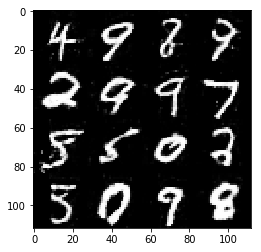

Epoch 21/25... Discriminator Loss: 0.3036... Generator Loss: 1.8375
Epoch 21/25... Discriminator Loss: 0.2992... Generator Loss: 1.8647
Epoch 21/25... Discriminator Loss: 0.3069... Generator Loss: 1.7253
Epoch 21/25... Discriminator Loss: 0.3344... Generator Loss: 1.6130
Epoch 21/25... Discriminator Loss: 0.1299... Generator Loss: 2.8155
Epoch 21/25... Discriminator Loss: 0.3817... Generator Loss: 1.5561
Epoch 21/25... Discriminator Loss: 0.2341... Generator Loss: 1.9733
Epoch 21/25... Discriminator Loss: 0.2326... Generator Loss: 2.0191
Epoch 21/25... Discriminator Loss: 4.5173... Generator Loss: 0.0306
Epoch 21/25... Discriminator Loss: 0.6550... Generator Loss: 2.2085


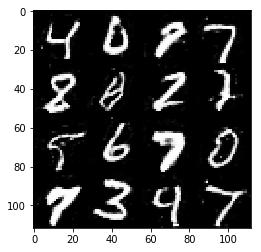

Epoch 21/25... Discriminator Loss: 0.5991... Generator Loss: 2.4307
Epoch 21/25... Discriminator Loss: 0.3068... Generator Loss: 2.3086
Epoch 21/25... Discriminator Loss: 0.3364... Generator Loss: 1.9035
Epoch 21/25... Discriminator Loss: 1.8314... Generator Loss: 0.6083
Epoch 21/25... Discriminator Loss: 0.2243... Generator Loss: 2.4150
Epoch 21/25... Discriminator Loss: 0.2333... Generator Loss: 2.1566
Epoch 21/25... Discriminator Loss: 0.2078... Generator Loss: 2.2384
Epoch 21/25... Discriminator Loss: 0.4867... Generator Loss: 1.3630
Epoch 21/25... Discriminator Loss: 0.4113... Generator Loss: 1.5639
Epoch 21/25... Discriminator Loss: 0.3736... Generator Loss: 1.5573


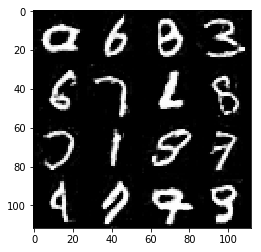

Epoch 21/25... Discriminator Loss: 0.2867... Generator Loss: 1.8618
Epoch 21/25... Discriminator Loss: 0.2554... Generator Loss: 2.0150
Epoch 22/25... Discriminator Loss: 0.4642... Generator Loss: 1.3550
Epoch 22/25... Discriminator Loss: 0.2878... Generator Loss: 1.8593
Epoch 22/25... Discriminator Loss: 0.2977... Generator Loss: 1.7052
Epoch 22/25... Discriminator Loss: 0.2500... Generator Loss: 2.0234
Epoch 22/25... Discriminator Loss: 0.3194... Generator Loss: 1.7277
Epoch 22/25... Discriminator Loss: 0.3072... Generator Loss: 1.7334
Epoch 22/25... Discriminator Loss: 0.3904... Generator Loss: 1.5516
Epoch 22/25... Discriminator Loss: 0.1255... Generator Loss: 2.8078


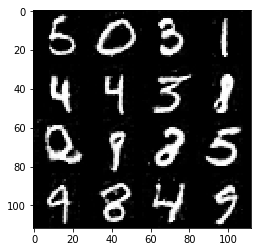

Epoch 22/25... Discriminator Loss: 0.2877... Generator Loss: 1.8361
Epoch 22/25... Discriminator Loss: 0.3290... Generator Loss: 1.6944
Epoch 22/25... Discriminator Loss: 0.3819... Generator Loss: 1.5847
Epoch 22/25... Discriminator Loss: 0.2171... Generator Loss: 2.0883
Epoch 22/25... Discriminator Loss: 0.3052... Generator Loss: 1.8443
Epoch 22/25... Discriminator Loss: 0.2942... Generator Loss: 1.8424
Epoch 22/25... Discriminator Loss: 0.1225... Generator Loss: 2.7773
Epoch 22/25... Discriminator Loss: 0.2782... Generator Loss: 1.9055
Epoch 22/25... Discriminator Loss: 0.3638... Generator Loss: 1.6277
Epoch 22/25... Discriminator Loss: 0.4882... Generator Loss: 1.3541


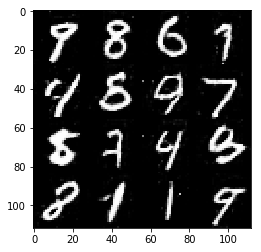

Epoch 22/25... Discriminator Loss: 0.2700... Generator Loss: 1.9176
Epoch 22/25... Discriminator Loss: 0.1732... Generator Loss: 2.3259
Epoch 22/25... Discriminator Loss: 0.2196... Generator Loss: 2.0742
Epoch 22/25... Discriminator Loss: 0.3157... Generator Loss: 1.6955
Epoch 22/25... Discriminator Loss: 0.1757... Generator Loss: 2.4829
Epoch 22/25... Discriminator Loss: 0.2032... Generator Loss: 2.2166
Epoch 22/25... Discriminator Loss: 0.4474... Generator Loss: 1.3009
Epoch 22/25... Discriminator Loss: 0.2641... Generator Loss: 1.9475
Epoch 22/25... Discriminator Loss: 0.2140... Generator Loss: 2.0647
Epoch 22/25... Discriminator Loss: 0.2280... Generator Loss: 2.0081


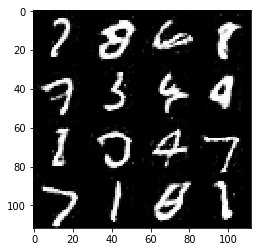

Epoch 22/25... Discriminator Loss: 0.2168... Generator Loss: 2.1971
Epoch 22/25... Discriminator Loss: 0.3666... Generator Loss: 1.6185
Epoch 22/25... Discriminator Loss: 0.2970... Generator Loss: 1.8266
Epoch 22/25... Discriminator Loss: 0.1516... Generator Loss: 2.5831
Epoch 22/25... Discriminator Loss: 0.3686... Generator Loss: 1.7112
Epoch 22/25... Discriminator Loss: 0.2663... Generator Loss: 1.8729
Epoch 22/25... Discriminator Loss: 0.3347... Generator Loss: 1.5915
Epoch 22/25... Discriminator Loss: 0.3284... Generator Loss: 1.7888
Epoch 22/25... Discriminator Loss: 0.2847... Generator Loss: 1.8597
Epoch 22/25... Discriminator Loss: 0.2225... Generator Loss: 2.0173


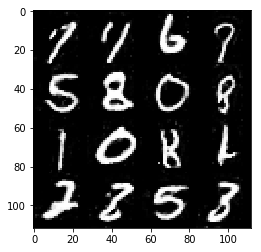

Epoch 22/25... Discriminator Loss: 0.2390... Generator Loss: 2.0238
Epoch 22/25... Discriminator Loss: 0.3017... Generator Loss: 1.7856
Epoch 22/25... Discriminator Loss: 0.4041... Generator Loss: 1.4698
Epoch 22/25... Discriminator Loss: 0.2951... Generator Loss: 1.7932
Epoch 22/25... Discriminator Loss: 0.1581... Generator Loss: 2.4854
Epoch 22/25... Discriminator Loss: 6.1881... Generator Loss: 0.0083
Epoch 22/25... Discriminator Loss: 0.4222... Generator Loss: 2.6031
Epoch 22/25... Discriminator Loss: 0.2455... Generator Loss: 2.3069
Epoch 22/25... Discriminator Loss: 1.6442... Generator Loss: 5.9796
Epoch 23/25... Discriminator Loss: 0.2265... Generator Loss: 3.3088


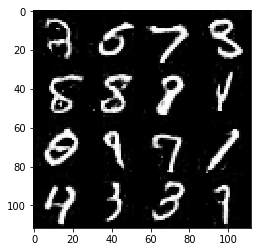

Epoch 23/25... Discriminator Loss: 0.3861... Generator Loss: 1.5234
Epoch 23/25... Discriminator Loss: 0.9997... Generator Loss: 0.7856
Epoch 23/25... Discriminator Loss: 1.4886... Generator Loss: 0.4445
Epoch 23/25... Discriminator Loss: 0.3199... Generator Loss: 1.9959
Epoch 23/25... Discriminator Loss: 0.4386... Generator Loss: 1.3954
Epoch 23/25... Discriminator Loss: 0.1665... Generator Loss: 2.6818
Epoch 23/25... Discriminator Loss: 0.3315... Generator Loss: 1.6362
Epoch 23/25... Discriminator Loss: 0.3506... Generator Loss: 1.7741
Epoch 23/25... Discriminator Loss: 0.2312... Generator Loss: 2.0880
Epoch 23/25... Discriminator Loss: 0.2610... Generator Loss: 1.9924


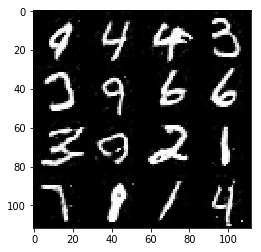

Epoch 23/25... Discriminator Loss: 0.3488... Generator Loss: 1.6890
Epoch 23/25... Discriminator Loss: 0.1963... Generator Loss: 2.2388
Epoch 23/25... Discriminator Loss: 0.2078... Generator Loss: 2.1205
Epoch 23/25... Discriminator Loss: 0.3044... Generator Loss: 1.8617
Epoch 23/25... Discriminator Loss: 0.2912... Generator Loss: 1.8804
Epoch 23/25... Discriminator Loss: 0.2524... Generator Loss: 1.9925
Epoch 23/25... Discriminator Loss: 0.1815... Generator Loss: 2.5577
Epoch 23/25... Discriminator Loss: 1.0547... Generator Loss: 2.8128
Epoch 23/25... Discriminator Loss: 0.5256... Generator Loss: 1.3153
Epoch 23/25... Discriminator Loss: 0.4546... Generator Loss: 1.7201


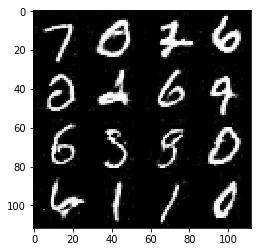

Epoch 23/25... Discriminator Loss: 0.3201... Generator Loss: 2.2445
Epoch 23/25... Discriminator Loss: 0.2787... Generator Loss: 2.4719
Epoch 23/25... Discriminator Loss: 0.2359... Generator Loss: 2.6801
Epoch 23/25... Discriminator Loss: 0.4032... Generator Loss: 1.5081
Epoch 23/25... Discriminator Loss: 0.3708... Generator Loss: 1.6153
Epoch 23/25... Discriminator Loss: 0.6112... Generator Loss: 1.1872
Epoch 23/25... Discriminator Loss: 0.4467... Generator Loss: 1.4229
Epoch 23/25... Discriminator Loss: 0.2807... Generator Loss: 1.8908
Epoch 23/25... Discriminator Loss: 0.2131... Generator Loss: 2.2751
Epoch 23/25... Discriminator Loss: 0.2765... Generator Loss: 1.8403


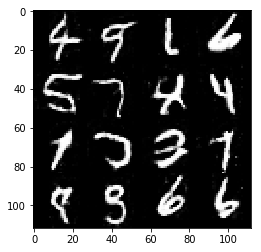

Epoch 23/25... Discriminator Loss: 0.2598... Generator Loss: 1.9509
Epoch 23/25... Discriminator Loss: 0.2909... Generator Loss: 1.9116
Epoch 23/25... Discriminator Loss: 0.3428... Generator Loss: 1.6741
Epoch 23/25... Discriminator Loss: 0.3617... Generator Loss: 1.5095
Epoch 23/25... Discriminator Loss: 0.3146... Generator Loss: 1.7400
Epoch 23/25... Discriminator Loss: 0.2772... Generator Loss: 1.9051
Epoch 23/25... Discriminator Loss: 0.3708... Generator Loss: 1.5487
Epoch 23/25... Discriminator Loss: 0.3059... Generator Loss: 1.7441
Epoch 23/25... Discriminator Loss: 0.3723... Generator Loss: 1.5306
Epoch 23/25... Discriminator Loss: 0.1299... Generator Loss: 2.8274


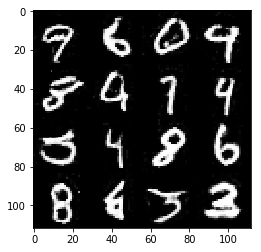

Epoch 23/25... Discriminator Loss: 0.2182... Generator Loss: 2.0984
Epoch 23/25... Discriminator Loss: 0.4555... Generator Loss: 1.4205
Epoch 23/25... Discriminator Loss: 0.3672... Generator Loss: 1.6952
Epoch 23/25... Discriminator Loss: 0.5479... Generator Loss: 1.1563
Epoch 23/25... Discriminator Loss: 0.3523... Generator Loss: 1.6555
Epoch 23/25... Discriminator Loss: 0.2330... Generator Loss: 2.0251
Epoch 24/25... Discriminator Loss: 0.4220... Generator Loss: 1.4343
Epoch 24/25... Discriminator Loss: 0.2136... Generator Loss: 2.2578
Epoch 24/25... Discriminator Loss: 0.1917... Generator Loss: 2.3072
Epoch 24/25... Discriminator Loss: 0.4610... Generator Loss: 1.3647


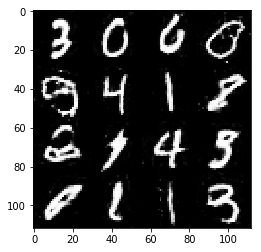

Epoch 24/25... Discriminator Loss: 7.2606... Generator Loss: 11.4420
Epoch 24/25... Discriminator Loss: 0.3525... Generator Loss: 2.8557
Epoch 24/25... Discriminator Loss: 0.1956... Generator Loss: 2.4000
Epoch 24/25... Discriminator Loss: 0.3478... Generator Loss: 1.7888
Epoch 24/25... Discriminator Loss: 6.6210... Generator Loss: 9.5773
Epoch 24/25... Discriminator Loss: 0.5918... Generator Loss: 2.2007
Epoch 24/25... Discriminator Loss: 0.3689... Generator Loss: 1.7443
Epoch 24/25... Discriminator Loss: 0.3369... Generator Loss: 1.6999
Epoch 24/25... Discriminator Loss: 0.3522... Generator Loss: 1.8178
Epoch 24/25... Discriminator Loss: 0.2318... Generator Loss: 2.1479


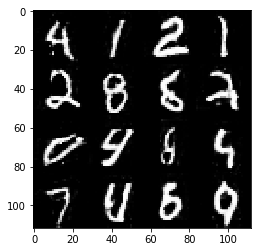

Epoch 24/25... Discriminator Loss: 4.4113... Generator Loss: 9.5095
Epoch 24/25... Discriminator Loss: 0.6229... Generator Loss: 2.1400
Epoch 24/25... Discriminator Loss: 0.3921... Generator Loss: 1.6401
Epoch 24/25... Discriminator Loss: 0.3179... Generator Loss: 1.8117
Epoch 24/25... Discriminator Loss: 1.4616... Generator Loss: 5.9057
Epoch 24/25... Discriminator Loss: 0.4626... Generator Loss: 3.9412
Epoch 24/25... Discriminator Loss: 0.3823... Generator Loss: 1.7475
Epoch 24/25... Discriminator Loss: 0.1810... Generator Loss: 2.5599
Epoch 24/25... Discriminator Loss: 0.2360... Generator Loss: 2.1174
Epoch 24/25... Discriminator Loss: 0.2548... Generator Loss: 2.0056


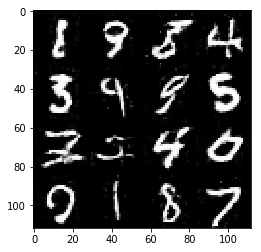

Epoch 24/25... Discriminator Loss: 0.6448... Generator Loss: 1.0977
Epoch 24/25... Discriminator Loss: 0.2541... Generator Loss: 1.9687
Epoch 24/25... Discriminator Loss: 0.2162... Generator Loss: 2.2347
Epoch 24/25... Discriminator Loss: 0.5030... Generator Loss: 1.3533
Epoch 24/25... Discriminator Loss: 0.3365... Generator Loss: 1.7461
Epoch 24/25... Discriminator Loss: 0.5630... Generator Loss: 1.1557
Epoch 24/25... Discriminator Loss: 0.2840... Generator Loss: 1.8689
Epoch 24/25... Discriminator Loss: 0.3169... Generator Loss: 1.6816
Epoch 24/25... Discriminator Loss: 0.4907... Generator Loss: 1.2855
Epoch 24/25... Discriminator Loss: 0.3146... Generator Loss: 1.8091


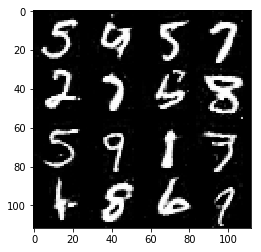

Epoch 24/25... Discriminator Loss: 0.2530... Generator Loss: 1.9864
Epoch 24/25... Discriminator Loss: 0.3622... Generator Loss: 1.6729
Epoch 24/25... Discriminator Loss: 0.4811... Generator Loss: 1.2687
Epoch 24/25... Discriminator Loss: 0.2160... Generator Loss: 2.1631
Epoch 24/25... Discriminator Loss: 0.1888... Generator Loss: 2.2203
Epoch 24/25... Discriminator Loss: 0.2702... Generator Loss: 1.9308
Epoch 24/25... Discriminator Loss: 0.1713... Generator Loss: 2.4020
Epoch 24/25... Discriminator Loss: 0.3151... Generator Loss: 1.7596
Epoch 24/25... Discriminator Loss: 0.8147... Generator Loss: 0.8852
Epoch 24/25... Discriminator Loss: 0.3703... Generator Loss: 1.5002


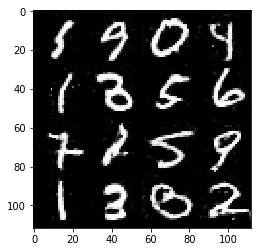

Epoch 24/25... Discriminator Loss: 0.1674... Generator Loss: 2.3788
Epoch 24/25... Discriminator Loss: 0.2728... Generator Loss: 1.9544
Epoch 24/25... Discriminator Loss: 0.7080... Generator Loss: 1.0012
Epoch 25/25... Discriminator Loss: 0.2954... Generator Loss: 1.7993
Epoch 25/25... Discriminator Loss: 0.2612... Generator Loss: 1.9257
Epoch 25/25... Discriminator Loss: 0.1935... Generator Loss: 2.2513
Epoch 25/25... Discriminator Loss: 0.2277... Generator Loss: 2.0972
Epoch 25/25... Discriminator Loss: 0.2051... Generator Loss: 2.1494
Epoch 25/25... Discriminator Loss: 0.2146... Generator Loss: 2.2632
Epoch 25/25... Discriminator Loss: 0.4694... Generator Loss: 1.3276


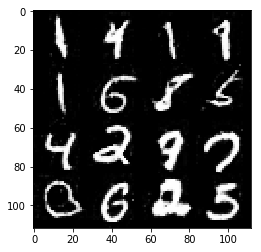

Epoch 25/25... Discriminator Loss: 0.2356... Generator Loss: 1.9833
Epoch 25/25... Discriminator Loss: 0.2119... Generator Loss: 2.0977
Epoch 25/25... Discriminator Loss: 0.1885... Generator Loss: 2.2870
Epoch 25/25... Discriminator Loss: 0.2548... Generator Loss: 2.0273
Epoch 25/25... Discriminator Loss: 0.3054... Generator Loss: 1.7883
Epoch 25/25... Discriminator Loss: 0.1493... Generator Loss: 2.4534
Epoch 25/25... Discriminator Loss: 0.4439... Generator Loss: 1.3696
Epoch 25/25... Discriminator Loss: 0.2440... Generator Loss: 2.0082
Epoch 25/25... Discriminator Loss: 0.5075... Generator Loss: 1.2021
Epoch 25/25... Discriminator Loss: 0.6266... Generator Loss: 1.0901


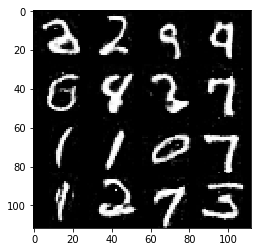

Epoch 25/25... Discriminator Loss: 0.1205... Generator Loss: 2.7701
Epoch 25/25... Discriminator Loss: 0.2592... Generator Loss: 1.9289
Epoch 25/25... Discriminator Loss: 0.2752... Generator Loss: 1.8994
Epoch 25/25... Discriminator Loss: 0.4331... Generator Loss: 1.4182
Epoch 25/25... Discriminator Loss: 0.2643... Generator Loss: 1.9158
Epoch 25/25... Discriminator Loss: 0.6786... Generator Loss: 0.9810
Epoch 25/25... Discriminator Loss: 0.2129... Generator Loss: 2.1366
Epoch 25/25... Discriminator Loss: 0.3768... Generator Loss: 1.6216
Epoch 25/25... Discriminator Loss: 0.3368... Generator Loss: 1.6400
Epoch 25/25... Discriminator Loss: 0.2752... Generator Loss: 1.8340


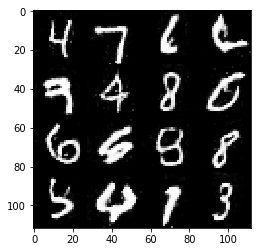

Epoch 25/25... Discriminator Loss: 0.5246... Generator Loss: 1.2652
Epoch 25/25... Discriminator Loss: 8.3420... Generator Loss: 0.0008
Epoch 25/25... Discriminator Loss: 0.5525... Generator Loss: 1.6324
Epoch 25/25... Discriminator Loss: 1.9324... Generator Loss: 0.3054
Epoch 25/25... Discriminator Loss: 0.3545... Generator Loss: 1.9007
Epoch 25/25... Discriminator Loss: 0.8381... Generator Loss: 0.9350
Epoch 25/25... Discriminator Loss: 0.5379... Generator Loss: 3.9277
Epoch 25/25... Discriminator Loss: 0.1666... Generator Loss: 2.6666
Epoch 25/25... Discriminator Loss: 0.2364... Generator Loss: 2.2938
Epoch 25/25... Discriminator Loss: 0.4250... Generator Loss: 1.5081


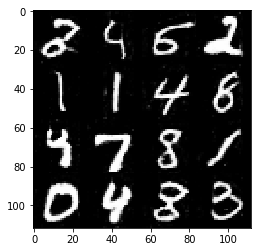

Epoch 25/25... Discriminator Loss: 0.2307... Generator Loss: 2.1037
Epoch 25/25... Discriminator Loss: 0.3046... Generator Loss: 1.8244
Epoch 25/25... Discriminator Loss: 0.1829... Generator Loss: 2.4113
Epoch 25/25... Discriminator Loss: 0.4608... Generator Loss: 1.4109
Epoch 25/25... Discriminator Loss: 0.3209... Generator Loss: 1.6960
Epoch 25/25... Discriminator Loss: 0.1869... Generator Loss: 2.2771
Epoch 25/25... Discriminator Loss: 0.1962... Generator Loss: 2.3193
Epoch 25/25... Discriminator Loss: 0.4631... Generator Loss: 1.3460
Epoch 25/25... Discriminator Loss: 0.3018... Generator Loss: 1.8627
Epoch 25/25... Discriminator Loss: 0.2031... Generator Loss: 2.2212


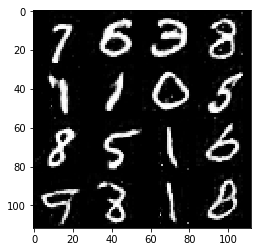

In [14]:
batch_size = 128
z_dim = 100
learning_rate = 0.0002
beta1 = 0.5


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
epochs = 25

mnist_dataset = helper.Dataset('mnist', glob(os.path.join(data_dir, 'mnist/*.jpg')))
with tf.Graph().as_default():
    train(epochs, batch_size, z_dim, learning_rate, beta1, mnist_dataset.get_batches,
          mnist_dataset.shape, mnist_dataset.image_mode)

### CelebA
Run your GANs on CelebA.  It will take around 20 minutes on the average GPU to run one epoch.  You can run the whole epoch or stop when it starts to generate realistic faces.

Epoch 1/25... Discriminator Loss: 0.2523... Generator Loss: 2.1335
Epoch 1/25... Discriminator Loss: 0.2345... Generator Loss: 2.5859
Epoch 1/25... Discriminator Loss: 0.1414... Generator Loss: 2.8378
Epoch 1/25... Discriminator Loss: 0.2350... Generator Loss: 2.1567
Epoch 1/25... Discriminator Loss: 0.9302... Generator Loss: 4.1855
Epoch 1/25... Discriminator Loss: 0.7644... Generator Loss: 0.9995
Epoch 1/25... Discriminator Loss: 0.8030... Generator Loss: 1.8711
Epoch 1/25... Discriminator Loss: 0.7564... Generator Loss: 1.5392
Epoch 1/25... Discriminator Loss: 0.8022... Generator Loss: 0.9626
Epoch 1/25... Discriminator Loss: 0.9258... Generator Loss: 0.7603


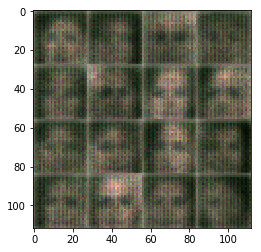

Epoch 1/25... Discriminator Loss: 1.3970... Generator Loss: 0.4593
Epoch 1/25... Discriminator Loss: 0.7925... Generator Loss: 1.2189
Epoch 1/25... Discriminator Loss: 0.8237... Generator Loss: 1.0409
Epoch 1/25... Discriminator Loss: 0.8173... Generator Loss: 0.9591
Epoch 1/25... Discriminator Loss: 2.0736... Generator Loss: 5.2187
Epoch 1/25... Discriminator Loss: 0.7682... Generator Loss: 1.6597
Epoch 1/25... Discriminator Loss: 1.3693... Generator Loss: 0.4571
Epoch 1/25... Discriminator Loss: 0.8479... Generator Loss: 0.7708
Epoch 1/25... Discriminator Loss: 0.5541... Generator Loss: 1.8072
Epoch 1/25... Discriminator Loss: 0.5206... Generator Loss: 1.6740


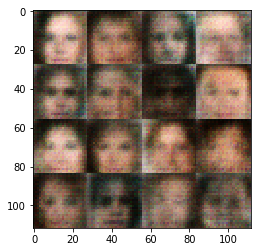

Epoch 1/25... Discriminator Loss: 0.8439... Generator Loss: 1.4806
Epoch 1/25... Discriminator Loss: 0.6407... Generator Loss: 1.7030
Epoch 1/25... Discriminator Loss: 0.9235... Generator Loss: 1.9761
Epoch 1/25... Discriminator Loss: 1.5641... Generator Loss: 0.3323
Epoch 1/25... Discriminator Loss: 0.4617... Generator Loss: 1.6669
Epoch 1/25... Discriminator Loss: 0.6578... Generator Loss: 1.5062
Epoch 1/25... Discriminator Loss: 0.9304... Generator Loss: 2.3159
Epoch 1/25... Discriminator Loss: 0.7633... Generator Loss: 0.9612
Epoch 1/25... Discriminator Loss: 1.2290... Generator Loss: 0.5102
Epoch 1/25... Discriminator Loss: 0.6645... Generator Loss: 1.3688


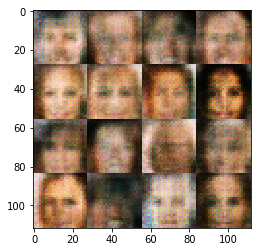

Epoch 1/25... Discriminator Loss: 0.8733... Generator Loss: 0.9441
Epoch 1/25... Discriminator Loss: 1.2427... Generator Loss: 0.5330
Epoch 1/25... Discriminator Loss: 0.9053... Generator Loss: 1.0639
Epoch 1/25... Discriminator Loss: 1.0067... Generator Loss: 1.1885
Epoch 1/25... Discriminator Loss: 1.1669... Generator Loss: 0.5253
Epoch 1/25... Discriminator Loss: 0.8459... Generator Loss: 2.9117
Epoch 1/25... Discriminator Loss: 0.7969... Generator Loss: 1.0851
Epoch 1/25... Discriminator Loss: 0.9478... Generator Loss: 0.8359
Epoch 1/25... Discriminator Loss: 0.8267... Generator Loss: 1.2837
Epoch 1/25... Discriminator Loss: 0.8335... Generator Loss: 1.1564


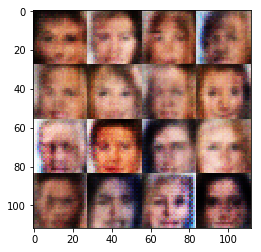

Epoch 1/25... Discriminator Loss: 1.0929... Generator Loss: 1.3966
Epoch 1/25... Discriminator Loss: 0.9483... Generator Loss: 1.2949
Epoch 1/25... Discriminator Loss: 0.8595... Generator Loss: 0.9732
Epoch 1/25... Discriminator Loss: 0.9140... Generator Loss: 0.7213
Epoch 1/25... Discriminator Loss: 0.8839... Generator Loss: 1.0865
Epoch 1/25... Discriminator Loss: 0.9403... Generator Loss: 1.0803
Epoch 1/25... Discriminator Loss: 1.0028... Generator Loss: 1.2776
Epoch 1/25... Discriminator Loss: 1.2314... Generator Loss: 0.9383
Epoch 1/25... Discriminator Loss: 0.9963... Generator Loss: 1.1409
Epoch 1/25... Discriminator Loss: 1.0338... Generator Loss: 1.6158


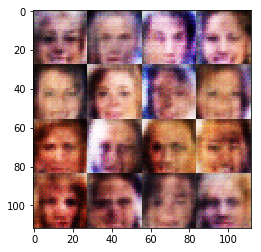

Epoch 1/25... Discriminator Loss: 1.1690... Generator Loss: 0.7056
Epoch 1/25... Discriminator Loss: 1.2569... Generator Loss: 1.5587
Epoch 1/25... Discriminator Loss: 1.1103... Generator Loss: 1.0777
Epoch 1/25... Discriminator Loss: 1.0164... Generator Loss: 0.9733
Epoch 1/25... Discriminator Loss: 0.9243... Generator Loss: 0.9999
Epoch 1/25... Discriminator Loss: 1.1787... Generator Loss: 0.8932
Epoch 1/25... Discriminator Loss: 1.1713... Generator Loss: 0.6724
Epoch 1/25... Discriminator Loss: 1.2892... Generator Loss: 0.6004
Epoch 1/25... Discriminator Loss: 1.5075... Generator Loss: 2.1510
Epoch 1/25... Discriminator Loss: 1.1010... Generator Loss: 0.7434


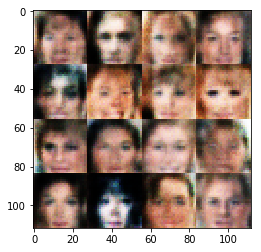

Epoch 1/25... Discriminator Loss: 1.0843... Generator Loss: 1.0346
Epoch 1/25... Discriminator Loss: 1.0946... Generator Loss: 0.8874
Epoch 1/25... Discriminator Loss: 1.1525... Generator Loss: 0.6588
Epoch 1/25... Discriminator Loss: 1.0759... Generator Loss: 1.8635
Epoch 1/25... Discriminator Loss: 1.2296... Generator Loss: 0.7318
Epoch 1/25... Discriminator Loss: 0.9398... Generator Loss: 0.9916
Epoch 1/25... Discriminator Loss: 0.9891... Generator Loss: 1.4035
Epoch 1/25... Discriminator Loss: 1.0402... Generator Loss: 1.3090
Epoch 1/25... Discriminator Loss: 0.9581... Generator Loss: 1.2516
Epoch 1/25... Discriminator Loss: 0.9443... Generator Loss: 0.9727


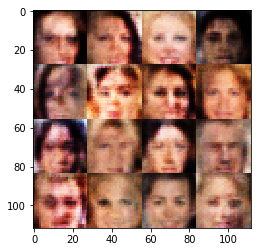

Epoch 1/25... Discriminator Loss: 0.8950... Generator Loss: 1.3352
Epoch 1/25... Discriminator Loss: 0.9667... Generator Loss: 0.8598
Epoch 1/25... Discriminator Loss: 0.8885... Generator Loss: 1.3040
Epoch 1/25... Discriminator Loss: 0.9762... Generator Loss: 0.8123
Epoch 1/25... Discriminator Loss: 1.4087... Generator Loss: 0.3934
Epoch 1/25... Discriminator Loss: 0.9320... Generator Loss: 0.9827
Epoch 1/25... Discriminator Loss: 1.0422... Generator Loss: 0.7865
Epoch 1/25... Discriminator Loss: 1.0001... Generator Loss: 0.8549
Epoch 1/25... Discriminator Loss: 0.8980... Generator Loss: 1.2650
Epoch 1/25... Discriminator Loss: 0.8707... Generator Loss: 0.9108


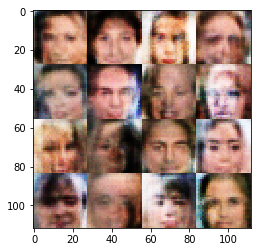

Epoch 1/25... Discriminator Loss: 0.9089... Generator Loss: 1.4260
Epoch 1/25... Discriminator Loss: 1.0446... Generator Loss: 0.9327
Epoch 1/25... Discriminator Loss: 1.2459... Generator Loss: 0.5264
Epoch 1/25... Discriminator Loss: 0.7691... Generator Loss: 1.1724
Epoch 1/25... Discriminator Loss: 0.7377... Generator Loss: 1.0001
Epoch 1/25... Discriminator Loss: 0.6352... Generator Loss: 1.4974
Epoch 1/25... Discriminator Loss: 1.7950... Generator Loss: 0.2352
Epoch 1/25... Discriminator Loss: 0.8428... Generator Loss: 1.0779
Epoch 1/25... Discriminator Loss: 0.7746... Generator Loss: 0.9452
Epoch 1/25... Discriminator Loss: 0.8644... Generator Loss: 0.8095


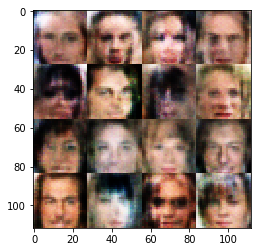

Epoch 1/25... Discriminator Loss: 0.7085... Generator Loss: 1.5341
Epoch 1/25... Discriminator Loss: 0.6507... Generator Loss: 1.8827
Epoch 1/25... Discriminator Loss: 0.8365... Generator Loss: 0.7306
Epoch 1/25... Discriminator Loss: 0.4059... Generator Loss: 1.6796
Epoch 1/25... Discriminator Loss: 0.7809... Generator Loss: 2.0786
Epoch 1/25... Discriminator Loss: 0.7938... Generator Loss: 1.2413
Epoch 1/25... Discriminator Loss: 0.2776... Generator Loss: 2.4261
Epoch 1/25... Discriminator Loss: 0.5718... Generator Loss: 1.1781
Epoch 1/25... Discriminator Loss: 0.3539... Generator Loss: 2.4317
Epoch 1/25... Discriminator Loss: 0.4524... Generator Loss: 3.1601


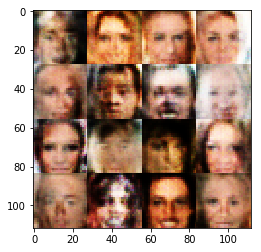

Epoch 1/25... Discriminator Loss: 0.5465... Generator Loss: 4.5752
Epoch 1/25... Discriminator Loss: 1.0112... Generator Loss: 4.7622
Epoch 1/25... Discriminator Loss: 0.3777... Generator Loss: 1.9313
Epoch 1/25... Discriminator Loss: 1.6102... Generator Loss: 0.2782
Epoch 1/25... Discriminator Loss: 0.8190... Generator Loss: 0.7582
Epoch 1/25... Discriminator Loss: 1.1728... Generator Loss: 0.5559
Epoch 1/25... Discriminator Loss: 0.6178... Generator Loss: 3.3708
Epoch 1/25... Discriminator Loss: 0.5888... Generator Loss: 1.0189
Epoch 1/25... Discriminator Loss: 1.9059... Generator Loss: 0.1931
Epoch 1/25... Discriminator Loss: 0.2259... Generator Loss: 2.2430


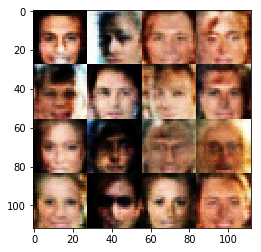

Epoch 1/25... Discriminator Loss: 0.1576... Generator Loss: 4.2988
Epoch 1/25... Discriminator Loss: 0.1742... Generator Loss: 2.7586
Epoch 1/25... Discriminator Loss: 0.2625... Generator Loss: 5.2986
Epoch 1/25... Discriminator Loss: 0.8999... Generator Loss: 0.6694
Epoch 1/25... Discriminator Loss: 0.7195... Generator Loss: 0.9413
Epoch 1/25... Discriminator Loss: 3.4702... Generator Loss: 0.0412
Epoch 1/25... Discriminator Loss: 0.5537... Generator Loss: 1.1401
Epoch 1/25... Discriminator Loss: 1.2242... Generator Loss: 0.4444
Epoch 1/25... Discriminator Loss: 0.5841... Generator Loss: 1.4308
Epoch 1/25... Discriminator Loss: 0.1313... Generator Loss: 4.4701


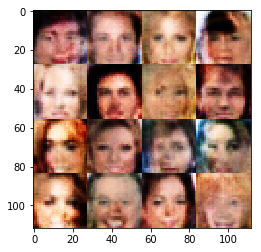

Epoch 1/25... Discriminator Loss: 0.1439... Generator Loss: 3.0483
Epoch 1/25... Discriminator Loss: 0.5447... Generator Loss: 1.0611
Epoch 1/25... Discriminator Loss: 0.5220... Generator Loss: 1.0660
Epoch 1/25... Discriminator Loss: 0.0916... Generator Loss: 3.6058
Epoch 1/25... Discriminator Loss: 0.6652... Generator Loss: 1.0474
Epoch 1/25... Discriminator Loss: 1.2583... Generator Loss: 0.4596
Epoch 1/25... Discriminator Loss: 0.1641... Generator Loss: 3.8143
Epoch 1/25... Discriminator Loss: 0.8937... Generator Loss: 0.6856
Epoch 1/25... Discriminator Loss: 0.9531... Generator Loss: 0.6650
Epoch 1/25... Discriminator Loss: 1.0586... Generator Loss: 0.5420


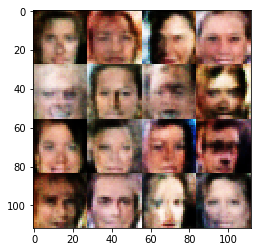

Epoch 1/25... Discriminator Loss: 0.8408... Generator Loss: 0.8043
Epoch 1/25... Discriminator Loss: 0.5922... Generator Loss: 1.2430
Epoch 1/25... Discriminator Loss: 1.0413... Generator Loss: 0.5325
Epoch 1/25... Discriminator Loss: 0.5351... Generator Loss: 1.0986
Epoch 1/25... Discriminator Loss: 0.1288... Generator Loss: 5.1642
Epoch 1/25... Discriminator Loss: 0.7630... Generator Loss: 0.7328
Epoch 1/25... Discriminator Loss: 0.1852... Generator Loss: 3.1521
Epoch 1/25... Discriminator Loss: 0.2939... Generator Loss: 2.0188
Epoch 1/25... Discriminator Loss: 0.2972... Generator Loss: 1.8466
Epoch 1/25... Discriminator Loss: 0.0664... Generator Loss: 5.8065


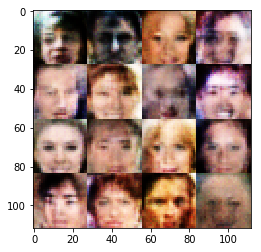

Epoch 1/25... Discriminator Loss: 0.1200... Generator Loss: 5.2157
Epoch 1/25... Discriminator Loss: 0.4444... Generator Loss: 4.8951
Epoch 1/25... Discriminator Loss: 1.4992... Generator Loss: 7.3781
Epoch 1/25... Discriminator Loss: 0.1753... Generator Loss: 4.0586
Epoch 1/25... Discriminator Loss: 1.1272... Generator Loss: 8.3629
Epoch 1/25... Discriminator Loss: 0.2977... Generator Loss: 7.1392
Epoch 1/25... Discriminator Loss: 0.0779... Generator Loss: 5.0725
Epoch 1/25... Discriminator Loss: 1.1120... Generator Loss: 3.6619
Epoch 1/25... Discriminator Loss: 0.5289... Generator Loss: 1.0970
Epoch 1/25... Discriminator Loss: 0.0892... Generator Loss: 5.0829


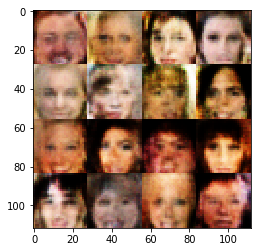

Epoch 1/25... Discriminator Loss: 0.0586... Generator Loss: 4.0398
Epoch 1/25... Discriminator Loss: 0.4184... Generator Loss: 7.3099
Epoch 1/25... Discriminator Loss: 0.2324... Generator Loss: 3.4858
Epoch 1/25... Discriminator Loss: 0.0813... Generator Loss: 3.7466
Epoch 1/25... Discriminator Loss: 0.2909... Generator Loss: 1.7338
Epoch 1/25... Discriminator Loss: 0.0752... Generator Loss: 4.2545
Epoch 1/25... Discriminator Loss: 0.0829... Generator Loss: 3.5340
Epoch 1/25... Discriminator Loss: 0.4203... Generator Loss: 1.3850
Epoch 2/25... Discriminator Loss: 0.2214... Generator Loss: 5.7593
Epoch 2/25... Discriminator Loss: 0.6451... Generator Loss: 0.8954


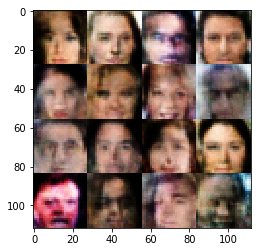

Epoch 2/25... Discriminator Loss: 1.5880... Generator Loss: 0.3083
Epoch 2/25... Discriminator Loss: 1.6685... Generator Loss: 6.6399
Epoch 2/25... Discriminator Loss: 0.1781... Generator Loss: 3.1029
Epoch 2/25... Discriminator Loss: 0.3253... Generator Loss: 4.5272
Epoch 2/25... Discriminator Loss: 0.4354... Generator Loss: 1.4530
Epoch 2/25... Discriminator Loss: 0.4043... Generator Loss: 1.6485
Epoch 2/25... Discriminator Loss: 0.2052... Generator Loss: 2.3092
Epoch 2/25... Discriminator Loss: 0.1295... Generator Loss: 3.1237
Epoch 2/25... Discriminator Loss: 0.0721... Generator Loss: 5.3169
Epoch 2/25... Discriminator Loss: 0.1295... Generator Loss: 3.5295


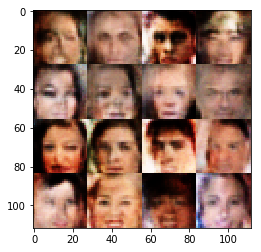

Epoch 2/25... Discriminator Loss: 0.0809... Generator Loss: 6.8294
Epoch 2/25... Discriminator Loss: 0.1626... Generator Loss: 5.6697
Epoch 2/25... Discriminator Loss: 1.1111... Generator Loss: 0.5217
Epoch 2/25... Discriminator Loss: 0.5405... Generator Loss: 1.1087
Epoch 2/25... Discriminator Loss: 0.2801... Generator Loss: 6.0250
Epoch 2/25... Discriminator Loss: 0.2515... Generator Loss: 2.1608
Epoch 2/25... Discriminator Loss: 0.2183... Generator Loss: 3.1808
Epoch 2/25... Discriminator Loss: 0.5674... Generator Loss: 1.0432
Epoch 2/25... Discriminator Loss: 0.1342... Generator Loss: 3.8401
Epoch 2/25... Discriminator Loss: 0.1205... Generator Loss: 6.0488


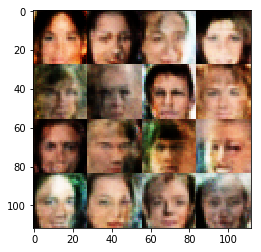

Epoch 2/25... Discriminator Loss: 1.3984... Generator Loss: 0.3631
Epoch 2/25... Discriminator Loss: 0.3407... Generator Loss: 1.6408
Epoch 2/25... Discriminator Loss: 1.1625... Generator Loss: 0.4632
Epoch 2/25... Discriminator Loss: 0.0897... Generator Loss: 5.0704
Epoch 2/25... Discriminator Loss: 0.0894... Generator Loss: 5.6825
Epoch 2/25... Discriminator Loss: 0.4105... Generator Loss: 6.2559
Epoch 2/25... Discriminator Loss: 0.2808... Generator Loss: 5.1807
Epoch 2/25... Discriminator Loss: 0.1272... Generator Loss: 5.9580
Epoch 2/25... Discriminator Loss: 0.0541... Generator Loss: 5.5060
Epoch 2/25... Discriminator Loss: 1.4196... Generator Loss: 3.9122


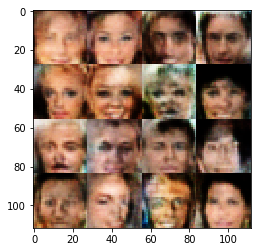

Epoch 2/25... Discriminator Loss: 0.5725... Generator Loss: 2.5238
Epoch 2/25... Discriminator Loss: 0.1549... Generator Loss: 3.2488
Epoch 2/25... Discriminator Loss: 0.3313... Generator Loss: 1.6245
Epoch 2/25... Discriminator Loss: 0.2429... Generator Loss: 2.2582
Epoch 2/25... Discriminator Loss: 0.0946... Generator Loss: 5.2215
Epoch 2/25... Discriminator Loss: 1.0930... Generator Loss: 0.5584
Epoch 2/25... Discriminator Loss: 0.7588... Generator Loss: 0.7624
Epoch 2/25... Discriminator Loss: 0.0802... Generator Loss: 3.6723
Epoch 2/25... Discriminator Loss: 0.2471... Generator Loss: 2.1537
Epoch 2/25... Discriminator Loss: 0.1323... Generator Loss: 4.3224


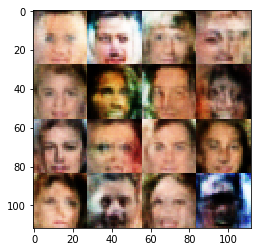

Epoch 2/25... Discriminator Loss: 0.0779... Generator Loss: 4.5224
Epoch 2/25... Discriminator Loss: 0.1969... Generator Loss: 2.2418
Epoch 2/25... Discriminator Loss: 0.0832... Generator Loss: 5.3102
Epoch 2/25... Discriminator Loss: 0.0661... Generator Loss: 4.7411
Epoch 2/25... Discriminator Loss: 0.1903... Generator Loss: 5.2226
Epoch 2/25... Discriminator Loss: 0.1204... Generator Loss: 4.0839
Epoch 2/25... Discriminator Loss: 0.5795... Generator Loss: 6.1097
Epoch 2/25... Discriminator Loss: 0.0892... Generator Loss: 6.0047
Epoch 2/25... Discriminator Loss: 1.4968... Generator Loss: 7.5286
Epoch 2/25... Discriminator Loss: 0.8782... Generator Loss: 2.5418


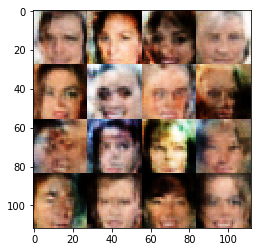

Epoch 2/25... Discriminator Loss: 0.7233... Generator Loss: 1.5963
Epoch 2/25... Discriminator Loss: 0.1903... Generator Loss: 2.8760
Epoch 2/25... Discriminator Loss: 0.1996... Generator Loss: 2.9558
Epoch 2/25... Discriminator Loss: 0.2413... Generator Loss: 5.2980
Epoch 2/25... Discriminator Loss: 0.4994... Generator Loss: 6.0199
Epoch 2/25... Discriminator Loss: 0.1944... Generator Loss: 5.3165
Epoch 2/25... Discriminator Loss: 0.9021... Generator Loss: 0.7102
Epoch 2/25... Discriminator Loss: 0.1509... Generator Loss: 2.8176
Epoch 2/25... Discriminator Loss: 0.2998... Generator Loss: 4.9870
Epoch 2/25... Discriminator Loss: 0.0769... Generator Loss: 5.8145


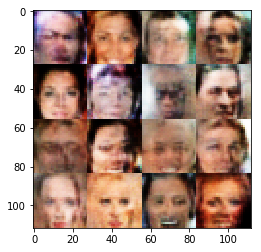

Epoch 2/25... Discriminator Loss: 0.2989... Generator Loss: 1.6128
Epoch 2/25... Discriminator Loss: 1.1556... Generator Loss: 0.5201
Epoch 2/25... Discriminator Loss: 0.2116... Generator Loss: 2.1989
Epoch 2/25... Discriminator Loss: 0.0642... Generator Loss: 6.8554
Epoch 2/25... Discriminator Loss: 0.4426... Generator Loss: 9.3561
Epoch 2/25... Discriminator Loss: 0.1906... Generator Loss: 6.6014
Epoch 2/25... Discriminator Loss: 0.5349... Generator Loss: 7.4829
Epoch 2/25... Discriminator Loss: 0.0390... Generator Loss: 4.6034
Epoch 2/25... Discriminator Loss: 0.2890... Generator Loss: 5.8990


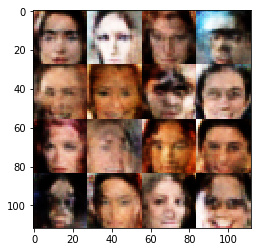

Epoch 2/25... Discriminator Loss: 0.1292... Generator Loss: 2.8530
Epoch 2/25... Discriminator Loss: 0.0278... Generator Loss: 5.9690
Epoch 2/25... Discriminator Loss: 0.7017... Generator Loss: 6.6723
Epoch 2/25... Discriminator Loss: 2.1053... Generator Loss: 2.3290
Epoch 2/25... Discriminator Loss: 0.4401... Generator Loss: 2.7486
Epoch 2/25... Discriminator Loss: 1.1152... Generator Loss: 0.5985
Epoch 2/25... Discriminator Loss: 0.4789... Generator Loss: 1.5390
Epoch 2/25... Discriminator Loss: 0.1363... Generator Loss: 3.4893
Epoch 2/25... Discriminator Loss: 0.1872... Generator Loss: 3.5848
Epoch 2/25... Discriminator Loss: 0.1955... Generator Loss: 2.8093


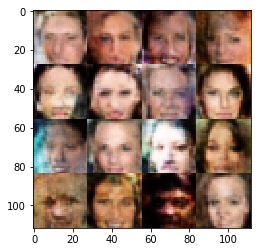

Epoch 2/25... Discriminator Loss: 0.1350... Generator Loss: 2.8396
Epoch 2/25... Discriminator Loss: 0.1100... Generator Loss: 4.0273
Epoch 2/25... Discriminator Loss: 0.5507... Generator Loss: 1.0724
Epoch 2/25... Discriminator Loss: 0.0496... Generator Loss: 5.2555
Epoch 2/25... Discriminator Loss: 1.1517... Generator Loss: 7.1081
Epoch 2/25... Discriminator Loss: 0.2470... Generator Loss: 2.2098
Epoch 2/25... Discriminator Loss: 0.0698... Generator Loss: 4.4099
Epoch 2/25... Discriminator Loss: 0.1103... Generator Loss: 4.8938
Epoch 2/25... Discriminator Loss: 0.0624... Generator Loss: 4.8256
Epoch 2/25... Discriminator Loss: 0.0757... Generator Loss: 4.4740


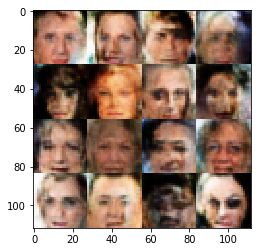

Epoch 2/25... Discriminator Loss: 0.0850... Generator Loss: 3.5799
Epoch 2/25... Discriminator Loss: 0.0594... Generator Loss: 5.5104
Epoch 2/25... Discriminator Loss: 0.0356... Generator Loss: 7.2681
Epoch 2/25... Discriminator Loss: 0.2345... Generator Loss: 1.9689
Epoch 2/25... Discriminator Loss: 0.1288... Generator Loss: 3.5567
Epoch 2/25... Discriminator Loss: 1.2760... Generator Loss: 0.4928
Epoch 2/25... Discriminator Loss: 0.1194... Generator Loss: 3.0100
Epoch 2/25... Discriminator Loss: 0.1076... Generator Loss: 4.5491
Epoch 2/25... Discriminator Loss: 0.0735... Generator Loss: 3.4672
Epoch 2/25... Discriminator Loss: 0.0828... Generator Loss: 3.2598


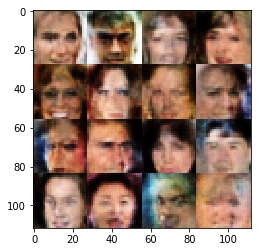

Epoch 2/25... Discriminator Loss: 0.1366... Generator Loss: 8.7650
Epoch 2/25... Discriminator Loss: 0.1371... Generator Loss: 2.6416
Epoch 2/25... Discriminator Loss: 0.0786... Generator Loss: 3.4445
Epoch 2/25... Discriminator Loss: 0.2090... Generator Loss: 2.5020
Epoch 2/25... Discriminator Loss: 0.3058... Generator Loss: 1.8723
Epoch 2/25... Discriminator Loss: 0.1408... Generator Loss: 2.7373
Epoch 3/25... Discriminator Loss: 0.0622... Generator Loss: 3.8095
Epoch 3/25... Discriminator Loss: 0.1340... Generator Loss: 6.4898
Epoch 3/25... Discriminator Loss: 2.1645... Generator Loss: 1.2218
Epoch 3/25... Discriminator Loss: 0.8043... Generator Loss: 1.7297


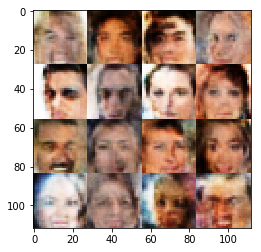

Epoch 3/25... Discriminator Loss: 1.4915... Generator Loss: 2.3838
Epoch 3/25... Discriminator Loss: 0.6527... Generator Loss: 1.1208
Epoch 3/25... Discriminator Loss: 0.3700... Generator Loss: 2.1765
Epoch 3/25... Discriminator Loss: 0.2617... Generator Loss: 2.5629
Epoch 3/25... Discriminator Loss: 0.1503... Generator Loss: 4.6947
Epoch 3/25... Discriminator Loss: 0.3102... Generator Loss: 1.8227
Epoch 3/25... Discriminator Loss: 0.1869... Generator Loss: 2.6067
Epoch 3/25... Discriminator Loss: 0.1912... Generator Loss: 4.2498
Epoch 3/25... Discriminator Loss: 0.7544... Generator Loss: 6.4522
Epoch 3/25... Discriminator Loss: 0.4793... Generator Loss: 1.5100


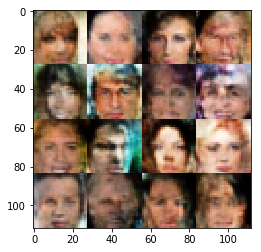

Epoch 3/25... Discriminator Loss: 0.3908... Generator Loss: 3.7488
Epoch 3/25... Discriminator Loss: 0.1702... Generator Loss: 4.8742
Epoch 3/25... Discriminator Loss: 0.0997... Generator Loss: 5.6322
Epoch 3/25... Discriminator Loss: 0.1424... Generator Loss: 2.8836
Epoch 3/25... Discriminator Loss: 0.2895... Generator Loss: 1.8049
Epoch 3/25... Discriminator Loss: 0.0868... Generator Loss: 3.9251
Epoch 3/25... Discriminator Loss: 1.5195... Generator Loss: 0.3657
Epoch 3/25... Discriminator Loss: 0.0549... Generator Loss: 4.8858
Epoch 3/25... Discriminator Loss: 0.0951... Generator Loss: 3.4753
Epoch 3/25... Discriminator Loss: 0.0450... Generator Loss: 3.9250


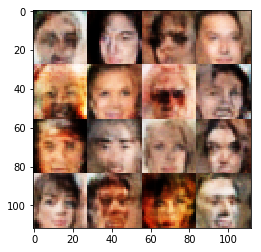

Epoch 3/25... Discriminator Loss: 0.2222... Generator Loss: 1.9079
Epoch 3/25... Discriminator Loss: 0.2049... Generator Loss: 2.7102
Epoch 3/25... Discriminator Loss: 0.1158... Generator Loss: 4.2760
Epoch 3/25... Discriminator Loss: 0.2701... Generator Loss: 1.8167
Epoch 3/25... Discriminator Loss: 0.1520... Generator Loss: 2.4223
Epoch 3/25... Discriminator Loss: 0.0672... Generator Loss: 3.6777
Epoch 3/25... Discriminator Loss: 0.0313... Generator Loss: 5.3168
Epoch 3/25... Discriminator Loss: 0.0492... Generator Loss: 6.9960
Epoch 3/25... Discriminator Loss: 0.2469... Generator Loss: 1.9358
Epoch 3/25... Discriminator Loss: 0.3738... Generator Loss: 4.6618


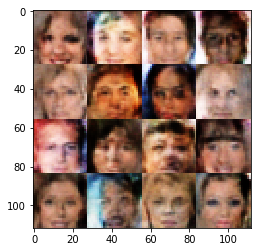

Epoch 3/25... Discriminator Loss: 0.0441... Generator Loss: 6.0263
Epoch 3/25... Discriminator Loss: 0.0463... Generator Loss: 5.4019
Epoch 3/25... Discriminator Loss: 0.0447... Generator Loss: 5.1417
Epoch 3/25... Discriminator Loss: 0.0861... Generator Loss: 3.4374
Epoch 3/25... Discriminator Loss: 0.0793... Generator Loss: 4.0175
Epoch 3/25... Discriminator Loss: 0.1867... Generator Loss: 2.4270
Epoch 3/25... Discriminator Loss: 0.1583... Generator Loss: 7.1192
Epoch 3/25... Discriminator Loss: 0.2598... Generator Loss: 1.8537
Epoch 3/25... Discriminator Loss: 0.0845... Generator Loss: 3.5370
Epoch 3/25... Discriminator Loss: 0.2285... Generator Loss: 2.1612


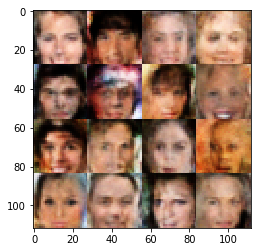

Epoch 3/25... Discriminator Loss: 0.0382... Generator Loss: 5.2975
Epoch 3/25... Discriminator Loss: 0.6806... Generator Loss: 6.2743
Epoch 3/25... Discriminator Loss: 4.5659... Generator Loss: 6.2227
Epoch 3/25... Discriminator Loss: 2.4495... Generator Loss: 0.1715
Epoch 3/25... Discriminator Loss: 0.3251... Generator Loss: 2.5124
Epoch 3/25... Discriminator Loss: 0.2517... Generator Loss: 2.2311
Epoch 3/25... Discriminator Loss: 0.2442... Generator Loss: 2.1378
Epoch 3/25... Discriminator Loss: 0.2019... Generator Loss: 2.5976
Epoch 3/25... Discriminator Loss: 0.1138... Generator Loss: 5.1086
Epoch 3/25... Discriminator Loss: 0.1436... Generator Loss: 4.1217


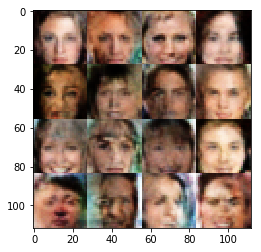

Epoch 3/25... Discriminator Loss: 0.3936... Generator Loss: 1.4268
Epoch 3/25... Discriminator Loss: 0.2798... Generator Loss: 1.8612
Epoch 3/25... Discriminator Loss: 0.0827... Generator Loss: 4.5988
Epoch 3/25... Discriminator Loss: 0.1635... Generator Loss: 6.8643
Epoch 3/25... Discriminator Loss: 0.0460... Generator Loss: 4.5339
Epoch 3/25... Discriminator Loss: 2.0229... Generator Loss: 5.7179
Epoch 3/25... Discriminator Loss: 0.8235... Generator Loss: 1.4141
Epoch 3/25... Discriminator Loss: 0.2264... Generator Loss: 3.5681
Epoch 3/25... Discriminator Loss: 0.4241... Generator Loss: 1.5236
Epoch 3/25... Discriminator Loss: 0.4445... Generator Loss: 3.8660


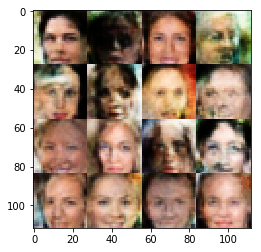

Epoch 3/25... Discriminator Loss: 0.1305... Generator Loss: 3.1984
Epoch 3/25... Discriminator Loss: 0.1223... Generator Loss: 2.8706
Epoch 3/25... Discriminator Loss: 0.1325... Generator Loss: 2.9159
Epoch 3/25... Discriminator Loss: 0.3674... Generator Loss: 1.5870
Epoch 3/25... Discriminator Loss: 0.4419... Generator Loss: 1.3323
Epoch 3/25... Discriminator Loss: 0.2453... Generator Loss: 1.8125
Epoch 3/25... Discriminator Loss: 0.0734... Generator Loss: 3.9518
Epoch 3/25... Discriminator Loss: 0.0701... Generator Loss: 5.2495
Epoch 3/25... Discriminator Loss: 0.0839... Generator Loss: 3.6256
Epoch 3/25... Discriminator Loss: 0.0980... Generator Loss: 3.2920


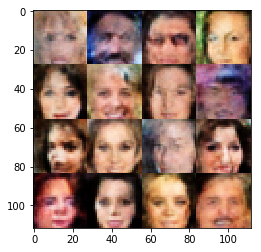

Epoch 3/25... Discriminator Loss: 0.1188... Generator Loss: 2.9945
Epoch 3/25... Discriminator Loss: 0.1459... Generator Loss: 2.6618
Epoch 3/25... Discriminator Loss: 0.2451... Generator Loss: 2.0179
Epoch 3/25... Discriminator Loss: 0.0413... Generator Loss: 4.0402
Epoch 3/25... Discriminator Loss: 1.8733... Generator Loss: 0.2924
Epoch 3/25... Discriminator Loss: 0.6106... Generator Loss: 1.0767
Epoch 3/25... Discriminator Loss: 0.1379... Generator Loss: 3.4573
Epoch 3/25... Discriminator Loss: 0.1574... Generator Loss: 4.9255
Epoch 3/25... Discriminator Loss: 0.1504... Generator Loss: 2.8452
Epoch 3/25... Discriminator Loss: 0.2678... Generator Loss: 6.6985


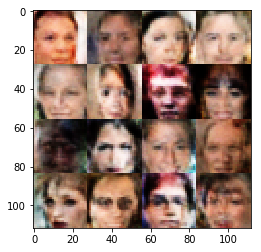

Epoch 3/25... Discriminator Loss: 0.0900... Generator Loss: 4.1469
Epoch 3/25... Discriminator Loss: 0.1418... Generator Loss: 3.0066
Epoch 3/25... Discriminator Loss: 0.1502... Generator Loss: 2.5791
Epoch 3/25... Discriminator Loss: 0.0714... Generator Loss: 3.5919
Epoch 3/25... Discriminator Loss: 0.2146... Generator Loss: 2.2450
Epoch 3/25... Discriminator Loss: 0.0899... Generator Loss: 3.6084
Epoch 3/25... Discriminator Loss: 0.0909... Generator Loss: 3.2245
Epoch 3/25... Discriminator Loss: 0.2377... Generator Loss: 1.9142
Epoch 3/25... Discriminator Loss: 0.0760... Generator Loss: 4.2873
Epoch 3/25... Discriminator Loss: 0.0386... Generator Loss: 4.8714


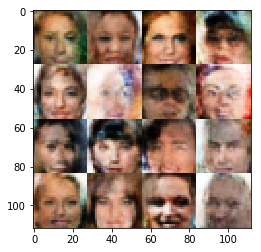

Epoch 3/25... Discriminator Loss: 0.0415... Generator Loss: 4.8021
Epoch 3/25... Discriminator Loss: 0.0781... Generator Loss: 3.5863
Epoch 3/25... Discriminator Loss: 0.0935... Generator Loss: 3.3415
Epoch 3/25... Discriminator Loss: 0.0467... Generator Loss: 5.6221
Epoch 3/25... Discriminator Loss: 5.6638... Generator Loss: 5.3529
Epoch 3/25... Discriminator Loss: 1.7625... Generator Loss: 1.7898
Epoch 3/25... Discriminator Loss: 1.0783... Generator Loss: 0.6457
Epoch 3/25... Discriminator Loss: 0.6814... Generator Loss: 1.2653
Epoch 3/25... Discriminator Loss: 1.6983... Generator Loss: 0.3480
Epoch 3/25... Discriminator Loss: 0.5329... Generator Loss: 1.8437


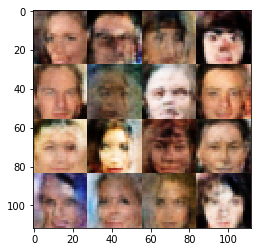

Epoch 3/25... Discriminator Loss: 0.5405... Generator Loss: 1.3007
Epoch 3/25... Discriminator Loss: 0.1727... Generator Loss: 2.5370
Epoch 3/25... Discriminator Loss: 0.1784... Generator Loss: 2.8553
Epoch 3/25... Discriminator Loss: 0.1515... Generator Loss: 4.5922
Epoch 3/25... Discriminator Loss: 0.3264... Generator Loss: 2.6016
Epoch 3/25... Discriminator Loss: 0.1359... Generator Loss: 3.4653
Epoch 3/25... Discriminator Loss: 0.4281... Generator Loss: 1.3202
Epoch 3/25... Discriminator Loss: 0.0867... Generator Loss: 3.3298
Epoch 3/25... Discriminator Loss: 0.4034... Generator Loss: 1.4092
Epoch 3/25... Discriminator Loss: 0.3810... Generator Loss: 5.9717


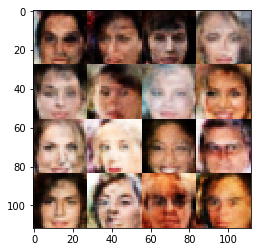

Epoch 3/25... Discriminator Loss: 0.0903... Generator Loss: 5.0013
Epoch 3/25... Discriminator Loss: 0.0531... Generator Loss: 4.3377
Epoch 3/25... Discriminator Loss: 0.4198... Generator Loss: 1.4003
Epoch 3/25... Discriminator Loss: 0.2842... Generator Loss: 1.7288
Epoch 3/25... Discriminator Loss: 0.1213... Generator Loss: 2.8128
Epoch 3/25... Discriminator Loss: 0.1028... Generator Loss: 4.9969
Epoch 3/25... Discriminator Loss: 0.0967... Generator Loss: 4.9095
Epoch 3/25... Discriminator Loss: 0.0266... Generator Loss: 6.5351
Epoch 3/25... Discriminator Loss: 0.3483... Generator Loss: 1.5345
Epoch 3/25... Discriminator Loss: 0.0918... Generator Loss: 5.4536


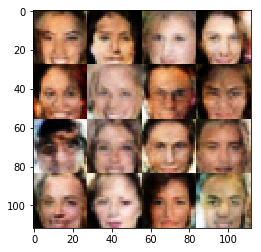

Epoch 3/25... Discriminator Loss: 0.0513... Generator Loss: 4.7782
Epoch 3/25... Discriminator Loss: 1.0066... Generator Loss: 0.5829
Epoch 3/25... Discriminator Loss: 0.1224... Generator Loss: 2.7158
Epoch 3/25... Discriminator Loss: 0.9155... Generator Loss: 0.6815
Epoch 3/25... Discriminator Loss: 4.7049... Generator Loss: 5.3974
Epoch 3/25... Discriminator Loss: 1.3514... Generator Loss: 1.3503
Epoch 3/25... Discriminator Loss: 1.1743... Generator Loss: 0.6718
Epoch 3/25... Discriminator Loss: 1.0504... Generator Loss: 1.0556
Epoch 3/25... Discriminator Loss: 0.7723... Generator Loss: 1.3139
Epoch 3/25... Discriminator Loss: 1.0343... Generator Loss: 0.6398


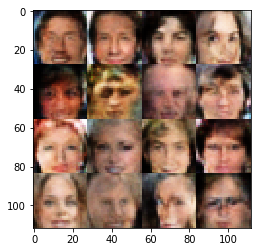

Epoch 3/25... Discriminator Loss: 1.3168... Generator Loss: 0.4613
Epoch 3/25... Discriminator Loss: 0.4762... Generator Loss: 2.4990
Epoch 3/25... Discriminator Loss: 0.8041... Generator Loss: 4.7083
Epoch 3/25... Discriminator Loss: 1.7173... Generator Loss: 0.2868
Epoch 3/25... Discriminator Loss: 0.1133... Generator Loss: 4.1578
Epoch 3/25... Discriminator Loss: 0.1490... Generator Loss: 3.0292
Epoch 3/25... Discriminator Loss: 0.2699... Generator Loss: 2.2885
Epoch 3/25... Discriminator Loss: 0.1331... Generator Loss: 2.6320
Epoch 3/25... Discriminator Loss: 0.1503... Generator Loss: 3.2098
Epoch 3/25... Discriminator Loss: 0.1768... Generator Loss: 3.1350


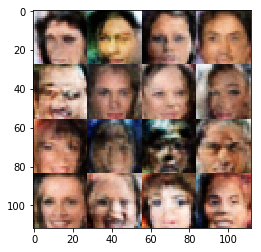

Epoch 3/25... Discriminator Loss: 0.0691... Generator Loss: 4.0404
Epoch 3/25... Discriminator Loss: 0.1949... Generator Loss: 4.0122
Epoch 3/25... Discriminator Loss: 0.1230... Generator Loss: 2.8169
Epoch 3/25... Discriminator Loss: 0.0644... Generator Loss: 4.5306
Epoch 3/25... Discriminator Loss: 0.1116... Generator Loss: 4.0842
Epoch 3/25... Discriminator Loss: 0.1286... Generator Loss: 3.7784
Epoch 3/25... Discriminator Loss: 0.6550... Generator Loss: 1.6225
Epoch 3/25... Discriminator Loss: 0.9932... Generator Loss: 0.6596
Epoch 3/25... Discriminator Loss: 0.1343... Generator Loss: 3.9956
Epoch 3/25... Discriminator Loss: 0.5571... Generator Loss: 1.1178


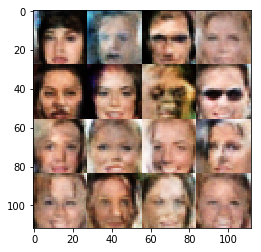

Epoch 3/25... Discriminator Loss: 0.1576... Generator Loss: 2.7562
Epoch 3/25... Discriminator Loss: 0.1658... Generator Loss: 4.2028
Epoch 3/25... Discriminator Loss: 0.0630... Generator Loss: 4.8638
Epoch 3/25... Discriminator Loss: 0.3257... Generator Loss: 1.7976
Epoch 4/25... Discriminator Loss: 0.0576... Generator Loss: 4.5052
Epoch 4/25... Discriminator Loss: 0.1210... Generator Loss: 3.4770
Epoch 4/25... Discriminator Loss: 0.1709... Generator Loss: 3.2066
Epoch 4/25... Discriminator Loss: 0.5434... Generator Loss: 5.9887
Epoch 4/25... Discriminator Loss: 1.2666... Generator Loss: 0.4679
Epoch 4/25... Discriminator Loss: 0.2061... Generator Loss: 2.9626


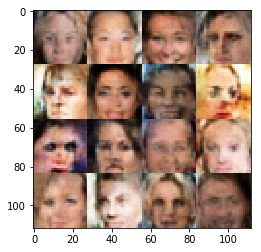

Epoch 4/25... Discriminator Loss: 1.1786... Generator Loss: 0.5420
Epoch 4/25... Discriminator Loss: 0.2383... Generator Loss: 2.2358
Epoch 4/25... Discriminator Loss: 0.0763... Generator Loss: 6.1356
Epoch 4/25... Discriminator Loss: 0.0398... Generator Loss: 5.0342
Epoch 4/25... Discriminator Loss: 0.0559... Generator Loss: 3.8194
Epoch 4/25... Discriminator Loss: 0.0725... Generator Loss: 5.7827
Epoch 4/25... Discriminator Loss: 0.8260... Generator Loss: 4.8477
Epoch 4/25... Discriminator Loss: 0.7586... Generator Loss: 0.8618
Epoch 4/25... Discriminator Loss: 0.1062... Generator Loss: 3.8348
Epoch 4/25... Discriminator Loss: 0.0427... Generator Loss: 6.2082


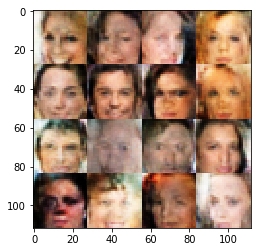

Epoch 4/25... Discriminator Loss: 0.5728... Generator Loss: 1.0593
Epoch 4/25... Discriminator Loss: 0.0922... Generator Loss: 3.1420
Epoch 4/25... Discriminator Loss: 0.0698... Generator Loss: 4.1995
Epoch 4/25... Discriminator Loss: 0.0826... Generator Loss: 3.4508
Epoch 4/25... Discriminator Loss: 0.2059... Generator Loss: 2.0587
Epoch 4/25... Discriminator Loss: 0.0763... Generator Loss: 4.7770
Epoch 4/25... Discriminator Loss: 0.1133... Generator Loss: 3.8213
Epoch 4/25... Discriminator Loss: 0.0513... Generator Loss: 6.3920
Epoch 4/25... Discriminator Loss: 0.0474... Generator Loss: 4.5932
Epoch 4/25... Discriminator Loss: 0.1128... Generator Loss: 5.1282


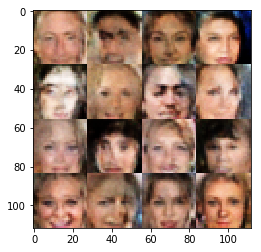

Epoch 4/25... Discriminator Loss: 0.4667... Generator Loss: 3.3891
Epoch 4/25... Discriminator Loss: 0.2087... Generator Loss: 2.9420
Epoch 4/25... Discriminator Loss: 0.0754... Generator Loss: 4.6797
Epoch 4/25... Discriminator Loss: 0.0993... Generator Loss: 2.9923
Epoch 4/25... Discriminator Loss: 0.0460... Generator Loss: 4.6352
Epoch 4/25... Discriminator Loss: 0.0285... Generator Loss: 5.8625
Epoch 4/25... Discriminator Loss: 0.0465... Generator Loss: 7.0992
Epoch 4/25... Discriminator Loss: 0.1133... Generator Loss: 3.1783
Epoch 4/25... Discriminator Loss: 0.4593... Generator Loss: 3.8938
Epoch 4/25... Discriminator Loss: 0.1004... Generator Loss: 3.5942


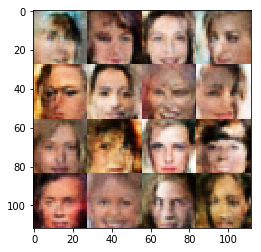

Epoch 4/25... Discriminator Loss: 0.1851... Generator Loss: 5.4117
Epoch 4/25... Discriminator Loss: 1.2255... Generator Loss: 0.7251
Epoch 4/25... Discriminator Loss: 1.1011... Generator Loss: 0.5490
Epoch 4/25... Discriminator Loss: 0.3966... Generator Loss: 1.4256
Epoch 4/25... Discriminator Loss: 0.3621... Generator Loss: 1.5775
Epoch 4/25... Discriminator Loss: 0.1431... Generator Loss: 2.7964
Epoch 4/25... Discriminator Loss: 0.1348... Generator Loss: 2.8495
Epoch 4/25... Discriminator Loss: 0.1309... Generator Loss: 3.4269
Epoch 4/25... Discriminator Loss: 0.5103... Generator Loss: 4.8663
Epoch 4/25... Discriminator Loss: 0.6225... Generator Loss: 3.0127


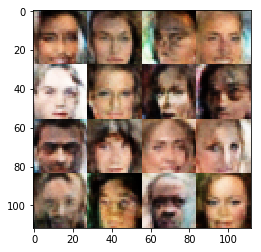

Epoch 4/25... Discriminator Loss: 0.6404... Generator Loss: 0.9962
Epoch 4/25... Discriminator Loss: 0.4112... Generator Loss: 3.6294
Epoch 4/25... Discriminator Loss: 0.3253... Generator Loss: 2.0989
Epoch 4/25... Discriminator Loss: 0.3115... Generator Loss: 1.8681
Epoch 4/25... Discriminator Loss: 0.1429... Generator Loss: 4.9457
Epoch 4/25... Discriminator Loss: 0.3016... Generator Loss: 1.9093
Epoch 4/25... Discriminator Loss: 2.5895... Generator Loss: 0.1120
Epoch 4/25... Discriminator Loss: 0.6491... Generator Loss: 1.2389
Epoch 4/25... Discriminator Loss: 0.8553... Generator Loss: 0.8063
Epoch 4/25... Discriminator Loss: 0.2201... Generator Loss: 2.5192


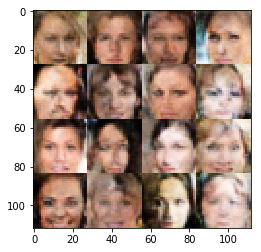

Epoch 4/25... Discriminator Loss: 0.5564... Generator Loss: 1.2266
Epoch 4/25... Discriminator Loss: 0.1234... Generator Loss: 5.3801
Epoch 4/25... Discriminator Loss: 1.2800... Generator Loss: 0.4890
Epoch 4/25... Discriminator Loss: 0.7965... Generator Loss: 1.3611
Epoch 4/25... Discriminator Loss: 0.5651... Generator Loss: 1.7596
Epoch 4/25... Discriminator Loss: 0.1433... Generator Loss: 2.6850
Epoch 4/25... Discriminator Loss: 0.2277... Generator Loss: 2.6135
Epoch 4/25... Discriminator Loss: 0.1340... Generator Loss: 3.7260
Epoch 4/25... Discriminator Loss: 0.4077... Generator Loss: 1.6720
Epoch 4/25... Discriminator Loss: 0.0577... Generator Loss: 3.5292


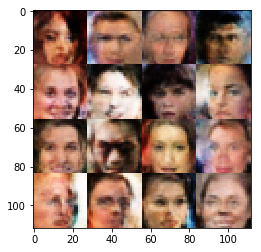

Epoch 4/25... Discriminator Loss: 0.0841... Generator Loss: 4.5035
Epoch 4/25... Discriminator Loss: 0.1913... Generator Loss: 2.5719
Epoch 4/25... Discriminator Loss: 0.1431... Generator Loss: 2.5425
Epoch 4/25... Discriminator Loss: 0.1288... Generator Loss: 3.0698
Epoch 4/25... Discriminator Loss: 0.1818... Generator Loss: 2.5751
Epoch 4/25... Discriminator Loss: 0.0973... Generator Loss: 3.8148
Epoch 4/25... Discriminator Loss: 0.2076... Generator Loss: 2.0481
Epoch 4/25... Discriminator Loss: 0.0752... Generator Loss: 3.5878
Epoch 4/25... Discriminator Loss: 0.0942... Generator Loss: 3.8395
Epoch 4/25... Discriminator Loss: 0.1147... Generator Loss: 3.0151


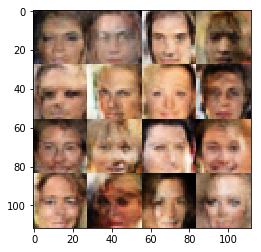

Epoch 4/25... Discriminator Loss: 0.1274... Generator Loss: 2.6169
Epoch 4/25... Discriminator Loss: 0.1238... Generator Loss: 2.6586
Epoch 4/25... Discriminator Loss: 0.0488... Generator Loss: 4.9157
Epoch 4/25... Discriminator Loss: 0.0388... Generator Loss: 4.6579
Epoch 4/25... Discriminator Loss: 0.1847... Generator Loss: 2.4653
Epoch 4/25... Discriminator Loss: 0.0683... Generator Loss: 5.7938
Epoch 4/25... Discriminator Loss: 0.1862... Generator Loss: 2.2672
Epoch 4/25... Discriminator Loss: 0.1257... Generator Loss: 2.9513
Epoch 4/25... Discriminator Loss: 0.0728... Generator Loss: 4.3146
Epoch 4/25... Discriminator Loss: 0.0672... Generator Loss: 3.7848


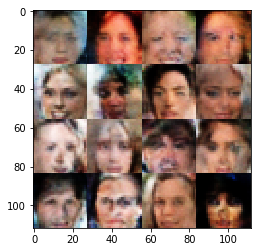

Epoch 4/25... Discriminator Loss: 0.2928... Generator Loss: 1.7451
Epoch 4/25... Discriminator Loss: 0.2071... Generator Loss: 2.0559
Epoch 4/25... Discriminator Loss: 0.0519... Generator Loss: 4.1577
Epoch 4/25... Discriminator Loss: 0.1091... Generator Loss: 3.0877
Epoch 4/25... Discriminator Loss: 0.3624... Generator Loss: 1.5722
Epoch 4/25... Discriminator Loss: 0.2018... Generator Loss: 2.0987
Epoch 4/25... Discriminator Loss: 0.0451... Generator Loss: 4.4212
Epoch 4/25... Discriminator Loss: 0.0604... Generator Loss: 4.2166
Epoch 4/25... Discriminator Loss: 0.0779... Generator Loss: 3.9148
Epoch 4/25... Discriminator Loss: 0.2823... Generator Loss: 4.9425


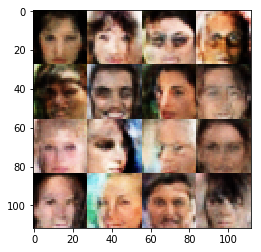

Epoch 4/25... Discriminator Loss: 0.4207... Generator Loss: 1.3557
Epoch 4/25... Discriminator Loss: 0.0975... Generator Loss: 2.9053
Epoch 4/25... Discriminator Loss: 0.0800... Generator Loss: 3.2945
Epoch 4/25... Discriminator Loss: 0.1202... Generator Loss: 2.6580
Epoch 4/25... Discriminator Loss: 1.1380... Generator Loss: 0.9144
Epoch 4/25... Discriminator Loss: 1.0714... Generator Loss: 0.7236
Epoch 4/25... Discriminator Loss: 0.7939... Generator Loss: 1.7825
Epoch 4/25... Discriminator Loss: 0.8200... Generator Loss: 1.2796
Epoch 4/25... Discriminator Loss: 1.5023... Generator Loss: 0.3940
Epoch 4/25... Discriminator Loss: 0.6027... Generator Loss: 1.2688


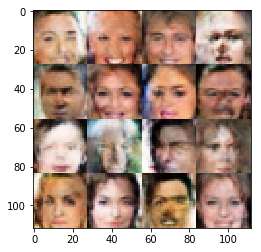

Epoch 4/25... Discriminator Loss: 2.5304... Generator Loss: 3.7773
Epoch 4/25... Discriminator Loss: 0.4423... Generator Loss: 2.0983
Epoch 4/25... Discriminator Loss: 1.1001... Generator Loss: 0.5670
Epoch 4/25... Discriminator Loss: 1.1590... Generator Loss: 3.8688
Epoch 4/25... Discriminator Loss: 0.3976... Generator Loss: 1.5534
Epoch 4/25... Discriminator Loss: 1.0143... Generator Loss: 0.6758
Epoch 4/25... Discriminator Loss: 0.2751... Generator Loss: 2.0053
Epoch 4/25... Discriminator Loss: 0.1322... Generator Loss: 2.9043
Epoch 4/25... Discriminator Loss: 0.1021... Generator Loss: 3.2399
Epoch 4/25... Discriminator Loss: 0.1542... Generator Loss: 2.7245


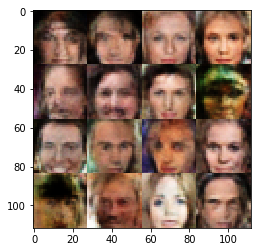

Epoch 4/25... Discriminator Loss: 0.1248... Generator Loss: 3.0246
Epoch 4/25... Discriminator Loss: 0.2201... Generator Loss: 1.9963
Epoch 4/25... Discriminator Loss: 0.6465... Generator Loss: 5.6111
Epoch 4/25... Discriminator Loss: 0.2283... Generator Loss: 2.4473
Epoch 4/25... Discriminator Loss: 0.2503... Generator Loss: 2.7246
Epoch 4/25... Discriminator Loss: 0.1179... Generator Loss: 3.1753
Epoch 4/25... Discriminator Loss: 0.1272... Generator Loss: 2.8559
Epoch 4/25... Discriminator Loss: 0.5583... Generator Loss: 1.1545
Epoch 4/25... Discriminator Loss: 0.0903... Generator Loss: 3.7004
Epoch 4/25... Discriminator Loss: 0.1085... Generator Loss: 3.9905


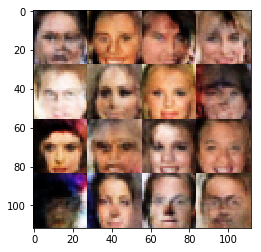

Epoch 4/25... Discriminator Loss: 0.0681... Generator Loss: 4.7109
Epoch 4/25... Discriminator Loss: 0.0781... Generator Loss: 3.4196
Epoch 4/25... Discriminator Loss: 0.0455... Generator Loss: 5.2940
Epoch 4/25... Discriminator Loss: 0.0826... Generator Loss: 4.1014
Epoch 4/25... Discriminator Loss: 0.2715... Generator Loss: 1.9277
Epoch 4/25... Discriminator Loss: 0.3559... Generator Loss: 1.5907
Epoch 4/25... Discriminator Loss: 0.1029... Generator Loss: 3.3985
Epoch 4/25... Discriminator Loss: 0.0716... Generator Loss: 4.3157
Epoch 4/25... Discriminator Loss: 0.0495... Generator Loss: 5.5335
Epoch 4/25... Discriminator Loss: 0.1433... Generator Loss: 4.8823


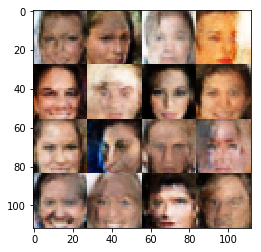

Epoch 4/25... Discriminator Loss: 0.0244... Generator Loss: 5.2987
Epoch 4/25... Discriminator Loss: 1.7888... Generator Loss: 1.9368
Epoch 4/25... Discriminator Loss: 1.2444... Generator Loss: 0.9547
Epoch 4/25... Discriminator Loss: 1.2194... Generator Loss: 0.8047
Epoch 4/25... Discriminator Loss: 1.2216... Generator Loss: 0.9434
Epoch 4/25... Discriminator Loss: 1.2430... Generator Loss: 0.7221
Epoch 4/25... Discriminator Loss: 1.1633... Generator Loss: 0.6845
Epoch 4/25... Discriminator Loss: 1.1266... Generator Loss: 1.0622
Epoch 4/25... Discriminator Loss: 0.9285... Generator Loss: 2.5357
Epoch 4/25... Discriminator Loss: 0.7330... Generator Loss: 3.6862


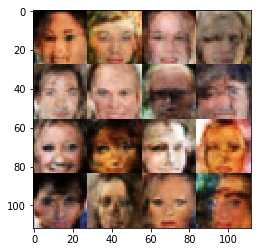

Epoch 4/25... Discriminator Loss: 1.4510... Generator Loss: 0.3861
Epoch 4/25... Discriminator Loss: 0.3600... Generator Loss: 3.0395
Epoch 4/25... Discriminator Loss: 0.0950... Generator Loss: 4.6089
Epoch 4/25... Discriminator Loss: 0.6482... Generator Loss: 1.2040
Epoch 4/25... Discriminator Loss: 0.4713... Generator Loss: 2.0115
Epoch 4/25... Discriminator Loss: 0.7408... Generator Loss: 0.9032
Epoch 4/25... Discriminator Loss: 0.5499... Generator Loss: 1.2036
Epoch 4/25... Discriminator Loss: 0.1323... Generator Loss: 3.6129
Epoch 4/25... Discriminator Loss: 0.3712... Generator Loss: 1.6919
Epoch 4/25... Discriminator Loss: 0.3157... Generator Loss: 4.0486


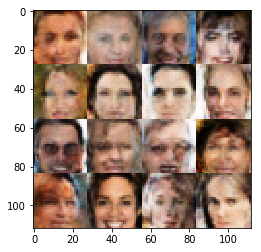

Epoch 4/25... Discriminator Loss: 0.2088... Generator Loss: 2.1837
Epoch 4/25... Discriminator Loss: 0.2393... Generator Loss: 2.3643
Epoch 5/25... Discriminator Loss: 0.2484... Generator Loss: 1.9883
Epoch 5/25... Discriminator Loss: 0.2970... Generator Loss: 1.8095
Epoch 5/25... Discriminator Loss: 0.2147... Generator Loss: 1.9436
Epoch 5/25... Discriminator Loss: 1.1633... Generator Loss: 3.4752
Epoch 5/25... Discriminator Loss: 0.8133... Generator Loss: 1.5763
Epoch 5/25... Discriminator Loss: 0.6008... Generator Loss: 1.1289
Epoch 5/25... Discriminator Loss: 2.1738... Generator Loss: 4.9572
Epoch 5/25... Discriminator Loss: 0.6753... Generator Loss: 2.0480


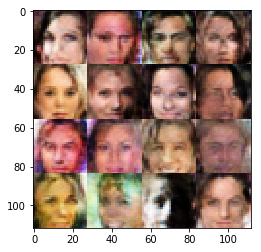

Epoch 5/25... Discriminator Loss: 0.2323... Generator Loss: 2.1518
Epoch 5/25... Discriminator Loss: 0.4405... Generator Loss: 1.4004
Epoch 5/25... Discriminator Loss: 0.3910... Generator Loss: 1.6085
Epoch 5/25... Discriminator Loss: 0.1109... Generator Loss: 3.6431
Epoch 5/25... Discriminator Loss: 0.1693... Generator Loss: 2.5338
Epoch 5/25... Discriminator Loss: 0.0871... Generator Loss: 3.5325
Epoch 5/25... Discriminator Loss: 0.2657... Generator Loss: 1.9455
Epoch 5/25... Discriminator Loss: 0.1272... Generator Loss: 3.6768
Epoch 5/25... Discriminator Loss: 0.2359... Generator Loss: 2.0390
Epoch 5/25... Discriminator Loss: 0.1622... Generator Loss: 4.9971


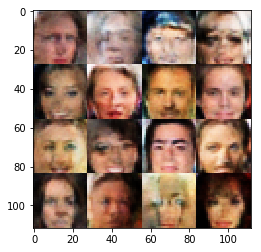

Epoch 5/25... Discriminator Loss: 0.1047... Generator Loss: 3.0297
Epoch 5/25... Discriminator Loss: 0.2152... Generator Loss: 2.0010
Epoch 5/25... Discriminator Loss: 0.1015... Generator Loss: 3.5442
Epoch 5/25... Discriminator Loss: 0.2273... Generator Loss: 2.0834
Epoch 5/25... Discriminator Loss: 0.0884... Generator Loss: 4.4293
Epoch 5/25... Discriminator Loss: 0.0890... Generator Loss: 3.9657
Epoch 5/25... Discriminator Loss: 0.2168... Generator Loss: 2.1504
Epoch 5/25... Discriminator Loss: 0.0927... Generator Loss: 3.0052
Epoch 5/25... Discriminator Loss: 0.1055... Generator Loss: 3.8599
Epoch 5/25... Discriminator Loss: 0.1116... Generator Loss: 2.9907


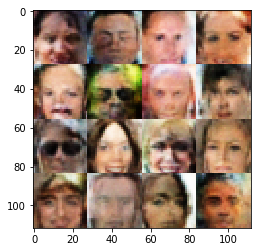

Epoch 5/25... Discriminator Loss: 0.2455... Generator Loss: 1.9473
Epoch 5/25... Discriminator Loss: 0.2605... Generator Loss: 1.9278
Epoch 5/25... Discriminator Loss: 0.0284... Generator Loss: 5.2709
Epoch 5/25... Discriminator Loss: 0.0879... Generator Loss: 3.0383
Epoch 5/25... Discriminator Loss: 0.0407... Generator Loss: 5.6558
Epoch 5/25... Discriminator Loss: 0.2577... Generator Loss: 1.8301
Epoch 5/25... Discriminator Loss: 0.0286... Generator Loss: 5.9639
Epoch 5/25... Discriminator Loss: 0.1808... Generator Loss: 5.5264
Epoch 5/25... Discriminator Loss: 0.0847... Generator Loss: 3.3236
Epoch 5/25... Discriminator Loss: 0.5779... Generator Loss: 2.2510


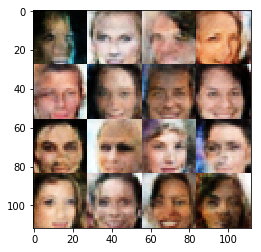

Epoch 5/25... Discriminator Loss: 0.5704... Generator Loss: 1.4412
Epoch 5/25... Discriminator Loss: 1.4238... Generator Loss: 4.6421
Epoch 5/25... Discriminator Loss: 0.7777... Generator Loss: 0.9357
Epoch 5/25... Discriminator Loss: 0.5530... Generator Loss: 3.7021
Epoch 5/25... Discriminator Loss: 0.3648... Generator Loss: 1.7366
Epoch 5/25... Discriminator Loss: 0.1185... Generator Loss: 3.4174
Epoch 5/25... Discriminator Loss: 0.2268... Generator Loss: 2.1480
Epoch 5/25... Discriminator Loss: 0.1336... Generator Loss: 2.8959
Epoch 5/25... Discriminator Loss: 0.1916... Generator Loss: 2.9973
Epoch 5/25... Discriminator Loss: 0.2345... Generator Loss: 1.9886


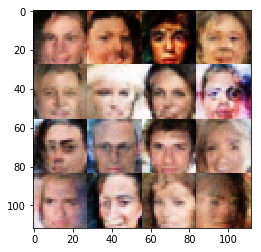

Epoch 5/25... Discriminator Loss: 0.3825... Generator Loss: 1.3924
Epoch 5/25... Discriminator Loss: 0.1045... Generator Loss: 3.3228
Epoch 5/25... Discriminator Loss: 0.1443... Generator Loss: 3.2181
Epoch 5/25... Discriminator Loss: 0.2691... Generator Loss: 2.4468
Epoch 5/25... Discriminator Loss: 0.3556... Generator Loss: 1.6420
Epoch 5/25... Discriminator Loss: 0.1309... Generator Loss: 2.8008
Epoch 5/25... Discriminator Loss: 0.1853... Generator Loss: 2.5728
Epoch 5/25... Discriminator Loss: 0.1777... Generator Loss: 2.3303
Epoch 5/25... Discriminator Loss: 0.1420... Generator Loss: 2.4753
Epoch 5/25... Discriminator Loss: 0.7777... Generator Loss: 0.8013


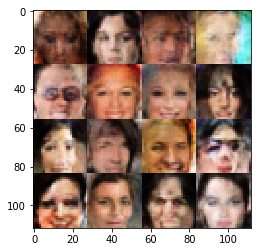

Epoch 5/25... Discriminator Loss: 0.0615... Generator Loss: 4.3774
Epoch 5/25... Discriminator Loss: 0.0965... Generator Loss: 3.3914
Epoch 5/25... Discriminator Loss: 0.0542... Generator Loss: 4.7734
Epoch 5/25... Discriminator Loss: 0.0428... Generator Loss: 4.2296
Epoch 5/25... Discriminator Loss: 0.0448... Generator Loss: 5.0384
Epoch 5/25... Discriminator Loss: 0.9107... Generator Loss: 3.7594
Epoch 5/25... Discriminator Loss: 1.1086... Generator Loss: 0.8158
Epoch 5/25... Discriminator Loss: 0.5616... Generator Loss: 1.2013
Epoch 5/25... Discriminator Loss: 0.3670... Generator Loss: 2.2272
Epoch 5/25... Discriminator Loss: 0.1596... Generator Loss: 3.8507


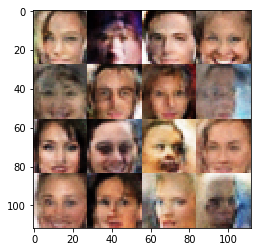

Epoch 5/25... Discriminator Loss: 0.4198... Generator Loss: 1.6298
Epoch 5/25... Discriminator Loss: 0.1761... Generator Loss: 2.4546
Epoch 5/25... Discriminator Loss: 0.0927... Generator Loss: 3.9927
Epoch 5/25... Discriminator Loss: 0.2914... Generator Loss: 1.9398
Epoch 5/25... Discriminator Loss: 0.2525... Generator Loss: 2.0034
Epoch 5/25... Discriminator Loss: 0.2384... Generator Loss: 2.0104
Epoch 5/25... Discriminator Loss: 0.5566... Generator Loss: 1.1338
Epoch 5/25... Discriminator Loss: 0.2153... Generator Loss: 2.0860
Epoch 5/25... Discriminator Loss: 0.2930... Generator Loss: 1.7158
Epoch 5/25... Discriminator Loss: 0.0551... Generator Loss: 3.9461


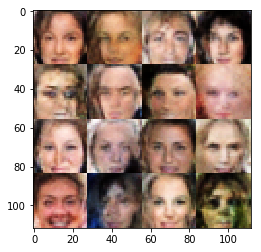

Epoch 5/25... Discriminator Loss: 0.2592... Generator Loss: 1.8844
Epoch 5/25... Discriminator Loss: 0.1057... Generator Loss: 2.8026
Epoch 5/25... Discriminator Loss: 0.1215... Generator Loss: 2.7716
Epoch 5/25... Discriminator Loss: 0.0954... Generator Loss: 3.4998
Epoch 5/25... Discriminator Loss: 0.8014... Generator Loss: 0.7891
Epoch 5/25... Discriminator Loss: 0.3793... Generator Loss: 1.4632
Epoch 5/25... Discriminator Loss: 0.1917... Generator Loss: 2.1853
Epoch 5/25... Discriminator Loss: 2.4155... Generator Loss: 0.1468
Epoch 5/25... Discriminator Loss: 0.9060... Generator Loss: 1.2917
Epoch 5/25... Discriminator Loss: 1.1312... Generator Loss: 0.5979


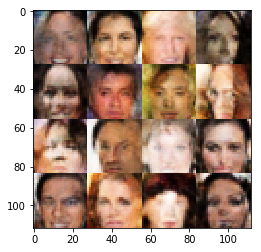

Epoch 5/25... Discriminator Loss: 0.5823... Generator Loss: 1.5694
Epoch 5/25... Discriminator Loss: 0.4938... Generator Loss: 1.4158
Epoch 5/25... Discriminator Loss: 0.9265... Generator Loss: 0.7597
Epoch 5/25... Discriminator Loss: 0.2114... Generator Loss: 2.6196
Epoch 5/25... Discriminator Loss: 1.2621... Generator Loss: 0.5361
Epoch 5/25... Discriminator Loss: 0.1248... Generator Loss: 3.2015
Epoch 5/25... Discriminator Loss: 0.2029... Generator Loss: 2.4392
Epoch 5/25... Discriminator Loss: 0.1520... Generator Loss: 2.8710
Epoch 5/25... Discriminator Loss: 0.2271... Generator Loss: 1.9866
Epoch 5/25... Discriminator Loss: 0.1978... Generator Loss: 2.1869


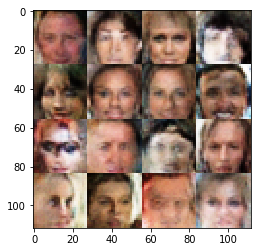

Epoch 5/25... Discriminator Loss: 0.3697... Generator Loss: 1.5327
Epoch 5/25... Discriminator Loss: 0.1979... Generator Loss: 2.5494
Epoch 5/25... Discriminator Loss: 0.1285... Generator Loss: 2.8852
Epoch 5/25... Discriminator Loss: 4.3200... Generator Loss: 9.6262
Epoch 5/25... Discriminator Loss: 0.9661... Generator Loss: 1.3454
Epoch 5/25... Discriminator Loss: 0.5756... Generator Loss: 1.8471
Epoch 5/25... Discriminator Loss: 1.3675... Generator Loss: 0.4389
Epoch 5/25... Discriminator Loss: 0.3584... Generator Loss: 2.3694
Epoch 5/25... Discriminator Loss: 0.3004... Generator Loss: 2.4856
Epoch 5/25... Discriminator Loss: 0.3192... Generator Loss: 1.7614


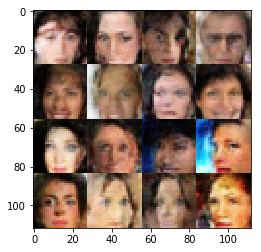

Epoch 5/25... Discriminator Loss: 0.4152... Generator Loss: 1.3995
Epoch 5/25... Discriminator Loss: 0.0825... Generator Loss: 3.3824
Epoch 5/25... Discriminator Loss: 0.0828... Generator Loss: 3.3259
Epoch 5/25... Discriminator Loss: 0.2374... Generator Loss: 2.1490
Epoch 5/25... Discriminator Loss: 0.1437... Generator Loss: 3.6908
Epoch 5/25... Discriminator Loss: 0.1309... Generator Loss: 4.3498
Epoch 5/25... Discriminator Loss: 0.2820... Generator Loss: 1.7931
Epoch 5/25... Discriminator Loss: 0.0815... Generator Loss: 3.4416
Epoch 5/25... Discriminator Loss: 0.1203... Generator Loss: 4.8289
Epoch 5/25... Discriminator Loss: 0.1075... Generator Loss: 3.2063


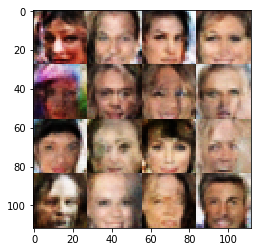

Epoch 5/25... Discriminator Loss: 0.0293... Generator Loss: 5.2047
Epoch 5/25... Discriminator Loss: 0.0712... Generator Loss: 3.3767
Epoch 5/25... Discriminator Loss: 0.2198... Generator Loss: 3.5383
Epoch 5/25... Discriminator Loss: 0.1410... Generator Loss: 3.3803
Epoch 5/25... Discriminator Loss: 0.0519... Generator Loss: 5.4233
Epoch 5/25... Discriminator Loss: 0.3332... Generator Loss: 1.7351
Epoch 5/25... Discriminator Loss: 0.5106... Generator Loss: 1.2154
Epoch 5/25... Discriminator Loss: 0.0583... Generator Loss: 3.9608
Epoch 5/25... Discriminator Loss: 0.0391... Generator Loss: 6.9166
Epoch 5/25... Discriminator Loss: 0.0616... Generator Loss: 4.1908


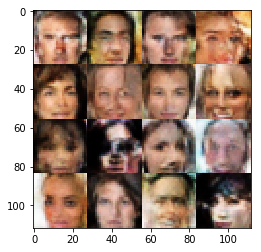

Epoch 5/25... Discriminator Loss: 0.1262... Generator Loss: 2.6138
Epoch 5/25... Discriminator Loss: 0.2126... Generator Loss: 2.1280
Epoch 5/25... Discriminator Loss: 0.0711... Generator Loss: 3.4425
Epoch 5/25... Discriminator Loss: 0.1265... Generator Loss: 2.6986
Epoch 5/25... Discriminator Loss: 2.0984... Generator Loss: 4.0009
Epoch 5/25... Discriminator Loss: 0.8972... Generator Loss: 0.8409
Epoch 5/25... Discriminator Loss: 0.8126... Generator Loss: 0.9143
Epoch 5/25... Discriminator Loss: 0.3726... Generator Loss: 2.1670
Epoch 5/25... Discriminator Loss: 0.4302... Generator Loss: 1.8059
Epoch 5/25... Discriminator Loss: 0.3813... Generator Loss: 1.9801


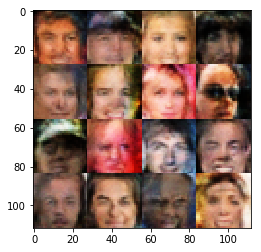

Epoch 5/25... Discriminator Loss: 0.8416... Generator Loss: 0.8010
Epoch 5/25... Discriminator Loss: 0.1276... Generator Loss: 3.4536
Epoch 5/25... Discriminator Loss: 0.0820... Generator Loss: 4.3991
Epoch 5/25... Discriminator Loss: 0.1552... Generator Loss: 2.5968
Epoch 5/25... Discriminator Loss: 0.1558... Generator Loss: 2.4166
Epoch 5/25... Discriminator Loss: 0.2942... Generator Loss: 1.8315
Epoch 5/25... Discriminator Loss: 0.0982... Generator Loss: 3.2107
Epoch 5/25... Discriminator Loss: 0.0831... Generator Loss: 4.2773
Epoch 5/25... Discriminator Loss: 0.0973... Generator Loss: 2.8336
Epoch 5/25... Discriminator Loss: 0.7896... Generator Loss: 1.0966


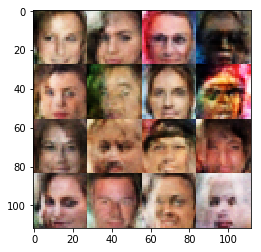

Epoch 5/25... Discriminator Loss: 0.7515... Generator Loss: 0.9251
Epoch 5/25... Discriminator Loss: 0.3330... Generator Loss: 2.1779
Epoch 5/25... Discriminator Loss: 0.8576... Generator Loss: 0.8337
Epoch 5/25... Discriminator Loss: 0.2479... Generator Loss: 2.1481
Epoch 5/25... Discriminator Loss: 0.2288... Generator Loss: 2.2468
Epoch 5/25... Discriminator Loss: 0.3028... Generator Loss: 1.8815
Epoch 5/25... Discriminator Loss: 0.1185... Generator Loss: 2.7829
Epoch 5/25... Discriminator Loss: 0.0695... Generator Loss: 3.5537
Epoch 5/25... Discriminator Loss: 0.2110... Generator Loss: 2.1651
Epoch 5/25... Discriminator Loss: 0.2764... Generator Loss: 1.8449


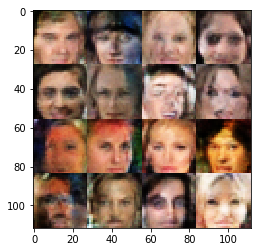

Epoch 5/25... Discriminator Loss: 0.1718... Generator Loss: 2.2932
Epoch 6/25... Discriminator Loss: 0.3234... Generator Loss: 1.7356
Epoch 6/25... Discriminator Loss: 0.6139... Generator Loss: 1.0296
Epoch 6/25... Discriminator Loss: 0.1124... Generator Loss: 2.7962
Epoch 6/25... Discriminator Loss: 0.1051... Generator Loss: 3.5133
Epoch 6/25... Discriminator Loss: 0.1292... Generator Loss: 3.0929
Epoch 6/25... Discriminator Loss: 0.1470... Generator Loss: 2.6062
Epoch 6/25... Discriminator Loss: 0.0795... Generator Loss: 3.7155
Epoch 6/25... Discriminator Loss: 0.1092... Generator Loss: 2.9054
Epoch 6/25... Discriminator Loss: 0.0910... Generator Loss: 3.1931


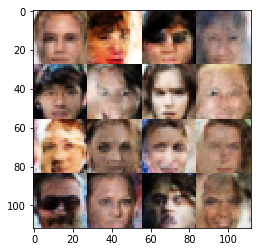

Epoch 6/25... Discriminator Loss: 0.0441... Generator Loss: 4.0204
Epoch 6/25... Discriminator Loss: 0.3383... Generator Loss: 1.5514
Epoch 6/25... Discriminator Loss: 4.8612... Generator Loss: 8.7076
Epoch 6/25... Discriminator Loss: 0.7125... Generator Loss: 1.1312
Epoch 6/25... Discriminator Loss: 0.3269... Generator Loss: 1.6802
Epoch 6/25... Discriminator Loss: 0.3532... Generator Loss: 2.3320
Epoch 6/25... Discriminator Loss: 0.3091... Generator Loss: 1.8931
Epoch 6/25... Discriminator Loss: 0.4666... Generator Loss: 1.3917
Epoch 6/25... Discriminator Loss: 0.3707... Generator Loss: 1.6075
Epoch 6/25... Discriminator Loss: 0.6682... Generator Loss: 0.9521


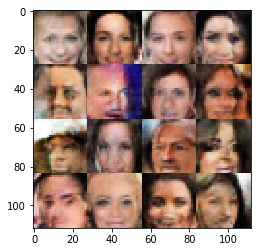

Epoch 6/25... Discriminator Loss: 0.0638... Generator Loss: 3.6980
Epoch 6/25... Discriminator Loss: 0.0371... Generator Loss: 4.6426
Epoch 6/25... Discriminator Loss: 0.1814... Generator Loss: 4.3851
Epoch 6/25... Discriminator Loss: 0.1167... Generator Loss: 3.4067
Epoch 6/25... Discriminator Loss: 0.1328... Generator Loss: 4.5810
Epoch 6/25... Discriminator Loss: 0.0989... Generator Loss: 2.8242
Epoch 6/25... Discriminator Loss: 0.2085... Generator Loss: 2.1230
Epoch 6/25... Discriminator Loss: 0.0985... Generator Loss: 2.9293
Epoch 6/25... Discriminator Loss: 0.2072... Generator Loss: 2.1848
Epoch 6/25... Discriminator Loss: 0.1446... Generator Loss: 2.4968


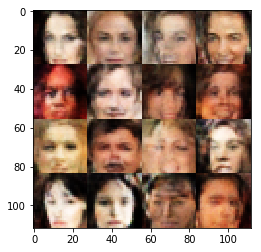

Epoch 6/25... Discriminator Loss: 0.0959... Generator Loss: 2.9793
Epoch 6/25... Discriminator Loss: 0.0567... Generator Loss: 3.7118
Epoch 6/25... Discriminator Loss: 0.1019... Generator Loss: 2.9734
Epoch 6/25... Discriminator Loss: 0.0838... Generator Loss: 3.2396
Epoch 6/25... Discriminator Loss: 0.1154... Generator Loss: 3.2901
Epoch 6/25... Discriminator Loss: 0.1434... Generator Loss: 2.5508
Epoch 6/25... Discriminator Loss: 0.1534... Generator Loss: 2.5983
Epoch 6/25... Discriminator Loss: 0.0868... Generator Loss: 3.3329
Epoch 6/25... Discriminator Loss: 0.2057... Generator Loss: 2.1995
Epoch 6/25... Discriminator Loss: 0.8381... Generator Loss: 5.3706


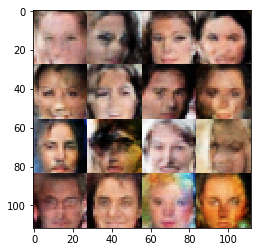

Epoch 6/25... Discriminator Loss: 1.2721... Generator Loss: 0.6288
Epoch 6/25... Discriminator Loss: 0.8936... Generator Loss: 0.8373
Epoch 6/25... Discriminator Loss: 0.8290... Generator Loss: 1.8475
Epoch 6/25... Discriminator Loss: 1.2132... Generator Loss: 0.5478
Epoch 6/25... Discriminator Loss: 0.2956... Generator Loss: 2.0947
Epoch 6/25... Discriminator Loss: 0.4160... Generator Loss: 2.3541
Epoch 6/25... Discriminator Loss: 0.3406... Generator Loss: 2.2937
Epoch 6/25... Discriminator Loss: 0.3107... Generator Loss: 1.8605
Epoch 6/25... Discriminator Loss: 0.2614... Generator Loss: 1.9897
Epoch 6/25... Discriminator Loss: 0.3156... Generator Loss: 1.8968


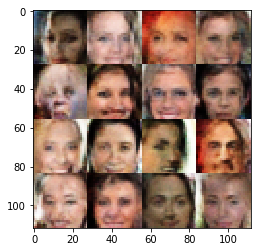

Epoch 6/25... Discriminator Loss: 0.1592... Generator Loss: 2.8529
Epoch 6/25... Discriminator Loss: 0.5799... Generator Loss: 1.1289
Epoch 6/25... Discriminator Loss: 2.2677... Generator Loss: 0.2156
Epoch 6/25... Discriminator Loss: 0.7846... Generator Loss: 1.4208
Epoch 6/25... Discriminator Loss: 0.4027... Generator Loss: 2.1749
Epoch 6/25... Discriminator Loss: 0.5950... Generator Loss: 2.8506
Epoch 6/25... Discriminator Loss: 0.4131... Generator Loss: 1.6726
Epoch 6/25... Discriminator Loss: 0.3052... Generator Loss: 3.3296
Epoch 6/25... Discriminator Loss: 0.4312... Generator Loss: 2.6617
Epoch 6/25... Discriminator Loss: 0.2479... Generator Loss: 2.5301


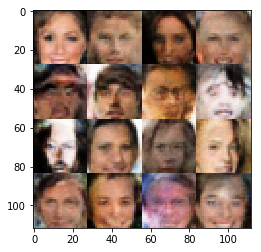

Epoch 6/25... Discriminator Loss: 0.5026... Generator Loss: 1.3563
Epoch 6/25... Discriminator Loss: 0.2482... Generator Loss: 2.1079
Epoch 6/25... Discriminator Loss: 0.1082... Generator Loss: 2.9695
Epoch 6/25... Discriminator Loss: 0.1861... Generator Loss: 2.3408
Epoch 6/25... Discriminator Loss: 0.1801... Generator Loss: 2.4202
Epoch 6/25... Discriminator Loss: 0.5223... Generator Loss: 1.2184
Epoch 6/25... Discriminator Loss: 0.1209... Generator Loss: 3.0092
Epoch 6/25... Discriminator Loss: 1.2290... Generator Loss: 0.4921
Epoch 6/25... Discriminator Loss: 0.2314... Generator Loss: 1.9775
Epoch 6/25... Discriminator Loss: 0.0536... Generator Loss: 4.5632


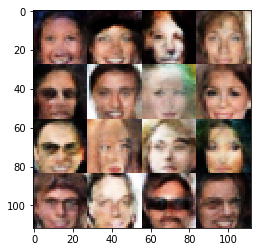

Epoch 6/25... Discriminator Loss: 0.1327... Generator Loss: 2.8439
Epoch 6/25... Discriminator Loss: 0.0739... Generator Loss: 3.5249
Epoch 6/25... Discriminator Loss: 2.0257... Generator Loss: 0.6268
Epoch 6/25... Discriminator Loss: 1.1327... Generator Loss: 0.9852
Epoch 6/25... Discriminator Loss: 1.0746... Generator Loss: 0.9076
Epoch 6/25... Discriminator Loss: 1.1804... Generator Loss: 0.6782
Epoch 6/25... Discriminator Loss: 0.8299... Generator Loss: 1.6045
Epoch 6/25... Discriminator Loss: 0.7343... Generator Loss: 1.5950
Epoch 6/25... Discriminator Loss: 0.6903... Generator Loss: 0.9360
Epoch 6/25... Discriminator Loss: 0.5274... Generator Loss: 2.8952


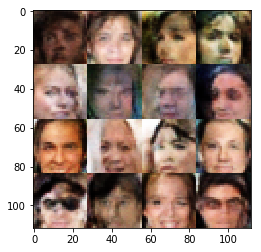

Epoch 6/25... Discriminator Loss: 0.4133... Generator Loss: 1.5733
Epoch 6/25... Discriminator Loss: 0.2547... Generator Loss: 2.7932
Epoch 6/25... Discriminator Loss: 0.2461... Generator Loss: 1.9353
Epoch 6/25... Discriminator Loss: 0.1821... Generator Loss: 2.4513
Epoch 6/25... Discriminator Loss: 0.6395... Generator Loss: 1.0251
Epoch 6/25... Discriminator Loss: 0.0900... Generator Loss: 3.4075
Epoch 6/25... Discriminator Loss: 0.2727... Generator Loss: 1.8124
Epoch 6/25... Discriminator Loss: 0.1890... Generator Loss: 2.3378
Epoch 6/25... Discriminator Loss: 0.2111... Generator Loss: 3.1891
Epoch 6/25... Discriminator Loss: 0.2579... Generator Loss: 1.8230


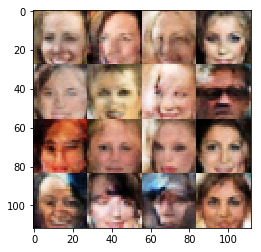

Epoch 6/25... Discriminator Loss: 0.2142... Generator Loss: 2.3990
Epoch 6/25... Discriminator Loss: 0.3198... Generator Loss: 1.6249
Epoch 6/25... Discriminator Loss: 0.1064... Generator Loss: 3.8389
Epoch 6/25... Discriminator Loss: 0.2571... Generator Loss: 3.3163
Epoch 6/25... Discriminator Loss: 0.1577... Generator Loss: 2.6055
Epoch 6/25... Discriminator Loss: 0.3199... Generator Loss: 1.6108
Epoch 6/25... Discriminator Loss: 0.1537... Generator Loss: 2.9019
Epoch 6/25... Discriminator Loss: 0.4292... Generator Loss: 1.3999
Epoch 6/25... Discriminator Loss: 0.1512... Generator Loss: 2.6275
Epoch 6/25... Discriminator Loss: 0.1100... Generator Loss: 3.2167


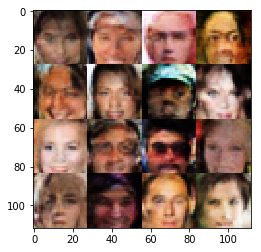

Epoch 6/25... Discriminator Loss: 0.1707... Generator Loss: 2.3653
Epoch 6/25... Discriminator Loss: 0.6878... Generator Loss: 0.9025
Epoch 6/25... Discriminator Loss: 0.1206... Generator Loss: 2.9514
Epoch 6/25... Discriminator Loss: 0.3127... Generator Loss: 1.7247
Epoch 6/25... Discriminator Loss: 0.0793... Generator Loss: 3.0401
Epoch 6/25... Discriminator Loss: 0.1417... Generator Loss: 2.5367
Epoch 6/25... Discriminator Loss: 0.0824... Generator Loss: 3.4988
Epoch 6/25... Discriminator Loss: 0.1417... Generator Loss: 2.5703
Epoch 6/25... Discriminator Loss: 0.0537... Generator Loss: 4.4832
Epoch 6/25... Discriminator Loss: 0.1598... Generator Loss: 3.5619


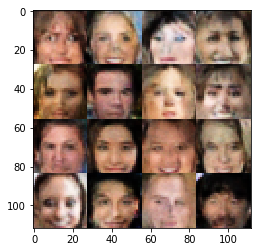

Epoch 6/25... Discriminator Loss: 0.4467... Generator Loss: 1.3852
Epoch 6/25... Discriminator Loss: 0.0269... Generator Loss: 4.3091
Epoch 6/25... Discriminator Loss: 0.1659... Generator Loss: 2.4556
Epoch 6/25... Discriminator Loss: 0.0968... Generator Loss: 3.2693
Epoch 6/25... Discriminator Loss: 0.1337... Generator Loss: 2.5609
Epoch 6/25... Discriminator Loss: 0.1051... Generator Loss: 3.5027
Epoch 6/25... Discriminator Loss: 0.1039... Generator Loss: 2.9798
Epoch 6/25... Discriminator Loss: 0.1046... Generator Loss: 3.2688
Epoch 6/25... Discriminator Loss: 0.1957... Generator Loss: 2.2081
Epoch 6/25... Discriminator Loss: 0.1246... Generator Loss: 2.7810


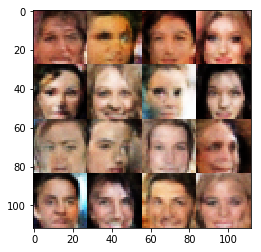

Epoch 6/25... Discriminator Loss: 0.0384... Generator Loss: 4.3550
Epoch 6/25... Discriminator Loss: 0.1698... Generator Loss: 2.3279
Epoch 6/25... Discriminator Loss: 0.2063... Generator Loss: 6.5723
Epoch 6/25... Discriminator Loss: 0.2336... Generator Loss: 2.0313
Epoch 6/25... Discriminator Loss: 0.0910... Generator Loss: 3.2368
Epoch 6/25... Discriminator Loss: 0.1926... Generator Loss: 2.3445
Epoch 6/25... Discriminator Loss: 6.2501... Generator Loss: 8.5142
Epoch 6/25... Discriminator Loss: 1.3015... Generator Loss: 0.8774
Epoch 6/25... Discriminator Loss: 1.2807... Generator Loss: 0.5998
Epoch 6/25... Discriminator Loss: 1.0699... Generator Loss: 1.0039


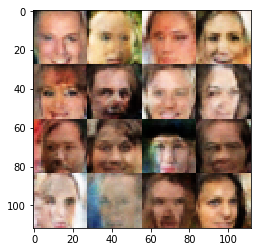

Epoch 6/25... Discriminator Loss: 1.2669... Generator Loss: 0.5058
Epoch 6/25... Discriminator Loss: 1.3541... Generator Loss: 2.1468
Epoch 6/25... Discriminator Loss: 0.8847... Generator Loss: 0.8452
Epoch 6/25... Discriminator Loss: 1.0282... Generator Loss: 3.0315
Epoch 6/25... Discriminator Loss: 1.9501... Generator Loss: 4.8601
Epoch 6/25... Discriminator Loss: 0.8309... Generator Loss: 0.9075
Epoch 6/25... Discriminator Loss: 0.3551... Generator Loss: 2.2756
Epoch 6/25... Discriminator Loss: 0.9559... Generator Loss: 0.7388
Epoch 6/25... Discriminator Loss: 0.5753... Generator Loss: 1.2398
Epoch 6/25... Discriminator Loss: 0.7621... Generator Loss: 0.8984


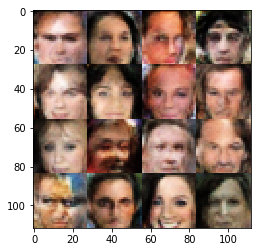

Epoch 6/25... Discriminator Loss: 0.5884... Generator Loss: 4.0845
Epoch 6/25... Discriminator Loss: 0.9650... Generator Loss: 0.7779
Epoch 6/25... Discriminator Loss: 0.7008... Generator Loss: 1.0969
Epoch 6/25... Discriminator Loss: 0.8905... Generator Loss: 2.4518
Epoch 6/25... Discriminator Loss: 0.5527... Generator Loss: 3.2745
Epoch 6/25... Discriminator Loss: 0.2887... Generator Loss: 3.0828
Epoch 6/25... Discriminator Loss: 0.4579... Generator Loss: 2.0195
Epoch 6/25... Discriminator Loss: 1.1391... Generator Loss: 0.6543
Epoch 6/25... Discriminator Loss: 0.3409... Generator Loss: 1.7581
Epoch 6/25... Discriminator Loss: 1.3145... Generator Loss: 0.4732


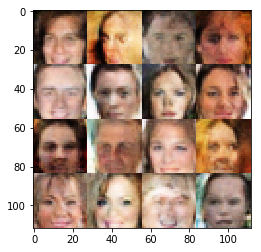

Epoch 6/25... Discriminator Loss: 0.7139... Generator Loss: 2.0458
Epoch 6/25... Discriminator Loss: 0.1755... Generator Loss: 2.4134
Epoch 6/25... Discriminator Loss: 0.2451... Generator Loss: 2.0282
Epoch 6/25... Discriminator Loss: 0.2029... Generator Loss: 2.4758
Epoch 6/25... Discriminator Loss: 0.0784... Generator Loss: 3.5928
Epoch 6/25... Discriminator Loss: 0.1935... Generator Loss: 2.6271
Epoch 6/25... Discriminator Loss: 0.1496... Generator Loss: 3.0236
Epoch 6/25... Discriminator Loss: 0.2151... Generator Loss: 2.4448
Epoch 6/25... Discriminator Loss: 0.1252... Generator Loss: 2.9429
Epoch 7/25... Discriminator Loss: 0.1139... Generator Loss: 3.0035


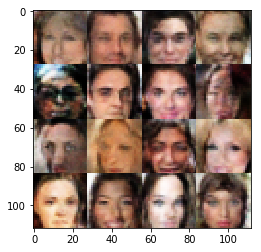

Epoch 7/25... Discriminator Loss: 0.1470... Generator Loss: 2.5625
Epoch 7/25... Discriminator Loss: 0.3683... Generator Loss: 1.6838
Epoch 7/25... Discriminator Loss: 0.4683... Generator Loss: 1.2948
Epoch 7/25... Discriminator Loss: 0.0589... Generator Loss: 3.7967
Epoch 7/25... Discriminator Loss: 0.3448... Generator Loss: 1.6665
Epoch 7/25... Discriminator Loss: 0.0675... Generator Loss: 3.3027
Epoch 7/25... Discriminator Loss: 0.3569... Generator Loss: 1.6741
Epoch 7/25... Discriminator Loss: 0.1288... Generator Loss: 2.7920
Epoch 7/25... Discriminator Loss: 0.1297... Generator Loss: 2.7152
Epoch 7/25... Discriminator Loss: 0.1997... Generator Loss: 2.6088


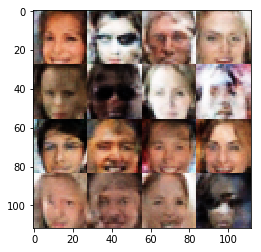

Epoch 7/25... Discriminator Loss: 0.3266... Generator Loss: 1.6926
Epoch 7/25... Discriminator Loss: 0.0565... Generator Loss: 4.1351
Epoch 7/25... Discriminator Loss: 0.0961... Generator Loss: 2.9262
Epoch 7/25... Discriminator Loss: 0.0865... Generator Loss: 5.4519
Epoch 7/25... Discriminator Loss: 0.0606... Generator Loss: 3.3289
Epoch 7/25... Discriminator Loss: 0.1345... Generator Loss: 2.5620
Epoch 7/25... Discriminator Loss: 0.2453... Generator Loss: 1.9501
Epoch 7/25... Discriminator Loss: 0.1277... Generator Loss: 2.9387
Epoch 7/25... Discriminator Loss: 0.0806... Generator Loss: 3.5106
Epoch 7/25... Discriminator Loss: 0.8793... Generator Loss: 0.7262


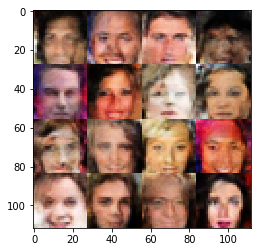

Epoch 7/25... Discriminator Loss: 0.7385... Generator Loss: 0.9007
Epoch 7/25... Discriminator Loss: 0.0213... Generator Loss: 5.2088
Epoch 7/25... Discriminator Loss: 0.3078... Generator Loss: 1.7044
Epoch 7/25... Discriminator Loss: 0.2096... Generator Loss: 2.1051
Epoch 7/25... Discriminator Loss: 0.2027... Generator Loss: 2.2853
Epoch 7/25... Discriminator Loss: 0.1177... Generator Loss: 2.7607
Epoch 7/25... Discriminator Loss: 0.1653... Generator Loss: 2.6258
Epoch 7/25... Discriminator Loss: 0.2380... Generator Loss: 2.5430
Epoch 7/25... Discriminator Loss: 0.0541... Generator Loss: 3.8412
Epoch 7/25... Discriminator Loss: 0.0687... Generator Loss: 3.6023


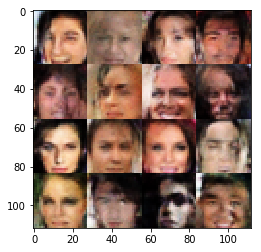

Epoch 7/25... Discriminator Loss: 0.1675... Generator Loss: 2.5507
Epoch 7/25... Discriminator Loss: 0.0792... Generator Loss: 3.2323
Epoch 7/25... Discriminator Loss: 0.6304... Generator Loss: 2.3954
Epoch 7/25... Discriminator Loss: 1.1197... Generator Loss: 3.1542
Epoch 7/25... Discriminator Loss: 1.1049... Generator Loss: 4.4965
Epoch 7/25... Discriminator Loss: 0.2829... Generator Loss: 2.4304
Epoch 7/25... Discriminator Loss: 0.7327... Generator Loss: 0.9330
Epoch 7/25... Discriminator Loss: 0.4626... Generator Loss: 1.4055
Epoch 7/25... Discriminator Loss: 1.1219... Generator Loss: 0.5583
Epoch 7/25... Discriminator Loss: 0.5658... Generator Loss: 1.2596


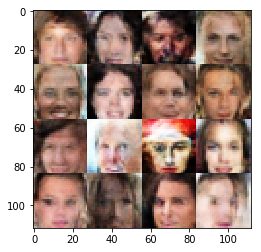

Epoch 7/25... Discriminator Loss: 0.2768... Generator Loss: 1.9892
Epoch 7/25... Discriminator Loss: 0.2850... Generator Loss: 1.8792
Epoch 7/25... Discriminator Loss: 0.5909... Generator Loss: 1.1663
Epoch 7/25... Discriminator Loss: 0.3369... Generator Loss: 1.7987
Epoch 7/25... Discriminator Loss: 0.1776... Generator Loss: 2.3748
Epoch 7/25... Discriminator Loss: 0.1665... Generator Loss: 2.4804
Epoch 7/25... Discriminator Loss: 0.1821... Generator Loss: 2.4383
Epoch 7/25... Discriminator Loss: 0.3001... Generator Loss: 1.7979
Epoch 7/25... Discriminator Loss: 0.2044... Generator Loss: 2.1925
Epoch 7/25... Discriminator Loss: 0.0566... Generator Loss: 6.3693


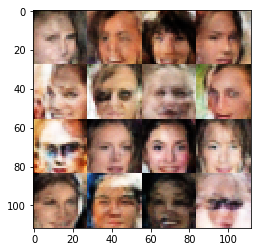

Epoch 7/25... Discriminator Loss: 0.6881... Generator Loss: 0.9897
Epoch 7/25... Discriminator Loss: 0.2259... Generator Loss: 2.1636
Epoch 7/25... Discriminator Loss: 0.3493... Generator Loss: 1.6470
Epoch 7/25... Discriminator Loss: 0.1735... Generator Loss: 2.8475
Epoch 7/25... Discriminator Loss: 0.1431... Generator Loss: 2.5874
Epoch 7/25... Discriminator Loss: 0.1726... Generator Loss: 2.3553
Epoch 7/25... Discriminator Loss: 0.0471... Generator Loss: 4.0690
Epoch 7/25... Discriminator Loss: 0.4308... Generator Loss: 1.3223
Epoch 7/25... Discriminator Loss: 0.0975... Generator Loss: 3.0767
Epoch 7/25... Discriminator Loss: 0.3954... Generator Loss: 1.4060


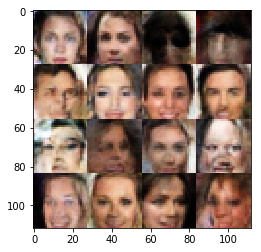

Epoch 7/25... Discriminator Loss: 0.1250... Generator Loss: 2.7471
Epoch 7/25... Discriminator Loss: 0.1159... Generator Loss: 2.7290
Epoch 7/25... Discriminator Loss: 0.0523... Generator Loss: 4.3021
Epoch 7/25... Discriminator Loss: 0.8523... Generator Loss: 0.7406
Epoch 7/25... Discriminator Loss: 0.1719... Generator Loss: 2.3804
Epoch 7/25... Discriminator Loss: 0.0771... Generator Loss: 3.0993
Epoch 7/25... Discriminator Loss: 0.4671... Generator Loss: 1.2782
Epoch 7/25... Discriminator Loss: 0.1474... Generator Loss: 2.6689
Epoch 7/25... Discriminator Loss: 0.1505... Generator Loss: 2.6812
Epoch 7/25... Discriminator Loss: 0.0999... Generator Loss: 3.4167


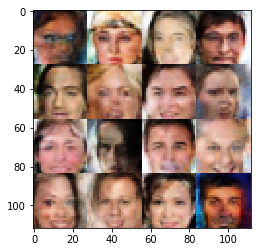

Epoch 7/25... Discriminator Loss: 0.0291... Generator Loss: 5.3442
Epoch 7/25... Discriminator Loss: 0.1093... Generator Loss: 2.9638
Epoch 7/25... Discriminator Loss: 0.1223... Generator Loss: 2.6417
Epoch 7/25... Discriminator Loss: 2.2088... Generator Loss: 1.8001
Epoch 7/25... Discriminator Loss: 1.3406... Generator Loss: 0.6018
Epoch 7/25... Discriminator Loss: 1.2659... Generator Loss: 0.7597
Epoch 7/25... Discriminator Loss: 1.3014... Generator Loss: 0.8184
Epoch 7/25... Discriminator Loss: 1.2302... Generator Loss: 0.8498
Epoch 7/25... Discriminator Loss: 1.3139... Generator Loss: 0.5211
Epoch 7/25... Discriminator Loss: 1.2799... Generator Loss: 1.2874


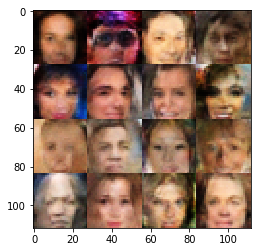

Epoch 7/25... Discriminator Loss: 1.2203... Generator Loss: 1.1562
Epoch 7/25... Discriminator Loss: 1.1466... Generator Loss: 0.8032
Epoch 7/25... Discriminator Loss: 1.2684... Generator Loss: 1.1467
Epoch 7/25... Discriminator Loss: 1.2546... Generator Loss: 1.1136
Epoch 7/25... Discriminator Loss: 1.2028... Generator Loss: 0.6697
Epoch 7/25... Discriminator Loss: 1.2044... Generator Loss: 1.1503
Epoch 7/25... Discriminator Loss: 1.1950... Generator Loss: 0.8223
Epoch 7/25... Discriminator Loss: 1.0700... Generator Loss: 0.9999
Epoch 7/25... Discriminator Loss: 1.2078... Generator Loss: 0.6832
Epoch 7/25... Discriminator Loss: 1.1847... Generator Loss: 0.6330


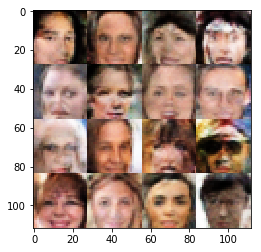

Epoch 7/25... Discriminator Loss: 0.9864... Generator Loss: 0.9710
Epoch 7/25... Discriminator Loss: 0.9722... Generator Loss: 1.8088
Epoch 7/25... Discriminator Loss: 1.0175... Generator Loss: 1.7493
Epoch 7/25... Discriminator Loss: 2.1032... Generator Loss: 3.9944
Epoch 7/25... Discriminator Loss: 0.7209... Generator Loss: 1.4307
Epoch 7/25... Discriminator Loss: 1.1929... Generator Loss: 0.7230
Epoch 7/25... Discriminator Loss: 0.7143... Generator Loss: 1.6173
Epoch 7/25... Discriminator Loss: 0.5090... Generator Loss: 1.9120
Epoch 7/25... Discriminator Loss: 1.8312... Generator Loss: 0.2941
Epoch 7/25... Discriminator Loss: 0.5909... Generator Loss: 2.1330


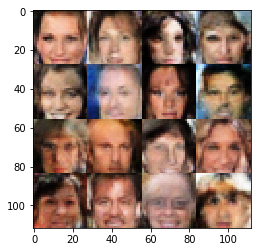

Epoch 7/25... Discriminator Loss: 0.4865... Generator Loss: 2.0688
Epoch 7/25... Discriminator Loss: 0.5811... Generator Loss: 1.2270
Epoch 7/25... Discriminator Loss: 0.3024... Generator Loss: 3.1118
Epoch 7/25... Discriminator Loss: 1.0009... Generator Loss: 0.7472
Epoch 7/25... Discriminator Loss: 0.7410... Generator Loss: 1.0026
Epoch 7/25... Discriminator Loss: 0.5893... Generator Loss: 1.1095
Epoch 7/25... Discriminator Loss: 0.6565... Generator Loss: 1.0439
Epoch 7/25... Discriminator Loss: 0.9350... Generator Loss: 0.7098
Epoch 7/25... Discriminator Loss: 0.2749... Generator Loss: 1.9084
Epoch 7/25... Discriminator Loss: 0.4196... Generator Loss: 1.4596


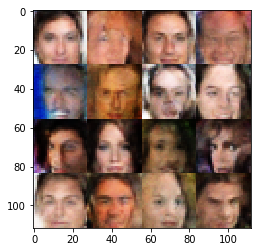

Epoch 7/25... Discriminator Loss: 0.2334... Generator Loss: 2.0500
Epoch 7/25... Discriminator Loss: 0.4309... Generator Loss: 1.4327
Epoch 7/25... Discriminator Loss: 0.2405... Generator Loss: 2.1307
Epoch 7/25... Discriminator Loss: 0.2656... Generator Loss: 2.1394
Epoch 7/25... Discriminator Loss: 0.0515... Generator Loss: 4.4847
Epoch 7/25... Discriminator Loss: 0.2196... Generator Loss: 2.6081
Epoch 7/25... Discriminator Loss: 0.2756... Generator Loss: 1.6697
Epoch 7/25... Discriminator Loss: 0.3201... Generator Loss: 1.6633
Epoch 7/25... Discriminator Loss: 0.6178... Generator Loss: 1.0933
Epoch 7/25... Discriminator Loss: 0.2272... Generator Loss: 2.0627


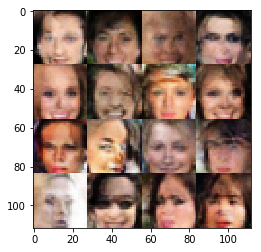

Epoch 7/25... Discriminator Loss: 0.8095... Generator Loss: 0.7909
Epoch 7/25... Discriminator Loss: 0.1408... Generator Loss: 2.6601
Epoch 7/25... Discriminator Loss: 0.1884... Generator Loss: 2.3750
Epoch 7/25... Discriminator Loss: 0.2297... Generator Loss: 2.0418
Epoch 7/25... Discriminator Loss: 0.1198... Generator Loss: 3.0064
Epoch 7/25... Discriminator Loss: 0.2993... Generator Loss: 1.7334
Epoch 7/25... Discriminator Loss: 10.4279... Generator Loss: 10.6620
Epoch 7/25... Discriminator Loss: 0.8483... Generator Loss: 1.2360
Epoch 7/25... Discriminator Loss: 0.6323... Generator Loss: 2.4551
Epoch 7/25... Discriminator Loss: 0.5744... Generator Loss: 1.4569


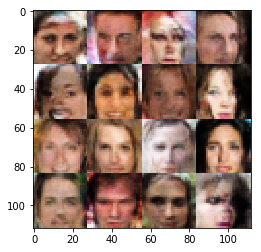

Epoch 7/25... Discriminator Loss: 0.3889... Generator Loss: 1.8158
Epoch 7/25... Discriminator Loss: 0.3735... Generator Loss: 1.7310
Epoch 7/25... Discriminator Loss: 0.2730... Generator Loss: 2.1423
Epoch 7/25... Discriminator Loss: 0.4596... Generator Loss: 1.3629
Epoch 7/25... Discriminator Loss: 0.0372... Generator Loss: 4.5730
Epoch 7/25... Discriminator Loss: 0.6687... Generator Loss: 3.0058
Epoch 7/25... Discriminator Loss: 0.7669... Generator Loss: 1.1003
Epoch 7/25... Discriminator Loss: 0.5658... Generator Loss: 1.3624
Epoch 7/25... Discriminator Loss: 2.2624... Generator Loss: 0.2081
Epoch 7/25... Discriminator Loss: 0.5637... Generator Loss: 1.5752


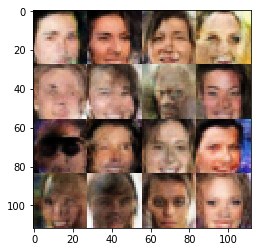

Epoch 7/25... Discriminator Loss: 0.3705... Generator Loss: 1.8329
Epoch 7/25... Discriminator Loss: 0.4269... Generator Loss: 1.4821
Epoch 7/25... Discriminator Loss: 0.3014... Generator Loss: 1.8799
Epoch 7/25... Discriminator Loss: 0.3211... Generator Loss: 1.7141
Epoch 7/25... Discriminator Loss: 0.4034... Generator Loss: 1.4977
Epoch 7/25... Discriminator Loss: 0.4895... Generator Loss: 1.3350
Epoch 7/25... Discriminator Loss: 0.1092... Generator Loss: 2.9087
Epoch 7/25... Discriminator Loss: 0.1957... Generator Loss: 2.4232
Epoch 7/25... Discriminator Loss: 0.0951... Generator Loss: 3.4573
Epoch 7/25... Discriminator Loss: 0.3689... Generator Loss: 1.5133


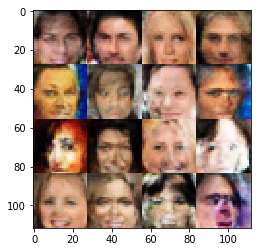

Epoch 7/25... Discriminator Loss: 0.3134... Generator Loss: 1.7922
Epoch 7/25... Discriminator Loss: 0.0579... Generator Loss: 4.5347
Epoch 7/25... Discriminator Loss: 0.1574... Generator Loss: 2.5689
Epoch 7/25... Discriminator Loss: 0.1139... Generator Loss: 2.8265
Epoch 7/25... Discriminator Loss: 0.4668... Generator Loss: 1.3527
Epoch 7/25... Discriminator Loss: 0.4340... Generator Loss: 1.3944
Epoch 7/25... Discriminator Loss: 0.4704... Generator Loss: 1.2955
Epoch 8/25... Discriminator Loss: 0.2351... Generator Loss: 2.0483
Epoch 8/25... Discriminator Loss: 0.4305... Generator Loss: 1.4049
Epoch 8/25... Discriminator Loss: 0.1015... Generator Loss: 3.3322


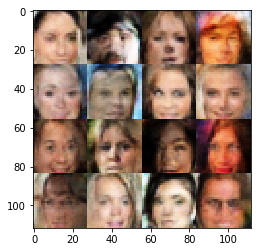

Epoch 8/25... Discriminator Loss: 0.3268... Generator Loss: 1.6903
Epoch 8/25... Discriminator Loss: 0.1048... Generator Loss: 3.2484
Epoch 8/25... Discriminator Loss: 0.1982... Generator Loss: 2.3425
Epoch 8/25... Discriminator Loss: 0.0611... Generator Loss: 4.5954
Epoch 8/25... Discriminator Loss: 0.2861... Generator Loss: 1.9098
Epoch 8/25... Discriminator Loss: 0.1734... Generator Loss: 2.3528
Epoch 8/25... Discriminator Loss: 0.3277... Generator Loss: 1.6418
Epoch 8/25... Discriminator Loss: 0.1199... Generator Loss: 2.7716
Epoch 8/25... Discriminator Loss: 0.0991... Generator Loss: 3.1976
Epoch 8/25... Discriminator Loss: 0.6472... Generator Loss: 0.9807


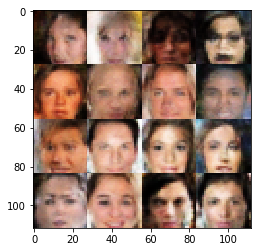

Epoch 8/25... Discriminator Loss: 0.1714... Generator Loss: 2.4384
Epoch 8/25... Discriminator Loss: 0.2111... Generator Loss: 2.1258
Epoch 8/25... Discriminator Loss: 0.1005... Generator Loss: 3.2430
Epoch 8/25... Discriminator Loss: 0.3295... Generator Loss: 1.6709
Epoch 8/25... Discriminator Loss: 0.1287... Generator Loss: 4.4448
Epoch 8/25... Discriminator Loss: 0.3053... Generator Loss: 1.6972
Epoch 8/25... Discriminator Loss: 0.2718... Generator Loss: 1.7742
Epoch 8/25... Discriminator Loss: 0.1211... Generator Loss: 2.7857
Epoch 8/25... Discriminator Loss: 0.1660... Generator Loss: 2.5317
Epoch 8/25... Discriminator Loss: 0.0279... Generator Loss: 4.9310


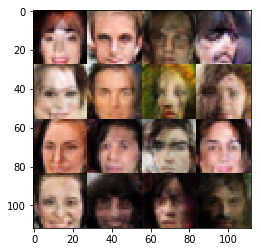

Epoch 8/25... Discriminator Loss: 0.5372... Generator Loss: 1.1369
Epoch 8/25... Discriminator Loss: 0.0564... Generator Loss: 3.7499
Epoch 8/25... Discriminator Loss: 3.5078... Generator Loss: 0.0791
Epoch 8/25... Discriminator Loss: 1.0109... Generator Loss: 1.2043
Epoch 8/25... Discriminator Loss: 1.0640... Generator Loss: 1.9851
Epoch 8/25... Discriminator Loss: 0.7057... Generator Loss: 1.0872
Epoch 8/25... Discriminator Loss: 0.2574... Generator Loss: 2.2514
Epoch 8/25... Discriminator Loss: 0.5045... Generator Loss: 2.5765
Epoch 8/25... Discriminator Loss: 0.9113... Generator Loss: 0.7169
Epoch 8/25... Discriminator Loss: 1.6501... Generator Loss: 0.3438


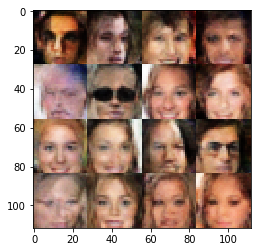

Epoch 8/25... Discriminator Loss: 1.1012... Generator Loss: 0.6954
Epoch 8/25... Discriminator Loss: 0.2802... Generator Loss: 1.9035
Epoch 8/25... Discriminator Loss: 0.3692... Generator Loss: 1.6023
Epoch 8/25... Discriminator Loss: 0.3568... Generator Loss: 1.8936
Epoch 8/25... Discriminator Loss: 0.2237... Generator Loss: 2.2541
Epoch 8/25... Discriminator Loss: 0.1751... Generator Loss: 2.3697
Epoch 8/25... Discriminator Loss: 0.4531... Generator Loss: 1.3542
Epoch 8/25... Discriminator Loss: 0.0816... Generator Loss: 3.2691
Epoch 8/25... Discriminator Loss: 0.3816... Generator Loss: 1.5491
Epoch 8/25... Discriminator Loss: 0.1640... Generator Loss: 3.1189


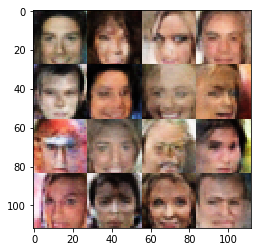

Epoch 8/25... Discriminator Loss: 0.0551... Generator Loss: 3.8297
Epoch 8/25... Discriminator Loss: 0.0958... Generator Loss: 3.2322
Epoch 8/25... Discriminator Loss: 1.2924... Generator Loss: 0.4581
Epoch 8/25... Discriminator Loss: 1.5993... Generator Loss: 1.7783
Epoch 8/25... Discriminator Loss: 1.4003... Generator Loss: 1.2662
Epoch 8/25... Discriminator Loss: 1.1635... Generator Loss: 0.7258
Epoch 8/25... Discriminator Loss: 1.0944... Generator Loss: 0.8236
Epoch 8/25... Discriminator Loss: 1.4271... Generator Loss: 0.4679
Epoch 8/25... Discriminator Loss: 1.0717... Generator Loss: 0.8171
Epoch 8/25... Discriminator Loss: 1.0174... Generator Loss: 0.9721


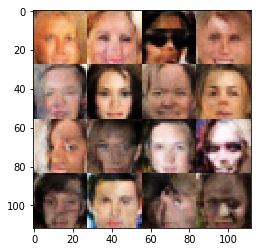

Epoch 8/25... Discriminator Loss: 1.1562... Generator Loss: 1.4209
Epoch 8/25... Discriminator Loss: 1.1365... Generator Loss: 0.5952
Epoch 8/25... Discriminator Loss: 0.9291... Generator Loss: 1.3723
Epoch 8/25... Discriminator Loss: 0.9356... Generator Loss: 3.3432
Epoch 8/25... Discriminator Loss: 0.5448... Generator Loss: 1.5519
Epoch 8/25... Discriminator Loss: 0.4541... Generator Loss: 1.5467
Epoch 8/25... Discriminator Loss: 1.5153... Generator Loss: 4.4109
Epoch 8/25... Discriminator Loss: 0.4704... Generator Loss: 1.4885
Epoch 8/25... Discriminator Loss: 1.0624... Generator Loss: 0.6440
Epoch 8/25... Discriminator Loss: 0.4527... Generator Loss: 1.5511


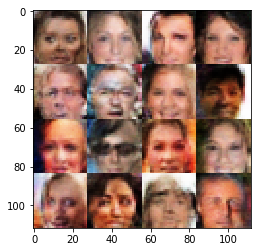

Epoch 8/25... Discriminator Loss: 1.1864... Generator Loss: 0.5355
Epoch 8/25... Discriminator Loss: 0.3020... Generator Loss: 2.2796
Epoch 8/25... Discriminator Loss: 0.5002... Generator Loss: 1.3162
Epoch 8/25... Discriminator Loss: 0.4894... Generator Loss: 1.3239
Epoch 8/25... Discriminator Loss: 0.3214... Generator Loss: 1.8195
Epoch 8/25... Discriminator Loss: 0.2669... Generator Loss: 2.1944
Epoch 8/25... Discriminator Loss: 0.3812... Generator Loss: 1.6606
Epoch 8/25... Discriminator Loss: 0.1495... Generator Loss: 2.7943
Epoch 8/25... Discriminator Loss: 0.2681... Generator Loss: 2.2296
Epoch 8/25... Discriminator Loss: 0.0881... Generator Loss: 3.3906


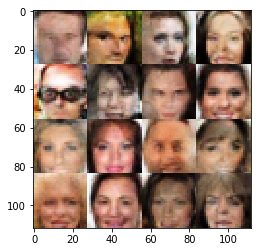

Epoch 8/25... Discriminator Loss: 0.2009... Generator Loss: 2.5200
Epoch 8/25... Discriminator Loss: 0.1941... Generator Loss: 2.1892
Epoch 8/25... Discriminator Loss: 0.2720... Generator Loss: 1.9969
Epoch 8/25... Discriminator Loss: 0.1105... Generator Loss: 2.7104
Epoch 8/25... Discriminator Loss: 0.2243... Generator Loss: 1.9461
Epoch 8/25... Discriminator Loss: 0.1462... Generator Loss: 2.7427
Epoch 8/25... Discriminator Loss: 0.1777... Generator Loss: 2.3792
Epoch 8/25... Discriminator Loss: 0.2198... Generator Loss: 2.0384
Epoch 8/25... Discriminator Loss: 0.1683... Generator Loss: 2.4886
Epoch 8/25... Discriminator Loss: 1.2637... Generator Loss: 0.5122


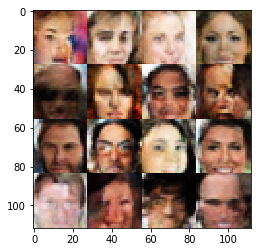

Epoch 8/25... Discriminator Loss: 0.2048... Generator Loss: 2.4172
Epoch 8/25... Discriminator Loss: 0.1238... Generator Loss: 2.8134
Epoch 8/25... Discriminator Loss: 0.2955... Generator Loss: 1.7647
Epoch 8/25... Discriminator Loss: 0.2026... Generator Loss: 2.1853
Epoch 8/25... Discriminator Loss: 0.1840... Generator Loss: 2.4291
Epoch 8/25... Discriminator Loss: 0.0511... Generator Loss: 3.7967
Epoch 8/25... Discriminator Loss: 2.9559... Generator Loss: 4.2673
Epoch 8/25... Discriminator Loss: 0.9595... Generator Loss: 1.6593
Epoch 8/25... Discriminator Loss: 0.6954... Generator Loss: 1.5043
Epoch 8/25... Discriminator Loss: 0.7572... Generator Loss: 3.0950


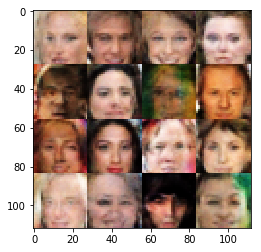

Epoch 8/25... Discriminator Loss: 0.3317... Generator Loss: 2.0445
Epoch 8/25... Discriminator Loss: 0.4390... Generator Loss: 1.5184
Epoch 8/25... Discriminator Loss: 0.2356... Generator Loss: 2.2342
Epoch 8/25... Discriminator Loss: 0.1027... Generator Loss: 3.1891
Epoch 8/25... Discriminator Loss: 0.2735... Generator Loss: 1.8592
Epoch 8/25... Discriminator Loss: 0.3667... Generator Loss: 1.6170
Epoch 8/25... Discriminator Loss: 0.1192... Generator Loss: 2.9381
Epoch 8/25... Discriminator Loss: 0.1283... Generator Loss: 3.2544
Epoch 8/25... Discriminator Loss: 0.1890... Generator Loss: 2.3483
Epoch 8/25... Discriminator Loss: 0.1178... Generator Loss: 3.1798


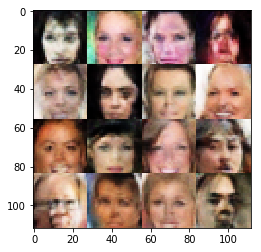

Epoch 8/25... Discriminator Loss: 0.2844... Generator Loss: 1.9329
Epoch 8/25... Discriminator Loss: 0.2442... Generator Loss: 2.0330
Epoch 8/25... Discriminator Loss: 0.1238... Generator Loss: 2.8784
Epoch 8/25... Discriminator Loss: 0.0323... Generator Loss: 4.1617
Epoch 8/25... Discriminator Loss: 0.2741... Generator Loss: 1.9052
Epoch 8/25... Discriminator Loss: 0.4140... Generator Loss: 1.4773
Epoch 8/25... Discriminator Loss: 0.0853... Generator Loss: 3.3872
Epoch 8/25... Discriminator Loss: 0.1124... Generator Loss: 2.9533
Epoch 8/25... Discriminator Loss: 0.0946... Generator Loss: 2.9493
Epoch 8/25... Discriminator Loss: 0.3355... Generator Loss: 1.6154


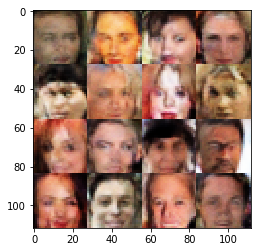

Epoch 8/25... Discriminator Loss: 0.2554... Generator Loss: 1.9251
Epoch 8/25... Discriminator Loss: 0.0764... Generator Loss: 3.6290
Epoch 8/25... Discriminator Loss: 0.1423... Generator Loss: 2.6114
Epoch 8/25... Discriminator Loss: 0.5047... Generator Loss: 1.2941
Epoch 8/25... Discriminator Loss: 0.2102... Generator Loss: 2.1822
Epoch 8/25... Discriminator Loss: 2.7459... Generator Loss: 3.7344
Epoch 8/25... Discriminator Loss: 0.9424... Generator Loss: 1.1089
Epoch 8/25... Discriminator Loss: 0.6631... Generator Loss: 1.7858
Epoch 8/25... Discriminator Loss: 0.6795... Generator Loss: 1.0219
Epoch 8/25... Discriminator Loss: 0.4395... Generator Loss: 2.9919


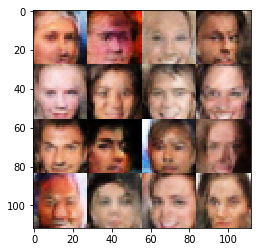

Epoch 8/25... Discriminator Loss: 0.1958... Generator Loss: 2.8767
Epoch 8/25... Discriminator Loss: 0.2511... Generator Loss: 3.2830
Epoch 8/25... Discriminator Loss: 0.4338... Generator Loss: 1.3772
Epoch 8/25... Discriminator Loss: 0.9429... Generator Loss: 0.7460
Epoch 8/25... Discriminator Loss: 1.0864... Generator Loss: 1.5559
Epoch 8/25... Discriminator Loss: 1.0216... Generator Loss: 1.7635
Epoch 8/25... Discriminator Loss: 0.9921... Generator Loss: 0.7663
Epoch 8/25... Discriminator Loss: 1.6026... Generator Loss: 0.3905
Epoch 8/25... Discriminator Loss: 0.5242... Generator Loss: 1.6530
Epoch 8/25... Discriminator Loss: 0.6046... Generator Loss: 1.2907


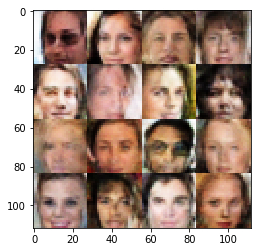

Epoch 8/25... Discriminator Loss: 0.4795... Generator Loss: 1.4710
Epoch 8/25... Discriminator Loss: 0.2056... Generator Loss: 2.5042
Epoch 8/25... Discriminator Loss: 0.7325... Generator Loss: 1.3396
Epoch 8/25... Discriminator Loss: 0.5464... Generator Loss: 1.3524
Epoch 8/25... Discriminator Loss: 1.6537... Generator Loss: 0.3937
Epoch 8/25... Discriminator Loss: 0.4048... Generator Loss: 1.6105
Epoch 8/25... Discriminator Loss: 0.3706... Generator Loss: 1.6558
Epoch 8/25... Discriminator Loss: 0.5118... Generator Loss: 2.7320
Epoch 8/25... Discriminator Loss: 0.5622... Generator Loss: 1.2068
Epoch 8/25... Discriminator Loss: 0.2474... Generator Loss: 2.1536


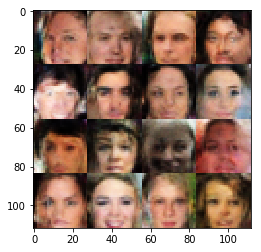

Epoch 8/25... Discriminator Loss: 0.2405... Generator Loss: 2.0796
Epoch 8/25... Discriminator Loss: 0.4518... Generator Loss: 1.3992
Epoch 8/25... Discriminator Loss: 0.5311... Generator Loss: 1.2165
Epoch 8/25... Discriminator Loss: 0.3763... Generator Loss: 1.6408
Epoch 8/25... Discriminator Loss: 0.1620... Generator Loss: 2.4487
Epoch 8/25... Discriminator Loss: 0.1733... Generator Loss: 2.6863
Epoch 8/25... Discriminator Loss: 0.8113... Generator Loss: 0.8749
Epoch 8/25... Discriminator Loss: 0.1544... Generator Loss: 2.4986
Epoch 8/25... Discriminator Loss: 0.4268... Generator Loss: 1.4969
Epoch 8/25... Discriminator Loss: 0.1402... Generator Loss: 2.6077


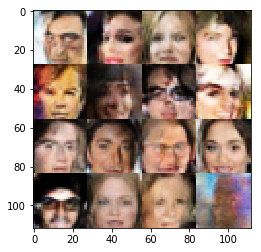

Epoch 8/25... Discriminator Loss: 0.3815... Generator Loss: 1.5425
Epoch 8/25... Discriminator Loss: 0.0832... Generator Loss: 3.3651
Epoch 8/25... Discriminator Loss: 0.1704... Generator Loss: 2.5620
Epoch 8/25... Discriminator Loss: 0.1036... Generator Loss: 2.8393
Epoch 8/25... Discriminator Loss: 0.3700... Generator Loss: 1.5411
Epoch 9/25... Discriminator Loss: 0.3692... Generator Loss: 1.4671
Epoch 9/25... Discriminator Loss: 0.5084... Generator Loss: 1.2042
Epoch 9/25... Discriminator Loss: 0.1133... Generator Loss: 2.8832
Epoch 9/25... Discriminator Loss: 0.1462... Generator Loss: 2.4860
Epoch 9/25... Discriminator Loss: 0.0849... Generator Loss: 3.3953


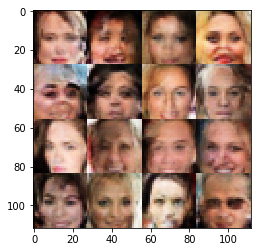

Epoch 9/25... Discriminator Loss: 0.8075... Generator Loss: 0.9049
Epoch 9/25... Discriminator Loss: 0.1342... Generator Loss: 2.6785
Epoch 9/25... Discriminator Loss: 0.2494... Generator Loss: 1.9480
Epoch 9/25... Discriminator Loss: 0.0340... Generator Loss: 4.6685
Epoch 9/25... Discriminator Loss: 0.2734... Generator Loss: 1.9584
Epoch 9/25... Discriminator Loss: 0.2239... Generator Loss: 2.1100
Epoch 9/25... Discriminator Loss: 0.2989... Generator Loss: 1.7703
Epoch 9/25... Discriminator Loss: 0.2158... Generator Loss: 2.1072
Epoch 9/25... Discriminator Loss: 0.4382... Generator Loss: 1.3934
Epoch 9/25... Discriminator Loss: 0.1891... Generator Loss: 2.2932


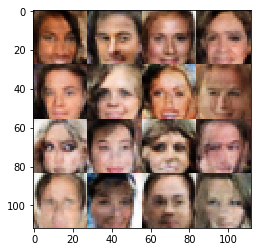

Epoch 9/25... Discriminator Loss: 0.1110... Generator Loss: 2.8237
Epoch 9/25... Discriminator Loss: 0.1602... Generator Loss: 2.3861
Epoch 9/25... Discriminator Loss: 0.2002... Generator Loss: 2.2159
Epoch 9/25... Discriminator Loss: 0.1697... Generator Loss: 2.3334
Epoch 9/25... Discriminator Loss: 0.2349... Generator Loss: 2.0973
Epoch 9/25... Discriminator Loss: 0.3606... Generator Loss: 1.5823
Epoch 9/25... Discriminator Loss: 0.4504... Generator Loss: 1.3966
Epoch 9/25... Discriminator Loss: 0.0934... Generator Loss: 3.0273
Epoch 9/25... Discriminator Loss: 0.1606... Generator Loss: 2.4497
Epoch 9/25... Discriminator Loss: 0.4826... Generator Loss: 1.2933


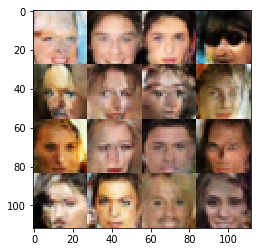

Epoch 9/25... Discriminator Loss: 0.2825... Generator Loss: 3.3077
Epoch 9/25... Discriminator Loss: 1.4422... Generator Loss: 0.8021
Epoch 9/25... Discriminator Loss: 1.4653... Generator Loss: 1.4565
Epoch 9/25... Discriminator Loss: 1.3929... Generator Loss: 1.1463
Epoch 9/25... Discriminator Loss: 1.2434... Generator Loss: 0.8403
Epoch 9/25... Discriminator Loss: 1.0896... Generator Loss: 0.9088
Epoch 9/25... Discriminator Loss: 1.1267... Generator Loss: 0.8277
Epoch 9/25... Discriminator Loss: 1.2786... Generator Loss: 1.2376
Epoch 9/25... Discriminator Loss: 1.0144... Generator Loss: 0.9955
Epoch 9/25... Discriminator Loss: 1.0126... Generator Loss: 1.0969


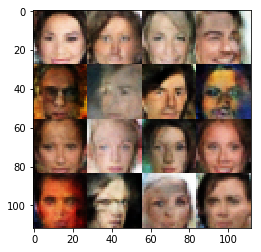

Epoch 9/25... Discriminator Loss: 0.9935... Generator Loss: 0.9345
Epoch 9/25... Discriminator Loss: 0.9840... Generator Loss: 0.8437
Epoch 9/25... Discriminator Loss: 0.9047... Generator Loss: 1.0083
Epoch 9/25... Discriminator Loss: 1.0024... Generator Loss: 1.0998
Epoch 9/25... Discriminator Loss: 0.8153... Generator Loss: 1.2289
Epoch 9/25... Discriminator Loss: 0.8688... Generator Loss: 0.8399
Epoch 9/25... Discriminator Loss: 0.6281... Generator Loss: 2.0122
Epoch 9/25... Discriminator Loss: 0.5939... Generator Loss: 1.2552
Epoch 9/25... Discriminator Loss: 0.6025... Generator Loss: 3.3185
Epoch 9/25... Discriminator Loss: 2.7880... Generator Loss: 6.3652


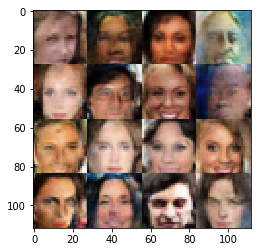

Epoch 9/25... Discriminator Loss: 0.4996... Generator Loss: 1.5555
Epoch 9/25... Discriminator Loss: 1.2289... Generator Loss: 0.5293
Epoch 9/25... Discriminator Loss: 1.4917... Generator Loss: 4.5141
Epoch 9/25... Discriminator Loss: 0.4807... Generator Loss: 1.4331
Epoch 9/25... Discriminator Loss: 0.3937... Generator Loss: 2.6059
Epoch 9/25... Discriminator Loss: 0.5106... Generator Loss: 1.2875
Epoch 9/25... Discriminator Loss: 1.3143... Generator Loss: 0.5173
Epoch 9/25... Discriminator Loss: 0.6347... Generator Loss: 1.9362
Epoch 9/25... Discriminator Loss: 0.5400... Generator Loss: 1.5116
Epoch 9/25... Discriminator Loss: 0.6334... Generator Loss: 1.1157


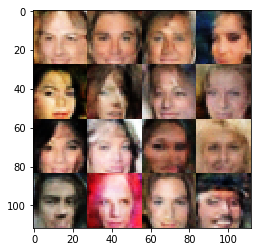

Epoch 9/25... Discriminator Loss: 5.8015... Generator Loss: 8.1535
Epoch 9/25... Discriminator Loss: 0.7545... Generator Loss: 1.3543
Epoch 9/25... Discriminator Loss: 0.6026... Generator Loss: 1.4477
Epoch 9/25... Discriminator Loss: 0.6614... Generator Loss: 2.5124
Epoch 9/25... Discriminator Loss: 0.4900... Generator Loss: 1.4375
Epoch 9/25... Discriminator Loss: 0.7728... Generator Loss: 0.9133
Epoch 9/25... Discriminator Loss: 0.3200... Generator Loss: 1.9337
Epoch 9/25... Discriminator Loss: 0.3945... Generator Loss: 1.6355
Epoch 9/25... Discriminator Loss: 0.1962... Generator Loss: 2.2667
Epoch 9/25... Discriminator Loss: 1.7460... Generator Loss: 0.3231


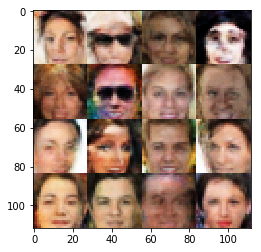

Epoch 9/25... Discriminator Loss: 0.1671... Generator Loss: 3.1409
Epoch 9/25... Discriminator Loss: 0.4904... Generator Loss: 1.4207
Epoch 9/25... Discriminator Loss: 1.1691... Generator Loss: 2.9733
Epoch 9/25... Discriminator Loss: 0.3260... Generator Loss: 2.4370
Epoch 9/25... Discriminator Loss: 0.3781... Generator Loss: 1.6171
Epoch 9/25... Discriminator Loss: 0.4836... Generator Loss: 1.3792
Epoch 9/25... Discriminator Loss: 0.4367... Generator Loss: 1.3938
Epoch 9/25... Discriminator Loss: 0.6638... Generator Loss: 1.0845
Epoch 9/25... Discriminator Loss: 0.2783... Generator Loss: 1.8527
Epoch 9/25... Discriminator Loss: 0.2185... Generator Loss: 2.1576


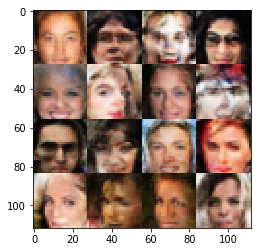

Epoch 9/25... Discriminator Loss: 0.1267... Generator Loss: 2.7892
Epoch 9/25... Discriminator Loss: 0.1102... Generator Loss: 2.9743
Epoch 9/25... Discriminator Loss: 0.2493... Generator Loss: 1.9761
Epoch 9/25... Discriminator Loss: 0.5954... Generator Loss: 1.0821
Epoch 9/25... Discriminator Loss: 0.1975... Generator Loss: 2.3476
Epoch 9/25... Discriminator Loss: 0.4661... Generator Loss: 1.3885
Epoch 9/25... Discriminator Loss: 0.2356... Generator Loss: 2.1072
Epoch 9/25... Discriminator Loss: 1.7099... Generator Loss: 0.3474
Epoch 9/25... Discriminator Loss: 0.5806... Generator Loss: 1.8896
Epoch 9/25... Discriminator Loss: 0.3983... Generator Loss: 1.7942


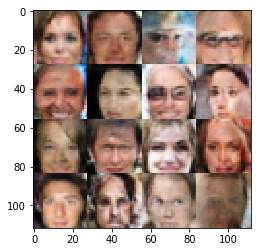

Epoch 9/25... Discriminator Loss: 0.5046... Generator Loss: 1.2959
Epoch 9/25... Discriminator Loss: 0.5708... Generator Loss: 1.1977
Epoch 9/25... Discriminator Loss: 0.3588... Generator Loss: 1.7980
Epoch 9/25... Discriminator Loss: 0.4493... Generator Loss: 1.4382
Epoch 9/25... Discriminator Loss: 0.4276... Generator Loss: 1.4689
Epoch 9/25... Discriminator Loss: 0.1477... Generator Loss: 3.0142
Epoch 9/25... Discriminator Loss: 0.7503... Generator Loss: 0.9403
Epoch 9/25... Discriminator Loss: 0.1729... Generator Loss: 2.6344
Epoch 9/25... Discriminator Loss: 0.1757... Generator Loss: 2.3542
Epoch 9/25... Discriminator Loss: 0.1467... Generator Loss: 2.7195


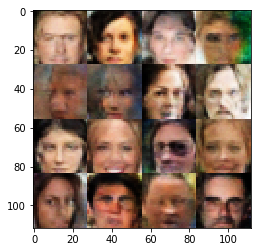

Epoch 9/25... Discriminator Loss: 0.2396... Generator Loss: 2.0237
Epoch 9/25... Discriminator Loss: 0.1800... Generator Loss: 2.4311
Epoch 9/25... Discriminator Loss: 2.0098... Generator Loss: 0.2403
Epoch 9/25... Discriminator Loss: 1.8576... Generator Loss: 2.1696
Epoch 9/25... Discriminator Loss: 1.1336... Generator Loss: 1.0526
Epoch 9/25... Discriminator Loss: 1.1712... Generator Loss: 1.0791
Epoch 9/25... Discriminator Loss: 1.1272... Generator Loss: 1.2924
Epoch 9/25... Discriminator Loss: 1.0562... Generator Loss: 0.7244
Epoch 9/25... Discriminator Loss: 1.0823... Generator Loss: 0.6221
Epoch 9/25... Discriminator Loss: 1.0662... Generator Loss: 0.6255


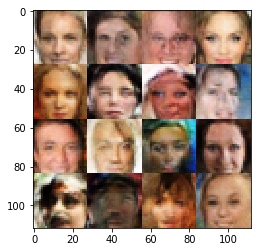

Epoch 9/25... Discriminator Loss: 0.7440... Generator Loss: 2.5984
Epoch 9/25... Discriminator Loss: 0.3852... Generator Loss: 1.9150
Epoch 9/25... Discriminator Loss: 0.5214... Generator Loss: 1.4575
Epoch 9/25... Discriminator Loss: 1.0477... Generator Loss: 0.6730
Epoch 9/25... Discriminator Loss: 0.4557... Generator Loss: 1.4484
Epoch 9/25... Discriminator Loss: 0.3634... Generator Loss: 1.7213
Epoch 9/25... Discriminator Loss: 0.4183... Generator Loss: 1.5469
Epoch 9/25... Discriminator Loss: 0.2213... Generator Loss: 2.6295
Epoch 9/25... Discriminator Loss: 0.1880... Generator Loss: 2.3627
Epoch 9/25... Discriminator Loss: 0.4282... Generator Loss: 1.4611


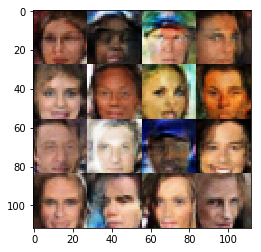

Epoch 9/25... Discriminator Loss: 0.3021... Generator Loss: 1.8748
Epoch 9/25... Discriminator Loss: 0.4174... Generator Loss: 1.4085
Epoch 9/25... Discriminator Loss: 0.4995... Generator Loss: 1.2901
Epoch 9/25... Discriminator Loss: 0.3691... Generator Loss: 1.6764
Epoch 9/25... Discriminator Loss: 0.0781... Generator Loss: 3.6059
Epoch 9/25... Discriminator Loss: 0.1129... Generator Loss: 2.8277
Epoch 9/25... Discriminator Loss: 0.4216... Generator Loss: 1.4217
Epoch 9/25... Discriminator Loss: 0.0890... Generator Loss: 3.0800
Epoch 9/25... Discriminator Loss: 0.2483... Generator Loss: 2.0316
Epoch 9/25... Discriminator Loss: 0.5505... Generator Loss: 1.1363


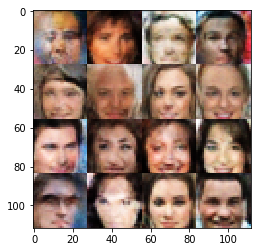

Epoch 9/25... Discriminator Loss: 0.2051... Generator Loss: 2.5027
Epoch 9/25... Discriminator Loss: 0.1874... Generator Loss: 2.3080
Epoch 9/25... Discriminator Loss: 0.0743... Generator Loss: 3.4687
Epoch 9/25... Discriminator Loss: 0.1713... Generator Loss: 2.7597
Epoch 9/25... Discriminator Loss: 0.1297... Generator Loss: 3.0626
Epoch 9/25... Discriminator Loss: 0.2292... Generator Loss: 2.0281
Epoch 9/25... Discriminator Loss: 0.2681... Generator Loss: 1.9039
Epoch 9/25... Discriminator Loss: 0.1901... Generator Loss: 2.4680
Epoch 9/25... Discriminator Loss: 0.1046... Generator Loss: 2.9352
Epoch 9/25... Discriminator Loss: 0.2400... Generator Loss: 1.9044


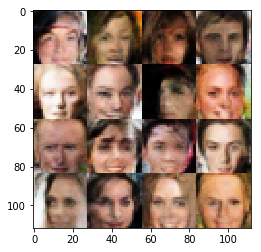

Epoch 9/25... Discriminator Loss: 0.2895... Generator Loss: 3.2580
Epoch 9/25... Discriminator Loss: 0.1825... Generator Loss: 2.4185
Epoch 9/25... Discriminator Loss: 0.2833... Generator Loss: 1.9894
Epoch 9/25... Discriminator Loss: 0.0465... Generator Loss: 4.8916
Epoch 9/25... Discriminator Loss: 0.2330... Generator Loss: 2.0043
Epoch 9/25... Discriminator Loss: 0.1119... Generator Loss: 3.0349
Epoch 9/25... Discriminator Loss: 0.4900... Generator Loss: 1.2268
Epoch 9/25... Discriminator Loss: 0.1376... Generator Loss: 3.2566
Epoch 9/25... Discriminator Loss: 0.2018... Generator Loss: 2.1932
Epoch 9/25... Discriminator Loss: 0.1511... Generator Loss: 2.4623


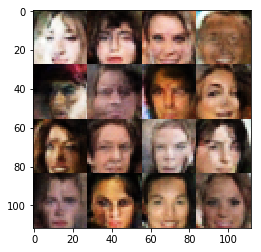

Epoch 9/25... Discriminator Loss: 0.2009... Generator Loss: 2.1994
Epoch 9/25... Discriminator Loss: 0.1548... Generator Loss: 2.6099
Epoch 9/25... Discriminator Loss: 0.0595... Generator Loss: 3.9179
Epoch 9/25... Discriminator Loss: 0.1237... Generator Loss: 2.6543
Epoch 9/25... Discriminator Loss: 0.0967... Generator Loss: 2.9721
Epoch 9/25... Discriminator Loss: 0.2981... Generator Loss: 1.7283
Epoch 9/25... Discriminator Loss: 0.4724... Generator Loss: 1.2893
Epoch 9/25... Discriminator Loss: 0.1020... Generator Loss: 3.0056
Epoch 9/25... Discriminator Loss: 0.0802... Generator Loss: 3.1163
Epoch 9/25... Discriminator Loss: 0.1180... Generator Loss: 2.9739


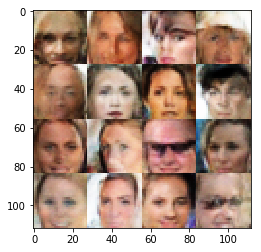

Epoch 9/25... Discriminator Loss: 0.2931... Generator Loss: 1.7886
Epoch 9/25... Discriminator Loss: 0.3977... Generator Loss: 1.5113
Epoch 9/25... Discriminator Loss: 0.2395... Generator Loss: 2.0492
Epoch 10/25... Discriminator Loss: 0.4294... Generator Loss: 1.3874
Epoch 10/25... Discriminator Loss: 0.1578... Generator Loss: 2.2948
Epoch 10/25... Discriminator Loss: 0.3021... Generator Loss: 1.7795
Epoch 10/25... Discriminator Loss: 0.3324... Generator Loss: 1.6768
Epoch 10/25... Discriminator Loss: 0.1885... Generator Loss: 2.2422
Epoch 10/25... Discriminator Loss: 0.1030... Generator Loss: 2.9742
Epoch 10/25... Discriminator Loss: 1.4099... Generator Loss: 0.4279


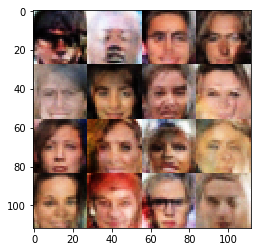

Epoch 10/25... Discriminator Loss: 1.3803... Generator Loss: 1.6197
Epoch 10/25... Discriminator Loss: 1.1681... Generator Loss: 0.8119
Epoch 10/25... Discriminator Loss: 1.1078... Generator Loss: 0.9054
Epoch 10/25... Discriminator Loss: 1.0112... Generator Loss: 1.3863
Epoch 10/25... Discriminator Loss: 0.7980... Generator Loss: 1.1186
Epoch 10/25... Discriminator Loss: 0.8545... Generator Loss: 1.0520
Epoch 10/25... Discriminator Loss: 1.0134... Generator Loss: 0.6703
Epoch 10/25... Discriminator Loss: 0.6057... Generator Loss: 1.2063
Epoch 10/25... Discriminator Loss: 0.3991... Generator Loss: 2.5106
Epoch 10/25... Discriminator Loss: 0.3068... Generator Loss: 3.2754


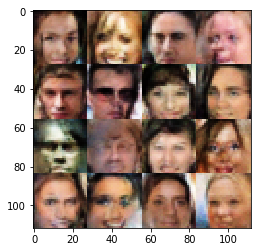

Epoch 10/25... Discriminator Loss: 0.4757... Generator Loss: 1.4390
Epoch 10/25... Discriminator Loss: 0.2801... Generator Loss: 1.9692
Epoch 10/25... Discriminator Loss: 0.1930... Generator Loss: 2.3276
Epoch 10/25... Discriminator Loss: 1.3442... Generator Loss: 0.5281
Epoch 10/25... Discriminator Loss: 0.3560... Generator Loss: 2.3134
Epoch 10/25... Discriminator Loss: 1.5262... Generator Loss: 0.4723
Epoch 10/25... Discriminator Loss: 0.7951... Generator Loss: 4.9656
Epoch 10/25... Discriminator Loss: 0.6144... Generator Loss: 1.7917
Epoch 10/25... Discriminator Loss: 1.6851... Generator Loss: 0.3798
Epoch 10/25... Discriminator Loss: 0.8226... Generator Loss: 0.8572


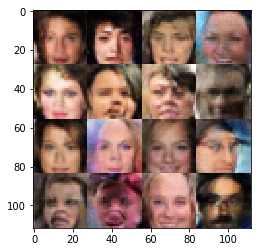

Epoch 10/25... Discriminator Loss: 0.5032... Generator Loss: 1.4129
Epoch 10/25... Discriminator Loss: 0.3551... Generator Loss: 1.9103
Epoch 10/25... Discriminator Loss: 0.8229... Generator Loss: 0.9436
Epoch 10/25... Discriminator Loss: 0.8832... Generator Loss: 0.8167
Epoch 10/25... Discriminator Loss: 0.4201... Generator Loss: 1.4354
Epoch 10/25... Discriminator Loss: 0.5151... Generator Loss: 1.3264
Epoch 10/25... Discriminator Loss: 0.5633... Generator Loss: 1.2184
Epoch 10/25... Discriminator Loss: 0.1058... Generator Loss: 3.2353
Epoch 10/25... Discriminator Loss: 0.6533... Generator Loss: 1.0322
Epoch 10/25... Discriminator Loss: 0.2702... Generator Loss: 1.9944


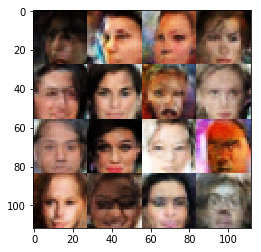

Epoch 10/25... Discriminator Loss: 0.3026... Generator Loss: 1.8144
Epoch 10/25... Discriminator Loss: 0.3764... Generator Loss: 1.5500
Epoch 10/25... Discriminator Loss: 0.4576... Generator Loss: 1.3948
Epoch 10/25... Discriminator Loss: 0.5609... Generator Loss: 1.2050
Epoch 10/25... Discriminator Loss: 0.4121... Generator Loss: 1.6348
Epoch 10/25... Discriminator Loss: 0.1712... Generator Loss: 2.6411
Epoch 10/25... Discriminator Loss: 0.3032... Generator Loss: 1.8143
Epoch 10/25... Discriminator Loss: 0.0608... Generator Loss: 3.5782
Epoch 10/25... Discriminator Loss: 0.4919... Generator Loss: 1.3657
Epoch 10/25... Discriminator Loss: 0.2771... Generator Loss: 2.0637


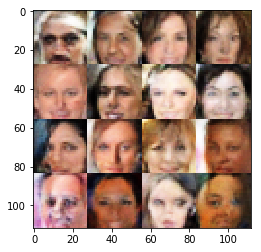

Epoch 10/25... Discriminator Loss: 0.4430... Generator Loss: 1.3348
Epoch 10/25... Discriminator Loss: 0.2433... Generator Loss: 1.9892
Epoch 10/25... Discriminator Loss: 1.6796... Generator Loss: 0.3115
Epoch 10/25... Discriminator Loss: 0.6611... Generator Loss: 1.0290
Epoch 10/25... Discriminator Loss: 0.4733... Generator Loss: 1.3342
Epoch 10/25... Discriminator Loss: 0.0417... Generator Loss: 4.2100
Epoch 10/25... Discriminator Loss: 0.2742... Generator Loss: 1.8184
Epoch 10/25... Discriminator Loss: 0.2067... Generator Loss: 2.1097
Epoch 10/25... Discriminator Loss: 0.6560... Generator Loss: 0.9694
Epoch 10/25... Discriminator Loss: 0.2372... Generator Loss: 1.9992


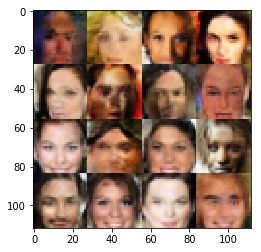

Epoch 10/25... Discriminator Loss: 0.2429... Generator Loss: 2.1338
Epoch 10/25... Discriminator Loss: 0.4707... Generator Loss: 1.2885
Epoch 10/25... Discriminator Loss: 0.1376... Generator Loss: 2.5860
Epoch 10/25... Discriminator Loss: 0.0360... Generator Loss: 4.5198
Epoch 10/25... Discriminator Loss: 0.0959... Generator Loss: 3.4150
Epoch 10/25... Discriminator Loss: 0.2081... Generator Loss: 2.1375
Epoch 10/25... Discriminator Loss: 0.1842... Generator Loss: 2.2138
Epoch 10/25... Discriminator Loss: 0.2935... Generator Loss: 1.7713
Epoch 10/25... Discriminator Loss: 0.3198... Generator Loss: 1.8627
Epoch 10/25... Discriminator Loss: 2.8439... Generator Loss: 3.8860


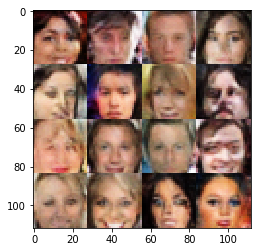

Epoch 10/25... Discriminator Loss: 1.0478... Generator Loss: 0.7949
Epoch 10/25... Discriminator Loss: 0.7339... Generator Loss: 1.1857
Epoch 10/25... Discriminator Loss: 1.0651... Generator Loss: 2.0554
Epoch 10/25... Discriminator Loss: 1.0039... Generator Loss: 2.7064
Epoch 10/25... Discriminator Loss: 0.5728... Generator Loss: 1.8663
Epoch 10/25... Discriminator Loss: 0.5040... Generator Loss: 2.4075
Epoch 10/25... Discriminator Loss: 0.2297... Generator Loss: 2.7453
Epoch 10/25... Discriminator Loss: 0.6803... Generator Loss: 1.2719
Epoch 10/25... Discriminator Loss: 0.5477... Generator Loss: 1.2322
Epoch 10/25... Discriminator Loss: 0.5482... Generator Loss: 1.2789


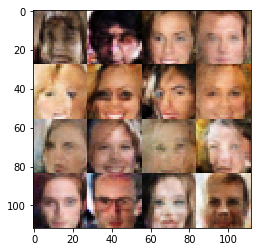

Epoch 10/25... Discriminator Loss: 1.2232... Generator Loss: 3.2553
Epoch 10/25... Discriminator Loss: 0.7320... Generator Loss: 2.0956
Epoch 10/25... Discriminator Loss: 0.5748... Generator Loss: 1.2633
Epoch 10/25... Discriminator Loss: 0.7126... Generator Loss: 1.0099
Epoch 10/25... Discriminator Loss: 0.7803... Generator Loss: 0.9547
Epoch 10/25... Discriminator Loss: 1.3838... Generator Loss: 0.5291
Epoch 10/25... Discriminator Loss: 0.5013... Generator Loss: 1.5183
Epoch 10/25... Discriminator Loss: 0.3856... Generator Loss: 1.7830
Epoch 10/25... Discriminator Loss: 0.4095... Generator Loss: 1.7142
Epoch 10/25... Discriminator Loss: 0.2819... Generator Loss: 1.9547


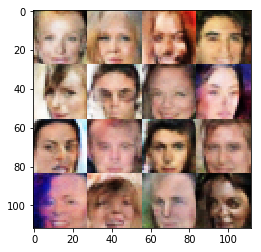

Epoch 10/25... Discriminator Loss: 0.1768... Generator Loss: 2.4393
Epoch 10/25... Discriminator Loss: 0.2466... Generator Loss: 2.5944
Epoch 10/25... Discriminator Loss: 0.5096... Generator Loss: 3.5972
Epoch 10/25... Discriminator Loss: 0.1538... Generator Loss: 2.7405
Epoch 10/25... Discriminator Loss: 0.1378... Generator Loss: 2.6336
Epoch 10/25... Discriminator Loss: 0.3314... Generator Loss: 1.7691
Epoch 10/25... Discriminator Loss: 0.3000... Generator Loss: 3.1487
Epoch 10/25... Discriminator Loss: 0.0853... Generator Loss: 3.3495
Epoch 10/25... Discriminator Loss: 0.2204... Generator Loss: 2.0615
Epoch 10/25... Discriminator Loss: 0.4138... Generator Loss: 1.4837


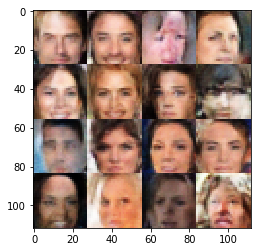

Epoch 10/25... Discriminator Loss: 1.1911... Generator Loss: 0.5430
Epoch 10/25... Discriminator Loss: 0.3954... Generator Loss: 1.5596
Epoch 10/25... Discriminator Loss: 1.0387... Generator Loss: 0.6201
Epoch 10/25... Discriminator Loss: 0.4171... Generator Loss: 1.5176
Epoch 10/25... Discriminator Loss: 0.1830... Generator Loss: 2.5227
Epoch 10/25... Discriminator Loss: 0.2234... Generator Loss: 3.6074
Epoch 10/25... Discriminator Loss: 0.2712... Generator Loss: 1.8618
Epoch 10/25... Discriminator Loss: 0.2056... Generator Loss: 2.4198
Epoch 10/25... Discriminator Loss: 0.2563... Generator Loss: 1.8975
Epoch 10/25... Discriminator Loss: 0.2548... Generator Loss: 1.8816


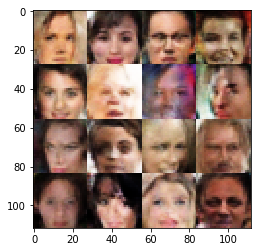

Epoch 10/25... Discriminator Loss: 0.7657... Generator Loss: 0.8862
Epoch 10/25... Discriminator Loss: 0.9717... Generator Loss: 0.6452
Epoch 10/25... Discriminator Loss: 0.1135... Generator Loss: 2.9126
Epoch 10/25... Discriminator Loss: 0.1164... Generator Loss: 3.4290
Epoch 10/25... Discriminator Loss: 0.3243... Generator Loss: 1.6856
Epoch 10/25... Discriminator Loss: 0.7309... Generator Loss: 1.0121
Epoch 10/25... Discriminator Loss: 0.0901... Generator Loss: 3.3399
Epoch 10/25... Discriminator Loss: 0.4266... Generator Loss: 1.4532
Epoch 10/25... Discriminator Loss: 0.1152... Generator Loss: 2.7269
Epoch 10/25... Discriminator Loss: 0.1934... Generator Loss: 2.3725


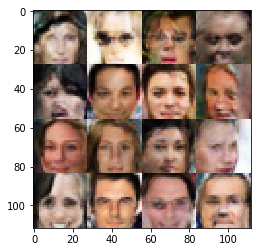

Epoch 10/25... Discriminator Loss: 0.1412... Generator Loss: 2.5512
Epoch 10/25... Discriminator Loss: 0.1448... Generator Loss: 2.7066
Epoch 10/25... Discriminator Loss: 0.3369... Generator Loss: 1.5680
Epoch 10/25... Discriminator Loss: 0.2554... Generator Loss: 1.9053
Epoch 10/25... Discriminator Loss: 0.0916... Generator Loss: 3.4030
Epoch 10/25... Discriminator Loss: 0.1167... Generator Loss: 2.9648
Epoch 10/25... Discriminator Loss: 1.3867... Generator Loss: 2.5072
Epoch 10/25... Discriminator Loss: 0.5015... Generator Loss: 1.5557
Epoch 10/25... Discriminator Loss: 0.4687... Generator Loss: 1.6991
Epoch 10/25... Discriminator Loss: 0.1823... Generator Loss: 2.4490


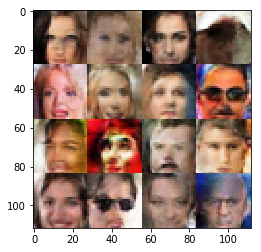

Epoch 10/25... Discriminator Loss: 0.2914... Generator Loss: 2.2218
Epoch 10/25... Discriminator Loss: 0.2787... Generator Loss: 2.3927
Epoch 10/25... Discriminator Loss: 0.3566... Generator Loss: 1.7013
Epoch 10/25... Discriminator Loss: 0.6066... Generator Loss: 1.0650
Epoch 10/25... Discriminator Loss: 0.3205... Generator Loss: 1.6565
Epoch 10/25... Discriminator Loss: 0.3841... Generator Loss: 1.5762
Epoch 10/25... Discriminator Loss: 0.1153... Generator Loss: 4.1055
Epoch 10/25... Discriminator Loss: 0.3411... Generator Loss: 1.7088
Epoch 10/25... Discriminator Loss: 0.2059... Generator Loss: 2.1159
Epoch 10/25... Discriminator Loss: 0.3969... Generator Loss: 1.5674


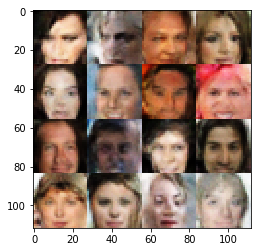

Epoch 10/25... Discriminator Loss: 0.1924... Generator Loss: 2.3563
Epoch 10/25... Discriminator Loss: 0.2400... Generator Loss: 1.9976
Epoch 10/25... Discriminator Loss: 0.1674... Generator Loss: 2.4677
Epoch 10/25... Discriminator Loss: 0.4672... Generator Loss: 1.3230
Epoch 10/25... Discriminator Loss: 0.1864... Generator Loss: 2.3088
Epoch 10/25... Discriminator Loss: 0.1579... Generator Loss: 2.4195
Epoch 10/25... Discriminator Loss: 0.2720... Generator Loss: 1.9587
Epoch 10/25... Discriminator Loss: 0.2644... Generator Loss: 1.9852
Epoch 10/25... Discriminator Loss: 0.1030... Generator Loss: 3.5243
Epoch 10/25... Discriminator Loss: 0.1005... Generator Loss: 3.0060


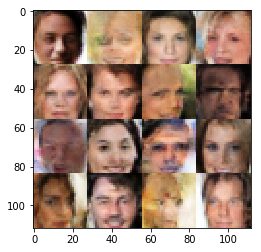

Epoch 10/25... Discriminator Loss: 0.3182... Generator Loss: 1.6652
Epoch 10/25... Discriminator Loss: 0.0798... Generator Loss: 3.4616
Epoch 10/25... Discriminator Loss: 0.2448... Generator Loss: 2.0086
Epoch 10/25... Discriminator Loss: 0.5362... Generator Loss: 1.2597
Epoch 10/25... Discriminator Loss: 0.2366... Generator Loss: 2.0455
Epoch 10/25... Discriminator Loss: 0.0411... Generator Loss: 4.0854
Epoch 10/25... Discriminator Loss: 0.2982... Generator Loss: 1.7519
Epoch 10/25... Discriminator Loss: 0.4716... Generator Loss: 1.3212
Epoch 10/25... Discriminator Loss: 0.0569... Generator Loss: 4.1860
Epoch 10/25... Discriminator Loss: 0.1902... Generator Loss: 2.1415


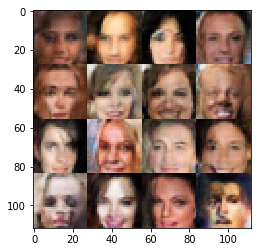

Epoch 10/25... Discriminator Loss: 0.1635... Generator Loss: 2.4380
Epoch 10/25... Discriminator Loss: 0.0398... Generator Loss: 4.0975
Epoch 11/25... Discriminator Loss: 0.1483... Generator Loss: 2.5856
Epoch 11/25... Discriminator Loss: 0.0767... Generator Loss: 3.3872
Epoch 11/25... Discriminator Loss: 0.1043... Generator Loss: 2.8723
Epoch 11/25... Discriminator Loss: 0.3333... Generator Loss: 1.7085
Epoch 11/25... Discriminator Loss: 0.1234... Generator Loss: 2.7223
Epoch 11/25... Discriminator Loss: 1.5362... Generator Loss: 0.3919
Epoch 11/25... Discriminator Loss: 1.7130... Generator Loss: 2.1745
Epoch 11/25... Discriminator Loss: 1.1257... Generator Loss: 0.7584


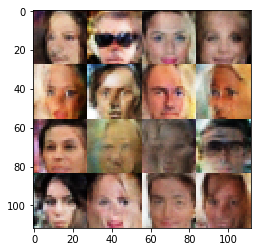

Epoch 11/25... Discriminator Loss: 1.0660... Generator Loss: 0.9362
Epoch 11/25... Discriminator Loss: 1.1319... Generator Loss: 0.6565
Epoch 11/25... Discriminator Loss: 0.7408... Generator Loss: 1.7744
Epoch 11/25... Discriminator Loss: 0.6636... Generator Loss: 1.2428
Epoch 11/25... Discriminator Loss: 0.3955... Generator Loss: 2.3287
Epoch 11/25... Discriminator Loss: 0.4408... Generator Loss: 4.0520
Epoch 11/25... Discriminator Loss: 0.6805... Generator Loss: 1.0733
Epoch 11/25... Discriminator Loss: 0.2594... Generator Loss: 2.4073
Epoch 11/25... Discriminator Loss: 1.1750... Generator Loss: 0.6184
Epoch 11/25... Discriminator Loss: 0.3298... Generator Loss: 2.0610


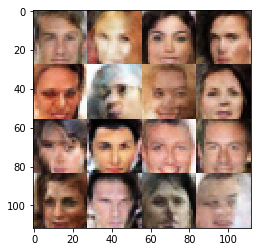

Epoch 11/25... Discriminator Loss: 0.3681... Generator Loss: 1.7813
Epoch 11/25... Discriminator Loss: 0.5308... Generator Loss: 1.2584
Epoch 11/25... Discriminator Loss: 0.3969... Generator Loss: 1.5776
Epoch 11/25... Discriminator Loss: 1.8355... Generator Loss: 0.4909
Epoch 11/25... Discriminator Loss: 0.9592... Generator Loss: 1.4299
Epoch 11/25... Discriminator Loss: 0.9115... Generator Loss: 1.0199
Epoch 11/25... Discriminator Loss: 0.8385... Generator Loss: 1.2844
Epoch 11/25... Discriminator Loss: 0.4752... Generator Loss: 2.3572
Epoch 11/25... Discriminator Loss: 0.4414... Generator Loss: 2.4161
Epoch 11/25... Discriminator Loss: 0.9046... Generator Loss: 0.9326


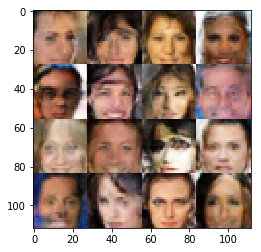

Epoch 11/25... Discriminator Loss: 0.6317... Generator Loss: 1.9836
Epoch 11/25... Discriminator Loss: 1.1484... Generator Loss: 4.5045
Epoch 11/25... Discriminator Loss: 0.3265... Generator Loss: 2.0223
Epoch 11/25... Discriminator Loss: 2.9291... Generator Loss: 2.1627
Epoch 11/25... Discriminator Loss: 1.2108... Generator Loss: 1.0885
Epoch 11/25... Discriminator Loss: 1.1578... Generator Loss: 0.9536
Epoch 11/25... Discriminator Loss: 1.0950... Generator Loss: 1.0687
Epoch 11/25... Discriminator Loss: 1.1071... Generator Loss: 0.7445
Epoch 11/25... Discriminator Loss: 1.1175... Generator Loss: 0.8703
Epoch 11/25... Discriminator Loss: 1.1640... Generator Loss: 1.5876


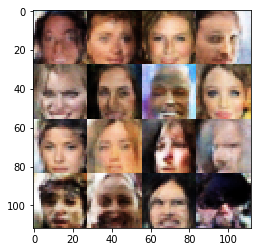

Epoch 11/25... Discriminator Loss: 0.9422... Generator Loss: 0.9680
Epoch 11/25... Discriminator Loss: 0.6927... Generator Loss: 1.7321
Epoch 11/25... Discriminator Loss: 0.4602... Generator Loss: 1.7964
Epoch 11/25... Discriminator Loss: 0.5372... Generator Loss: 1.4768
Epoch 11/25... Discriminator Loss: 1.1269... Generator Loss: 0.6167
Epoch 11/25... Discriminator Loss: 0.4456... Generator Loss: 1.6063
Epoch 11/25... Discriminator Loss: 0.4575... Generator Loss: 2.3988
Epoch 11/25... Discriminator Loss: 0.2413... Generator Loss: 2.1713
Epoch 11/25... Discriminator Loss: 0.1822... Generator Loss: 3.0564
Epoch 11/25... Discriminator Loss: 0.4103... Generator Loss: 1.4598


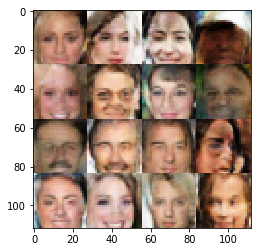

Epoch 11/25... Discriminator Loss: 0.4325... Generator Loss: 1.5333
Epoch 11/25... Discriminator Loss: 0.2553... Generator Loss: 2.1586
Epoch 11/25... Discriminator Loss: 0.2562... Generator Loss: 2.0332
Epoch 11/25... Discriminator Loss: 0.4580... Generator Loss: 1.3439
Epoch 11/25... Discriminator Loss: 0.3213... Generator Loss: 1.7408
Epoch 11/25... Discriminator Loss: 0.3597... Generator Loss: 1.5462
Epoch 11/25... Discriminator Loss: 0.2951... Generator Loss: 1.7329
Epoch 11/25... Discriminator Loss: 0.3808... Generator Loss: 1.5896
Epoch 11/25... Discriminator Loss: 1.2681... Generator Loss: 0.5447
Epoch 11/25... Discriminator Loss: 1.4809... Generator Loss: 0.4462


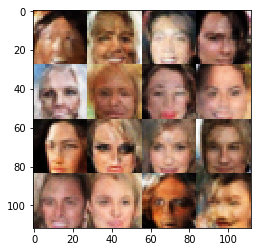

Epoch 11/25... Discriminator Loss: 0.6367... Generator Loss: 2.0844
Epoch 11/25... Discriminator Loss: 0.5209... Generator Loss: 2.6847
Epoch 11/25... Discriminator Loss: 0.2972... Generator Loss: 2.4139
Epoch 11/25... Discriminator Loss: 0.4428... Generator Loss: 1.4307
Epoch 11/25... Discriminator Loss: 0.3027... Generator Loss: 1.9968
Epoch 11/25... Discriminator Loss: 0.4328... Generator Loss: 1.5068
Epoch 11/25... Discriminator Loss: 0.6254... Generator Loss: 1.1022
Epoch 11/25... Discriminator Loss: 0.3226... Generator Loss: 1.7633
Epoch 11/25... Discriminator Loss: 0.6601... Generator Loss: 1.0462
Epoch 11/25... Discriminator Loss: 0.2121... Generator Loss: 2.1528


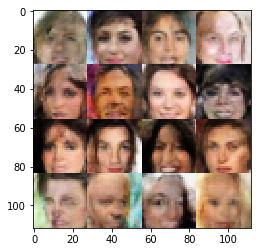

Epoch 11/25... Discriminator Loss: 0.1567... Generator Loss: 2.5152
Epoch 11/25... Discriminator Loss: 0.3376... Generator Loss: 1.6608
Epoch 11/25... Discriminator Loss: 0.0634... Generator Loss: 3.9702
Epoch 11/25... Discriminator Loss: 0.1168... Generator Loss: 3.0982
Epoch 11/25... Discriminator Loss: 0.3021... Generator Loss: 1.7778
Epoch 11/25... Discriminator Loss: 0.3690... Generator Loss: 1.6521
Epoch 11/25... Discriminator Loss: 0.1116... Generator Loss: 2.9751
Epoch 11/25... Discriminator Loss: 0.2350... Generator Loss: 2.0768
Epoch 11/25... Discriminator Loss: 0.2556... Generator Loss: 1.9324
Epoch 11/25... Discriminator Loss: 0.2674... Generator Loss: 1.9736


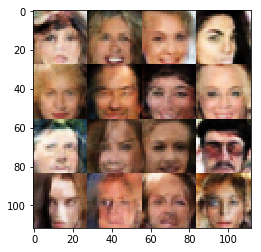

Epoch 11/25... Discriminator Loss: 0.1050... Generator Loss: 3.1591
Epoch 11/25... Discriminator Loss: 0.4534... Generator Loss: 1.4089
Epoch 11/25... Discriminator Loss: 0.3078... Generator Loss: 1.7424
Epoch 11/25... Discriminator Loss: 0.2280... Generator Loss: 2.4295
Epoch 11/25... Discriminator Loss: 0.3896... Generator Loss: 1.5196
Epoch 11/25... Discriminator Loss: 2.2992... Generator Loss: 0.1833
Epoch 11/25... Discriminator Loss: 1.8707... Generator Loss: 0.3008
Epoch 11/25... Discriminator Loss: 0.8955... Generator Loss: 1.0702
Epoch 11/25... Discriminator Loss: 0.6822... Generator Loss: 1.3485
Epoch 11/25... Discriminator Loss: 0.5071... Generator Loss: 2.1406


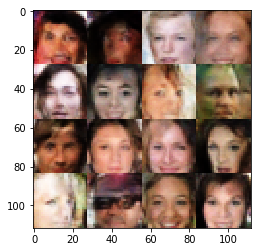

Epoch 11/25... Discriminator Loss: 0.4088... Generator Loss: 1.6217
Epoch 11/25... Discriminator Loss: 0.8037... Generator Loss: 1.1291
Epoch 11/25... Discriminator Loss: 0.6976... Generator Loss: 1.3531
Epoch 11/25... Discriminator Loss: 0.4998... Generator Loss: 1.8253
Epoch 11/25... Discriminator Loss: 0.5197... Generator Loss: 1.3130
Epoch 11/25... Discriminator Loss: 0.4579... Generator Loss: 1.4949
Epoch 11/25... Discriminator Loss: 0.2132... Generator Loss: 2.4189
Epoch 11/25... Discriminator Loss: 0.1927... Generator Loss: 2.4244
Epoch 11/25... Discriminator Loss: 0.2770... Generator Loss: 1.8972
Epoch 11/25... Discriminator Loss: 0.1338... Generator Loss: 2.9017


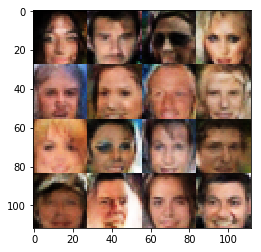

Epoch 11/25... Discriminator Loss: 0.4509... Generator Loss: 1.4239
Epoch 11/25... Discriminator Loss: 0.3844... Generator Loss: 1.6860
Epoch 11/25... Discriminator Loss: 0.0622... Generator Loss: 3.6821
Epoch 11/25... Discriminator Loss: 0.9338... Generator Loss: 0.7681
Epoch 11/25... Discriminator Loss: 0.5014... Generator Loss: 1.3951
Epoch 11/25... Discriminator Loss: 0.3997... Generator Loss: 1.5205
Epoch 11/25... Discriminator Loss: 0.4351... Generator Loss: 1.3677
Epoch 11/25... Discriminator Loss: 0.3417... Generator Loss: 1.7043
Epoch 11/25... Discriminator Loss: 0.3064... Generator Loss: 1.7746
Epoch 11/25... Discriminator Loss: 0.1543... Generator Loss: 2.4578


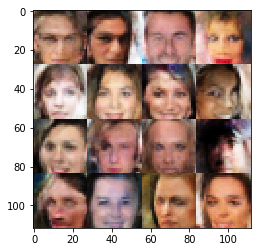

Epoch 11/25... Discriminator Loss: 0.2534... Generator Loss: 1.9850
Epoch 11/25... Discriminator Loss: 0.7718... Generator Loss: 0.8943
Epoch 11/25... Discriminator Loss: 0.0998... Generator Loss: 3.3171
Epoch 11/25... Discriminator Loss: 0.7908... Generator Loss: 0.8807
Epoch 11/25... Discriminator Loss: 0.0938... Generator Loss: 3.3194
Epoch 11/25... Discriminator Loss: 0.2941... Generator Loss: 1.8995
Epoch 11/25... Discriminator Loss: 0.3673... Generator Loss: 1.5735
Epoch 11/25... Discriminator Loss: 0.5048... Generator Loss: 1.2549
Epoch 11/25... Discriminator Loss: 0.2419... Generator Loss: 1.9097
Epoch 11/25... Discriminator Loss: 0.2923... Generator Loss: 1.8075


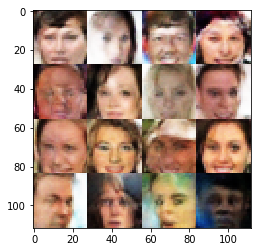

Epoch 11/25... Discriminator Loss: 0.1309... Generator Loss: 2.8120
Epoch 11/25... Discriminator Loss: 0.2714... Generator Loss: 2.1773
Epoch 11/25... Discriminator Loss: 0.1917... Generator Loss: 2.2234
Epoch 11/25... Discriminator Loss: 0.1759... Generator Loss: 2.3801
Epoch 11/25... Discriminator Loss: 2.2708... Generator Loss: 4.8869
Epoch 11/25... Discriminator Loss: 0.4122... Generator Loss: 2.4054
Epoch 11/25... Discriminator Loss: 1.4327... Generator Loss: 0.5423
Epoch 11/25... Discriminator Loss: 0.4769... Generator Loss: 1.4755
Epoch 11/25... Discriminator Loss: 0.3842... Generator Loss: 2.7603
Epoch 11/25... Discriminator Loss: 0.4771... Generator Loss: 1.3583


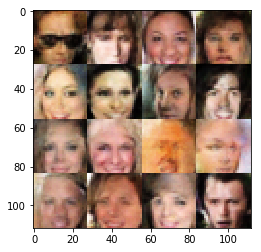

Epoch 11/25... Discriminator Loss: 0.6435... Generator Loss: 0.9975
Epoch 11/25... Discriminator Loss: 0.4750... Generator Loss: 1.4162
Epoch 11/25... Discriminator Loss: 0.3436... Generator Loss: 1.6167
Epoch 11/25... Discriminator Loss: 0.4523... Generator Loss: 1.3505
Epoch 11/25... Discriminator Loss: 0.3769... Generator Loss: 1.5632
Epoch 11/25... Discriminator Loss: 0.3131... Generator Loss: 1.7163
Epoch 11/25... Discriminator Loss: 0.2393... Generator Loss: 4.0886
Epoch 11/25... Discriminator Loss: 0.3666... Generator Loss: 1.5580
Epoch 11/25... Discriminator Loss: 0.1446... Generator Loss: 2.9424
Epoch 11/25... Discriminator Loss: 0.1173... Generator Loss: 2.9223


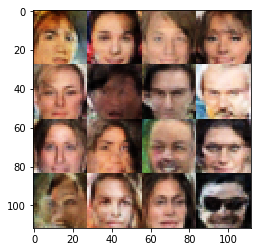

Epoch 11/25... Discriminator Loss: 0.2469... Generator Loss: 1.9632
Epoch 11/25... Discriminator Loss: 0.0420... Generator Loss: 4.5606
Epoch 11/25... Discriminator Loss: 0.3525... Generator Loss: 1.5675
Epoch 11/25... Discriminator Loss: 0.1460... Generator Loss: 2.5920
Epoch 11/25... Discriminator Loss: 0.4486... Generator Loss: 1.3073
Epoch 11/25... Discriminator Loss: 0.0832... Generator Loss: 3.0865
Epoch 11/25... Discriminator Loss: 0.1189... Generator Loss: 2.8214
Epoch 11/25... Discriminator Loss: 0.5275... Generator Loss: 1.2233
Epoch 11/25... Discriminator Loss: 0.0866... Generator Loss: 3.3510
Epoch 11/25... Discriminator Loss: 0.3520... Generator Loss: 1.6388


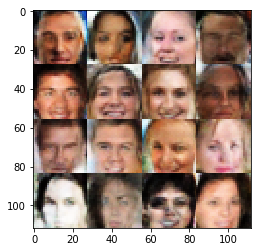

Epoch 11/25... Discriminator Loss: 0.2281... Generator Loss: 2.1889
Epoch 11/25... Discriminator Loss: 0.1251... Generator Loss: 2.8201
Epoch 11/25... Discriminator Loss: 0.1795... Generator Loss: 2.1546
Epoch 11/25... Discriminator Loss: 0.0997... Generator Loss: 3.0303
Epoch 11/25... Discriminator Loss: 0.2886... Generator Loss: 1.7939
Epoch 11/25... Discriminator Loss: 0.1198... Generator Loss: 2.9529
Epoch 11/25... Discriminator Loss: 0.4871... Generator Loss: 1.3815
Epoch 11/25... Discriminator Loss: 0.2199... Generator Loss: 2.1413
Epoch 11/25... Discriminator Loss: 0.1202... Generator Loss: 2.7908
Epoch 11/25... Discriminator Loss: 0.3138... Generator Loss: 1.8005


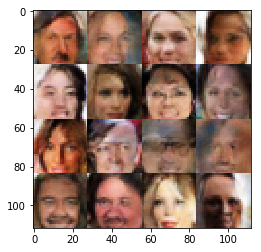

Epoch 12/25... Discriminator Loss: 0.4319... Generator Loss: 1.4779
Epoch 12/25... Discriminator Loss: 0.4274... Generator Loss: 1.4478
Epoch 12/25... Discriminator Loss: 0.2145... Generator Loss: 2.1573
Epoch 12/25... Discriminator Loss: 0.2204... Generator Loss: 2.1458
Epoch 12/25... Discriminator Loss: 0.1572... Generator Loss: 2.5320
Epoch 12/25... Discriminator Loss: 0.3101... Generator Loss: 1.7516
Epoch 12/25... Discriminator Loss: 0.0529... Generator Loss: 3.7164
Epoch 12/25... Discriminator Loss: 0.2815... Generator Loss: 1.9177
Epoch 12/25... Discriminator Loss: 0.2763... Generator Loss: 1.8739
Epoch 12/25... Discriminator Loss: 0.3738... Generator Loss: 1.5271


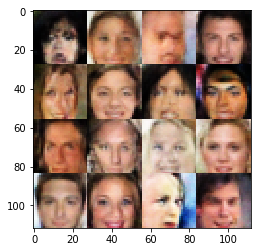

Epoch 12/25... Discriminator Loss: 0.4841... Generator Loss: 1.2899
Epoch 12/25... Discriminator Loss: 1.4857... Generator Loss: 0.4119
Epoch 12/25... Discriminator Loss: 2.0177... Generator Loss: 0.2927
Epoch 12/25... Discriminator Loss: 1.0132... Generator Loss: 1.0035
Epoch 12/25... Discriminator Loss: 1.2568... Generator Loss: 0.7882
Epoch 12/25... Discriminator Loss: 1.3467... Generator Loss: 1.6870
Epoch 12/25... Discriminator Loss: 1.0470... Generator Loss: 2.2876
Epoch 12/25... Discriminator Loss: 0.5779... Generator Loss: 1.4355
Epoch 12/25... Discriminator Loss: 0.5291... Generator Loss: 1.5982
Epoch 12/25... Discriminator Loss: 0.4178... Generator Loss: 1.8538


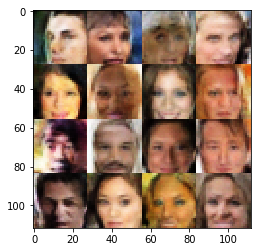

Epoch 12/25... Discriminator Loss: 0.4302... Generator Loss: 1.4502
Epoch 12/25... Discriminator Loss: 0.3672... Generator Loss: 1.7440
Epoch 12/25... Discriminator Loss: 0.4209... Generator Loss: 1.6018
Epoch 12/25... Discriminator Loss: 0.6970... Generator Loss: 1.2769
Epoch 12/25... Discriminator Loss: 0.3539... Generator Loss: 2.1001
Epoch 12/25... Discriminator Loss: 0.2742... Generator Loss: 2.3539
Epoch 12/25... Discriminator Loss: 1.3130... Generator Loss: 0.6527
Epoch 12/25... Discriminator Loss: 0.4545... Generator Loss: 1.5513
Epoch 12/25... Discriminator Loss: 0.3980... Generator Loss: 1.6608
Epoch 12/25... Discriminator Loss: 0.3855... Generator Loss: 1.7188


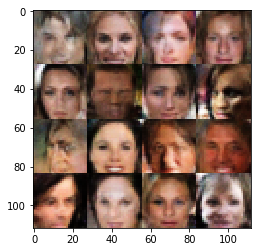

Epoch 12/25... Discriminator Loss: 0.7363... Generator Loss: 4.3020
Epoch 12/25... Discriminator Loss: 1.0928... Generator Loss: 0.7678
Epoch 12/25... Discriminator Loss: 0.6062... Generator Loss: 1.2289
Epoch 12/25... Discriminator Loss: 0.5148... Generator Loss: 1.4612
Epoch 12/25... Discriminator Loss: 0.5198... Generator Loss: 3.8211
Epoch 12/25... Discriminator Loss: 0.3103... Generator Loss: 1.9705
Epoch 12/25... Discriminator Loss: 0.3500... Generator Loss: 1.7382
Epoch 12/25... Discriminator Loss: 0.5059... Generator Loss: 1.3511
Epoch 12/25... Discriminator Loss: 0.7338... Generator Loss: 1.0189
Epoch 12/25... Discriminator Loss: 0.3988... Generator Loss: 1.5277


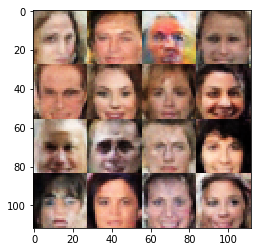

Epoch 12/25... Discriminator Loss: 0.3163... Generator Loss: 1.7813
Epoch 12/25... Discriminator Loss: 0.1107... Generator Loss: 2.9109
Epoch 12/25... Discriminator Loss: 0.5173... Generator Loss: 1.2721
Epoch 12/25... Discriminator Loss: 0.6813... Generator Loss: 1.0299
Epoch 12/25... Discriminator Loss: 0.3024... Generator Loss: 1.9239
Epoch 12/25... Discriminator Loss: 0.3712... Generator Loss: 1.5580
Epoch 12/25... Discriminator Loss: 0.1702... Generator Loss: 2.3498
Epoch 12/25... Discriminator Loss: 0.1793... Generator Loss: 2.3791
Epoch 12/25... Discriminator Loss: 0.5117... Generator Loss: 1.2265
Epoch 12/25... Discriminator Loss: 0.2473... Generator Loss: 2.0443


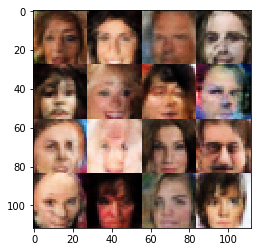

Epoch 12/25... Discriminator Loss: 0.1552... Generator Loss: 2.5710
Epoch 12/25... Discriminator Loss: 3.2468... Generator Loss: 0.1061
Epoch 12/25... Discriminator Loss: 0.5904... Generator Loss: 1.6168
Epoch 12/25... Discriminator Loss: 0.4058... Generator Loss: 1.5858
Epoch 12/25... Discriminator Loss: 1.6480... Generator Loss: 0.3747
Epoch 12/25... Discriminator Loss: 0.2232... Generator Loss: 3.0805
Epoch 12/25... Discriminator Loss: 0.3570... Generator Loss: 1.9124
Epoch 12/25... Discriminator Loss: 0.3088... Generator Loss: 1.9213
Epoch 12/25... Discriminator Loss: 0.5419... Generator Loss: 1.2754
Epoch 12/25... Discriminator Loss: 0.4409... Generator Loss: 1.3677


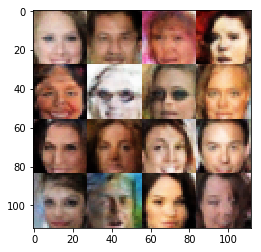

Epoch 12/25... Discriminator Loss: 0.3312... Generator Loss: 1.7542
Epoch 12/25... Discriminator Loss: 0.4894... Generator Loss: 1.2661
Epoch 12/25... Discriminator Loss: 0.2663... Generator Loss: 1.9796
Epoch 12/25... Discriminator Loss: 0.1966... Generator Loss: 2.3838
Epoch 12/25... Discriminator Loss: 0.3063... Generator Loss: 1.8473
Epoch 12/25... Discriminator Loss: 0.3374... Generator Loss: 1.5852
Epoch 12/25... Discriminator Loss: 0.0963... Generator Loss: 2.8992
Epoch 12/25... Discriminator Loss: 0.4014... Generator Loss: 1.4126
Epoch 12/25... Discriminator Loss: 0.2382... Generator Loss: 2.1759
Epoch 12/25... Discriminator Loss: 0.2246... Generator Loss: 2.1735


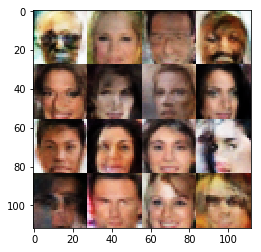

Epoch 12/25... Discriminator Loss: 0.2041... Generator Loss: 2.1409
Epoch 12/25... Discriminator Loss: 0.2108... Generator Loss: 2.0932
Epoch 12/25... Discriminator Loss: 0.2137... Generator Loss: 2.2075
Epoch 12/25... Discriminator Loss: 0.3188... Generator Loss: 2.9646
Epoch 12/25... Discriminator Loss: 0.3452... Generator Loss: 1.6251
Epoch 12/25... Discriminator Loss: 0.0838... Generator Loss: 3.4090
Epoch 12/25... Discriminator Loss: 0.2738... Generator Loss: 1.7941
Epoch 12/25... Discriminator Loss: 0.2832... Generator Loss: 1.8011
Epoch 12/25... Discriminator Loss: 0.4290... Generator Loss: 1.3605
Epoch 12/25... Discriminator Loss: 0.1496... Generator Loss: 3.1848


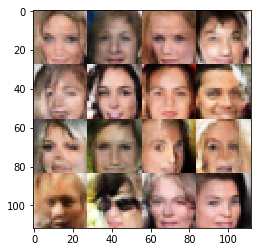

Epoch 12/25... Discriminator Loss: 0.0847... Generator Loss: 3.2983
Epoch 12/25... Discriminator Loss: 0.1925... Generator Loss: 2.2559
Epoch 12/25... Discriminator Loss: 0.4751... Generator Loss: 1.3222
Epoch 12/25... Discriminator Loss: 0.1639... Generator Loss: 2.5157
Epoch 12/25... Discriminator Loss: 0.2746... Generator Loss: 1.8702
Epoch 12/25... Discriminator Loss: 0.1023... Generator Loss: 3.2462
Epoch 12/25... Discriminator Loss: 0.2523... Generator Loss: 1.9401
Epoch 12/25... Discriminator Loss: 0.2322... Generator Loss: 2.1952
Epoch 12/25... Discriminator Loss: 0.0859... Generator Loss: 3.0605
Epoch 12/25... Discriminator Loss: 0.1485... Generator Loss: 2.6705


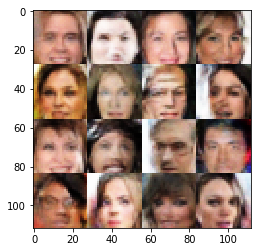

Epoch 12/25... Discriminator Loss: 0.3908... Generator Loss: 1.5680
Epoch 12/25... Discriminator Loss: 0.1696... Generator Loss: 2.2926
Epoch 12/25... Discriminator Loss: 0.2054... Generator Loss: 2.1844
Epoch 12/25... Discriminator Loss: 0.2242... Generator Loss: 2.1124
Epoch 12/25... Discriminator Loss: 0.2220... Generator Loss: 2.0644
Epoch 12/25... Discriminator Loss: 0.7705... Generator Loss: 0.8847
Epoch 12/25... Discriminator Loss: 0.1544... Generator Loss: 2.4384
Epoch 12/25... Discriminator Loss: 0.2934... Generator Loss: 1.9039
Epoch 12/25... Discriminator Loss: 0.2153... Generator Loss: 2.2475
Epoch 12/25... Discriminator Loss: 0.2245... Generator Loss: 2.1608


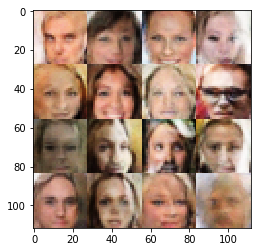

Epoch 12/25... Discriminator Loss: 0.2217... Generator Loss: 2.1412
Epoch 12/25... Discriminator Loss: 0.3546... Generator Loss: 1.5890
Epoch 12/25... Discriminator Loss: 0.1673... Generator Loss: 2.3573
Epoch 12/25... Discriminator Loss: 0.1496... Generator Loss: 2.4262
Epoch 12/25... Discriminator Loss: 0.4801... Generator Loss: 1.3514
Epoch 12/25... Discriminator Loss: 0.1584... Generator Loss: 2.3689
Epoch 12/25... Discriminator Loss: 0.7446... Generator Loss: 0.8965
Epoch 12/25... Discriminator Loss: 8.1280... Generator Loss: 11.1923
Epoch 12/25... Discriminator Loss: 1.3780... Generator Loss: 0.9046
Epoch 12/25... Discriminator Loss: 1.2803... Generator Loss: 0.7777


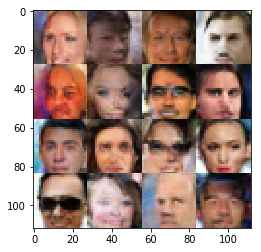

Epoch 12/25... Discriminator Loss: 1.3555... Generator Loss: 0.6347
Epoch 12/25... Discriminator Loss: 1.2074... Generator Loss: 1.0228
Epoch 12/25... Discriminator Loss: 1.2267... Generator Loss: 0.7057
Epoch 12/25... Discriminator Loss: 1.3314... Generator Loss: 0.6793
Epoch 12/25... Discriminator Loss: 1.2849... Generator Loss: 0.7276
Epoch 12/25... Discriminator Loss: 1.2508... Generator Loss: 0.9266
Epoch 12/25... Discriminator Loss: 1.1833... Generator Loss: 0.9311
Epoch 12/25... Discriminator Loss: 1.2333... Generator Loss: 0.8577
Epoch 12/25... Discriminator Loss: 1.2729... Generator Loss: 1.0643
Epoch 12/25... Discriminator Loss: 1.2480... Generator Loss: 0.8943


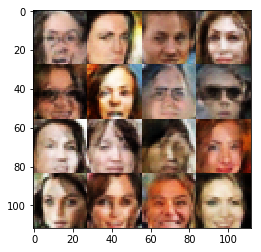

Epoch 12/25... Discriminator Loss: 1.1332... Generator Loss: 1.1098
Epoch 12/25... Discriminator Loss: 1.3693... Generator Loss: 0.6093
Epoch 12/25... Discriminator Loss: 1.1064... Generator Loss: 0.8316
Epoch 12/25... Discriminator Loss: 1.1199... Generator Loss: 0.9237
Epoch 12/25... Discriminator Loss: 1.0242... Generator Loss: 1.0915
Epoch 12/25... Discriminator Loss: 1.3256... Generator Loss: 1.7940
Epoch 12/25... Discriminator Loss: 1.9629... Generator Loss: 0.2689
Epoch 12/25... Discriminator Loss: 1.7664... Generator Loss: 4.4204
Epoch 12/25... Discriminator Loss: 0.8849... Generator Loss: 1.0422
Epoch 12/25... Discriminator Loss: 1.5384... Generator Loss: 0.4650


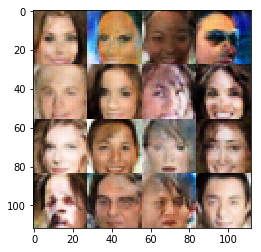

Epoch 12/25... Discriminator Loss: 0.7064... Generator Loss: 4.1969
Epoch 12/25... Discriminator Loss: 0.5183... Generator Loss: 1.9348
Epoch 12/25... Discriminator Loss: 1.2012... Generator Loss: 0.5929
Epoch 12/25... Discriminator Loss: 0.8144... Generator Loss: 0.8821
Epoch 12/25... Discriminator Loss: 0.4956... Generator Loss: 2.6353
Epoch 12/25... Discriminator Loss: 0.2760... Generator Loss: 2.3767
Epoch 12/25... Discriminator Loss: 1.1678... Generator Loss: 0.7756
Epoch 12/25... Discriminator Loss: 0.9776... Generator Loss: 0.8417
Epoch 12/25... Discriminator Loss: 0.8157... Generator Loss: 1.3129
Epoch 12/25... Discriminator Loss: 0.8196... Generator Loss: 0.9063


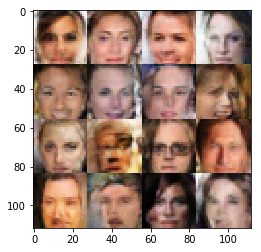

Epoch 12/25... Discriminator Loss: 0.9771... Generator Loss: 0.7673
Epoch 12/25... Discriminator Loss: 0.3585... Generator Loss: 2.0236
Epoch 12/25... Discriminator Loss: 0.6197... Generator Loss: 1.0835
Epoch 12/25... Discriminator Loss: 0.4067... Generator Loss: 1.5854
Epoch 12/25... Discriminator Loss: 0.3226... Generator Loss: 1.9085
Epoch 12/25... Discriminator Loss: 0.7052... Generator Loss: 1.0138
Epoch 12/25... Discriminator Loss: 1.8739... Generator Loss: 0.3274
Epoch 12/25... Discriminator Loss: 0.5633... Generator Loss: 2.1147
Epoch 12/25... Discriminator Loss: 2.2174... Generator Loss: 5.3011
Epoch 12/25... Discriminator Loss: 0.2689... Generator Loss: 2.3222


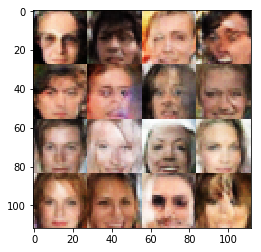

Epoch 12/25... Discriminator Loss: 0.3347... Generator Loss: 2.1442
Epoch 12/25... Discriminator Loss: 0.4170... Generator Loss: 1.5781
Epoch 12/25... Discriminator Loss: 0.3561... Generator Loss: 1.6409
Epoch 12/25... Discriminator Loss: 0.3088... Generator Loss: 1.7038
Epoch 12/25... Discriminator Loss: 0.3324... Generator Loss: 1.7403
Epoch 12/25... Discriminator Loss: 0.8675... Generator Loss: 0.8140
Epoch 12/25... Discriminator Loss: 0.8089... Generator Loss: 0.8967
Epoch 12/25... Discriminator Loss: 0.2986... Generator Loss: 1.7554
Epoch 13/25... Discriminator Loss: 0.0494... Generator Loss: 5.5885
Epoch 13/25... Discriminator Loss: 0.1382... Generator Loss: 2.7327


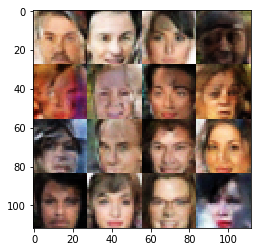

Epoch 13/25... Discriminator Loss: 0.3099... Generator Loss: 1.7584
Epoch 13/25... Discriminator Loss: 0.2022... Generator Loss: 2.4525
Epoch 13/25... Discriminator Loss: 0.3875... Generator Loss: 1.5660
Epoch 13/25... Discriminator Loss: 0.2297... Generator Loss: 2.2030
Epoch 13/25... Discriminator Loss: 0.4405... Generator Loss: 1.3938
Epoch 13/25... Discriminator Loss: 0.2959... Generator Loss: 1.8190
Epoch 13/25... Discriminator Loss: 0.1878... Generator Loss: 2.4401
Epoch 13/25... Discriminator Loss: 0.5394... Generator Loss: 1.2677
Epoch 13/25... Discriminator Loss: 0.7633... Generator Loss: 0.9363
Epoch 13/25... Discriminator Loss: 0.3206... Generator Loss: 1.6985


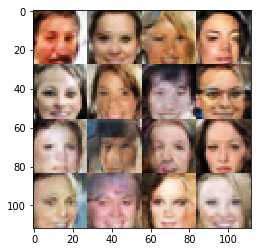

Epoch 13/25... Discriminator Loss: 0.4627... Generator Loss: 1.3064
Epoch 13/25... Discriminator Loss: 0.2439... Generator Loss: 2.0012
Epoch 13/25... Discriminator Loss: 0.3456... Generator Loss: 1.5695
Epoch 13/25... Discriminator Loss: 0.0405... Generator Loss: 5.2000
Epoch 13/25... Discriminator Loss: 0.1690... Generator Loss: 2.5368
Epoch 13/25... Discriminator Loss: 0.1440... Generator Loss: 2.5350
Epoch 13/25... Discriminator Loss: 0.3106... Generator Loss: 1.8014
Epoch 13/25... Discriminator Loss: 0.2736... Generator Loss: 1.8817
Epoch 13/25... Discriminator Loss: 0.1297... Generator Loss: 2.8178
Epoch 13/25... Discriminator Loss: 0.1552... Generator Loss: 2.6006


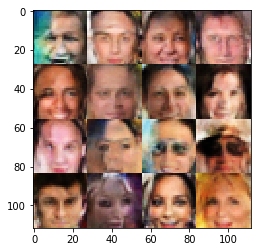

Epoch 13/25... Discriminator Loss: 0.5027... Generator Loss: 1.3441
Epoch 13/25... Discriminator Loss: 0.1364... Generator Loss: 2.5074
Epoch 13/25... Discriminator Loss: 0.3001... Generator Loss: 1.7581
Epoch 13/25... Discriminator Loss: 0.3079... Generator Loss: 1.6994
Epoch 13/25... Discriminator Loss: 0.2355... Generator Loss: 3.1135
Epoch 13/25... Discriminator Loss: 0.9207... Generator Loss: 0.7245
Epoch 13/25... Discriminator Loss: 0.2568... Generator Loss: 1.9689
Epoch 13/25... Discriminator Loss: 0.1667... Generator Loss: 2.4014
Epoch 13/25... Discriminator Loss: 0.2611... Generator Loss: 1.9574
Epoch 13/25... Discriminator Loss: 4.6128... Generator Loss: 6.4733


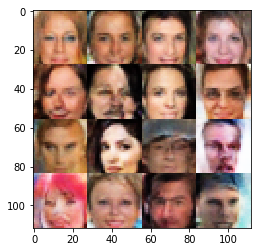

Epoch 13/25... Discriminator Loss: 1.3557... Generator Loss: 1.6257
Epoch 13/25... Discriminator Loss: 1.1201... Generator Loss: 1.1242
Epoch 13/25... Discriminator Loss: 1.2435... Generator Loss: 1.7450
Epoch 13/25... Discriminator Loss: 1.1633... Generator Loss: 0.6406
Epoch 13/25... Discriminator Loss: 1.2314... Generator Loss: 0.5091
Epoch 13/25... Discriminator Loss: 0.7929... Generator Loss: 0.8851
Epoch 13/25... Discriminator Loss: 0.9573... Generator Loss: 0.7309
Epoch 13/25... Discriminator Loss: 1.1108... Generator Loss: 0.6692
Epoch 13/25... Discriminator Loss: 0.4494... Generator Loss: 1.4636
Epoch 13/25... Discriminator Loss: 0.6386... Generator Loss: 1.1571


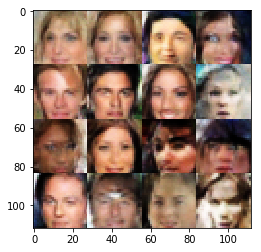

Epoch 13/25... Discriminator Loss: 0.3553... Generator Loss: 1.7001
Epoch 13/25... Discriminator Loss: 0.3530... Generator Loss: 1.7602
Epoch 13/25... Discriminator Loss: 0.8260... Generator Loss: 0.9126
Epoch 13/25... Discriminator Loss: 0.3627... Generator Loss: 1.6723
Epoch 13/25... Discriminator Loss: 0.3793... Generator Loss: 1.6190
Epoch 13/25... Discriminator Loss: 0.3474... Generator Loss: 1.7189
Epoch 13/25... Discriminator Loss: 0.2637... Generator Loss: 2.0141
Epoch 13/25... Discriminator Loss: 0.1620... Generator Loss: 2.4261
Epoch 13/25... Discriminator Loss: 0.4802... Generator Loss: 1.4012
Epoch 13/25... Discriminator Loss: 0.1519... Generator Loss: 2.9108


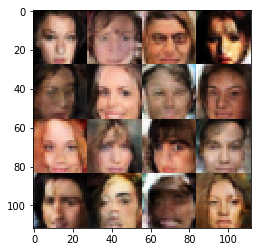

Epoch 13/25... Discriminator Loss: 0.3887... Generator Loss: 1.5433
Epoch 13/25... Discriminator Loss: 0.2696... Generator Loss: 2.0152
Epoch 13/25... Discriminator Loss: 0.3597... Generator Loss: 1.6582
Epoch 13/25... Discriminator Loss: 0.4872... Generator Loss: 1.3517
Epoch 13/25... Discriminator Loss: 0.2347... Generator Loss: 1.9666
Epoch 13/25... Discriminator Loss: 0.3016... Generator Loss: 1.9028
Epoch 13/25... Discriminator Loss: 0.6156... Generator Loss: 1.0437
Epoch 13/25... Discriminator Loss: 0.2973... Generator Loss: 1.8577
Epoch 13/25... Discriminator Loss: 0.2476... Generator Loss: 1.9855
Epoch 13/25... Discriminator Loss: 0.1470... Generator Loss: 2.6021


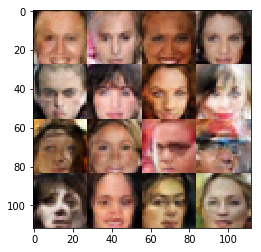

Epoch 13/25... Discriminator Loss: 0.1429... Generator Loss: 2.7256
Epoch 13/25... Discriminator Loss: 0.4402... Generator Loss: 1.3430
Epoch 13/25... Discriminator Loss: 0.1500... Generator Loss: 2.5283
Epoch 13/25... Discriminator Loss: 0.2220... Generator Loss: 2.1847
Epoch 13/25... Discriminator Loss: 0.0697... Generator Loss: 3.6372
Epoch 13/25... Discriminator Loss: 0.1556... Generator Loss: 2.5567
Epoch 13/25... Discriminator Loss: 0.4900... Generator Loss: 1.3656
Epoch 13/25... Discriminator Loss: 0.2601... Generator Loss: 2.0468
Epoch 13/25... Discriminator Loss: 0.2026... Generator Loss: 2.2061
Epoch 13/25... Discriminator Loss: 0.2822... Generator Loss: 1.9300


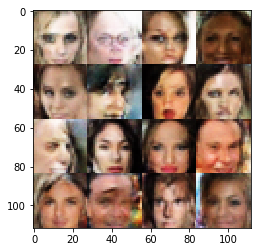

Epoch 13/25... Discriminator Loss: 0.2439... Generator Loss: 1.9958
Epoch 13/25... Discriminator Loss: 0.1781... Generator Loss: 2.3303
Epoch 13/25... Discriminator Loss: 0.3368... Generator Loss: 1.6552
Epoch 13/25... Discriminator Loss: 0.1185... Generator Loss: 2.8312
Epoch 13/25... Discriminator Loss: 0.4294... Generator Loss: 1.3917
Epoch 13/25... Discriminator Loss: 0.1457... Generator Loss: 2.4993
Epoch 13/25... Discriminator Loss: 1.9220... Generator Loss: 0.2770
Epoch 13/25... Discriminator Loss: 1.8071... Generator Loss: 2.4803
Epoch 13/25... Discriminator Loss: 0.9397... Generator Loss: 1.2438
Epoch 13/25... Discriminator Loss: 1.0692... Generator Loss: 0.7808


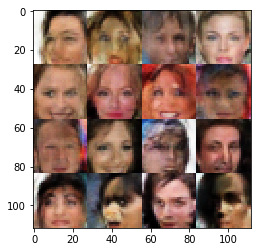

Epoch 13/25... Discriminator Loss: 0.8997... Generator Loss: 0.7992
Epoch 13/25... Discriminator Loss: 0.6038... Generator Loss: 1.1368
Epoch 13/25... Discriminator Loss: 0.4442... Generator Loss: 3.3208
Epoch 13/25... Discriminator Loss: 0.6125... Generator Loss: 3.7544
Epoch 13/25... Discriminator Loss: 0.3096... Generator Loss: 2.0820
Epoch 13/25... Discriminator Loss: 0.6398... Generator Loss: 1.1550
Epoch 13/25... Discriminator Loss: 0.1577... Generator Loss: 2.6470
Epoch 13/25... Discriminator Loss: 0.9796... Generator Loss: 0.8872
Epoch 13/25... Discriminator Loss: 0.6002... Generator Loss: 1.3060
Epoch 13/25... Discriminator Loss: 0.6201... Generator Loss: 1.2243


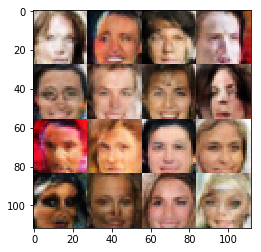

Epoch 13/25... Discriminator Loss: 0.4204... Generator Loss: 3.1363
Epoch 13/25... Discriminator Loss: 0.3797... Generator Loss: 1.9780
Epoch 13/25... Discriminator Loss: 0.3743... Generator Loss: 1.7597
Epoch 13/25... Discriminator Loss: 0.3079... Generator Loss: 2.0046
Epoch 13/25... Discriminator Loss: 0.4301... Generator Loss: 1.4404
Epoch 13/25... Discriminator Loss: 1.0856... Generator Loss: 0.6125
Epoch 13/25... Discriminator Loss: 0.5183... Generator Loss: 1.3155
Epoch 13/25... Discriminator Loss: 0.2251... Generator Loss: 2.1644
Epoch 13/25... Discriminator Loss: 0.1758... Generator Loss: 2.5824
Epoch 13/25... Discriminator Loss: 0.3343... Generator Loss: 1.7480


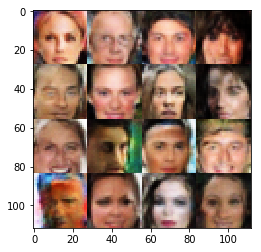

Epoch 13/25... Discriminator Loss: 0.2759... Generator Loss: 1.9554
Epoch 13/25... Discriminator Loss: 0.8803... Generator Loss: 0.8225
Epoch 13/25... Discriminator Loss: 0.1725... Generator Loss: 2.6801
Epoch 13/25... Discriminator Loss: 0.1150... Generator Loss: 3.0919
Epoch 13/25... Discriminator Loss: 1.4628... Generator Loss: 1.4495
Epoch 13/25... Discriminator Loss: 1.2599... Generator Loss: 1.4930
Epoch 13/25... Discriminator Loss: 1.1107... Generator Loss: 1.0340
Epoch 13/25... Discriminator Loss: 1.4204... Generator Loss: 0.3904
Epoch 13/25... Discriminator Loss: 0.8472... Generator Loss: 1.5618
Epoch 13/25... Discriminator Loss: 0.5543... Generator Loss: 1.7441


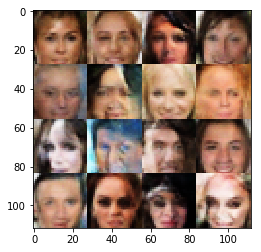

Epoch 13/25... Discriminator Loss: 0.7970... Generator Loss: 0.8591
Epoch 13/25... Discriminator Loss: 0.3368... Generator Loss: 1.8335
Epoch 13/25... Discriminator Loss: 0.8519... Generator Loss: 1.0590
Epoch 13/25... Discriminator Loss: 0.5286... Generator Loss: 2.8574
Epoch 13/25... Discriminator Loss: 1.3057... Generator Loss: 0.5101
Epoch 13/25... Discriminator Loss: 0.6102... Generator Loss: 1.2730
Epoch 13/25... Discriminator Loss: 0.5141... Generator Loss: 1.3608
Epoch 13/25... Discriminator Loss: 0.5770... Generator Loss: 1.1831
Epoch 13/25... Discriminator Loss: 0.2018... Generator Loss: 2.4327
Epoch 13/25... Discriminator Loss: 1.1164... Generator Loss: 4.3239


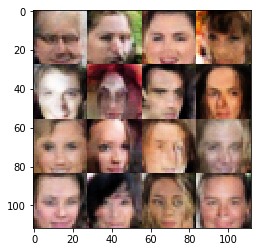

Epoch 13/25... Discriminator Loss: 1.2913... Generator Loss: 0.7256
Epoch 13/25... Discriminator Loss: 1.0642... Generator Loss: 1.1528
Epoch 13/25... Discriminator Loss: 1.0234... Generator Loss: 0.8891
Epoch 13/25... Discriminator Loss: 1.0357... Generator Loss: 0.9293
Epoch 13/25... Discriminator Loss: 0.8222... Generator Loss: 0.9722
Epoch 13/25... Discriminator Loss: 0.6603... Generator Loss: 2.1052
Epoch 13/25... Discriminator Loss: 0.7330... Generator Loss: 2.9814
Epoch 13/25... Discriminator Loss: 0.2213... Generator Loss: 2.4463
Epoch 13/25... Discriminator Loss: 0.3469... Generator Loss: 2.1548
Epoch 13/25... Discriminator Loss: 0.4162... Generator Loss: 1.7336


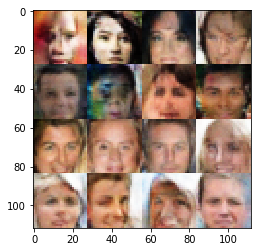

Epoch 13/25... Discriminator Loss: 0.3314... Generator Loss: 1.8456
Epoch 13/25... Discriminator Loss: 0.2280... Generator Loss: 2.8519
Epoch 13/25... Discriminator Loss: 0.2046... Generator Loss: 2.2850
Epoch 13/25... Discriminator Loss: 0.3081... Generator Loss: 1.8381
Epoch 13/25... Discriminator Loss: 0.1365... Generator Loss: 4.3758
Epoch 13/25... Discriminator Loss: 0.5385... Generator Loss: 1.2420
Epoch 13/25... Discriminator Loss: 0.2594... Generator Loss: 1.8004
Epoch 13/25... Discriminator Loss: 0.2432... Generator Loss: 2.0650
Epoch 13/25... Discriminator Loss: 0.2340... Generator Loss: 2.2619
Epoch 13/25... Discriminator Loss: 0.1906... Generator Loss: 3.3492


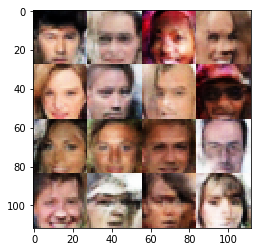

Epoch 13/25... Discriminator Loss: 0.1640... Generator Loss: 2.4681
Epoch 13/25... Discriminator Loss: 0.4979... Generator Loss: 1.2482
Epoch 13/25... Discriminator Loss: 0.2089... Generator Loss: 2.4291
Epoch 13/25... Discriminator Loss: 0.8146... Generator Loss: 0.9018
Epoch 13/25... Discriminator Loss: 0.2434... Generator Loss: 2.1959
Epoch 13/25... Discriminator Loss: 0.2186... Generator Loss: 2.0293
Epoch 13/25... Discriminator Loss: 0.3343... Generator Loss: 1.7466
Epoch 13/25... Discriminator Loss: 0.1585... Generator Loss: 2.8315
Epoch 13/25... Discriminator Loss: 0.2531... Generator Loss: 1.9964
Epoch 13/25... Discriminator Loss: 0.8193... Generator Loss: 0.8555


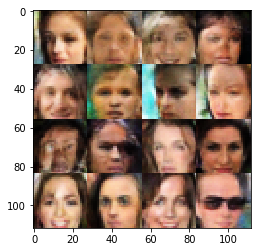

Epoch 13/25... Discriminator Loss: 0.2588... Generator Loss: 1.9298
Epoch 13/25... Discriminator Loss: 0.0743... Generator Loss: 3.6421
Epoch 13/25... Discriminator Loss: 0.1569... Generator Loss: 2.5636
Epoch 13/25... Discriminator Loss: 0.1964... Generator Loss: 2.3602
Epoch 13/25... Discriminator Loss: 0.1626... Generator Loss: 2.4660
Epoch 13/25... Discriminator Loss: 0.4653... Generator Loss: 1.3555
Epoch 14/25... Discriminator Loss: 0.2563... Generator Loss: 2.0807
Epoch 14/25... Discriminator Loss: 0.2788... Generator Loss: 1.9179
Epoch 14/25... Discriminator Loss: 0.1988... Generator Loss: 2.1599
Epoch 14/25... Discriminator Loss: 0.2162... Generator Loss: 2.1680


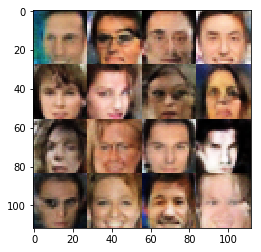

Epoch 14/25... Discriminator Loss: 0.1144... Generator Loss: 3.0186
Epoch 14/25... Discriminator Loss: 0.2488... Generator Loss: 1.9912
Epoch 14/25... Discriminator Loss: 0.2590... Generator Loss: 1.9382
Epoch 14/25... Discriminator Loss: 0.4429... Generator Loss: 1.4921
Epoch 14/25... Discriminator Loss: 0.2396... Generator Loss: 2.0673
Epoch 14/25... Discriminator Loss: 0.1979... Generator Loss: 2.2143
Epoch 14/25... Discriminator Loss: 0.1177... Generator Loss: 2.9205
Epoch 14/25... Discriminator Loss: 0.1534... Generator Loss: 2.6138
Epoch 14/25... Discriminator Loss: 0.0693... Generator Loss: 3.3694
Epoch 14/25... Discriminator Loss: 0.2132... Generator Loss: 2.3664


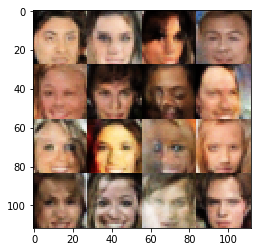

Epoch 14/25... Discriminator Loss: 0.4554... Generator Loss: 1.3770
Epoch 14/25... Discriminator Loss: 0.1681... Generator Loss: 2.4794
Epoch 14/25... Discriminator Loss: 0.1891... Generator Loss: 2.2412
Epoch 14/25... Discriminator Loss: 0.2066... Generator Loss: 2.1198
Epoch 14/25... Discriminator Loss: 0.3251... Generator Loss: 1.7850
Epoch 14/25... Discriminator Loss: 0.5669... Generator Loss: 1.2404
Epoch 14/25... Discriminator Loss: 0.2237... Generator Loss: 2.1570
Epoch 14/25... Discriminator Loss: 0.2082... Generator Loss: 2.1969
Epoch 14/25... Discriminator Loss: 0.3105... Generator Loss: 1.7184
Epoch 14/25... Discriminator Loss: 0.2145... Generator Loss: 2.1857


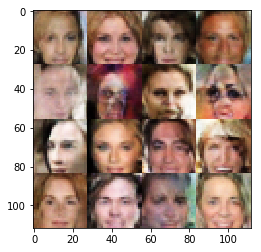

Epoch 14/25... Discriminator Loss: 0.6961... Generator Loss: 0.9900
Epoch 14/25... Discriminator Loss: 0.1418... Generator Loss: 2.4585
Epoch 14/25... Discriminator Loss: 0.2547... Generator Loss: 2.0812
Epoch 14/25... Discriminator Loss: 0.0642... Generator Loss: 4.4881
Epoch 14/25... Discriminator Loss: 0.2997... Generator Loss: 1.7959
Epoch 14/25... Discriminator Loss: 0.5052... Generator Loss: 1.2800
Epoch 14/25... Discriminator Loss: 0.1600... Generator Loss: 2.4024
Epoch 14/25... Discriminator Loss: 0.1766... Generator Loss: 2.3046
Epoch 14/25... Discriminator Loss: 0.0852... Generator Loss: 3.1368
Epoch 14/25... Discriminator Loss: 0.4944... Generator Loss: 1.3007


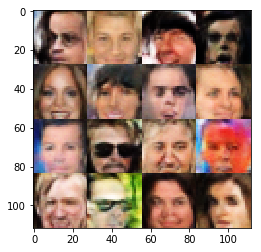

Epoch 14/25... Discriminator Loss: 0.1433... Generator Loss: 2.4936
Epoch 14/25... Discriminator Loss: 0.3363... Generator Loss: 1.6681
Epoch 14/25... Discriminator Loss: 0.5930... Generator Loss: 1.2275
Epoch 14/25... Discriminator Loss: 0.4390... Generator Loss: 1.4518
Epoch 14/25... Discriminator Loss: 0.1506... Generator Loss: 2.5242
Epoch 14/25... Discriminator Loss: 0.1671... Generator Loss: 2.4744
Epoch 14/25... Discriminator Loss: 0.1817... Generator Loss: 2.2541
Epoch 14/25... Discriminator Loss: 0.4252... Generator Loss: 1.4086
Epoch 14/25... Discriminator Loss: 0.3075... Generator Loss: 1.6962
Epoch 14/25... Discriminator Loss: 0.4367... Generator Loss: 1.4197


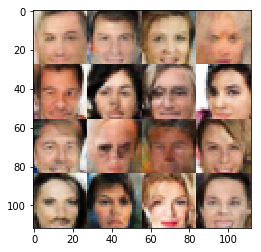

Epoch 14/25... Discriminator Loss: 2.0938... Generator Loss: 0.2274
Epoch 14/25... Discriminator Loss: 1.3556... Generator Loss: 0.8506
Epoch 14/25... Discriminator Loss: 1.2241... Generator Loss: 1.6981
Epoch 14/25... Discriminator Loss: 1.0778... Generator Loss: 0.8117
Epoch 14/25... Discriminator Loss: 1.0136... Generator Loss: 0.7821
Epoch 14/25... Discriminator Loss: 1.1593... Generator Loss: 2.2606
Epoch 14/25... Discriminator Loss: 0.4396... Generator Loss: 2.0078
Epoch 14/25... Discriminator Loss: 1.2496... Generator Loss: 0.5293
Epoch 14/25... Discriminator Loss: 0.9421... Generator Loss: 0.7680
Epoch 14/25... Discriminator Loss: 1.3913... Generator Loss: 0.7324


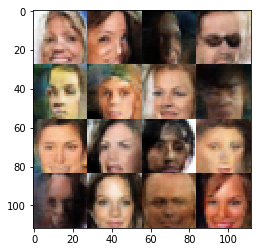

Epoch 14/25... Discriminator Loss: 1.0561... Generator Loss: 0.8042
Epoch 14/25... Discriminator Loss: 1.1208... Generator Loss: 1.3687
Epoch 14/25... Discriminator Loss: 0.6961... Generator Loss: 1.3470
Epoch 14/25... Discriminator Loss: 0.5503... Generator Loss: 1.6869
Epoch 14/25... Discriminator Loss: 0.3974... Generator Loss: 2.9309
Epoch 14/25... Discriminator Loss: 0.6550... Generator Loss: 1.0665
Epoch 14/25... Discriminator Loss: 0.6019... Generator Loss: 3.5822
Epoch 14/25... Discriminator Loss: 0.3106... Generator Loss: 1.9611
Epoch 14/25... Discriminator Loss: 0.2910... Generator Loss: 1.9363
Epoch 14/25... Discriminator Loss: 0.1298... Generator Loss: 2.8522


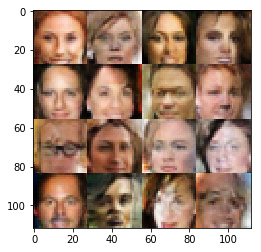

Epoch 14/25... Discriminator Loss: 0.8007... Generator Loss: 0.9239
Epoch 14/25... Discriminator Loss: 0.2443... Generator Loss: 2.1860
Epoch 14/25... Discriminator Loss: 0.5766... Generator Loss: 1.1504
Epoch 14/25... Discriminator Loss: 1.0944... Generator Loss: 0.6659
Epoch 14/25... Discriminator Loss: 0.3934... Generator Loss: 2.0677
Epoch 14/25... Discriminator Loss: 0.3151... Generator Loss: 2.3308
Epoch 14/25... Discriminator Loss: 1.9443... Generator Loss: 6.4407
Epoch 14/25... Discriminator Loss: 2.1733... Generator Loss: 5.8896
Epoch 14/25... Discriminator Loss: 0.5971... Generator Loss: 1.5169
Epoch 14/25... Discriminator Loss: 0.3757... Generator Loss: 1.8127


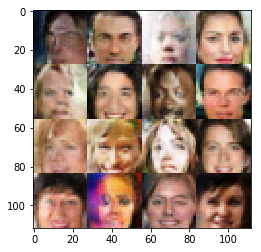

Epoch 14/25... Discriminator Loss: 0.3764... Generator Loss: 2.1446
Epoch 14/25... Discriminator Loss: 0.6386... Generator Loss: 1.1675
Epoch 14/25... Discriminator Loss: 0.1430... Generator Loss: 3.0755
Epoch 14/25... Discriminator Loss: 0.4729... Generator Loss: 1.4442
Epoch 14/25... Discriminator Loss: 0.9204... Generator Loss: 0.7367
Epoch 14/25... Discriminator Loss: 0.4896... Generator Loss: 1.3794
Epoch 14/25... Discriminator Loss: 0.5248... Generator Loss: 1.2573
Epoch 14/25... Discriminator Loss: 0.1358... Generator Loss: 2.7546
Epoch 14/25... Discriminator Loss: 0.4276... Generator Loss: 1.5544
Epoch 14/25... Discriminator Loss: 0.4181... Generator Loss: 1.5115


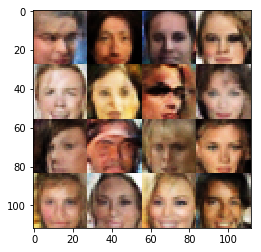

Epoch 14/25... Discriminator Loss: 0.3704... Generator Loss: 1.6035
Epoch 14/25... Discriminator Loss: 0.2549... Generator Loss: 1.8975
Epoch 14/25... Discriminator Loss: 0.4400... Generator Loss: 1.4777
Epoch 14/25... Discriminator Loss: 0.3592... Generator Loss: 1.6134
Epoch 14/25... Discriminator Loss: 0.6153... Generator Loss: 1.1418
Epoch 14/25... Discriminator Loss: 0.3344... Generator Loss: 1.7288
Epoch 14/25... Discriminator Loss: 0.0879... Generator Loss: 3.5581
Epoch 14/25... Discriminator Loss: 1.0266... Generator Loss: 0.6495
Epoch 14/25... Discriminator Loss: 0.2282... Generator Loss: 2.0734
Epoch 14/25... Discriminator Loss: 0.0645... Generator Loss: 3.6889


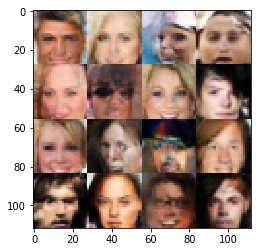

Epoch 14/25... Discriminator Loss: 0.1160... Generator Loss: 2.8401
Epoch 14/25... Discriminator Loss: 0.1746... Generator Loss: 2.3589
Epoch 14/25... Discriminator Loss: 0.4181... Generator Loss: 1.3940
Epoch 14/25... Discriminator Loss: 0.1040... Generator Loss: 3.5093
Epoch 14/25... Discriminator Loss: 0.2132... Generator Loss: 2.1515
Epoch 14/25... Discriminator Loss: 0.2678... Generator Loss: 1.9323
Epoch 14/25... Discriminator Loss: 0.1126... Generator Loss: 2.8692
Epoch 14/25... Discriminator Loss: 0.1901... Generator Loss: 2.3041
Epoch 14/25... Discriminator Loss: 0.0729... Generator Loss: 3.6259
Epoch 14/25... Discriminator Loss: 0.7063... Generator Loss: 0.9702


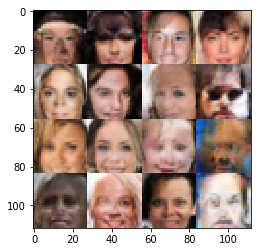

Epoch 14/25... Discriminator Loss: 1.0089... Generator Loss: 1.1843
Epoch 14/25... Discriminator Loss: 0.5807... Generator Loss: 2.0704
Epoch 14/25... Discriminator Loss: 0.4043... Generator Loss: 2.6584
Epoch 14/25... Discriminator Loss: 0.6923... Generator Loss: 0.9888
Epoch 14/25... Discriminator Loss: 0.5805... Generator Loss: 1.1974
Epoch 14/25... Discriminator Loss: 0.6944... Generator Loss: 1.0457
Epoch 14/25... Discriminator Loss: 0.3024... Generator Loss: 2.9563
Epoch 14/25... Discriminator Loss: 0.5926... Generator Loss: 2.0710
Epoch 14/25... Discriminator Loss: 0.3975... Generator Loss: 3.5340
Epoch 14/25... Discriminator Loss: 0.5243... Generator Loss: 1.2256


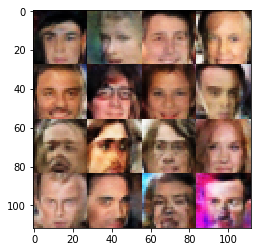

Epoch 14/25... Discriminator Loss: 0.4912... Generator Loss: 1.5285
Epoch 14/25... Discriminator Loss: 0.7372... Generator Loss: 0.9031
Epoch 14/25... Discriminator Loss: 0.3339... Generator Loss: 1.6933
Epoch 14/25... Discriminator Loss: 0.6480... Generator Loss: 1.1101
Epoch 14/25... Discriminator Loss: 0.3750... Generator Loss: 1.6615
Epoch 14/25... Discriminator Loss: 0.3231... Generator Loss: 1.7767
Epoch 14/25... Discriminator Loss: 0.0911... Generator Loss: 3.3050
Epoch 14/25... Discriminator Loss: 0.1500... Generator Loss: 3.0487
Epoch 14/25... Discriminator Loss: 0.2841... Generator Loss: 1.7929
Epoch 14/25... Discriminator Loss: 0.3655... Generator Loss: 1.6834


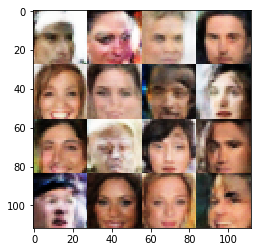

Epoch 14/25... Discriminator Loss: 0.2113... Generator Loss: 2.0629
Epoch 14/25... Discriminator Loss: 0.3270... Generator Loss: 1.8321
Epoch 14/25... Discriminator Loss: 0.1304... Generator Loss: 2.7280
Epoch 14/25... Discriminator Loss: 0.6289... Generator Loss: 1.1225
Epoch 14/25... Discriminator Loss: 1.4306... Generator Loss: 6.6817
Epoch 14/25... Discriminator Loss: 0.7659... Generator Loss: 1.8504
Epoch 14/25... Discriminator Loss: 0.6185... Generator Loss: 1.2884
Epoch 14/25... Discriminator Loss: 0.6980... Generator Loss: 1.7777
Epoch 14/25... Discriminator Loss: 0.3693... Generator Loss: 2.0862
Epoch 14/25... Discriminator Loss: 0.4413... Generator Loss: 1.5040


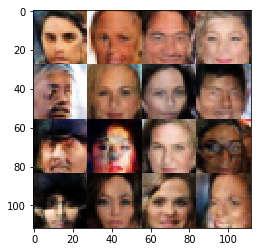

Epoch 14/25... Discriminator Loss: 0.3907... Generator Loss: 1.7352
Epoch 14/25... Discriminator Loss: 0.4271... Generator Loss: 1.7266
Epoch 14/25... Discriminator Loss: 0.3211... Generator Loss: 1.8677
Epoch 14/25... Discriminator Loss: 0.6488... Generator Loss: 1.1382
Epoch 14/25... Discriminator Loss: 0.1451... Generator Loss: 2.7980
Epoch 14/25... Discriminator Loss: 0.2349... Generator Loss: 2.1265
Epoch 14/25... Discriminator Loss: 0.3972... Generator Loss: 1.4599
Epoch 14/25... Discriminator Loss: 0.7333... Generator Loss: 0.9791
Epoch 14/25... Discriminator Loss: 0.1003... Generator Loss: 3.7203
Epoch 14/25... Discriminator Loss: 0.3164... Generator Loss: 1.7679


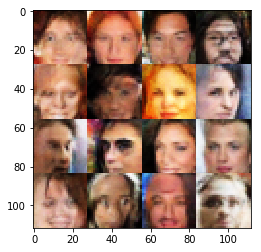

Epoch 14/25... Discriminator Loss: 0.2481... Generator Loss: 2.0764
Epoch 14/25... Discriminator Loss: 0.7363... Generator Loss: 0.9291
Epoch 14/25... Discriminator Loss: 0.4386... Generator Loss: 1.4154
Epoch 14/25... Discriminator Loss: 0.1739... Generator Loss: 2.4444
Epoch 14/25... Discriminator Loss: 0.3600... Generator Loss: 1.5888
Epoch 14/25... Discriminator Loss: 0.1240... Generator Loss: 2.8153
Epoch 14/25... Discriminator Loss: 0.3618... Generator Loss: 1.5761
Epoch 14/25... Discriminator Loss: 0.5693... Generator Loss: 1.2334
Epoch 14/25... Discriminator Loss: 0.1349... Generator Loss: 2.6532
Epoch 14/25... Discriminator Loss: 0.2759... Generator Loss: 1.7664


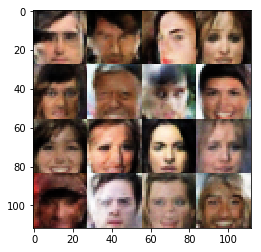

Epoch 14/25... Discriminator Loss: 0.1681... Generator Loss: 2.4512
Epoch 14/25... Discriminator Loss: 0.2211... Generator Loss: 2.0639
Epoch 14/25... Discriminator Loss: 0.1193... Generator Loss: 2.7368
Epoch 14/25... Discriminator Loss: 0.2013... Generator Loss: 2.2264
Epoch 15/25... Discriminator Loss: 0.1857... Generator Loss: 2.3939
Epoch 15/25... Discriminator Loss: 0.4241... Generator Loss: 1.4988
Epoch 15/25... Discriminator Loss: 0.2695... Generator Loss: 1.9340
Epoch 15/25... Discriminator Loss: 0.1827... Generator Loss: 2.2697
Epoch 15/25... Discriminator Loss: 0.2220... Generator Loss: 2.1775
Epoch 15/25... Discriminator Loss: 0.2315... Generator Loss: 2.1299


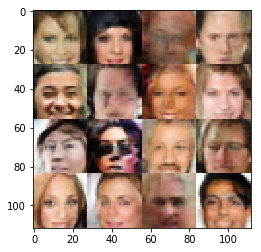

Epoch 15/25... Discriminator Loss: 0.2363... Generator Loss: 3.2360
Epoch 15/25... Discriminator Loss: 0.2457... Generator Loss: 2.0612
Epoch 15/25... Discriminator Loss: 0.3272... Generator Loss: 1.6401
Epoch 15/25... Discriminator Loss: 0.1769... Generator Loss: 2.3964
Epoch 15/25... Discriminator Loss: 0.3935... Generator Loss: 1.4828
Epoch 15/25... Discriminator Loss: 0.1111... Generator Loss: 3.2649
Epoch 15/25... Discriminator Loss: 1.5039... Generator Loss: 0.6114
Epoch 15/25... Discriminator Loss: 1.4264... Generator Loss: 0.5569
Epoch 15/25... Discriminator Loss: 1.0771... Generator Loss: 0.8199
Epoch 15/25... Discriminator Loss: 1.0423... Generator Loss: 1.2038


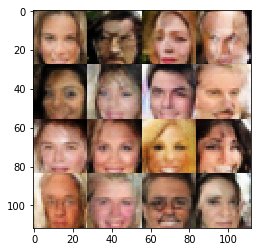

Epoch 15/25... Discriminator Loss: 0.9402... Generator Loss: 1.8301
Epoch 15/25... Discriminator Loss: 0.7415... Generator Loss: 1.6547
Epoch 15/25... Discriminator Loss: 0.8364... Generator Loss: 2.1888
Epoch 15/25... Discriminator Loss: 0.3880... Generator Loss: 1.7099
Epoch 15/25... Discriminator Loss: 0.3070... Generator Loss: 2.1656
Epoch 15/25... Discriminator Loss: 0.4326... Generator Loss: 1.5235
Epoch 15/25... Discriminator Loss: 0.3112... Generator Loss: 2.0206
Epoch 15/25... Discriminator Loss: 1.4827... Generator Loss: 0.4887
Epoch 15/25... Discriminator Loss: 0.9638... Generator Loss: 2.0620
Epoch 15/25... Discriminator Loss: 0.5601... Generator Loss: 1.9868


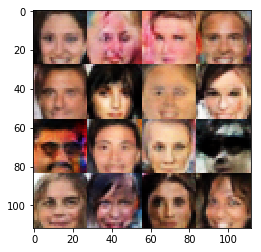

Epoch 15/25... Discriminator Loss: 0.6563... Generator Loss: 2.1512
Epoch 15/25... Discriminator Loss: 0.5985... Generator Loss: 1.5911
Epoch 15/25... Discriminator Loss: 0.4238... Generator Loss: 2.1663
Epoch 15/25... Discriminator Loss: 0.3641... Generator Loss: 2.0630
Epoch 15/25... Discriminator Loss: 0.7085... Generator Loss: 1.0518
Epoch 15/25... Discriminator Loss: 0.5245... Generator Loss: 1.3580
Epoch 15/25... Discriminator Loss: 0.4585... Generator Loss: 1.3401
Epoch 15/25... Discriminator Loss: 0.3478... Generator Loss: 3.8527
Epoch 15/25... Discriminator Loss: 0.2877... Generator Loss: 1.7851
Epoch 15/25... Discriminator Loss: 0.3236... Generator Loss: 2.3748


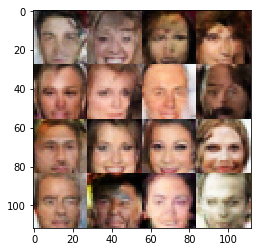

Epoch 15/25... Discriminator Loss: 0.3242... Generator Loss: 1.7683
Epoch 15/25... Discriminator Loss: 0.4495... Generator Loss: 1.4665
Epoch 15/25... Discriminator Loss: 0.2475... Generator Loss: 2.0116
Epoch 15/25... Discriminator Loss: 0.4447... Generator Loss: 1.4058
Epoch 15/25... Discriminator Loss: 0.4156... Generator Loss: 1.4704
Epoch 15/25... Discriminator Loss: 0.2338... Generator Loss: 2.2319
Epoch 15/25... Discriminator Loss: 0.1948... Generator Loss: 2.3255
Epoch 15/25... Discriminator Loss: 0.5292... Generator Loss: 1.2629
Epoch 15/25... Discriminator Loss: 0.1499... Generator Loss: 2.6701
Epoch 15/25... Discriminator Loss: 0.1625... Generator Loss: 2.4587


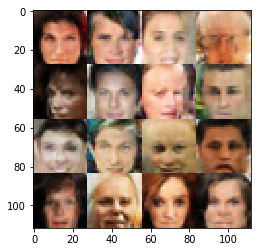

Epoch 15/25... Discriminator Loss: 0.3685... Generator Loss: 1.6482
Epoch 15/25... Discriminator Loss: 0.2245... Generator Loss: 2.0097
Epoch 15/25... Discriminator Loss: 0.1212... Generator Loss: 2.8900
Epoch 15/25... Discriminator Loss: 0.6591... Generator Loss: 1.0035
Epoch 15/25... Discriminator Loss: 0.3338... Generator Loss: 1.6963
Epoch 15/25... Discriminator Loss: 0.5513... Generator Loss: 1.2062
Epoch 15/25... Discriminator Loss: 0.4767... Generator Loss: 1.2805
Epoch 15/25... Discriminator Loss: 0.1970... Generator Loss: 2.3425
Epoch 15/25... Discriminator Loss: 0.4513... Generator Loss: 1.3918
Epoch 15/25... Discriminator Loss: 0.6540... Generator Loss: 1.1363


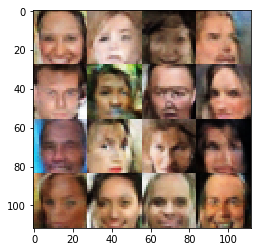

Epoch 15/25... Discriminator Loss: 0.3509... Generator Loss: 1.5708
Epoch 15/25... Discriminator Loss: 0.9393... Generator Loss: 0.7080
Epoch 15/25... Discriminator Loss: 0.2154... Generator Loss: 2.0439
Epoch 15/25... Discriminator Loss: 0.5379... Generator Loss: 1.2267
Epoch 15/25... Discriminator Loss: 0.3463... Generator Loss: 1.6611
Epoch 15/25... Discriminator Loss: 0.0845... Generator Loss: 3.1693
Epoch 15/25... Discriminator Loss: 0.1610... Generator Loss: 2.4852
Epoch 15/25... Discriminator Loss: 0.2336... Generator Loss: 2.0002
Epoch 15/25... Discriminator Loss: 0.1567... Generator Loss: 2.5729
Epoch 15/25... Discriminator Loss: 0.1828... Generator Loss: 2.2936


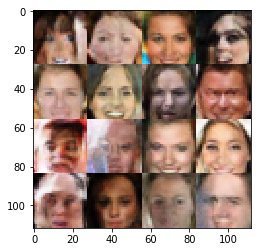

Epoch 15/25... Discriminator Loss: 0.2681... Generator Loss: 1.8896
Epoch 15/25... Discriminator Loss: 0.1194... Generator Loss: 2.9426
Epoch 15/25... Discriminator Loss: 2.7490... Generator Loss: 3.7398
Epoch 15/25... Discriminator Loss: 1.5107... Generator Loss: 2.4092
Epoch 15/25... Discriminator Loss: 0.9536... Generator Loss: 2.5752
Epoch 15/25... Discriminator Loss: 0.8038... Generator Loss: 1.4918
Epoch 15/25... Discriminator Loss: 0.9619... Generator Loss: 3.8359
Epoch 15/25... Discriminator Loss: 0.3487... Generator Loss: 1.9091
Epoch 15/25... Discriminator Loss: 0.5664... Generator Loss: 1.7679
Epoch 15/25... Discriminator Loss: 0.5200... Generator Loss: 1.4061


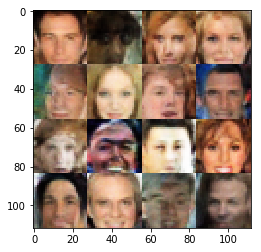

Epoch 15/25... Discriminator Loss: 0.7230... Generator Loss: 1.0103
Epoch 15/25... Discriminator Loss: 0.4330... Generator Loss: 1.5960
Epoch 15/25... Discriminator Loss: 0.4148... Generator Loss: 3.4999
Epoch 15/25... Discriminator Loss: 0.2586... Generator Loss: 2.5348
Epoch 15/25... Discriminator Loss: 0.6397... Generator Loss: 4.9255
Epoch 15/25... Discriminator Loss: 0.7850... Generator Loss: 0.9321
Epoch 15/25... Discriminator Loss: 5.5249... Generator Loss: 0.0748
Epoch 15/25... Discriminator Loss: 1.0662... Generator Loss: 0.7307
Epoch 15/25... Discriminator Loss: 0.8899... Generator Loss: 1.0366
Epoch 15/25... Discriminator Loss: 0.8394... Generator Loss: 0.9744


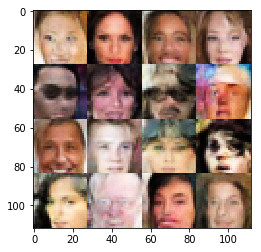

Epoch 15/25... Discriminator Loss: 0.5184... Generator Loss: 2.9492
Epoch 15/25... Discriminator Loss: 0.5642... Generator Loss: 1.3524
Epoch 15/25... Discriminator Loss: 0.5204... Generator Loss: 1.4670
Epoch 15/25... Discriminator Loss: 0.4682... Generator Loss: 1.5376
Epoch 15/25... Discriminator Loss: 0.3824... Generator Loss: 1.5840
Epoch 15/25... Discriminator Loss: 0.3632... Generator Loss: 1.6126
Epoch 15/25... Discriminator Loss: 0.3513... Generator Loss: 1.6942
Epoch 15/25... Discriminator Loss: 0.0840... Generator Loss: 3.1782
Epoch 15/25... Discriminator Loss: 0.1102... Generator Loss: 2.9258
Epoch 15/25... Discriminator Loss: 0.1116... Generator Loss: 2.8700


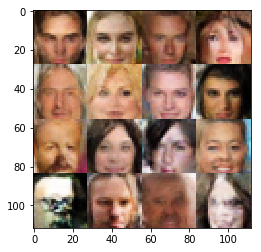

Epoch 15/25... Discriminator Loss: 0.2522... Generator Loss: 2.0145
Epoch 15/25... Discriminator Loss: 1.0470... Generator Loss: 0.6847
Epoch 15/25... Discriminator Loss: 0.6892... Generator Loss: 1.0143
Epoch 15/25... Discriminator Loss: 0.2693... Generator Loss: 1.8768
Epoch 15/25... Discriminator Loss: 0.1591... Generator Loss: 2.4160
Epoch 15/25... Discriminator Loss: 0.1211... Generator Loss: 2.8607
Epoch 15/25... Discriminator Loss: 0.4021... Generator Loss: 1.5684
Epoch 15/25... Discriminator Loss: 0.1381... Generator Loss: 2.5371
Epoch 15/25... Discriminator Loss: 0.2709... Generator Loss: 1.9022
Epoch 15/25... Discriminator Loss: 0.3066... Generator Loss: 1.7392


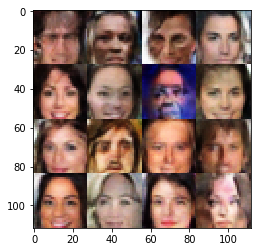

Epoch 15/25... Discriminator Loss: 0.2972... Generator Loss: 1.7132
Epoch 15/25... Discriminator Loss: 0.8491... Generator Loss: 0.7924
Epoch 15/25... Discriminator Loss: 0.4930... Generator Loss: 1.2643
Epoch 15/25... Discriminator Loss: 0.1743... Generator Loss: 2.4235
Epoch 15/25... Discriminator Loss: 0.5446... Generator Loss: 1.1977
Epoch 15/25... Discriminator Loss: 0.2271... Generator Loss: 2.1371
Epoch 15/25... Discriminator Loss: 0.6559... Generator Loss: 1.0840
Epoch 15/25... Discriminator Loss: 0.2666... Generator Loss: 1.8255
Epoch 15/25... Discriminator Loss: 0.6282... Generator Loss: 1.0680
Epoch 15/25... Discriminator Loss: 0.3251... Generator Loss: 1.8176


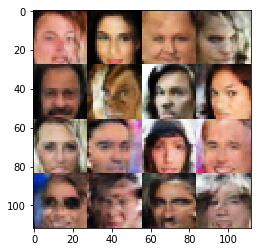

Epoch 15/25... Discriminator Loss: 0.1192... Generator Loss: 2.9117
Epoch 15/25... Discriminator Loss: 0.0714... Generator Loss: 3.5670
Epoch 15/25... Discriminator Loss: 0.3483... Generator Loss: 1.6372
Epoch 15/25... Discriminator Loss: 0.2135... Generator Loss: 2.1103
Epoch 15/25... Discriminator Loss: 0.1789... Generator Loss: 2.2811
Epoch 15/25... Discriminator Loss: 0.4102... Generator Loss: 1.4743
Epoch 15/25... Discriminator Loss: 0.3584... Generator Loss: 1.6358
Epoch 15/25... Discriminator Loss: 1.4821... Generator Loss: 0.9982
Epoch 15/25... Discriminator Loss: 1.4053... Generator Loss: 2.1405
Epoch 15/25... Discriminator Loss: 1.1506... Generator Loss: 0.5814


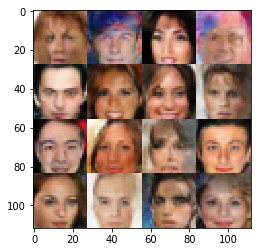

Epoch 15/25... Discriminator Loss: 1.0259... Generator Loss: 3.4306
Epoch 15/25... Discriminator Loss: 0.6097... Generator Loss: 2.4092
Epoch 15/25... Discriminator Loss: 0.5579... Generator Loss: 2.5676
Epoch 15/25... Discriminator Loss: 0.4883... Generator Loss: 1.8687
Epoch 15/25... Discriminator Loss: 0.3010... Generator Loss: 1.9926
Epoch 15/25... Discriminator Loss: 0.2521... Generator Loss: 3.0194
Epoch 15/25... Discriminator Loss: 0.8878... Generator Loss: 0.9277
Epoch 15/25... Discriminator Loss: 0.4073... Generator Loss: 1.7549
Epoch 15/25... Discriminator Loss: 0.3673... Generator Loss: 1.8687
Epoch 15/25... Discriminator Loss: 0.4995... Generator Loss: 1.6661


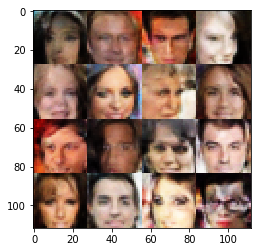

Epoch 15/25... Discriminator Loss: 1.4803... Generator Loss: 0.5567
Epoch 15/25... Discriminator Loss: 0.3699... Generator Loss: 1.7694
Epoch 15/25... Discriminator Loss: 1.5193... Generator Loss: 0.4941
Epoch 15/25... Discriminator Loss: 0.5645... Generator Loss: 3.3225
Epoch 15/25... Discriminator Loss: 0.3336... Generator Loss: 1.7564
Epoch 15/25... Discriminator Loss: 0.2414... Generator Loss: 2.0172
Epoch 15/25... Discriminator Loss: 0.2220... Generator Loss: 2.4885
Epoch 15/25... Discriminator Loss: 0.3198... Generator Loss: 2.1020
Epoch 15/25... Discriminator Loss: 0.3179... Generator Loss: 1.8131
Epoch 15/25... Discriminator Loss: 0.3140... Generator Loss: 1.9916


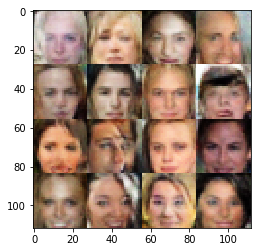

Epoch 15/25... Discriminator Loss: 0.2267... Generator Loss: 2.1189
Epoch 15/25... Discriminator Loss: 0.3491... Generator Loss: 1.6159
Epoch 15/25... Discriminator Loss: 0.3479... Generator Loss: 1.6479
Epoch 15/25... Discriminator Loss: 0.3488... Generator Loss: 1.7440
Epoch 15/25... Discriminator Loss: 0.5828... Generator Loss: 1.2630
Epoch 15/25... Discriminator Loss: 0.2252... Generator Loss: 2.1100
Epoch 15/25... Discriminator Loss: 0.1416... Generator Loss: 2.6337
Epoch 15/25... Discriminator Loss: 0.2240... Generator Loss: 2.1563
Epoch 15/25... Discriminator Loss: 0.4635... Generator Loss: 1.3412
Epoch 15/25... Discriminator Loss: 0.2326... Generator Loss: 2.0287


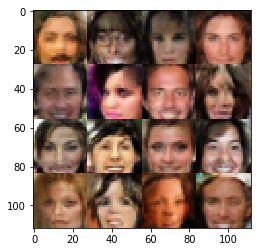

Epoch 15/25... Discriminator Loss: 0.2568... Generator Loss: 1.9211
Epoch 15/25... Discriminator Loss: 1.8170... Generator Loss: 0.5061
Epoch 15/25... Discriminator Loss: 0.8044... Generator Loss: 1.4333
Epoch 16/25... Discriminator Loss: 0.9695... Generator Loss: 0.8096
Epoch 16/25... Discriminator Loss: 0.5369... Generator Loss: 1.8480
Epoch 16/25... Discriminator Loss: 0.3713... Generator Loss: 1.7756
Epoch 16/25... Discriminator Loss: 0.3815... Generator Loss: 1.7626
Epoch 16/25... Discriminator Loss: 0.5114... Generator Loss: 1.4164
Epoch 16/25... Discriminator Loss: 0.5118... Generator Loss: 1.2407
Epoch 16/25... Discriminator Loss: 0.3820... Generator Loss: 1.6197


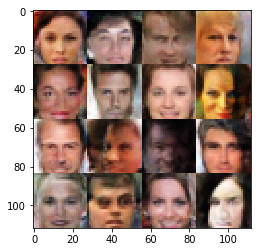

Epoch 16/25... Discriminator Loss: 0.4458... Generator Loss: 1.4726
Epoch 16/25... Discriminator Loss: 0.1723... Generator Loss: 2.9888
Epoch 16/25... Discriminator Loss: 0.5158... Generator Loss: 1.3622
Epoch 16/25... Discriminator Loss: 1.0223... Generator Loss: 0.7195
Epoch 16/25... Discriminator Loss: 0.8912... Generator Loss: 1.9383
Epoch 16/25... Discriminator Loss: 0.5805... Generator Loss: 1.4313
Epoch 16/25... Discriminator Loss: 0.3889... Generator Loss: 1.8544
Epoch 16/25... Discriminator Loss: 0.3827... Generator Loss: 1.6249
Epoch 16/25... Discriminator Loss: 0.2976... Generator Loss: 2.0861
Epoch 16/25... Discriminator Loss: 0.4122... Generator Loss: 1.6129


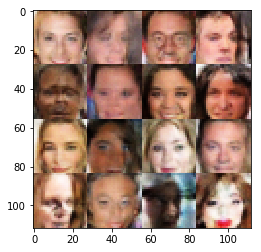

Epoch 16/25... Discriminator Loss: 0.4149... Generator Loss: 1.5783
Epoch 16/25... Discriminator Loss: 0.1285... Generator Loss: 2.8805
Epoch 16/25... Discriminator Loss: 0.7519... Generator Loss: 0.9359
Epoch 16/25... Discriminator Loss: 0.2304... Generator Loss: 2.1448
Epoch 16/25... Discriminator Loss: 0.3702... Generator Loss: 1.7123
Epoch 16/25... Discriminator Loss: 0.1971... Generator Loss: 2.2741
Epoch 16/25... Discriminator Loss: 0.1543... Generator Loss: 3.4320
Epoch 16/25... Discriminator Loss: 0.1798... Generator Loss: 2.4749
Epoch 16/25... Discriminator Loss: 1.2457... Generator Loss: 0.5595
Epoch 16/25... Discriminator Loss: 0.1315... Generator Loss: 2.7647


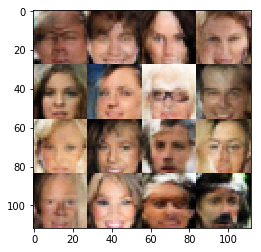

Epoch 16/25... Discriminator Loss: 0.2532... Generator Loss: 2.0017
Epoch 16/25... Discriminator Loss: 0.0898... Generator Loss: 3.2830
Epoch 16/25... Discriminator Loss: 0.6478... Generator Loss: 1.0021
Epoch 16/25... Discriminator Loss: 0.3731... Generator Loss: 1.5897
Epoch 16/25... Discriminator Loss: 0.1132... Generator Loss: 3.0280
Epoch 16/25... Discriminator Loss: 0.4257... Generator Loss: 1.5243
Epoch 16/25... Discriminator Loss: 0.2837... Generator Loss: 2.0235
Epoch 16/25... Discriminator Loss: 0.1233... Generator Loss: 2.9226
Epoch 16/25... Discriminator Loss: 0.3663... Generator Loss: 1.7000
Epoch 16/25... Discriminator Loss: 0.1932... Generator Loss: 2.2558


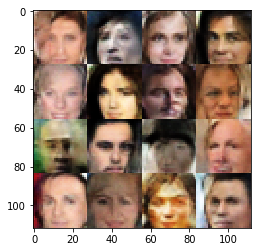

Epoch 16/25... Discriminator Loss: 0.0426... Generator Loss: 4.0469
Epoch 16/25... Discriminator Loss: 0.4247... Generator Loss: 1.4412
Epoch 16/25... Discriminator Loss: 0.4028... Generator Loss: 1.5343
Epoch 16/25... Discriminator Loss: 0.0618... Generator Loss: 3.8713
Epoch 16/25... Discriminator Loss: 0.3365... Generator Loss: 1.6627
Epoch 16/25... Discriminator Loss: 0.2204... Generator Loss: 2.2001
Epoch 16/25... Discriminator Loss: 0.2400... Generator Loss: 2.0667
Epoch 16/25... Discriminator Loss: 0.2781... Generator Loss: 1.9347
Epoch 16/25... Discriminator Loss: 0.1046... Generator Loss: 2.8493
Epoch 16/25... Discriminator Loss: 0.2438... Generator Loss: 2.1067


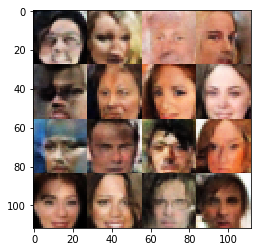

Epoch 16/25... Discriminator Loss: 0.1967... Generator Loss: 2.1399
Epoch 16/25... Discriminator Loss: 0.3302... Generator Loss: 1.6568
Epoch 16/25... Discriminator Loss: 0.0865... Generator Loss: 3.0653
Epoch 16/25... Discriminator Loss: 0.1465... Generator Loss: 2.6998
Epoch 16/25... Discriminator Loss: 0.2233... Generator Loss: 2.0460
Epoch 16/25... Discriminator Loss: 0.1080... Generator Loss: 3.0070
Epoch 16/25... Discriminator Loss: 0.2766... Generator Loss: 1.8647
Epoch 16/25... Discriminator Loss: 0.0380... Generator Loss: 4.3490
Epoch 16/25... Discriminator Loss: 0.3626... Generator Loss: 1.7403
Epoch 16/25... Discriminator Loss: 1.3192... Generator Loss: 0.5902


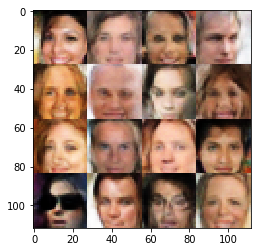

Epoch 16/25... Discriminator Loss: 0.1503... Generator Loss: 2.7252
Epoch 16/25... Discriminator Loss: 0.2042... Generator Loss: 2.1121
Epoch 16/25... Discriminator Loss: 0.1744... Generator Loss: 2.2808
Epoch 16/25... Discriminator Loss: 0.2375... Generator Loss: 2.0553
Epoch 16/25... Discriminator Loss: 0.2168... Generator Loss: 2.0037
Epoch 16/25... Discriminator Loss: 0.2596... Generator Loss: 1.8920
Epoch 16/25... Discriminator Loss: 0.3643... Generator Loss: 1.6344
Epoch 16/25... Discriminator Loss: 0.2297... Generator Loss: 2.0753
Epoch 16/25... Discriminator Loss: 0.2775... Generator Loss: 1.8638
Epoch 16/25... Discriminator Loss: 0.7311... Generator Loss: 0.9344


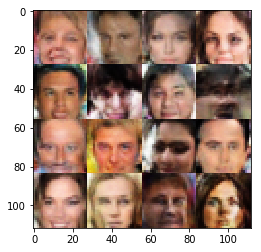

Epoch 16/25... Discriminator Loss: 0.0736... Generator Loss: 3.4005
Epoch 16/25... Discriminator Loss: 0.1582... Generator Loss: 2.4273
Epoch 16/25... Discriminator Loss: 0.4192... Generator Loss: 1.3911
Epoch 16/25... Discriminator Loss: 0.0432... Generator Loss: 4.1599
Epoch 16/25... Discriminator Loss: 0.0495... Generator Loss: 3.9080
Epoch 16/25... Discriminator Loss: 0.1005... Generator Loss: 3.1870
Epoch 16/25... Discriminator Loss: 0.0997... Generator Loss: 3.0788
Epoch 16/25... Discriminator Loss: 0.2506... Generator Loss: 2.0469
Epoch 16/25... Discriminator Loss: 0.1387... Generator Loss: 2.5416
Epoch 16/25... Discriminator Loss: 0.1976... Generator Loss: 2.2005


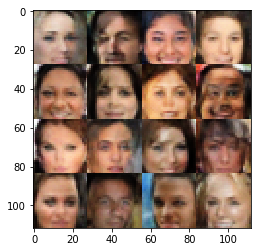

Epoch 16/25... Discriminator Loss: 0.1713... Generator Loss: 2.3241
Epoch 16/25... Discriminator Loss: 0.1420... Generator Loss: 2.4635
Epoch 16/25... Discriminator Loss: 0.6306... Generator Loss: 1.1621
Epoch 16/25... Discriminator Loss: 2.6698... Generator Loss: 3.3043
Epoch 16/25... Discriminator Loss: 1.4362... Generator Loss: 1.6520
Epoch 16/25... Discriminator Loss: 0.9281... Generator Loss: 1.1033
Epoch 16/25... Discriminator Loss: 1.0437... Generator Loss: 1.3683
Epoch 16/25... Discriminator Loss: 1.0043... Generator Loss: 2.0159
Epoch 16/25... Discriminator Loss: 0.8080... Generator Loss: 2.3331
Epoch 16/25... Discriminator Loss: 2.0788... Generator Loss: 0.2540


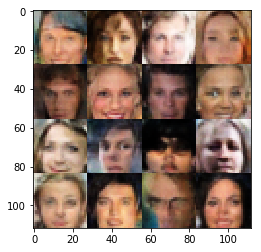

Epoch 16/25... Discriminator Loss: 0.3751... Generator Loss: 1.7810
Epoch 16/25... Discriminator Loss: 0.7169... Generator Loss: 4.9624
Epoch 16/25... Discriminator Loss: 0.4074... Generator Loss: 2.6112
Epoch 16/25... Discriminator Loss: 1.1342... Generator Loss: 0.6000
Epoch 16/25... Discriminator Loss: 0.3671... Generator Loss: 1.8999
Epoch 16/25... Discriminator Loss: 0.9066... Generator Loss: 0.9069
Epoch 16/25... Discriminator Loss: 0.2275... Generator Loss: 2.8486
Epoch 16/25... Discriminator Loss: 0.3149... Generator Loss: 2.0179
Epoch 16/25... Discriminator Loss: 0.3751... Generator Loss: 1.7020
Epoch 16/25... Discriminator Loss: 0.3033... Generator Loss: 1.9639


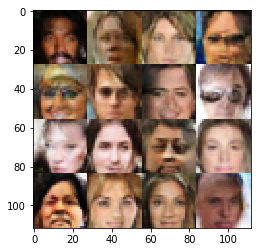

Epoch 16/25... Discriminator Loss: 0.3717... Generator Loss: 1.6562
Epoch 16/25... Discriminator Loss: 0.7761... Generator Loss: 1.0024
Epoch 16/25... Discriminator Loss: 1.1824... Generator Loss: 0.8677
Epoch 16/25... Discriminator Loss: 1.5897... Generator Loss: 1.7071
Epoch 16/25... Discriminator Loss: 1.3838... Generator Loss: 0.5139
Epoch 16/25... Discriminator Loss: 1.2343... Generator Loss: 0.6718
Epoch 16/25... Discriminator Loss: 1.1090... Generator Loss: 1.3531
Epoch 16/25... Discriminator Loss: 0.8953... Generator Loss: 0.9998
Epoch 16/25... Discriminator Loss: 0.9379... Generator Loss: 1.4828
Epoch 16/25... Discriminator Loss: 0.9744... Generator Loss: 1.0735


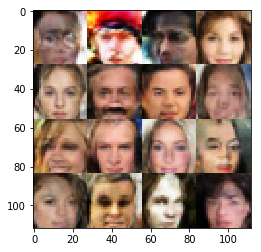

Epoch 16/25... Discriminator Loss: 0.7693... Generator Loss: 2.2687
Epoch 16/25... Discriminator Loss: 0.4371... Generator Loss: 1.9703
Epoch 16/25... Discriminator Loss: 0.6714... Generator Loss: 1.1312
Epoch 16/25... Discriminator Loss: 0.3195... Generator Loss: 2.2953
Epoch 16/25... Discriminator Loss: 1.0260... Generator Loss: 0.7826
Epoch 16/25... Discriminator Loss: 0.2953... Generator Loss: 2.7310
Epoch 16/25... Discriminator Loss: 0.4225... Generator Loss: 1.6575
Epoch 16/25... Discriminator Loss: 0.6055... Generator Loss: 1.3061
Epoch 16/25... Discriminator Loss: 0.5858... Generator Loss: 2.9094
Epoch 16/25... Discriminator Loss: 0.3807... Generator Loss: 1.7887


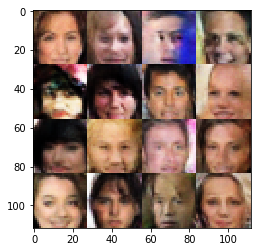

Epoch 16/25... Discriminator Loss: 1.1576... Generator Loss: 0.6175
Epoch 16/25... Discriminator Loss: 0.5392... Generator Loss: 1.2630
Epoch 16/25... Discriminator Loss: 0.4924... Generator Loss: 1.2599
Epoch 16/25... Discriminator Loss: 0.5700... Generator Loss: 1.2035
Epoch 16/25... Discriminator Loss: 0.3877... Generator Loss: 1.5132
Epoch 16/25... Discriminator Loss: 0.4346... Generator Loss: 1.5201
Epoch 16/25... Discriminator Loss: 0.4267... Generator Loss: 1.4557
Epoch 16/25... Discriminator Loss: 0.1557... Generator Loss: 2.7022
Epoch 16/25... Discriminator Loss: 0.2907... Generator Loss: 1.8155
Epoch 16/25... Discriminator Loss: 0.7422... Generator Loss: 0.9432


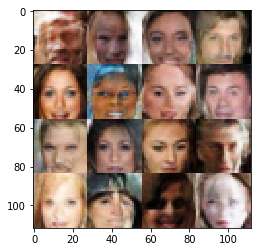

Epoch 16/25... Discriminator Loss: 2.2397... Generator Loss: 0.2136
Epoch 16/25... Discriminator Loss: 0.8613... Generator Loss: 0.9263
Epoch 16/25... Discriminator Loss: 0.3606... Generator Loss: 1.8008
Epoch 16/25... Discriminator Loss: 0.6622... Generator Loss: 1.0723
Epoch 16/25... Discriminator Loss: 0.2569... Generator Loss: 2.3279
Epoch 16/25... Discriminator Loss: 0.8131... Generator Loss: 0.8176
Epoch 16/25... Discriminator Loss: 0.1649... Generator Loss: 2.4926
Epoch 16/25... Discriminator Loss: 0.8601... Generator Loss: 0.7691
Epoch 16/25... Discriminator Loss: 0.2548... Generator Loss: 2.0845
Epoch 16/25... Discriminator Loss: 0.3217... Generator Loss: 2.0965


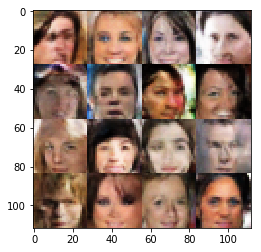

Epoch 16/25... Discriminator Loss: 0.2336... Generator Loss: 2.2330
Epoch 16/25... Discriminator Loss: 0.2140... Generator Loss: 2.2217
Epoch 16/25... Discriminator Loss: 0.2578... Generator Loss: 2.0861
Epoch 16/25... Discriminator Loss: 0.3669... Generator Loss: 1.6788
Epoch 16/25... Discriminator Loss: 0.1671... Generator Loss: 2.4077
Epoch 16/25... Discriminator Loss: 0.6061... Generator Loss: 2.1247
Epoch 16/25... Discriminator Loss: 0.2104... Generator Loss: 3.3561
Epoch 16/25... Discriminator Loss: 0.4893... Generator Loss: 1.4824
Epoch 16/25... Discriminator Loss: 0.4973... Generator Loss: 1.4892
Epoch 16/25... Discriminator Loss: 0.2851... Generator Loss: 2.1865


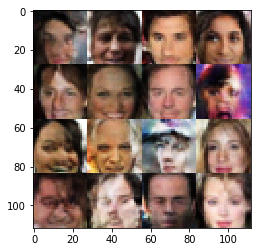

Epoch 16/25... Discriminator Loss: 0.2442... Generator Loss: 2.4959
Epoch 16/25... Discriminator Loss: 0.3653... Generator Loss: 1.7526
Epoch 16/25... Discriminator Loss: 0.3263... Generator Loss: 1.8431
Epoch 16/25... Discriminator Loss: 0.4419... Generator Loss: 1.4205
Epoch 16/25... Discriminator Loss: 0.3173... Generator Loss: 1.7760
Epoch 16/25... Discriminator Loss: 0.1583... Generator Loss: 2.3884
Epoch 16/25... Discriminator Loss: 0.1442... Generator Loss: 2.7079
Epoch 16/25... Discriminator Loss: 0.7078... Generator Loss: 0.9932
Epoch 16/25... Discriminator Loss: 0.1773... Generator Loss: 2.5954
Epoch 16/25... Discriminator Loss: 0.2894... Generator Loss: 1.8857


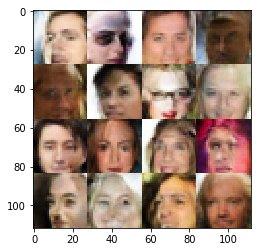

Epoch 16/25... Discriminator Loss: 0.4595... Generator Loss: 1.4911
Epoch 17/25... Discriminator Loss: 0.4708... Generator Loss: 1.3931
Epoch 17/25... Discriminator Loss: 0.1859... Generator Loss: 2.3973
Epoch 17/25... Discriminator Loss: 0.3214... Generator Loss: 1.7853
Epoch 17/25... Discriminator Loss: 0.5189... Generator Loss: 1.2383
Epoch 17/25... Discriminator Loss: 0.3218... Generator Loss: 1.6492
Epoch 17/25... Discriminator Loss: 0.4233... Generator Loss: 1.5022
Epoch 17/25... Discriminator Loss: 0.2492... Generator Loss: 1.9051
Epoch 17/25... Discriminator Loss: 0.1883... Generator Loss: 2.3165
Epoch 17/25... Discriminator Loss: 0.4164... Generator Loss: 1.5289


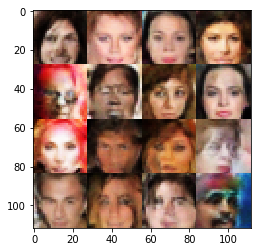

Epoch 17/25... Discriminator Loss: 0.6232... Generator Loss: 1.0805
Epoch 17/25... Discriminator Loss: 0.3403... Generator Loss: 1.7463
Epoch 17/25... Discriminator Loss: 1.4030... Generator Loss: 0.4720
Epoch 17/25... Discriminator Loss: 0.9890... Generator Loss: 5.9913
Epoch 17/25... Discriminator Loss: 1.0535... Generator Loss: 0.6722
Epoch 17/25... Discriminator Loss: 0.6221... Generator Loss: 1.1246
Epoch 17/25... Discriminator Loss: 0.1419... Generator Loss: 2.8351
Epoch 17/25... Discriminator Loss: 0.2395... Generator Loss: 3.6515
Epoch 17/25... Discriminator Loss: 0.2229... Generator Loss: 2.1147
Epoch 17/25... Discriminator Loss: 0.1715... Generator Loss: 2.7353


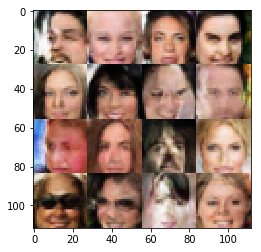

Epoch 17/25... Discriminator Loss: 0.3840... Generator Loss: 1.5266
Epoch 17/25... Discriminator Loss: 0.4886... Generator Loss: 1.2898
Epoch 17/25... Discriminator Loss: 0.5129... Generator Loss: 1.2624
Epoch 17/25... Discriminator Loss: 0.2001... Generator Loss: 2.2117
Epoch 17/25... Discriminator Loss: 0.2433... Generator Loss: 1.9615
Epoch 17/25... Discriminator Loss: 1.7914... Generator Loss: 2.3373
Epoch 17/25... Discriminator Loss: 1.0758... Generator Loss: 2.1002
Epoch 17/25... Discriminator Loss: 0.8372... Generator Loss: 0.9247
Epoch 17/25... Discriminator Loss: 0.6793... Generator Loss: 1.1693
Epoch 17/25... Discriminator Loss: 0.5482... Generator Loss: 1.5484


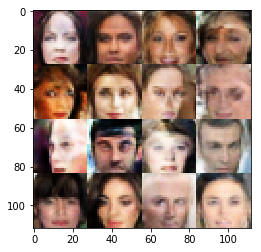

Epoch 17/25... Discriminator Loss: 0.7605... Generator Loss: 4.2432
Epoch 17/25... Discriminator Loss: 0.9214... Generator Loss: 4.5693
Epoch 17/25... Discriminator Loss: 0.3504... Generator Loss: 1.8148
Epoch 17/25... Discriminator Loss: 0.3350... Generator Loss: 1.7652
Epoch 17/25... Discriminator Loss: 0.4396... Generator Loss: 2.6097
Epoch 17/25... Discriminator Loss: 0.2989... Generator Loss: 2.0222
Epoch 17/25... Discriminator Loss: 0.3362... Generator Loss: 1.7482
Epoch 17/25... Discriminator Loss: 0.3991... Generator Loss: 1.7573
Epoch 17/25... Discriminator Loss: 0.1889... Generator Loss: 2.3404
Epoch 17/25... Discriminator Loss: 0.5806... Generator Loss: 1.1586


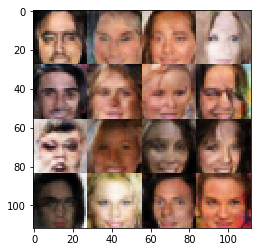

Epoch 17/25... Discriminator Loss: 0.2527... Generator Loss: 1.9786
Epoch 17/25... Discriminator Loss: 0.4088... Generator Loss: 1.5026
Epoch 17/25... Discriminator Loss: 0.1732... Generator Loss: 2.3084
Epoch 17/25... Discriminator Loss: 0.5712... Generator Loss: 1.1448
Epoch 17/25... Discriminator Loss: 0.2743... Generator Loss: 1.9438
Epoch 17/25... Discriminator Loss: 0.3119... Generator Loss: 1.7559
Epoch 17/25... Discriminator Loss: 0.2884... Generator Loss: 1.7851
Epoch 17/25... Discriminator Loss: 0.1614... Generator Loss: 2.5922
Epoch 17/25... Discriminator Loss: 0.2793... Generator Loss: 1.8187
Epoch 17/25... Discriminator Loss: 0.2506... Generator Loss: 1.9212


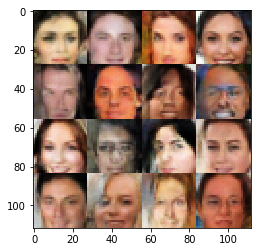

Epoch 17/25... Discriminator Loss: 0.5131... Generator Loss: 1.2770
Epoch 17/25... Discriminator Loss: 0.5670... Generator Loss: 1.1038
Epoch 17/25... Discriminator Loss: 0.1092... Generator Loss: 2.9539
Epoch 17/25... Discriminator Loss: 0.1139... Generator Loss: 2.8005
Epoch 17/25... Discriminator Loss: 0.0906... Generator Loss: 3.1496
Epoch 17/25... Discriminator Loss: 0.3311... Generator Loss: 1.7470
Epoch 17/25... Discriminator Loss: 0.1637... Generator Loss: 2.3962
Epoch 17/25... Discriminator Loss: 0.3306... Generator Loss: 1.5964
Epoch 17/25... Discriminator Loss: 0.3666... Generator Loss: 1.5775
Epoch 17/25... Discriminator Loss: 0.2356... Generator Loss: 2.0179


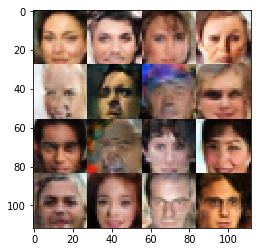

Epoch 17/25... Discriminator Loss: 0.1618... Generator Loss: 2.4546
Epoch 17/25... Discriminator Loss: 0.1794... Generator Loss: 2.4584
Epoch 17/25... Discriminator Loss: 0.0923... Generator Loss: 3.0556
Epoch 17/25... Discriminator Loss: 0.1220... Generator Loss: 2.7029
Epoch 17/25... Discriminator Loss: 0.3140... Generator Loss: 1.8077
Epoch 17/25... Discriminator Loss: 0.2387... Generator Loss: 2.0065
Epoch 17/25... Discriminator Loss: 0.2980... Generator Loss: 1.8463
Epoch 17/25... Discriminator Loss: 0.2487... Generator Loss: 1.9462
Epoch 17/25... Discriminator Loss: 0.1955... Generator Loss: 2.3081
Epoch 17/25... Discriminator Loss: 0.1630... Generator Loss: 2.5872


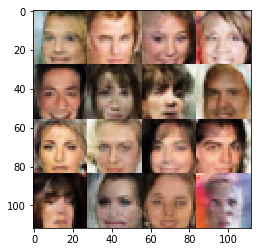

Epoch 17/25... Discriminator Loss: 0.1395... Generator Loss: 2.5617
Epoch 17/25... Discriminator Loss: 0.1860... Generator Loss: 2.2651
Epoch 17/25... Discriminator Loss: 0.1053... Generator Loss: 2.9992
Epoch 17/25... Discriminator Loss: 0.3909... Generator Loss: 1.6023
Epoch 17/25... Discriminator Loss: 0.1223... Generator Loss: 2.6759
Epoch 17/25... Discriminator Loss: 0.6410... Generator Loss: 1.0269
Epoch 17/25... Discriminator Loss: 0.2387... Generator Loss: 1.9999
Epoch 17/25... Discriminator Loss: 0.4199... Generator Loss: 1.4352
Epoch 17/25... Discriminator Loss: 0.3543... Generator Loss: 1.6429
Epoch 17/25... Discriminator Loss: 0.0785... Generator Loss: 3.2543


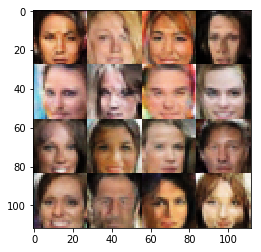

Epoch 17/25... Discriminator Loss: 0.1604... Generator Loss: 2.3781
Epoch 17/25... Discriminator Loss: 0.1017... Generator Loss: 3.1464
Epoch 17/25... Discriminator Loss: 0.5870... Generator Loss: 1.1886
Epoch 17/25... Discriminator Loss: 0.2211... Generator Loss: 2.0689
Epoch 17/25... Discriminator Loss: 0.3152... Generator Loss: 1.8360
Epoch 17/25... Discriminator Loss: 0.6548... Generator Loss: 1.1379
Epoch 17/25... Discriminator Loss: 0.4002... Generator Loss: 1.5713
Epoch 17/25... Discriminator Loss: 0.3641... Generator Loss: 1.6755
Epoch 17/25... Discriminator Loss: 2.8785... Generator Loss: 0.1427
Epoch 17/25... Discriminator Loss: 1.5891... Generator Loss: 1.1795


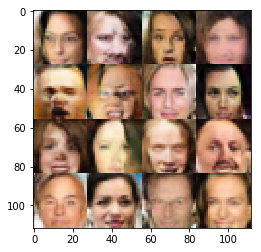

Epoch 17/25... Discriminator Loss: 1.3355... Generator Loss: 1.1154
Epoch 17/25... Discriminator Loss: 1.3814... Generator Loss: 0.5055
Epoch 17/25... Discriminator Loss: 1.0749... Generator Loss: 0.7867
Epoch 17/25... Discriminator Loss: 0.9152... Generator Loss: 1.1750
Epoch 17/25... Discriminator Loss: 0.8902... Generator Loss: 1.0780
Epoch 17/25... Discriminator Loss: 0.9377... Generator Loss: 0.9052
Epoch 17/25... Discriminator Loss: 0.4626... Generator Loss: 1.7931
Epoch 17/25... Discriminator Loss: 0.4885... Generator Loss: 2.3476
Epoch 17/25... Discriminator Loss: 0.3449... Generator Loss: 1.8087
Epoch 17/25... Discriminator Loss: 0.4144... Generator Loss: 2.9475


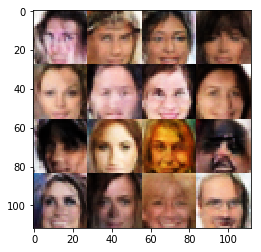

Epoch 17/25... Discriminator Loss: 0.4403... Generator Loss: 1.5212
Epoch 17/25... Discriminator Loss: 0.4422... Generator Loss: 1.6189
Epoch 17/25... Discriminator Loss: 0.3050... Generator Loss: 1.8906
Epoch 17/25... Discriminator Loss: 0.3243... Generator Loss: 2.1138
Epoch 17/25... Discriminator Loss: 0.4768... Generator Loss: 2.7172
Epoch 17/25... Discriminator Loss: 0.4066... Generator Loss: 2.1791
Epoch 17/25... Discriminator Loss: 0.4556... Generator Loss: 2.5040
Epoch 17/25... Discriminator Loss: 0.5940... Generator Loss: 1.3334
Epoch 17/25... Discriminator Loss: 0.6820... Generator Loss: 1.0986
Epoch 17/25... Discriminator Loss: 0.7793... Generator Loss: 0.9726


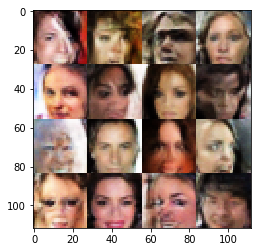

Epoch 17/25... Discriminator Loss: 0.4224... Generator Loss: 1.5097
Epoch 17/25... Discriminator Loss: 2.4112... Generator Loss: 0.1930
Epoch 17/25... Discriminator Loss: 0.1908... Generator Loss: 3.6369
Epoch 17/25... Discriminator Loss: 0.9746... Generator Loss: 0.7805
Epoch 17/25... Discriminator Loss: 0.7366... Generator Loss: 0.9874
Epoch 17/25... Discriminator Loss: 0.3355... Generator Loss: 1.7403
Epoch 17/25... Discriminator Loss: 0.5587... Generator Loss: 1.2687
Epoch 17/25... Discriminator Loss: 0.2551... Generator Loss: 2.5556
Epoch 17/25... Discriminator Loss: 0.1501... Generator Loss: 4.6087
Epoch 17/25... Discriminator Loss: 1.6002... Generator Loss: 5.2388


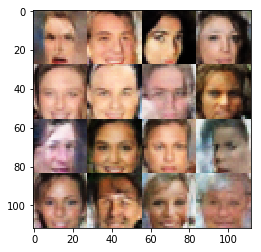

Epoch 17/25... Discriminator Loss: 0.6140... Generator Loss: 1.2028
Epoch 17/25... Discriminator Loss: 0.2017... Generator Loss: 3.5390
Epoch 17/25... Discriminator Loss: 0.3332... Generator Loss: 1.8062
Epoch 17/25... Discriminator Loss: 0.2448... Generator Loss: 2.2688
Epoch 17/25... Discriminator Loss: 0.2099... Generator Loss: 2.7272
Epoch 17/25... Discriminator Loss: 0.3603... Generator Loss: 1.7577
Epoch 17/25... Discriminator Loss: 0.1374... Generator Loss: 2.6430
Epoch 17/25... Discriminator Loss: 0.1801... Generator Loss: 2.3626
Epoch 17/25... Discriminator Loss: 0.4431... Generator Loss: 1.4588
Epoch 17/25... Discriminator Loss: 0.3263... Generator Loss: 1.7711


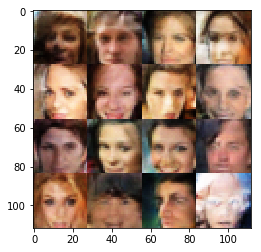

Epoch 17/25... Discriminator Loss: 0.5732... Generator Loss: 1.2744
Epoch 17/25... Discriminator Loss: 0.3845... Generator Loss: 1.5323
Epoch 17/25... Discriminator Loss: 0.3699... Generator Loss: 1.7278
Epoch 17/25... Discriminator Loss: 0.5396... Generator Loss: 1.2380
Epoch 17/25... Discriminator Loss: 0.1901... Generator Loss: 2.2544
Epoch 17/25... Discriminator Loss: 0.8151... Generator Loss: 0.8034
Epoch 17/25... Discriminator Loss: 0.0414... Generator Loss: 4.2233
Epoch 17/25... Discriminator Loss: 0.4011... Generator Loss: 1.5258
Epoch 17/25... Discriminator Loss: 0.2967... Generator Loss: 1.8495
Epoch 17/25... Discriminator Loss: 0.3917... Generator Loss: 1.4828


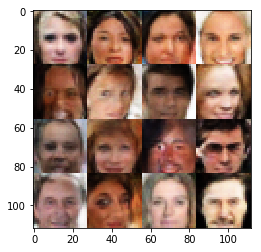

Epoch 17/25... Discriminator Loss: 0.5563... Generator Loss: 1.1977
Epoch 17/25... Discriminator Loss: 0.0315... Generator Loss: 5.0470
Epoch 17/25... Discriminator Loss: 0.3083... Generator Loss: 1.9479
Epoch 17/25... Discriminator Loss: 0.2727... Generator Loss: 1.9951
Epoch 17/25... Discriminator Loss: 0.1078... Generator Loss: 2.9677
Epoch 17/25... Discriminator Loss: 0.2034... Generator Loss: 2.1863
Epoch 17/25... Discriminator Loss: 0.1926... Generator Loss: 2.2812
Epoch 17/25... Discriminator Loss: 0.3984... Generator Loss: 1.5311
Epoch 17/25... Discriminator Loss: 0.5821... Generator Loss: 1.1487
Epoch 17/25... Discriminator Loss: 0.6261... Generator Loss: 1.0676


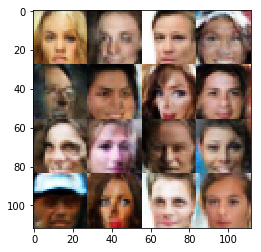

Epoch 17/25... Discriminator Loss: 0.1304... Generator Loss: 2.8267
Epoch 17/25... Discriminator Loss: 0.3157... Generator Loss: 1.8065
Epoch 17/25... Discriminator Loss: 0.1253... Generator Loss: 2.9077
Epoch 17/25... Discriminator Loss: 0.1346... Generator Loss: 2.7119
Epoch 17/25... Discriminator Loss: 0.1987... Generator Loss: 2.0902
Epoch 17/25... Discriminator Loss: 0.2444... Generator Loss: 1.9666
Epoch 17/25... Discriminator Loss: 0.1539... Generator Loss: 2.5610
Epoch 17/25... Discriminator Loss: 0.0796... Generator Loss: 3.1361
Epoch 17/25... Discriminator Loss: 0.1735... Generator Loss: 2.4060
Epoch 18/25... Discriminator Loss: 0.1214... Generator Loss: 2.8486


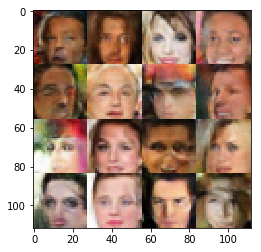

Epoch 18/25... Discriminator Loss: 0.5610... Generator Loss: 1.1932
Epoch 18/25... Discriminator Loss: 0.3319... Generator Loss: 1.7015
Epoch 18/25... Discriminator Loss: 0.1959... Generator Loss: 2.1371
Epoch 18/25... Discriminator Loss: 0.2058... Generator Loss: 2.2870
Epoch 18/25... Discriminator Loss: 0.1545... Generator Loss: 2.5345
Epoch 18/25... Discriminator Loss: 0.2050... Generator Loss: 2.2668
Epoch 18/25... Discriminator Loss: 0.2438... Generator Loss: 2.0561
Epoch 18/25... Discriminator Loss: 0.1169... Generator Loss: 2.8337
Epoch 18/25... Discriminator Loss: 0.2056... Generator Loss: 2.2431
Epoch 18/25... Discriminator Loss: 0.8552... Generator Loss: 0.8282


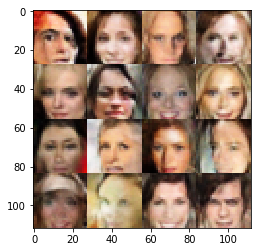

Epoch 18/25... Discriminator Loss: 0.1995... Generator Loss: 2.2348
Epoch 18/25... Discriminator Loss: 1.4911... Generator Loss: 0.4903
Epoch 18/25... Discriminator Loss: 0.8744... Generator Loss: 2.0312
Epoch 18/25... Discriminator Loss: 0.4471... Generator Loss: 2.2760
Epoch 18/25... Discriminator Loss: 0.6334... Generator Loss: 1.0649
Epoch 18/25... Discriminator Loss: 0.3838... Generator Loss: 2.8175
Epoch 18/25... Discriminator Loss: 0.3017... Generator Loss: 1.9678
Epoch 18/25... Discriminator Loss: 0.6065... Generator Loss: 1.2345
Epoch 18/25... Discriminator Loss: 0.3884... Generator Loss: 1.5496
Epoch 18/25... Discriminator Loss: 0.2300... Generator Loss: 2.3073


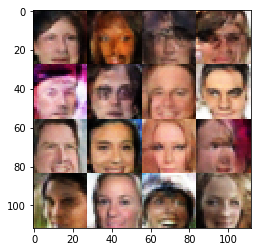

Epoch 18/25... Discriminator Loss: 0.1967... Generator Loss: 2.5284
Epoch 18/25... Discriminator Loss: 0.3449... Generator Loss: 1.7623
Epoch 18/25... Discriminator Loss: 0.2274... Generator Loss: 2.0452
Epoch 18/25... Discriminator Loss: 0.3891... Generator Loss: 1.5916
Epoch 18/25... Discriminator Loss: 0.2153... Generator Loss: 2.3552
Epoch 18/25... Discriminator Loss: 0.3350... Generator Loss: 1.8074
Epoch 18/25... Discriminator Loss: 0.9421... Generator Loss: 0.8266
Epoch 18/25... Discriminator Loss: 0.3313... Generator Loss: 1.7398
Epoch 18/25... Discriminator Loss: 0.1288... Generator Loss: 2.8212
Epoch 18/25... Discriminator Loss: 0.1728... Generator Loss: 2.4140


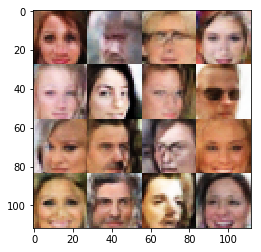

Epoch 18/25... Discriminator Loss: 0.7514... Generator Loss: 0.9735
Epoch 18/25... Discriminator Loss: 0.1998... Generator Loss: 2.2975
Epoch 18/25... Discriminator Loss: 1.5999... Generator Loss: 1.3454
Epoch 18/25... Discriminator Loss: 1.2571... Generator Loss: 1.4194
Epoch 18/25... Discriminator Loss: 1.3604... Generator Loss: 0.7609
Epoch 18/25... Discriminator Loss: 1.2956... Generator Loss: 0.5861
Epoch 18/25... Discriminator Loss: 1.3043... Generator Loss: 1.0832
Epoch 18/25... Discriminator Loss: 1.1462... Generator Loss: 0.9543
Epoch 18/25... Discriminator Loss: 1.2090... Generator Loss: 0.8101
Epoch 18/25... Discriminator Loss: 1.1980... Generator Loss: 1.4059


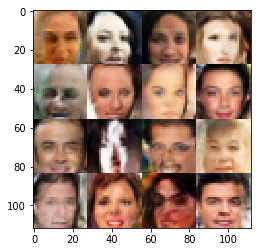

Epoch 18/25... Discriminator Loss: 1.2523... Generator Loss: 0.6536
Epoch 18/25... Discriminator Loss: 1.1272... Generator Loss: 1.0669
Epoch 18/25... Discriminator Loss: 1.3081... Generator Loss: 0.9256
Epoch 18/25... Discriminator Loss: 1.1441... Generator Loss: 0.8603
Epoch 18/25... Discriminator Loss: 1.2851... Generator Loss: 1.4184
Epoch 18/25... Discriminator Loss: 1.1326... Generator Loss: 0.6514
Epoch 18/25... Discriminator Loss: 0.9158... Generator Loss: 1.8919
Epoch 18/25... Discriminator Loss: 0.8087... Generator Loss: 1.1857
Epoch 18/25... Discriminator Loss: 0.5330... Generator Loss: 1.4869
Epoch 18/25... Discriminator Loss: 0.4266... Generator Loss: 1.7476


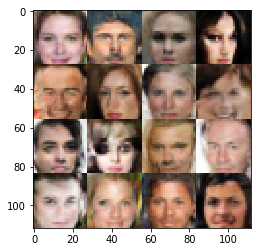

Epoch 18/25... Discriminator Loss: 1.6112... Generator Loss: 0.3752
Epoch 18/25... Discriminator Loss: 0.5143... Generator Loss: 1.8251
Epoch 18/25... Discriminator Loss: 0.6085... Generator Loss: 1.2052
Epoch 18/25... Discriminator Loss: 1.3708... Generator Loss: 0.4872
Epoch 18/25... Discriminator Loss: 0.3958... Generator Loss: 2.3272
Epoch 18/25... Discriminator Loss: 0.4829... Generator Loss: 1.4280
Epoch 18/25... Discriminator Loss: 0.3156... Generator Loss: 1.9218
Epoch 18/25... Discriminator Loss: 0.6922... Generator Loss: 1.1001
Epoch 18/25... Discriminator Loss: 0.5030... Generator Loss: 1.8188
Epoch 18/25... Discriminator Loss: 0.4799... Generator Loss: 1.4342


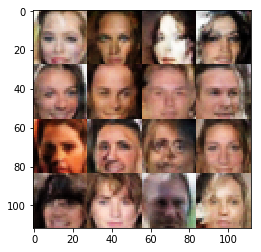

Epoch 18/25... Discriminator Loss: 0.8353... Generator Loss: 0.8145
Epoch 18/25... Discriminator Loss: 0.4480... Generator Loss: 1.5045
Epoch 18/25... Discriminator Loss: 1.1040... Generator Loss: 3.4798
Epoch 18/25... Discriminator Loss: 1.2806... Generator Loss: 1.7819
Epoch 18/25... Discriminator Loss: 0.9667... Generator Loss: 1.2815
Epoch 18/25... Discriminator Loss: 0.8604... Generator Loss: 1.7325
Epoch 18/25... Discriminator Loss: 0.7859... Generator Loss: 1.4310
Epoch 18/25... Discriminator Loss: 0.6713... Generator Loss: 3.1447
Epoch 18/25... Discriminator Loss: 0.5034... Generator Loss: 1.5015
Epoch 18/25... Discriminator Loss: 0.3326... Generator Loss: 2.2436


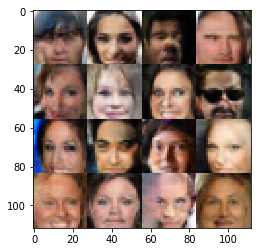

Epoch 18/25... Discriminator Loss: 0.3760... Generator Loss: 1.8401
Epoch 18/25... Discriminator Loss: 0.2519... Generator Loss: 2.7041
Epoch 18/25... Discriminator Loss: 1.3902... Generator Loss: 0.5069
Epoch 18/25... Discriminator Loss: 0.4285... Generator Loss: 1.5197
Epoch 18/25... Discriminator Loss: 0.2277... Generator Loss: 2.1622
Epoch 18/25... Discriminator Loss: 0.1939... Generator Loss: 2.1864
Epoch 18/25... Discriminator Loss: 0.4553... Generator Loss: 1.3820
Epoch 18/25... Discriminator Loss: 0.2151... Generator Loss: 2.2612
Epoch 18/25... Discriminator Loss: 0.5111... Generator Loss: 3.9154
Epoch 18/25... Discriminator Loss: 0.2483... Generator Loss: 3.3205


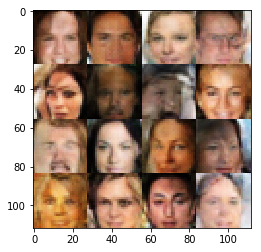

Epoch 18/25... Discriminator Loss: 0.2737... Generator Loss: 1.8565
Epoch 18/25... Discriminator Loss: 0.8478... Generator Loss: 0.7947
Epoch 18/25... Discriminator Loss: 0.6593... Generator Loss: 1.1164
Epoch 18/25... Discriminator Loss: 0.2496... Generator Loss: 2.0902
Epoch 18/25... Discriminator Loss: 0.2441... Generator Loss: 2.0480
Epoch 18/25... Discriminator Loss: 0.3493... Generator Loss: 1.7679
Epoch 18/25... Discriminator Loss: 0.1304... Generator Loss: 2.8474
Epoch 18/25... Discriminator Loss: 0.3438... Generator Loss: 1.6294
Epoch 18/25... Discriminator Loss: 0.4504... Generator Loss: 1.3803
Epoch 18/25... Discriminator Loss: 0.2840... Generator Loss: 1.8748


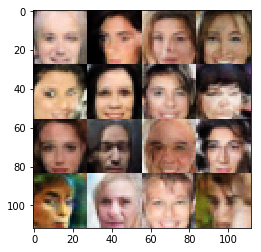

Epoch 18/25... Discriminator Loss: 0.1395... Generator Loss: 3.0481
Epoch 18/25... Discriminator Loss: 0.2250... Generator Loss: 2.1476
Epoch 18/25... Discriminator Loss: 0.3710... Generator Loss: 1.5848
Epoch 18/25... Discriminator Loss: 0.2092... Generator Loss: 2.0961
Epoch 18/25... Discriminator Loss: 0.1491... Generator Loss: 2.8274
Epoch 18/25... Discriminator Loss: 0.3485... Generator Loss: 1.7150
Epoch 18/25... Discriminator Loss: 0.2144... Generator Loss: 2.6329
Epoch 18/25... Discriminator Loss: 0.2291... Generator Loss: 2.0423
Epoch 18/25... Discriminator Loss: 0.3960... Generator Loss: 1.5917
Epoch 18/25... Discriminator Loss: 0.2399... Generator Loss: 2.0671


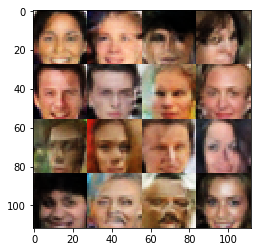

Epoch 18/25... Discriminator Loss: 0.2334... Generator Loss: 2.0811
Epoch 18/25... Discriminator Loss: 3.5598... Generator Loss: 4.9910
Epoch 18/25... Discriminator Loss: 1.1277... Generator Loss: 0.5962
Epoch 18/25... Discriminator Loss: 0.4248... Generator Loss: 2.0591
Epoch 18/25... Discriminator Loss: 0.3897... Generator Loss: 1.7208
Epoch 18/25... Discriminator Loss: 0.2321... Generator Loss: 2.4713
Epoch 18/25... Discriminator Loss: 0.3375... Generator Loss: 1.9582
Epoch 18/25... Discriminator Loss: 0.4831... Generator Loss: 1.4531
Epoch 18/25... Discriminator Loss: 0.4427... Generator Loss: 1.4388
Epoch 18/25... Discriminator Loss: 0.5910... Generator Loss: 1.2434


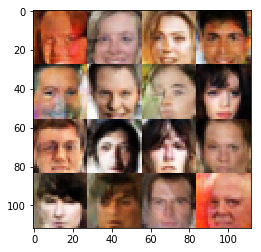

Epoch 18/25... Discriminator Loss: 0.1949... Generator Loss: 2.5643
Epoch 18/25... Discriminator Loss: 0.1376... Generator Loss: 2.9765
Epoch 18/25... Discriminator Loss: 0.1740... Generator Loss: 2.4387
Epoch 18/25... Discriminator Loss: 0.2635... Generator Loss: 2.0259
Epoch 18/25... Discriminator Loss: 0.2261... Generator Loss: 2.1535
Epoch 18/25... Discriminator Loss: 1.4634... Generator Loss: 0.4752
Epoch 18/25... Discriminator Loss: 0.1740... Generator Loss: 2.3618
Epoch 18/25... Discriminator Loss: 0.7918... Generator Loss: 0.8773
Epoch 18/25... Discriminator Loss: 0.3792... Generator Loss: 1.5368
Epoch 18/25... Discriminator Loss: 0.1893... Generator Loss: 2.1587


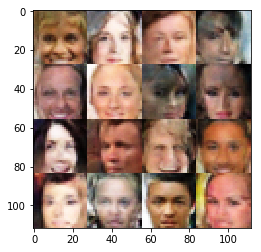

Epoch 18/25... Discriminator Loss: 0.8004... Generator Loss: 0.9005
Epoch 18/25... Discriminator Loss: 0.3540... Generator Loss: 1.7167
Epoch 18/25... Discriminator Loss: 0.2190... Generator Loss: 2.1287
Epoch 18/25... Discriminator Loss: 0.4791... Generator Loss: 1.3703
Epoch 18/25... Discriminator Loss: 0.3302... Generator Loss: 1.7188
Epoch 18/25... Discriminator Loss: 0.3174... Generator Loss: 1.8289
Epoch 18/25... Discriminator Loss: 0.1232... Generator Loss: 3.7720
Epoch 18/25... Discriminator Loss: 0.6490... Generator Loss: 1.0356
Epoch 18/25... Discriminator Loss: 0.2648... Generator Loss: 1.9175
Epoch 18/25... Discriminator Loss: 0.1645... Generator Loss: 2.5015


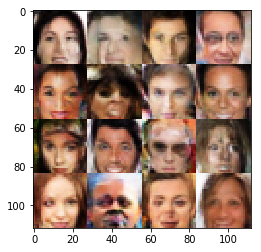

Epoch 18/25... Discriminator Loss: 0.1939... Generator Loss: 2.1618
Epoch 18/25... Discriminator Loss: 0.2073... Generator Loss: 2.2515
Epoch 18/25... Discriminator Loss: 0.1306... Generator Loss: 2.5050
Epoch 18/25... Discriminator Loss: 0.5096... Generator Loss: 1.2734
Epoch 18/25... Discriminator Loss: 0.1013... Generator Loss: 2.9415
Epoch 18/25... Discriminator Loss: 0.6669... Generator Loss: 1.0269
Epoch 18/25... Discriminator Loss: 0.0829... Generator Loss: 3.4761
Epoch 18/25... Discriminator Loss: 0.2600... Generator Loss: 1.9387
Epoch 18/25... Discriminator Loss: 0.3210... Generator Loss: 1.7973
Epoch 18/25... Discriminator Loss: 0.1816... Generator Loss: 2.3828


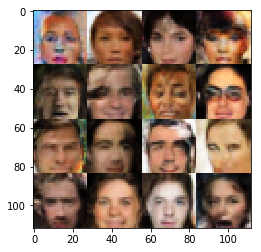

Epoch 18/25... Discriminator Loss: 0.2000... Generator Loss: 2.2937
Epoch 18/25... Discriminator Loss: 2.7843... Generator Loss: 3.9483
Epoch 18/25... Discriminator Loss: 0.9033... Generator Loss: 0.8416
Epoch 18/25... Discriminator Loss: 0.6010... Generator Loss: 1.3197
Epoch 18/25... Discriminator Loss: 0.5989... Generator Loss: 2.3930
Epoch 18/25... Discriminator Loss: 0.3611... Generator Loss: 2.6067
Epoch 18/25... Discriminator Loss: 0.2801... Generator Loss: 2.7594
Epoch 18/25... Discriminator Loss: 0.2175... Generator Loss: 2.8063
Epoch 18/25... Discriminator Loss: 0.2171... Generator Loss: 3.0769
Epoch 18/25... Discriminator Loss: 2.3908... Generator Loss: 0.1970


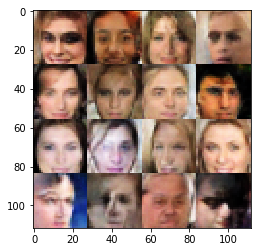

Epoch 18/25... Discriminator Loss: 0.9698... Generator Loss: 0.8071
Epoch 18/25... Discriminator Loss: 0.2274... Generator Loss: 2.6799
Epoch 18/25... Discriminator Loss: 1.9662... Generator Loss: 0.4297
Epoch 18/25... Discriminator Loss: 0.3226... Generator Loss: 1.8195
Epoch 18/25... Discriminator Loss: 0.3774... Generator Loss: 1.6523
Epoch 18/25... Discriminator Loss: 0.3798... Generator Loss: 1.5005
Epoch 18/25... Discriminator Loss: 0.2648... Generator Loss: 2.0390
Epoch 19/25... Discriminator Loss: 0.1510... Generator Loss: 2.5563
Epoch 19/25... Discriminator Loss: 0.3795... Generator Loss: 1.6526
Epoch 19/25... Discriminator Loss: 0.2578... Generator Loss: 1.9005


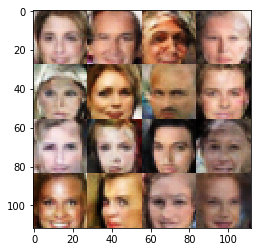

Epoch 19/25... Discriminator Loss: 0.0784... Generator Loss: 4.0296
Epoch 19/25... Discriminator Loss: 0.1481... Generator Loss: 2.7076
Epoch 19/25... Discriminator Loss: 0.4245... Generator Loss: 1.4161
Epoch 19/25... Discriminator Loss: 0.1853... Generator Loss: 3.1538
Epoch 19/25... Discriminator Loss: 0.1401... Generator Loss: 2.7200
Epoch 19/25... Discriminator Loss: 0.2614... Generator Loss: 1.9162
Epoch 19/25... Discriminator Loss: 0.1854... Generator Loss: 2.3061
Epoch 19/25... Discriminator Loss: 0.2502... Generator Loss: 2.1082
Epoch 19/25... Discriminator Loss: 0.5747... Generator Loss: 1.2382
Epoch 19/25... Discriminator Loss: 0.2626... Generator Loss: 1.9729


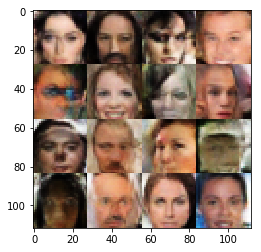

Epoch 19/25... Discriminator Loss: 0.4683... Generator Loss: 1.3839
Epoch 19/25... Discriminator Loss: 0.2839... Generator Loss: 1.9486
Epoch 19/25... Discriminator Loss: 0.2040... Generator Loss: 2.3218
Epoch 19/25... Discriminator Loss: 0.1751... Generator Loss: 2.4468
Epoch 19/25... Discriminator Loss: 0.0825... Generator Loss: 3.0593
Epoch 19/25... Discriminator Loss: 0.2435... Generator Loss: 2.1522
Epoch 19/25... Discriminator Loss: 0.1817... Generator Loss: 2.3160
Epoch 19/25... Discriminator Loss: 0.3168... Generator Loss: 1.6754
Epoch 19/25... Discriminator Loss: 1.8933... Generator Loss: 0.3246
Epoch 19/25... Discriminator Loss: 2.4769... Generator Loss: 2.7680


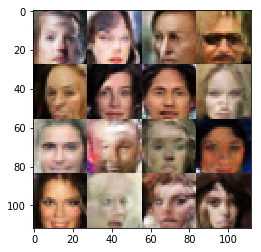

Epoch 19/25... Discriminator Loss: 1.2437... Generator Loss: 0.6479
Epoch 19/25... Discriminator Loss: 1.1870... Generator Loss: 0.9527
Epoch 19/25... Discriminator Loss: 1.0949... Generator Loss: 1.0442
Epoch 19/25... Discriminator Loss: 1.0048... Generator Loss: 0.8700
Epoch 19/25... Discriminator Loss: 0.8324... Generator Loss: 1.1213
Epoch 19/25... Discriminator Loss: 0.9412... Generator Loss: 2.0214
Epoch 19/25... Discriminator Loss: 0.6384... Generator Loss: 1.5084
Epoch 19/25... Discriminator Loss: 0.5081... Generator Loss: 1.4677
Epoch 19/25... Discriminator Loss: 0.4851... Generator Loss: 3.2453
Epoch 19/25... Discriminator Loss: 0.3078... Generator Loss: 2.2048


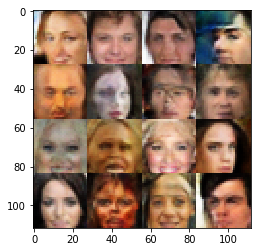

Epoch 19/25... Discriminator Loss: 0.3720... Generator Loss: 3.6130
Epoch 19/25... Discriminator Loss: 0.3896... Generator Loss: 1.7322
Epoch 19/25... Discriminator Loss: 0.7958... Generator Loss: 0.9806
Epoch 19/25... Discriminator Loss: 1.8670... Generator Loss: 4.4640
Epoch 19/25... Discriminator Loss: 0.3328... Generator Loss: 2.2919
Epoch 19/25... Discriminator Loss: 1.5699... Generator Loss: 0.4301
Epoch 19/25... Discriminator Loss: 0.8669... Generator Loss: 0.8766
Epoch 19/25... Discriminator Loss: 0.3523... Generator Loss: 1.6978
Epoch 19/25... Discriminator Loss: 0.1786... Generator Loss: 2.5761
Epoch 19/25... Discriminator Loss: 0.5507... Generator Loss: 1.2967


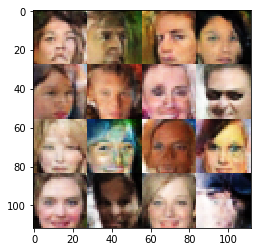

Epoch 19/25... Discriminator Loss: 0.3150... Generator Loss: 1.8807
Epoch 19/25... Discriminator Loss: 0.6009... Generator Loss: 1.1340
Epoch 19/25... Discriminator Loss: 0.1596... Generator Loss: 2.5338
Epoch 19/25... Discriminator Loss: 0.5045... Generator Loss: 1.3078
Epoch 19/25... Discriminator Loss: 0.6608... Generator Loss: 1.1686
Epoch 19/25... Discriminator Loss: 0.8877... Generator Loss: 0.8270
Epoch 19/25... Discriminator Loss: 0.2976... Generator Loss: 1.9675
Epoch 19/25... Discriminator Loss: 1.4312... Generator Loss: 0.4616
Epoch 19/25... Discriminator Loss: 0.5099... Generator Loss: 1.2569
Epoch 19/25... Discriminator Loss: 0.3256... Generator Loss: 1.7090


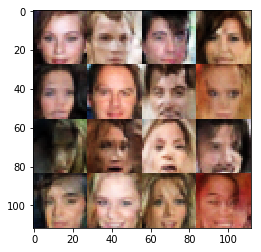

Epoch 19/25... Discriminator Loss: 0.4790... Generator Loss: 1.3643
Epoch 19/25... Discriminator Loss: 0.4334... Generator Loss: 1.4658
Epoch 19/25... Discriminator Loss: 0.2269... Generator Loss: 2.2037
Epoch 19/25... Discriminator Loss: 0.2306... Generator Loss: 2.2410
Epoch 19/25... Discriminator Loss: 0.1473... Generator Loss: 2.4405
Epoch 19/25... Discriminator Loss: 0.2343... Generator Loss: 1.9354
Epoch 19/25... Discriminator Loss: 0.1125... Generator Loss: 2.8376
Epoch 19/25... Discriminator Loss: 0.3709... Generator Loss: 1.5935
Epoch 19/25... Discriminator Loss: 0.3195... Generator Loss: 1.8404
Epoch 19/25... Discriminator Loss: 0.1011... Generator Loss: 2.9537


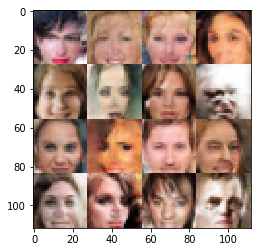

Epoch 19/25... Discriminator Loss: 0.1736... Generator Loss: 2.2534
Epoch 19/25... Discriminator Loss: 0.2729... Generator Loss: 1.9090
Epoch 19/25... Discriminator Loss: 0.2982... Generator Loss: 1.6791
Epoch 19/25... Discriminator Loss: 0.4874... Generator Loss: 1.2982
Epoch 19/25... Discriminator Loss: 0.2686... Generator Loss: 1.9097
Epoch 19/25... Discriminator Loss: 0.2616... Generator Loss: 1.9494
Epoch 19/25... Discriminator Loss: 0.0858... Generator Loss: 3.1411
Epoch 19/25... Discriminator Loss: 0.1543... Generator Loss: 2.5778
Epoch 19/25... Discriminator Loss: 0.1148... Generator Loss: 3.0575
Epoch 19/25... Discriminator Loss: 0.1135... Generator Loss: 2.9869


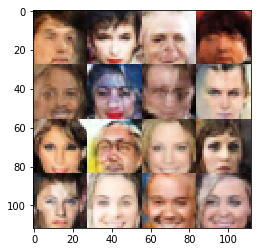

Epoch 19/25... Discriminator Loss: 0.1038... Generator Loss: 2.8730
Epoch 19/25... Discriminator Loss: 0.2365... Generator Loss: 2.1217
Epoch 19/25... Discriminator Loss: 0.3032... Generator Loss: 1.7680
Epoch 19/25... Discriminator Loss: 0.2462... Generator Loss: 1.9584
Epoch 19/25... Discriminator Loss: 0.0882... Generator Loss: 3.0707
Epoch 19/25... Discriminator Loss: 0.4314... Generator Loss: 1.4186
Epoch 19/25... Discriminator Loss: 0.3283... Generator Loss: 1.7173
Epoch 19/25... Discriminator Loss: 0.2000... Generator Loss: 2.2372
Epoch 19/25... Discriminator Loss: 0.1421... Generator Loss: 2.5181
Epoch 19/25... Discriminator Loss: 0.5690... Generator Loss: 1.3603


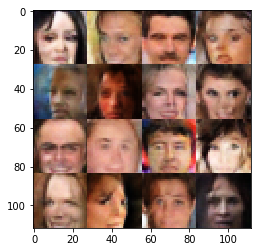

Epoch 19/25... Discriminator Loss: 1.1471... Generator Loss: 3.2483
Epoch 19/25... Discriminator Loss: 0.3891... Generator Loss: 1.7648
Epoch 19/25... Discriminator Loss: 0.3637... Generator Loss: 2.4588
Epoch 19/25... Discriminator Loss: 0.4160... Generator Loss: 1.5550
Epoch 19/25... Discriminator Loss: 0.3983... Generator Loss: 3.8711
Epoch 19/25... Discriminator Loss: 0.2800... Generator Loss: 2.3442
Epoch 19/25... Discriminator Loss: 0.2508... Generator Loss: 2.4473
Epoch 19/25... Discriminator Loss: 0.2065... Generator Loss: 2.5773
Epoch 19/25... Discriminator Loss: 0.5165... Generator Loss: 1.3275
Epoch 19/25... Discriminator Loss: 0.1966... Generator Loss: 2.5122


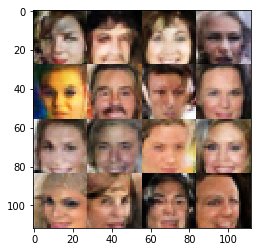

Epoch 19/25... Discriminator Loss: 0.1944... Generator Loss: 2.3184
Epoch 19/25... Discriminator Loss: 0.2094... Generator Loss: 2.1479
Epoch 19/25... Discriminator Loss: 0.5385... Generator Loss: 1.2609
Epoch 19/25... Discriminator Loss: 0.0825... Generator Loss: 3.3190
Epoch 19/25... Discriminator Loss: 0.1016... Generator Loss: 3.1433
Epoch 19/25... Discriminator Loss: 0.4764... Generator Loss: 1.4091
Epoch 19/25... Discriminator Loss: 0.2561... Generator Loss: 1.9196
Epoch 19/25... Discriminator Loss: 0.2928... Generator Loss: 1.8202
Epoch 19/25... Discriminator Loss: 0.1186... Generator Loss: 2.8438
Epoch 19/25... Discriminator Loss: 0.1133... Generator Loss: 3.1078


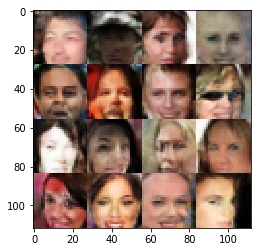

Epoch 19/25... Discriminator Loss: 0.5118... Generator Loss: 1.3236
Epoch 19/25... Discriminator Loss: 0.5570... Generator Loss: 1.3915
Epoch 19/25... Discriminator Loss: 0.0965... Generator Loss: 3.2407
Epoch 19/25... Discriminator Loss: 0.2023... Generator Loss: 2.2037
Epoch 19/25... Discriminator Loss: 0.2091... Generator Loss: 2.4775
Epoch 19/25... Discriminator Loss: 0.2285... Generator Loss: 2.1374
Epoch 19/25... Discriminator Loss: 0.3879... Generator Loss: 1.4783
Epoch 19/25... Discriminator Loss: 0.1315... Generator Loss: 2.7013
Epoch 19/25... Discriminator Loss: 0.1032... Generator Loss: 3.1606
Epoch 19/25... Discriminator Loss: 0.0832... Generator Loss: 3.3923


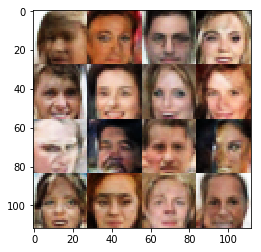

Epoch 19/25... Discriminator Loss: 8.3347... Generator Loss: 10.4322
Epoch 19/25... Discriminator Loss: 0.7911... Generator Loss: 1.5465
Epoch 19/25... Discriminator Loss: 0.6964... Generator Loss: 1.1087
Epoch 19/25... Discriminator Loss: 0.6971... Generator Loss: 1.1818
Epoch 19/25... Discriminator Loss: 0.4841... Generator Loss: 1.4512
Epoch 19/25... Discriminator Loss: 0.4157... Generator Loss: 3.8155
Epoch 19/25... Discriminator Loss: 0.3735... Generator Loss: 1.7456
Epoch 19/25... Discriminator Loss: 0.2689... Generator Loss: 2.2104
Epoch 19/25... Discriminator Loss: 0.3158... Generator Loss: 2.1826
Epoch 19/25... Discriminator Loss: 0.1725... Generator Loss: 3.9164


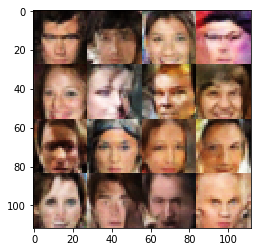

Epoch 19/25... Discriminator Loss: 0.3641... Generator Loss: 1.8415
Epoch 19/25... Discriminator Loss: 1.0080... Generator Loss: 0.7925
Epoch 19/25... Discriminator Loss: 0.4905... Generator Loss: 2.4488
Epoch 19/25... Discriminator Loss: 0.4304... Generator Loss: 1.6379
Epoch 19/25... Discriminator Loss: 0.4035... Generator Loss: 1.6386
Epoch 19/25... Discriminator Loss: 0.2499... Generator Loss: 2.2240
Epoch 19/25... Discriminator Loss: 0.2485... Generator Loss: 2.2446
Epoch 19/25... Discriminator Loss: 0.7741... Generator Loss: 0.9903
Epoch 19/25... Discriminator Loss: 0.5984... Generator Loss: 1.3005
Epoch 19/25... Discriminator Loss: 0.3237... Generator Loss: 2.3142


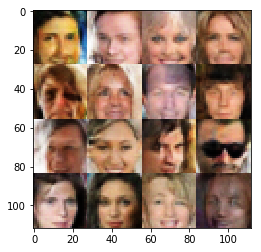

Epoch 19/25... Discriminator Loss: 0.4740... Generator Loss: 1.5508
Epoch 19/25... Discriminator Loss: 0.3003... Generator Loss: 1.7724
Epoch 19/25... Discriminator Loss: 0.3674... Generator Loss: 2.5126
Epoch 19/25... Discriminator Loss: 0.4493... Generator Loss: 1.4855
Epoch 19/25... Discriminator Loss: 0.6321... Generator Loss: 1.1224
Epoch 19/25... Discriminator Loss: 0.1671... Generator Loss: 2.5729
Epoch 19/25... Discriminator Loss: 0.1825... Generator Loss: 2.4237
Epoch 19/25... Discriminator Loss: 0.3563... Generator Loss: 1.5045
Epoch 19/25... Discriminator Loss: 0.1338... Generator Loss: 3.2344
Epoch 19/25... Discriminator Loss: 0.1525... Generator Loss: 2.7872


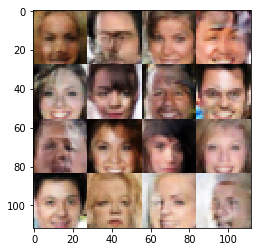

Epoch 19/25... Discriminator Loss: 0.1878... Generator Loss: 2.2107
Epoch 19/25... Discriminator Loss: 0.1158... Generator Loss: 2.8218
Epoch 19/25... Discriminator Loss: 0.2593... Generator Loss: 1.9368
Epoch 19/25... Discriminator Loss: 0.3520... Generator Loss: 1.6416
Epoch 19/25... Discriminator Loss: 1.2539... Generator Loss: 0.5840
Epoch 19/25... Discriminator Loss: 0.1849... Generator Loss: 2.9591
Epoch 19/25... Discriminator Loss: 0.2636... Generator Loss: 2.1796
Epoch 19/25... Discriminator Loss: 0.1506... Generator Loss: 2.7698
Epoch 19/25... Discriminator Loss: 0.3898... Generator Loss: 1.6328
Epoch 19/25... Discriminator Loss: 0.3404... Generator Loss: 1.7385


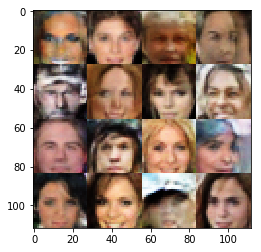

Epoch 19/25... Discriminator Loss: 0.3020... Generator Loss: 1.7655
Epoch 19/25... Discriminator Loss: 0.1132... Generator Loss: 2.9427
Epoch 19/25... Discriminator Loss: 0.4290... Generator Loss: 1.4973
Epoch 19/25... Discriminator Loss: 0.2889... Generator Loss: 1.7867
Epoch 19/25... Discriminator Loss: 0.4068... Generator Loss: 1.5272
Epoch 20/25... Discriminator Loss: 0.2650... Generator Loss: 1.9670
Epoch 20/25... Discriminator Loss: 0.2292... Generator Loss: 2.2076
Epoch 20/25... Discriminator Loss: 0.2245... Generator Loss: 2.2522
Epoch 20/25... Discriminator Loss: 0.1914... Generator Loss: 2.3111
Epoch 20/25... Discriminator Loss: 0.2901... Generator Loss: 1.9489


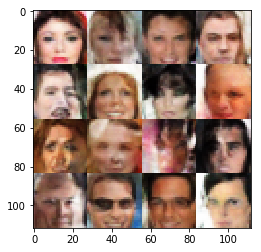

Epoch 20/25... Discriminator Loss: 0.1002... Generator Loss: 2.9171
Epoch 20/25... Discriminator Loss: 0.1974... Generator Loss: 2.2118
Epoch 20/25... Discriminator Loss: 0.3456... Generator Loss: 1.6574
Epoch 20/25... Discriminator Loss: 0.4576... Generator Loss: 1.4491
Epoch 20/25... Discriminator Loss: 0.2678... Generator Loss: 1.8984
Epoch 20/25... Discriminator Loss: 0.5257... Generator Loss: 1.2653
Epoch 20/25... Discriminator Loss: 0.1929... Generator Loss: 2.1468
Epoch 20/25... Discriminator Loss: 0.0823... Generator Loss: 3.3008
Epoch 20/25... Discriminator Loss: 0.1914... Generator Loss: 2.3669
Epoch 20/25... Discriminator Loss: 0.6042... Generator Loss: 1.1235


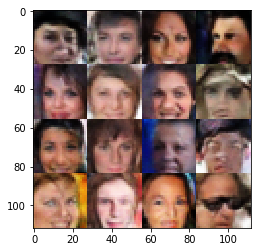

Epoch 20/25... Discriminator Loss: 0.1177... Generator Loss: 2.7550
Epoch 20/25... Discriminator Loss: 0.1595... Generator Loss: 2.4319
Epoch 20/25... Discriminator Loss: 0.2840... Generator Loss: 1.9036
Epoch 20/25... Discriminator Loss: 0.2773... Generator Loss: 1.8376
Epoch 20/25... Discriminator Loss: 0.2948... Generator Loss: 1.8318
Epoch 20/25... Discriminator Loss: 0.1102... Generator Loss: 3.3308
Epoch 20/25... Discriminator Loss: 0.1409... Generator Loss: 2.6840
Epoch 20/25... Discriminator Loss: 0.3078... Generator Loss: 1.8240
Epoch 20/25... Discriminator Loss: 0.1486... Generator Loss: 2.5720
Epoch 20/25... Discriminator Loss: 0.1997... Generator Loss: 2.2487


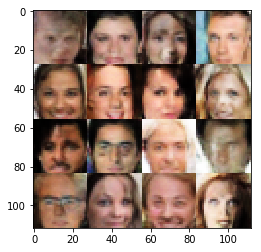

Epoch 20/25... Discriminator Loss: 0.3459... Generator Loss: 1.6891
Epoch 20/25... Discriminator Loss: 0.1591... Generator Loss: 2.5715
Epoch 20/25... Discriminator Loss: 0.4899... Generator Loss: 1.3531
Epoch 20/25... Discriminator Loss: 0.1236... Generator Loss: 2.7151
Epoch 20/25... Discriminator Loss: 0.4627... Generator Loss: 1.3254
Epoch 20/25... Discriminator Loss: 0.5044... Generator Loss: 1.3769
Epoch 20/25... Discriminator Loss: 0.1159... Generator Loss: 2.8388
Epoch 20/25... Discriminator Loss: 0.5478... Generator Loss: 1.2614
Epoch 20/25... Discriminator Loss: 0.3787... Generator Loss: 1.6184
Epoch 20/25... Discriminator Loss: 0.1890... Generator Loss: 2.2585


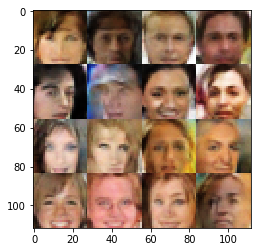

Epoch 20/25... Discriminator Loss: 0.5194... Generator Loss: 1.3303
Epoch 20/25... Discriminator Loss: 0.1396... Generator Loss: 2.7799
Epoch 20/25... Discriminator Loss: 0.1779... Generator Loss: 2.4248
Epoch 20/25... Discriminator Loss: 0.2435... Generator Loss: 2.0270
Epoch 20/25... Discriminator Loss: 0.2230... Generator Loss: 2.0648
Epoch 20/25... Discriminator Loss: 0.3136... Generator Loss: 1.7839
Epoch 20/25... Discriminator Loss: 0.2674... Generator Loss: 1.9085
Epoch 20/25... Discriminator Loss: 0.0946... Generator Loss: 3.1041
Epoch 20/25... Discriminator Loss: 0.3818... Generator Loss: 1.6352
Epoch 20/25... Discriminator Loss: 0.2376... Generator Loss: 2.0959


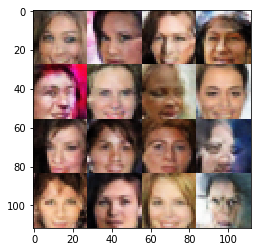

Epoch 20/25... Discriminator Loss: 0.8063... Generator Loss: 0.9753
Epoch 20/25... Discriminator Loss: 0.1189... Generator Loss: 3.7775
Epoch 20/25... Discriminator Loss: 0.3404... Generator Loss: 1.7862
Epoch 20/25... Discriminator Loss: 0.1709... Generator Loss: 2.4763
Epoch 20/25... Discriminator Loss: 0.3575... Generator Loss: 1.6812
Epoch 20/25... Discriminator Loss: 0.0672... Generator Loss: 3.5278
Epoch 20/25... Discriminator Loss: 0.3270... Generator Loss: 1.8145
Epoch 20/25... Discriminator Loss: 0.3623... Generator Loss: 1.6475
Epoch 20/25... Discriminator Loss: 0.1910... Generator Loss: 2.3553
Epoch 20/25... Discriminator Loss: 0.1271... Generator Loss: 2.7043


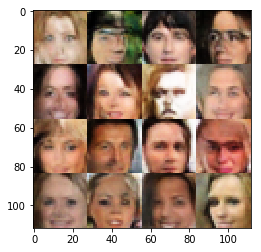

Epoch 20/25... Discriminator Loss: 0.2618... Generator Loss: 1.8489
Epoch 20/25... Discriminator Loss: 0.2231... Generator Loss: 2.0310
Epoch 20/25... Discriminator Loss: 0.1415... Generator Loss: 2.7086
Epoch 20/25... Discriminator Loss: 0.1760... Generator Loss: 2.2647
Epoch 20/25... Discriminator Loss: 0.4570... Generator Loss: 1.4335
Epoch 20/25... Discriminator Loss: 0.2103... Generator Loss: 2.0987
Epoch 20/25... Discriminator Loss: 0.2943... Generator Loss: 1.7837
Epoch 20/25... Discriminator Loss: 0.0887... Generator Loss: 3.2522
Epoch 20/25... Discriminator Loss: 0.1369... Generator Loss: 2.5053
Epoch 20/25... Discriminator Loss: 0.2639... Generator Loss: 1.9978


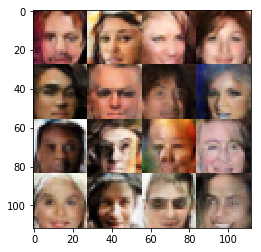

Epoch 20/25... Discriminator Loss: 0.2329... Generator Loss: 2.1435
Epoch 20/25... Discriminator Loss: 0.1206... Generator Loss: 2.7759
Epoch 20/25... Discriminator Loss: 0.0530... Generator Loss: 3.5723
Epoch 20/25... Discriminator Loss: 0.1825... Generator Loss: 2.3172
Epoch 20/25... Discriminator Loss: 0.1547... Generator Loss: 2.6174
Epoch 20/25... Discriminator Loss: 0.1454... Generator Loss: 2.6881
Epoch 20/25... Discriminator Loss: 0.2022... Generator Loss: 2.1964
Epoch 20/25... Discriminator Loss: 0.0600... Generator Loss: 5.5257
Epoch 20/25... Discriminator Loss: 1.9435... Generator Loss: 2.2314
Epoch 20/25... Discriminator Loss: 1.4298... Generator Loss: 1.2234


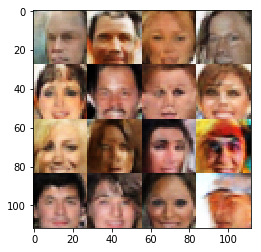

Epoch 20/25... Discriminator Loss: 1.5755... Generator Loss: 0.3516
Epoch 20/25... Discriminator Loss: 1.1393... Generator Loss: 1.3341
Epoch 20/25... Discriminator Loss: 1.0934... Generator Loss: 0.9262
Epoch 20/25... Discriminator Loss: 1.0417... Generator Loss: 0.7431
Epoch 20/25... Discriminator Loss: 0.6328... Generator Loss: 2.9636
Epoch 20/25... Discriminator Loss: 0.7269... Generator Loss: 4.2201
Epoch 20/25... Discriminator Loss: 1.0773... Generator Loss: 0.7745
Epoch 20/25... Discriminator Loss: 0.2407... Generator Loss: 3.8297
Epoch 20/25... Discriminator Loss: 0.3370... Generator Loss: 2.5914
Epoch 20/25... Discriminator Loss: 0.5292... Generator Loss: 1.5396


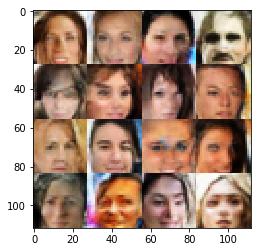

Epoch 20/25... Discriminator Loss: 0.2435... Generator Loss: 3.3057
Epoch 20/25... Discriminator Loss: 0.2960... Generator Loss: 2.2031
Epoch 20/25... Discriminator Loss: 0.2388... Generator Loss: 2.2573
Epoch 20/25... Discriminator Loss: 0.4711... Generator Loss: 1.5033
Epoch 20/25... Discriminator Loss: 0.5026... Generator Loss: 1.4676
Epoch 20/25... Discriminator Loss: 0.4508... Generator Loss: 1.6092
Epoch 20/25... Discriminator Loss: 0.5198... Generator Loss: 1.3494
Epoch 20/25... Discriminator Loss: 0.6974... Generator Loss: 1.1503
Epoch 20/25... Discriminator Loss: 0.1530... Generator Loss: 2.6115
Epoch 20/25... Discriminator Loss: 0.2693... Generator Loss: 1.9460


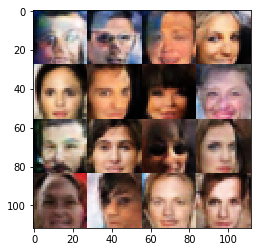

Epoch 20/25... Discriminator Loss: 0.2545... Generator Loss: 2.2492
Epoch 20/25... Discriminator Loss: 0.2400... Generator Loss: 2.0871
Epoch 20/25... Discriminator Loss: 0.9103... Generator Loss: 0.8076
Epoch 20/25... Discriminator Loss: 0.3163... Generator Loss: 1.7623
Epoch 20/25... Discriminator Loss: 0.8531... Generator Loss: 0.8666
Epoch 20/25... Discriminator Loss: 0.1027... Generator Loss: 2.9432
Epoch 20/25... Discriminator Loss: 0.2716... Generator Loss: 2.6283
Epoch 20/25... Discriminator Loss: 3.5395... Generator Loss: 0.0931
Epoch 20/25... Discriminator Loss: 0.6781... Generator Loss: 1.1630
Epoch 20/25... Discriminator Loss: 0.4874... Generator Loss: 2.2796


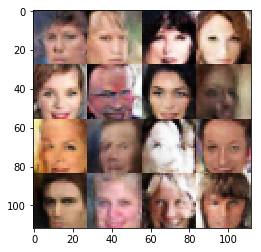

Epoch 20/25... Discriminator Loss: 0.6700... Generator Loss: 3.6603
Epoch 20/25... Discriminator Loss: 0.3237... Generator Loss: 2.2255
Epoch 20/25... Discriminator Loss: 0.2742... Generator Loss: 2.7934
Epoch 20/25... Discriminator Loss: 1.6135... Generator Loss: 7.0031
Epoch 20/25... Discriminator Loss: 0.2323... Generator Loss: 2.4098
Epoch 20/25... Discriminator Loss: 0.3231... Generator Loss: 1.9084
Epoch 20/25... Discriminator Loss: 0.6455... Generator Loss: 1.1367
Epoch 20/25... Discriminator Loss: 1.4447... Generator Loss: 0.4807
Epoch 20/25... Discriminator Loss: 0.2731... Generator Loss: 2.0663
Epoch 20/25... Discriminator Loss: 2.1069... Generator Loss: 0.2758


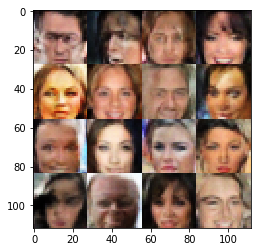

Epoch 20/25... Discriminator Loss: 0.7410... Generator Loss: 1.1873
Epoch 20/25... Discriminator Loss: 0.3654... Generator Loss: 2.1090
Epoch 20/25... Discriminator Loss: 0.3920... Generator Loss: 1.7632
Epoch 20/25... Discriminator Loss: 0.7281... Generator Loss: 1.0166
Epoch 20/25... Discriminator Loss: 0.2792... Generator Loss: 2.1200
Epoch 20/25... Discriminator Loss: 0.8300... Generator Loss: 0.9010
Epoch 20/25... Discriminator Loss: 0.6129... Generator Loss: 1.1443
Epoch 20/25... Discriminator Loss: 0.6770... Generator Loss: 2.9136
Epoch 20/25... Discriminator Loss: 0.3202... Generator Loss: 2.5409
Epoch 20/25... Discriminator Loss: 0.3847... Generator Loss: 1.7541


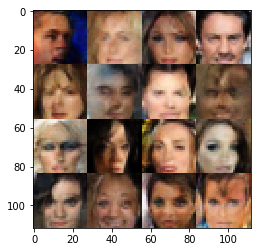

Epoch 20/25... Discriminator Loss: 2.4526... Generator Loss: 6.0811
Epoch 20/25... Discriminator Loss: 0.6733... Generator Loss: 4.0134
Epoch 20/25... Discriminator Loss: 0.3698... Generator Loss: 1.8655
Epoch 20/25... Discriminator Loss: 0.3810... Generator Loss: 1.6840
Epoch 20/25... Discriminator Loss: 0.4643... Generator Loss: 1.6657
Epoch 20/25... Discriminator Loss: 0.5665... Generator Loss: 1.1467
Epoch 20/25... Discriminator Loss: 0.0468... Generator Loss: 3.9437
Epoch 20/25... Discriminator Loss: 0.3115... Generator Loss: 1.8753
Epoch 20/25... Discriminator Loss: 0.1819... Generator Loss: 2.4537
Epoch 20/25... Discriminator Loss: 0.1711... Generator Loss: 2.6674


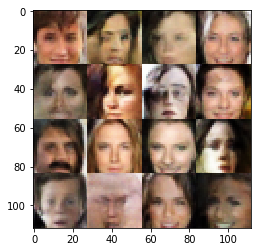

Epoch 20/25... Discriminator Loss: 0.3415... Generator Loss: 1.7118
Epoch 20/25... Discriminator Loss: 0.0981... Generator Loss: 3.2582
Epoch 20/25... Discriminator Loss: 0.2745... Generator Loss: 1.9073
Epoch 20/25... Discriminator Loss: 0.0908... Generator Loss: 3.2372
Epoch 20/25... Discriminator Loss: 0.3612... Generator Loss: 1.6442
Epoch 20/25... Discriminator Loss: 0.2482... Generator Loss: 1.9532
Epoch 20/25... Discriminator Loss: 0.0957... Generator Loss: 3.0937
Epoch 20/25... Discriminator Loss: 0.1193... Generator Loss: 3.1543
Epoch 20/25... Discriminator Loss: 0.0792... Generator Loss: 3.3685
Epoch 20/25... Discriminator Loss: 0.0997... Generator Loss: 3.0523


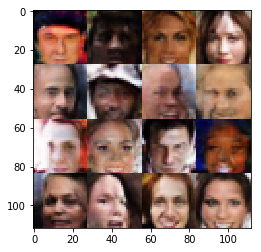

Epoch 20/25... Discriminator Loss: 0.4682... Generator Loss: 1.4022
Epoch 20/25... Discriminator Loss: 0.3291... Generator Loss: 1.6844
Epoch 20/25... Discriminator Loss: 0.4843... Generator Loss: 1.2972
Epoch 20/25... Discriminator Loss: 0.4718... Generator Loss: 1.3517
Epoch 20/25... Discriminator Loss: 0.1227... Generator Loss: 2.8691
Epoch 20/25... Discriminator Loss: 0.4758... Generator Loss: 1.4002
Epoch 20/25... Discriminator Loss: 0.1877... Generator Loss: 2.4278
Epoch 20/25... Discriminator Loss: 0.3337... Generator Loss: 1.7128
Epoch 20/25... Discriminator Loss: 0.0741... Generator Loss: 3.9464
Epoch 20/25... Discriminator Loss: 0.3885... Generator Loss: 1.5949


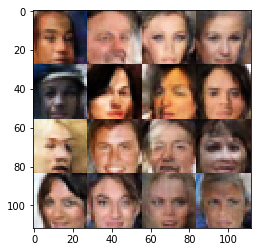

Epoch 20/25... Discriminator Loss: 0.1701... Generator Loss: 2.4361
Epoch 20/25... Discriminator Loss: 3.4332... Generator Loss: 8.5068
Epoch 20/25... Discriminator Loss: 0.6099... Generator Loss: 2.4656
Epoch 20/25... Discriminator Loss: 0.2623... Generator Loss: 2.7856
Epoch 21/25... Discriminator Loss: 0.2857... Generator Loss: 1.8902
Epoch 21/25... Discriminator Loss: 0.2288... Generator Loss: 2.4859
Epoch 21/25... Discriminator Loss: 0.1920... Generator Loss: 2.3608
Epoch 21/25... Discriminator Loss: 0.1022... Generator Loss: 2.9872
Epoch 21/25... Discriminator Loss: 0.3206... Generator Loss: 2.0892
Epoch 21/25... Discriminator Loss: 0.6700... Generator Loss: 1.0433


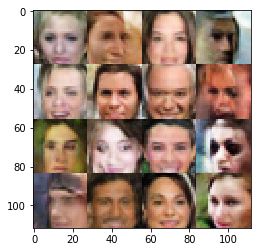

Epoch 21/25... Discriminator Loss: 0.2352... Generator Loss: 2.1137
Epoch 21/25... Discriminator Loss: 0.2109... Generator Loss: 2.4503
Epoch 21/25... Discriminator Loss: 0.4554... Generator Loss: 1.4053
Epoch 21/25... Discriminator Loss: 0.3995... Generator Loss: 1.6397
Epoch 21/25... Discriminator Loss: 0.3600... Generator Loss: 1.6971
Epoch 21/25... Discriminator Loss: 0.0625... Generator Loss: 4.1053
Epoch 21/25... Discriminator Loss: 0.2102... Generator Loss: 2.3147
Epoch 21/25... Discriminator Loss: 0.2467... Generator Loss: 1.9658
Epoch 21/25... Discriminator Loss: 0.1949... Generator Loss: 2.2832
Epoch 21/25... Discriminator Loss: 0.1793... Generator Loss: 2.3466


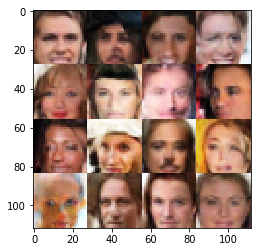

Epoch 21/25... Discriminator Loss: 0.3330... Generator Loss: 1.7386
Epoch 21/25... Discriminator Loss: 0.1166... Generator Loss: 2.9586
Epoch 21/25... Discriminator Loss: 0.1309... Generator Loss: 2.7876
Epoch 21/25... Discriminator Loss: 0.4186... Generator Loss: 1.5476
Epoch 21/25... Discriminator Loss: 0.1040... Generator Loss: 2.9569
Epoch 21/25... Discriminator Loss: 0.1514... Generator Loss: 2.7024
Epoch 21/25... Discriminator Loss: 0.2374... Generator Loss: 2.0844
Epoch 21/25... Discriminator Loss: 0.1646... Generator Loss: 2.4762
Epoch 21/25... Discriminator Loss: 0.1809... Generator Loss: 2.5377
Epoch 21/25... Discriminator Loss: 0.1191... Generator Loss: 2.8688


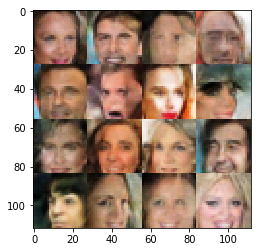

Epoch 21/25... Discriminator Loss: 0.1177... Generator Loss: 2.8329
Epoch 21/25... Discriminator Loss: 0.5517... Generator Loss: 1.2306
Epoch 21/25... Discriminator Loss: 0.2411... Generator Loss: 2.1316
Epoch 21/25... Discriminator Loss: 0.4501... Generator Loss: 1.4129
Epoch 21/25... Discriminator Loss: 0.0619... Generator Loss: 3.4763
Epoch 21/25... Discriminator Loss: 0.3890... Generator Loss: 1.5548
Epoch 21/25... Discriminator Loss: 2.0876... Generator Loss: 0.2315
Epoch 21/25... Discriminator Loss: 2.0186... Generator Loss: 0.2200
Epoch 21/25... Discriminator Loss: 1.7306... Generator Loss: 1.7279
Epoch 21/25... Discriminator Loss: 1.2764... Generator Loss: 0.6338


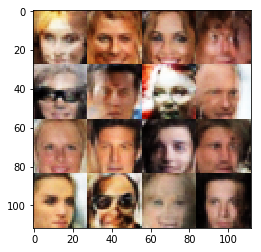

Epoch 21/25... Discriminator Loss: 1.1563... Generator Loss: 1.0438
Epoch 21/25... Discriminator Loss: 1.0238... Generator Loss: 1.1293
Epoch 21/25... Discriminator Loss: 1.1312... Generator Loss: 1.0277
Epoch 21/25... Discriminator Loss: 1.1625... Generator Loss: 0.6962
Epoch 21/25... Discriminator Loss: 1.0056... Generator Loss: 1.1319
Epoch 21/25... Discriminator Loss: 0.9018... Generator Loss: 1.2563
Epoch 21/25... Discriminator Loss: 0.9518... Generator Loss: 0.8514
Epoch 21/25... Discriminator Loss: 0.6474... Generator Loss: 1.5088
Epoch 21/25... Discriminator Loss: 0.3692... Generator Loss: 1.9735
Epoch 21/25... Discriminator Loss: 1.2726... Generator Loss: 4.0204


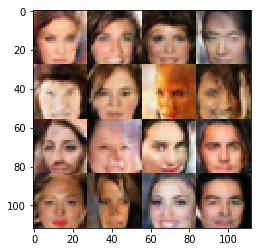

Epoch 21/25... Discriminator Loss: 0.3708... Generator Loss: 1.8526
Epoch 21/25... Discriminator Loss: 0.2588... Generator Loss: 4.0883
Epoch 21/25... Discriminator Loss: 0.3207... Generator Loss: 1.9101
Epoch 21/25... Discriminator Loss: 0.9999... Generator Loss: 0.8642
Epoch 21/25... Discriminator Loss: 0.2757... Generator Loss: 2.4784
Epoch 21/25... Discriminator Loss: 0.3412... Generator Loss: 2.0653
Epoch 21/25... Discriminator Loss: 0.5051... Generator Loss: 1.4839
Epoch 21/25... Discriminator Loss: 0.6947... Generator Loss: 1.1854
Epoch 21/25... Discriminator Loss: 0.4036... Generator Loss: 2.4531
Epoch 21/25... Discriminator Loss: 0.2674... Generator Loss: 2.9853


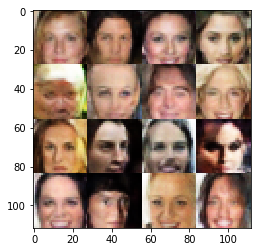

Epoch 21/25... Discriminator Loss: 0.7412... Generator Loss: 0.9809
Epoch 21/25... Discriminator Loss: 0.3308... Generator Loss: 1.9064
Epoch 21/25... Discriminator Loss: 0.3674... Generator Loss: 1.7724
Epoch 21/25... Discriminator Loss: 0.5982... Generator Loss: 1.1685
Epoch 21/25... Discriminator Loss: 0.4665... Generator Loss: 1.5040
Epoch 21/25... Discriminator Loss: 0.3241... Generator Loss: 1.8404
Epoch 21/25... Discriminator Loss: 0.2226... Generator Loss: 2.5316
Epoch 21/25... Discriminator Loss: 0.4718... Generator Loss: 1.4039
Epoch 21/25... Discriminator Loss: 0.5212... Generator Loss: 1.2815
Epoch 21/25... Discriminator Loss: 0.2374... Generator Loss: 1.9935


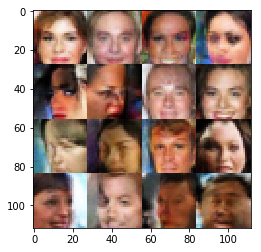

Epoch 21/25... Discriminator Loss: 0.4625... Generator Loss: 1.3541
Epoch 21/25... Discriminator Loss: 0.1761... Generator Loss: 2.4234
Epoch 21/25... Discriminator Loss: 0.1739... Generator Loss: 2.3660
Epoch 21/25... Discriminator Loss: 0.2220... Generator Loss: 2.1821
Epoch 21/25... Discriminator Loss: 0.3424... Generator Loss: 1.5763
Epoch 21/25... Discriminator Loss: 0.3916... Generator Loss: 1.4727
Epoch 21/25... Discriminator Loss: 0.4273... Generator Loss: 1.5122
Epoch 21/25... Discriminator Loss: 4.7556... Generator Loss: 0.0410
Epoch 21/25... Discriminator Loss: 1.1573... Generator Loss: 0.7268
Epoch 21/25... Discriminator Loss: 1.0425... Generator Loss: 0.7133


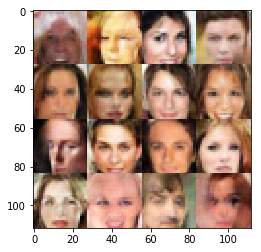

Epoch 21/25... Discriminator Loss: 0.7582... Generator Loss: 1.1983
Epoch 21/25... Discriminator Loss: 0.6874... Generator Loss: 1.1878
Epoch 21/25... Discriminator Loss: 0.3189... Generator Loss: 1.9673
Epoch 21/25... Discriminator Loss: 0.2687... Generator Loss: 2.7998
Epoch 21/25... Discriminator Loss: 0.7664... Generator Loss: 1.0808
Epoch 21/25... Discriminator Loss: 0.6137... Generator Loss: 1.1606
Epoch 21/25... Discriminator Loss: 0.7166... Generator Loss: 1.1116
Epoch 21/25... Discriminator Loss: 0.5448... Generator Loss: 1.2853
Epoch 21/25... Discriminator Loss: 0.2720... Generator Loss: 1.9890
Epoch 21/25... Discriminator Loss: 0.4605... Generator Loss: 1.4387


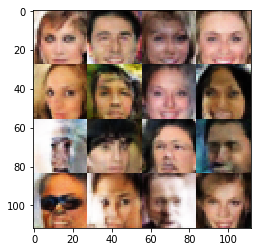

Epoch 21/25... Discriminator Loss: 0.5399... Generator Loss: 1.2805
Epoch 21/25... Discriminator Loss: 0.2267... Generator Loss: 2.4181
Epoch 21/25... Discriminator Loss: 0.1049... Generator Loss: 2.8370
Epoch 21/25... Discriminator Loss: 0.2096... Generator Loss: 2.1694
Epoch 21/25... Discriminator Loss: 0.2220... Generator Loss: 2.0398
Epoch 21/25... Discriminator Loss: 0.2781... Generator Loss: 2.0243
Epoch 21/25... Discriminator Loss: 0.1602... Generator Loss: 2.8730
Epoch 21/25... Discriminator Loss: 0.0909... Generator Loss: 3.2857
Epoch 21/25... Discriminator Loss: 0.2200... Generator Loss: 2.0853
Epoch 21/25... Discriminator Loss: 0.2547... Generator Loss: 2.0511


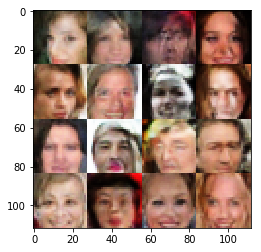

Epoch 21/25... Discriminator Loss: 0.1207... Generator Loss: 2.8074
Epoch 21/25... Discriminator Loss: 0.3397... Generator Loss: 1.6331
Epoch 21/25... Discriminator Loss: 0.2634... Generator Loss: 2.0092
Epoch 21/25... Discriminator Loss: 0.1026... Generator Loss: 2.9721
Epoch 21/25... Discriminator Loss: 0.2824... Generator Loss: 1.7907
Epoch 21/25... Discriminator Loss: 2.0348... Generator Loss: 0.2613
Epoch 21/25... Discriminator Loss: 0.3911... Generator Loss: 1.6168
Epoch 21/25... Discriminator Loss: 0.1921... Generator Loss: 2.3174
Epoch 21/25... Discriminator Loss: 0.3378... Generator Loss: 1.6598
Epoch 21/25... Discriminator Loss: 0.2013... Generator Loss: 2.4144


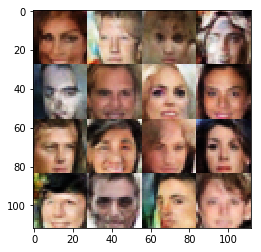

Epoch 21/25... Discriminator Loss: 0.1521... Generator Loss: 2.5783
Epoch 21/25... Discriminator Loss: 0.2552... Generator Loss: 2.0302
Epoch 21/25... Discriminator Loss: 0.0533... Generator Loss: 3.7699
Epoch 21/25... Discriminator Loss: 0.4089... Generator Loss: 1.5295
Epoch 21/25... Discriminator Loss: 0.3936... Generator Loss: 1.6764
Epoch 21/25... Discriminator Loss: 0.2984... Generator Loss: 1.7554
Epoch 21/25... Discriminator Loss: 0.3497... Generator Loss: 1.6165
Epoch 21/25... Discriminator Loss: 0.1183... Generator Loss: 3.1082
Epoch 21/25... Discriminator Loss: 1.1049... Generator Loss: 0.7731
Epoch 21/25... Discriminator Loss: 1.0410... Generator Loss: 1.6317


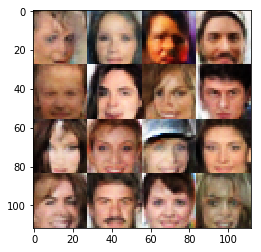

Epoch 21/25... Discriminator Loss: 0.7867... Generator Loss: 1.4222
Epoch 21/25... Discriminator Loss: 0.5972... Generator Loss: 1.7198
Epoch 21/25... Discriminator Loss: 0.3082... Generator Loss: 2.5619
Epoch 21/25... Discriminator Loss: 0.2705... Generator Loss: 2.2523
Epoch 21/25... Discriminator Loss: 0.2563... Generator Loss: 2.1412
Epoch 21/25... Discriminator Loss: 0.2703... Generator Loss: 2.1605
Epoch 21/25... Discriminator Loss: 1.1833... Generator Loss: 0.7752
Epoch 21/25... Discriminator Loss: 0.5936... Generator Loss: 1.2650
Epoch 21/25... Discriminator Loss: 0.4652... Generator Loss: 1.4224
Epoch 21/25... Discriminator Loss: 0.1121... Generator Loss: 3.0287


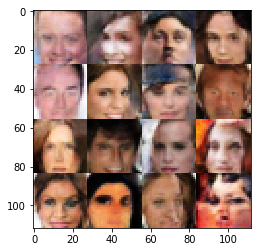

Epoch 21/25... Discriminator Loss: 0.6207... Generator Loss: 1.1405
Epoch 21/25... Discriminator Loss: 0.1027... Generator Loss: 4.3494
Epoch 21/25... Discriminator Loss: 0.2123... Generator Loss: 2.3408
Epoch 21/25... Discriminator Loss: 0.4515... Generator Loss: 1.4671
Epoch 21/25... Discriminator Loss: 0.1991... Generator Loss: 2.3083
Epoch 21/25... Discriminator Loss: 0.2719... Generator Loss: 1.8684
Epoch 21/25... Discriminator Loss: 0.1342... Generator Loss: 2.8727
Epoch 21/25... Discriminator Loss: 0.6789... Generator Loss: 1.0160
Epoch 21/25... Discriminator Loss: 0.6132... Generator Loss: 1.1869
Epoch 21/25... Discriminator Loss: 0.5855... Generator Loss: 1.2128


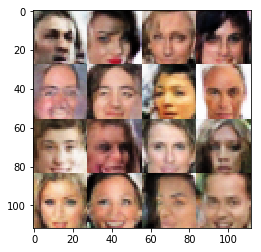

Epoch 21/25... Discriminator Loss: 0.1454... Generator Loss: 2.9847
Epoch 21/25... Discriminator Loss: 0.2057... Generator Loss: 2.2915
Epoch 21/25... Discriminator Loss: 0.1916... Generator Loss: 2.3680
Epoch 21/25... Discriminator Loss: 0.2676... Generator Loss: 2.0208
Epoch 21/25... Discriminator Loss: 0.2371... Generator Loss: 2.2148
Epoch 21/25... Discriminator Loss: 0.2776... Generator Loss: 1.9520
Epoch 21/25... Discriminator Loss: 0.4640... Generator Loss: 1.3723
Epoch 21/25... Discriminator Loss: 0.1236... Generator Loss: 3.0681
Epoch 21/25... Discriminator Loss: 0.3552... Generator Loss: 1.9295
Epoch 21/25... Discriminator Loss: 0.4357... Generator Loss: 1.6244


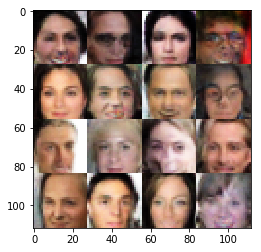

Epoch 21/25... Discriminator Loss: 0.0736... Generator Loss: 3.7957
Epoch 21/25... Discriminator Loss: 1.9299... Generator Loss: 3.7068
Epoch 21/25... Discriminator Loss: 0.5680... Generator Loss: 1.2278
Epoch 21/25... Discriminator Loss: 0.4885... Generator Loss: 1.7904
Epoch 21/25... Discriminator Loss: 0.1852... Generator Loss: 3.4998
Epoch 21/25... Discriminator Loss: 0.2225... Generator Loss: 2.2711
Epoch 21/25... Discriminator Loss: 0.4366... Generator Loss: 1.6300
Epoch 21/25... Discriminator Loss: 0.3374... Generator Loss: 1.8122
Epoch 21/25... Discriminator Loss: 0.3621... Generator Loss: 2.3368
Epoch 21/25... Discriminator Loss: 0.3440... Generator Loss: 1.7800


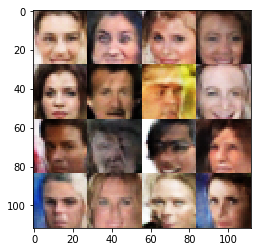

Epoch 21/25... Discriminator Loss: 0.1646... Generator Loss: 2.7093
Epoch 21/25... Discriminator Loss: 0.4373... Generator Loss: 1.5684
Epoch 22/25... Discriminator Loss: 0.7453... Generator Loss: 1.0355
Epoch 22/25... Discriminator Loss: 0.2422... Generator Loss: 2.0543
Epoch 22/25... Discriminator Loss: 0.7793... Generator Loss: 0.8507
Epoch 22/25... Discriminator Loss: 0.1498... Generator Loss: 2.5524
Epoch 22/25... Discriminator Loss: 0.3267... Generator Loss: 1.7440
Epoch 22/25... Discriminator Loss: 0.3848... Generator Loss: 1.5657
Epoch 22/25... Discriminator Loss: 0.1603... Generator Loss: 2.6300
Epoch 22/25... Discriminator Loss: 0.3693... Generator Loss: 1.8263


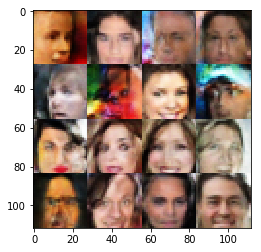

Epoch 22/25... Discriminator Loss: 0.3775... Generator Loss: 1.6738
Epoch 22/25... Discriminator Loss: 0.3452... Generator Loss: 1.7119
Epoch 22/25... Discriminator Loss: 1.5202... Generator Loss: 1.9437
Epoch 22/25... Discriminator Loss: 1.5543... Generator Loss: 0.4421
Epoch 22/25... Discriminator Loss: 0.6528... Generator Loss: 1.2169
Epoch 22/25... Discriminator Loss: 0.9296... Generator Loss: 0.8501
Epoch 22/25... Discriminator Loss: 0.3461... Generator Loss: 2.9948
Epoch 22/25... Discriminator Loss: 0.3283... Generator Loss: 1.9934
Epoch 22/25... Discriminator Loss: 0.3402... Generator Loss: 2.0185
Epoch 22/25... Discriminator Loss: 0.1375... Generator Loss: 3.0911


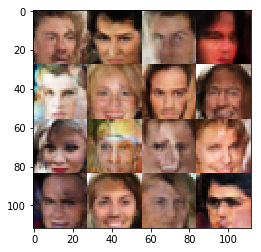

Epoch 22/25... Discriminator Loss: 0.1929... Generator Loss: 2.8422
Epoch 22/25... Discriminator Loss: 0.5539... Generator Loss: 1.2141
Epoch 22/25... Discriminator Loss: 2.9799... Generator Loss: 7.1831
Epoch 22/25... Discriminator Loss: 0.2442... Generator Loss: 2.6269
Epoch 22/25... Discriminator Loss: 0.1720... Generator Loss: 3.0134
Epoch 22/25... Discriminator Loss: 0.6806... Generator Loss: 1.1473
Epoch 22/25... Discriminator Loss: 0.2175... Generator Loss: 2.2689
Epoch 22/25... Discriminator Loss: 0.1741... Generator Loss: 2.6265
Epoch 22/25... Discriminator Loss: 0.6278... Generator Loss: 1.2134
Epoch 22/25... Discriminator Loss: 0.2457... Generator Loss: 2.9355


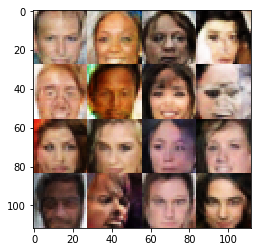

Epoch 22/25... Discriminator Loss: 1.8654... Generator Loss: 0.3935
Epoch 22/25... Discriminator Loss: 0.4071... Generator Loss: 2.4100
Epoch 22/25... Discriminator Loss: 0.3174... Generator Loss: 2.2886
Epoch 22/25... Discriminator Loss: 0.3112... Generator Loss: 1.9045
Epoch 22/25... Discriminator Loss: 0.4307... Generator Loss: 3.5993
Epoch 22/25... Discriminator Loss: 0.1859... Generator Loss: 2.5408
Epoch 22/25... Discriminator Loss: 0.1849... Generator Loss: 2.3642
Epoch 22/25... Discriminator Loss: 0.2428... Generator Loss: 2.1083
Epoch 22/25... Discriminator Loss: 0.1145... Generator Loss: 2.8972
Epoch 22/25... Discriminator Loss: 0.1836... Generator Loss: 2.3941


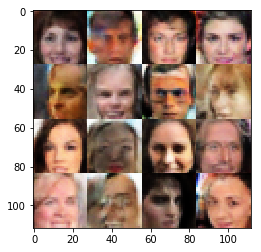

Epoch 22/25... Discriminator Loss: 0.6599... Generator Loss: 1.0815
Epoch 22/25... Discriminator Loss: 0.2060... Generator Loss: 2.3458
Epoch 22/25... Discriminator Loss: 0.4155... Generator Loss: 1.4795
Epoch 22/25... Discriminator Loss: 0.4202... Generator Loss: 1.4638
Epoch 22/25... Discriminator Loss: 0.3252... Generator Loss: 1.6829
Epoch 22/25... Discriminator Loss: 0.5688... Generator Loss: 1.1780
Epoch 22/25... Discriminator Loss: 0.3593... Generator Loss: 1.6119
Epoch 22/25... Discriminator Loss: 0.4092... Generator Loss: 1.5486
Epoch 22/25... Discriminator Loss: 0.3881... Generator Loss: 1.5027
Epoch 22/25... Discriminator Loss: 0.3136... Generator Loss: 1.7870


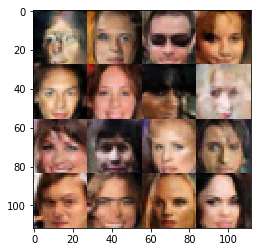

Epoch 22/25... Discriminator Loss: 0.1506... Generator Loss: 2.7066
Epoch 22/25... Discriminator Loss: 0.1458... Generator Loss: 2.6220
Epoch 22/25... Discriminator Loss: 0.1326... Generator Loss: 3.1362
Epoch 22/25... Discriminator Loss: 0.3282... Generator Loss: 1.7831
Epoch 22/25... Discriminator Loss: 0.4996... Generator Loss: 1.3400
Epoch 22/25... Discriminator Loss: 0.2036... Generator Loss: 2.2719
Epoch 22/25... Discriminator Loss: 0.1632... Generator Loss: 2.4159
Epoch 22/25... Discriminator Loss: 0.0601... Generator Loss: 3.9345
Epoch 22/25... Discriminator Loss: 0.1009... Generator Loss: 3.1631
Epoch 22/25... Discriminator Loss: 0.3661... Generator Loss: 1.6245


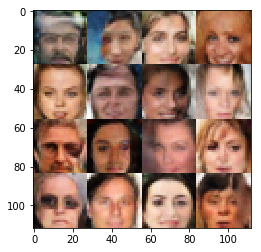

Epoch 22/25... Discriminator Loss: 0.1327... Generator Loss: 2.7870
Epoch 22/25... Discriminator Loss: 0.1192... Generator Loss: 2.7114
Epoch 22/25... Discriminator Loss: 0.3714... Generator Loss: 1.5913
Epoch 22/25... Discriminator Loss: 0.3018... Generator Loss: 1.8515
Epoch 22/25... Discriminator Loss: 0.2574... Generator Loss: 1.9790
Epoch 22/25... Discriminator Loss: 0.2199... Generator Loss: 2.1110
Epoch 22/25... Discriminator Loss: 0.4011... Generator Loss: 1.5879
Epoch 22/25... Discriminator Loss: 0.3178... Generator Loss: 1.7616
Epoch 22/25... Discriminator Loss: 0.1012... Generator Loss: 2.9292
Epoch 22/25... Discriminator Loss: 0.0710... Generator Loss: 3.4375


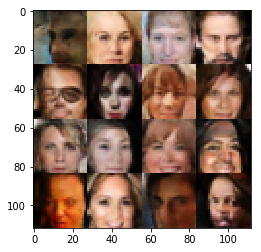

Epoch 22/25... Discriminator Loss: 0.2471... Generator Loss: 2.0728
Epoch 22/25... Discriminator Loss: 0.1450... Generator Loss: 2.5243
Epoch 22/25... Discriminator Loss: 0.0898... Generator Loss: 3.0918
Epoch 22/25... Discriminator Loss: 0.2257... Generator Loss: 2.1839
Epoch 22/25... Discriminator Loss: 0.0915... Generator Loss: 3.2889
Epoch 22/25... Discriminator Loss: 0.2424... Generator Loss: 2.0795
Epoch 22/25... Discriminator Loss: 0.4699... Generator Loss: 1.4296
Epoch 22/25... Discriminator Loss: 0.1234... Generator Loss: 2.8003
Epoch 22/25... Discriminator Loss: 0.2202... Generator Loss: 2.1652
Epoch 22/25... Discriminator Loss: 0.4161... Generator Loss: 1.5059


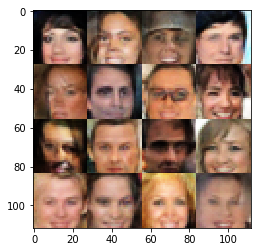

Epoch 22/25... Discriminator Loss: 0.1395... Generator Loss: 2.7455
Epoch 22/25... Discriminator Loss: 0.1379... Generator Loss: 2.7065
Epoch 22/25... Discriminator Loss: 0.1319... Generator Loss: 2.8940
Epoch 22/25... Discriminator Loss: 0.1367... Generator Loss: 2.6234
Epoch 22/25... Discriminator Loss: 0.1509... Generator Loss: 2.6789
Epoch 22/25... Discriminator Loss: 0.2230... Generator Loss: 2.0479
Epoch 22/25... Discriminator Loss: 0.1138... Generator Loss: 2.9737
Epoch 22/25... Discriminator Loss: 0.2483... Generator Loss: 2.2694
Epoch 22/25... Discriminator Loss: 0.3300... Generator Loss: 1.8923
Epoch 22/25... Discriminator Loss: 0.2640... Generator Loss: 2.0606


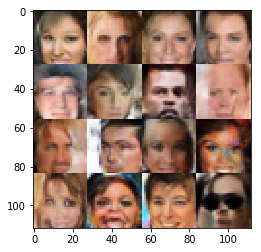

Epoch 22/25... Discriminator Loss: 1.0849... Generator Loss: 0.7461
Epoch 22/25... Discriminator Loss: 0.3645... Generator Loss: 2.7421
Epoch 22/25... Discriminator Loss: 1.0302... Generator Loss: 2.2574
Epoch 22/25... Discriminator Loss: 0.2095... Generator Loss: 2.6572
Epoch 22/25... Discriminator Loss: 0.3046... Generator Loss: 1.9844
Epoch 22/25... Discriminator Loss: 0.4601... Generator Loss: 1.4704
Epoch 22/25... Discriminator Loss: 1.1885... Generator Loss: 6.3907
Epoch 22/25... Discriminator Loss: 0.2438... Generator Loss: 2.3706
Epoch 22/25... Discriminator Loss: 3.0504... Generator Loss: 7.4300
Epoch 22/25... Discriminator Loss: 0.9201... Generator Loss: 0.8071


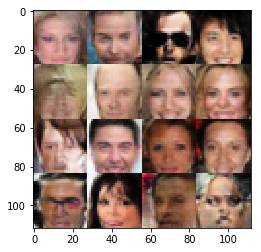

Epoch 22/25... Discriminator Loss: 0.4047... Generator Loss: 1.4937
Epoch 22/25... Discriminator Loss: 0.9901... Generator Loss: 0.7627
Epoch 22/25... Discriminator Loss: 0.3229... Generator Loss: 1.8591
Epoch 22/25... Discriminator Loss: 0.2284... Generator Loss: 2.1760
Epoch 22/25... Discriminator Loss: 0.1078... Generator Loss: 3.1762
Epoch 22/25... Discriminator Loss: 0.1746... Generator Loss: 2.5716
Epoch 22/25... Discriminator Loss: 0.5540... Generator Loss: 1.3326
Epoch 22/25... Discriminator Loss: 0.8910... Generator Loss: 0.9022
Epoch 22/25... Discriminator Loss: 0.5112... Generator Loss: 1.3537
Epoch 22/25... Discriminator Loss: 0.2197... Generator Loss: 2.3116


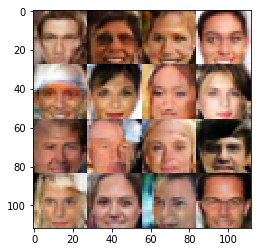

Epoch 22/25... Discriminator Loss: 0.3990... Generator Loss: 1.6195
Epoch 22/25... Discriminator Loss: 0.2919... Generator Loss: 1.7880
Epoch 22/25... Discriminator Loss: 0.7495... Generator Loss: 1.1386
Epoch 22/25... Discriminator Loss: 0.2373... Generator Loss: 2.2015
Epoch 22/25... Discriminator Loss: 0.2898... Generator Loss: 2.0152
Epoch 22/25... Discriminator Loss: 0.5814... Generator Loss: 1.1763
Epoch 22/25... Discriminator Loss: 0.2781... Generator Loss: 1.9817
Epoch 22/25... Discriminator Loss: 0.0710... Generator Loss: 3.3325
Epoch 22/25... Discriminator Loss: 0.2112... Generator Loss: 2.4574
Epoch 22/25... Discriminator Loss: 0.1075... Generator Loss: 2.7655


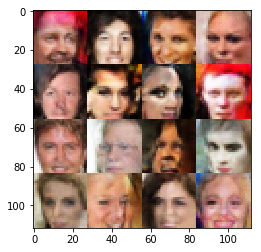

Epoch 22/25... Discriminator Loss: 0.3367... Generator Loss: 1.8049
Epoch 22/25... Discriminator Loss: 0.8475... Generator Loss: 0.7945
Epoch 22/25... Discriminator Loss: 0.2803... Generator Loss: 1.9717
Epoch 22/25... Discriminator Loss: 0.2956... Generator Loss: 1.8578
Epoch 22/25... Discriminator Loss: 0.0770... Generator Loss: 3.2777
Epoch 22/25... Discriminator Loss: 0.2229... Generator Loss: 2.1674
Epoch 22/25... Discriminator Loss: 0.2615... Generator Loss: 1.9823
Epoch 22/25... Discriminator Loss: 0.1405... Generator Loss: 2.8467
Epoch 22/25... Discriminator Loss: 0.3070... Generator Loss: 1.7341
Epoch 22/25... Discriminator Loss: 0.3874... Generator Loss: 1.7136


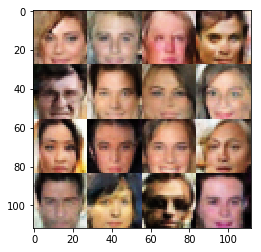

Epoch 22/25... Discriminator Loss: 1.0126... Generator Loss: 0.9062
Epoch 22/25... Discriminator Loss: 0.7681... Generator Loss: 1.8242
Epoch 22/25... Discriminator Loss: 0.4259... Generator Loss: 2.4262
Epoch 22/25... Discriminator Loss: 0.4485... Generator Loss: 1.5086
Epoch 22/25... Discriminator Loss: 0.3511... Generator Loss: 2.4101
Epoch 22/25... Discriminator Loss: 0.4150... Generator Loss: 2.8125
Epoch 22/25... Discriminator Loss: 0.3376... Generator Loss: 2.5922
Epoch 22/25... Discriminator Loss: 0.1673... Generator Loss: 3.2567
Epoch 22/25... Discriminator Loss: 1.3992... Generator Loss: 4.4154
Epoch 22/25... Discriminator Loss: 0.1859... Generator Loss: 2.9271


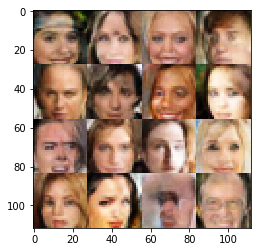

Epoch 22/25... Discriminator Loss: 0.2821... Generator Loss: 2.0213
Epoch 22/25... Discriminator Loss: 0.4619... Generator Loss: 1.4811
Epoch 22/25... Discriminator Loss: 0.4129... Generator Loss: 1.5296
Epoch 22/25... Discriminator Loss: 0.3786... Generator Loss: 1.7988
Epoch 22/25... Discriminator Loss: 0.3192... Generator Loss: 1.7960
Epoch 22/25... Discriminator Loss: 4.9966... Generator Loss: 10.3693
Epoch 22/25... Discriminator Loss: 0.4784... Generator Loss: 1.9583
Epoch 22/25... Discriminator Loss: 0.4841... Generator Loss: 1.3842
Epoch 22/25... Discriminator Loss: 0.3739... Generator Loss: 3.1117
Epoch 22/25... Discriminator Loss: 1.0716... Generator Loss: 5.0543


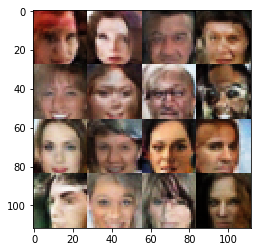

Epoch 22/25... Discriminator Loss: 0.2729... Generator Loss: 2.3622
Epoch 22/25... Discriminator Loss: 0.3407... Generator Loss: 1.8372
Epoch 22/25... Discriminator Loss: 0.4283... Generator Loss: 1.4968
Epoch 22/25... Discriminator Loss: 0.2542... Generator Loss: 2.0532
Epoch 22/25... Discriminator Loss: 0.1927... Generator Loss: 2.4053
Epoch 22/25... Discriminator Loss: 0.1759... Generator Loss: 2.3238
Epoch 22/25... Discriminator Loss: 0.6825... Generator Loss: 1.0338
Epoch 22/25... Discriminator Loss: 1.0190... Generator Loss: 0.7448
Epoch 22/25... Discriminator Loss: 1.2842... Generator Loss: 0.7629
Epoch 22/25... Discriminator Loss: 1.1483... Generator Loss: 0.6403


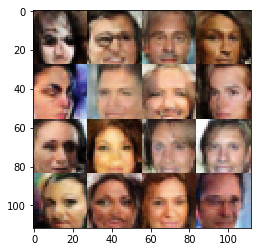

Epoch 23/25... Discriminator Loss: 0.8144... Generator Loss: 0.9897
Epoch 23/25... Discriminator Loss: 0.3387... Generator Loss: 2.3620
Epoch 23/25... Discriminator Loss: 1.5227... Generator Loss: 5.9934
Epoch 23/25... Discriminator Loss: 0.5005... Generator Loss: 1.4167
Epoch 23/25... Discriminator Loss: 1.0752... Generator Loss: 0.7364
Epoch 23/25... Discriminator Loss: 0.3193... Generator Loss: 1.9474
Epoch 23/25... Discriminator Loss: 0.2332... Generator Loss: 2.4076
Epoch 23/25... Discriminator Loss: 0.5721... Generator Loss: 1.2655
Epoch 23/25... Discriminator Loss: 0.2121... Generator Loss: 2.3147
Epoch 23/25... Discriminator Loss: 0.4700... Generator Loss: 1.3992


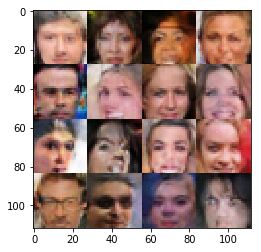

Epoch 23/25... Discriminator Loss: 0.6935... Generator Loss: 0.9960
Epoch 23/25... Discriminator Loss: 0.0887... Generator Loss: 3.4367
Epoch 23/25... Discriminator Loss: 0.2970... Generator Loss: 1.9122
Epoch 23/25... Discriminator Loss: 0.3562... Generator Loss: 1.7270
Epoch 23/25... Discriminator Loss: 0.5590... Generator Loss: 1.2333
Epoch 23/25... Discriminator Loss: 0.0957... Generator Loss: 3.1258
Epoch 23/25... Discriminator Loss: 0.1728... Generator Loss: 2.4305
Epoch 23/25... Discriminator Loss: 0.0598... Generator Loss: 3.7268
Epoch 23/25... Discriminator Loss: 0.1602... Generator Loss: 2.6772
Epoch 23/25... Discriminator Loss: 0.3014... Generator Loss: 1.8711


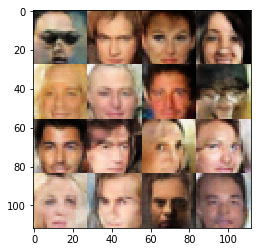

Epoch 23/25... Discriminator Loss: 0.2183... Generator Loss: 2.1991
Epoch 23/25... Discriminator Loss: 0.1615... Generator Loss: 2.8281
Epoch 23/25... Discriminator Loss: 0.1647... Generator Loss: 2.5355
Epoch 23/25... Discriminator Loss: 0.2421... Generator Loss: 1.9332
Epoch 23/25... Discriminator Loss: 0.0894... Generator Loss: 3.3949
Epoch 23/25... Discriminator Loss: 0.4317... Generator Loss: 1.5365
Epoch 23/25... Discriminator Loss: 0.3727... Generator Loss: 1.5832
Epoch 23/25... Discriminator Loss: 0.4909... Generator Loss: 1.3227
Epoch 23/25... Discriminator Loss: 0.5291... Generator Loss: 1.1972
Epoch 23/25... Discriminator Loss: 0.1047... Generator Loss: 2.9971


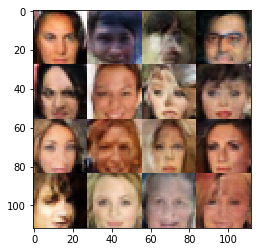

Epoch 23/25... Discriminator Loss: 0.3150... Generator Loss: 1.8286
Epoch 23/25... Discriminator Loss: 0.2385... Generator Loss: 2.1951
Epoch 23/25... Discriminator Loss: 0.1360... Generator Loss: 2.7019
Epoch 23/25... Discriminator Loss: 0.4020... Generator Loss: 1.6555
Epoch 23/25... Discriminator Loss: 0.1364... Generator Loss: 2.8543
Epoch 23/25... Discriminator Loss: 0.2372... Generator Loss: 2.3631
Epoch 23/25... Discriminator Loss: 0.3186... Generator Loss: 1.7961
Epoch 23/25... Discriminator Loss: 0.1775... Generator Loss: 2.5077
Epoch 23/25... Discriminator Loss: 0.4679... Generator Loss: 1.5165
Epoch 23/25... Discriminator Loss: 0.4580... Generator Loss: 1.5396


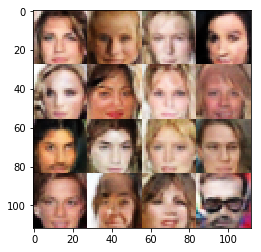

Epoch 23/25... Discriminator Loss: 0.3217... Generator Loss: 1.8308
Epoch 23/25... Discriminator Loss: 0.1704... Generator Loss: 2.3634
Epoch 23/25... Discriminator Loss: 0.1858... Generator Loss: 2.3529
Epoch 23/25... Discriminator Loss: 0.1339... Generator Loss: 2.7625
Epoch 23/25... Discriminator Loss: 0.4574... Generator Loss: 1.5768
Epoch 23/25... Discriminator Loss: 0.3651... Generator Loss: 1.7618
Epoch 23/25... Discriminator Loss: 0.2694... Generator Loss: 2.0894
Epoch 23/25... Discriminator Loss: 0.0837... Generator Loss: 3.3939
Epoch 23/25... Discriminator Loss: 0.1270... Generator Loss: 2.8303
Epoch 23/25... Discriminator Loss: 0.3912... Generator Loss: 1.6192


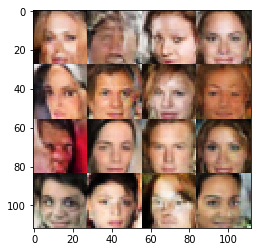

Epoch 23/25... Discriminator Loss: 0.0970... Generator Loss: 3.6336
Epoch 23/25... Discriminator Loss: 0.1502... Generator Loss: 2.6543
Epoch 23/25... Discriminator Loss: 0.1846... Generator Loss: 2.3514
Epoch 23/25... Discriminator Loss: 0.2797... Generator Loss: 1.8948
Epoch 23/25... Discriminator Loss: 0.3112... Generator Loss: 1.8197
Epoch 23/25... Discriminator Loss: 0.6732... Generator Loss: 1.1141
Epoch 23/25... Discriminator Loss: 0.1442... Generator Loss: 2.5736
Epoch 23/25... Discriminator Loss: 0.1626... Generator Loss: 2.5370
Epoch 23/25... Discriminator Loss: 0.4059... Generator Loss: 1.6300
Epoch 23/25... Discriminator Loss: 0.1053... Generator Loss: 3.0654


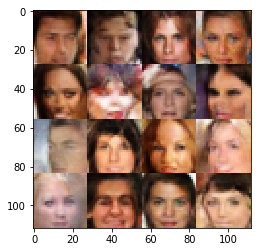

Epoch 23/25... Discriminator Loss: 0.3005... Generator Loss: 1.8822
Epoch 23/25... Discriminator Loss: 0.2862... Generator Loss: 1.8098
Epoch 23/25... Discriminator Loss: 0.1687... Generator Loss: 2.4646
Epoch 23/25... Discriminator Loss: 0.5594... Generator Loss: 1.3379
Epoch 23/25... Discriminator Loss: 0.1294... Generator Loss: 2.6907
Epoch 23/25... Discriminator Loss: 0.0941... Generator Loss: 3.1632
Epoch 23/25... Discriminator Loss: 0.1047... Generator Loss: 3.3467
Epoch 23/25... Discriminator Loss: 0.1927... Generator Loss: 2.3830
Epoch 23/25... Discriminator Loss: 0.1580... Generator Loss: 2.5966
Epoch 23/25... Discriminator Loss: 0.0922... Generator Loss: 3.1985


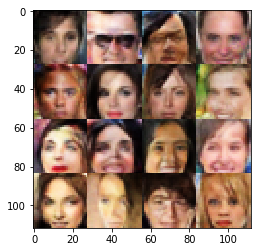

Epoch 23/25... Discriminator Loss: 0.2272... Generator Loss: 2.2309
Epoch 23/25... Discriminator Loss: 0.0990... Generator Loss: 3.1965
Epoch 23/25... Discriminator Loss: 0.2387... Generator Loss: 1.9942
Epoch 23/25... Discriminator Loss: 0.8428... Generator Loss: 0.9511
Epoch 23/25... Discriminator Loss: 0.3127... Generator Loss: 1.8622
Epoch 23/25... Discriminator Loss: 0.3877... Generator Loss: 1.6831
Epoch 23/25... Discriminator Loss: 0.0341... Generator Loss: 4.5931
Epoch 23/25... Discriminator Loss: 1.5810... Generator Loss: 2.1627
Epoch 23/25... Discriminator Loss: 1.4878... Generator Loss: 0.5920
Epoch 23/25... Discriminator Loss: 1.0726... Generator Loss: 1.1629


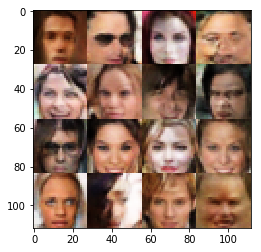

Epoch 23/25... Discriminator Loss: 1.1437... Generator Loss: 2.1632
Epoch 23/25... Discriminator Loss: 0.8525... Generator Loss: 1.1880
Epoch 23/25... Discriminator Loss: 0.7067... Generator Loss: 1.1322
Epoch 23/25... Discriminator Loss: 0.5998... Generator Loss: 1.1861
Epoch 23/25... Discriminator Loss: 0.3499... Generator Loss: 2.4304
Epoch 23/25... Discriminator Loss: 0.1940... Generator Loss: 2.8287
Epoch 23/25... Discriminator Loss: 0.2452... Generator Loss: 2.6053
Epoch 23/25... Discriminator Loss: 2.3162... Generator Loss: 6.1115
Epoch 23/25... Discriminator Loss: 0.5561... Generator Loss: 2.3583
Epoch 23/25... Discriminator Loss: 0.7661... Generator Loss: 2.7119


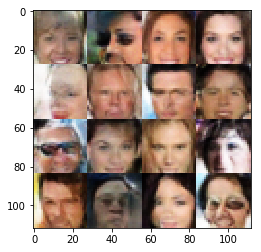

Epoch 23/25... Discriminator Loss: 0.7453... Generator Loss: 0.9581
Epoch 23/25... Discriminator Loss: 0.3411... Generator Loss: 2.3359
Epoch 23/25... Discriminator Loss: 0.3556... Generator Loss: 2.3941
Epoch 23/25... Discriminator Loss: 0.4017... Generator Loss: 1.5944
Epoch 23/25... Discriminator Loss: 0.1786... Generator Loss: 3.2334
Epoch 23/25... Discriminator Loss: 0.9138... Generator Loss: 0.8841
Epoch 23/25... Discriminator Loss: 0.1860... Generator Loss: 3.2465
Epoch 23/25... Discriminator Loss: 1.0838... Generator Loss: 0.8516
Epoch 23/25... Discriminator Loss: 0.8067... Generator Loss: 1.8973
Epoch 23/25... Discriminator Loss: 0.5961... Generator Loss: 2.1777


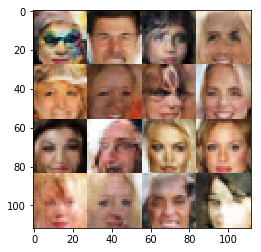

Epoch 23/25... Discriminator Loss: 0.4866... Generator Loss: 2.2716
Epoch 23/25... Discriminator Loss: 0.7364... Generator Loss: 3.6137
Epoch 23/25... Discriminator Loss: 0.4152... Generator Loss: 1.6506
Epoch 23/25... Discriminator Loss: 1.3653... Generator Loss: 0.5510
Epoch 23/25... Discriminator Loss: 0.2794... Generator Loss: 2.2251
Epoch 23/25... Discriminator Loss: 0.2515... Generator Loss: 2.1927
Epoch 23/25... Discriminator Loss: 0.2277... Generator Loss: 2.1567
Epoch 23/25... Discriminator Loss: 0.6964... Generator Loss: 1.1134
Epoch 23/25... Discriminator Loss: 0.1106... Generator Loss: 3.0800
Epoch 23/25... Discriminator Loss: 0.3606... Generator Loss: 1.6953


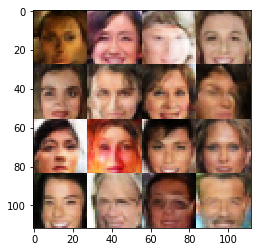

Epoch 23/25... Discriminator Loss: 0.1392... Generator Loss: 2.9051
Epoch 23/25... Discriminator Loss: 0.1373... Generator Loss: 2.8374
Epoch 23/25... Discriminator Loss: 0.6431... Generator Loss: 1.2090
Epoch 23/25... Discriminator Loss: 0.2459... Generator Loss: 2.0768
Epoch 23/25... Discriminator Loss: 0.7444... Generator Loss: 0.9572
Epoch 23/25... Discriminator Loss: 0.1228... Generator Loss: 2.8933
Epoch 23/25... Discriminator Loss: 1.4725... Generator Loss: 0.4443
Epoch 23/25... Discriminator Loss: 0.0819... Generator Loss: 4.4385
Epoch 23/25... Discriminator Loss: 0.4674... Generator Loss: 1.4123
Epoch 23/25... Discriminator Loss: 0.3208... Generator Loss: 1.7930


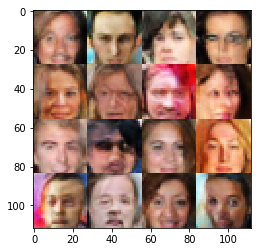

Epoch 23/25... Discriminator Loss: 0.1186... Generator Loss: 2.8218
Epoch 23/25... Discriminator Loss: 0.3279... Generator Loss: 1.7915
Epoch 23/25... Discriminator Loss: 0.3240... Generator Loss: 1.8410
Epoch 23/25... Discriminator Loss: 0.2649... Generator Loss: 2.0051
Epoch 23/25... Discriminator Loss: 0.2761... Generator Loss: 2.0106
Epoch 23/25... Discriminator Loss: 0.7199... Generator Loss: 1.0742
Epoch 23/25... Discriminator Loss: 0.3459... Generator Loss: 1.7702
Epoch 23/25... Discriminator Loss: 0.1099... Generator Loss: 3.2445
Epoch 23/25... Discriminator Loss: 0.5421... Generator Loss: 1.2933
Epoch 23/25... Discriminator Loss: 0.6506... Generator Loss: 1.0930


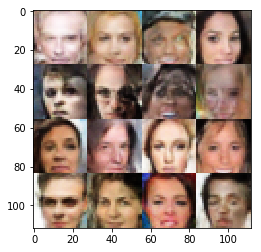

Epoch 23/25... Discriminator Loss: 0.1594... Generator Loss: 2.5897
Epoch 23/25... Discriminator Loss: 0.3173... Generator Loss: 1.6997
Epoch 23/25... Discriminator Loss: 0.1429... Generator Loss: 2.8428
Epoch 23/25... Discriminator Loss: 0.4279... Generator Loss: 1.4575
Epoch 23/25... Discriminator Loss: 0.1209... Generator Loss: 2.8676
Epoch 23/25... Discriminator Loss: 0.1717... Generator Loss: 2.4981
Epoch 23/25... Discriminator Loss: 0.1100... Generator Loss: 3.9970
Epoch 23/25... Discriminator Loss: 0.0841... Generator Loss: 3.4022
Epoch 23/25... Discriminator Loss: 0.0832... Generator Loss: 3.0915
Epoch 23/25... Discriminator Loss: 0.2130... Generator Loss: 2.1021


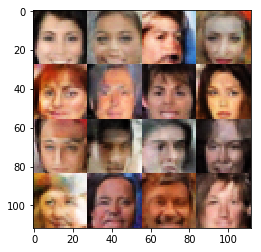

Epoch 23/25... Discriminator Loss: 0.1437... Generator Loss: 2.6403
Epoch 23/25... Discriminator Loss: 0.1969... Generator Loss: 2.3462
Epoch 23/25... Discriminator Loss: 1.4217... Generator Loss: 3.9793
Epoch 23/25... Discriminator Loss: 0.5275... Generator Loss: 1.7535
Epoch 23/25... Discriminator Loss: 0.4573... Generator Loss: 1.4852
Epoch 23/25... Discriminator Loss: 0.4612... Generator Loss: 2.8335
Epoch 23/25... Discriminator Loss: 0.3529... Generator Loss: 2.5154
Epoch 23/25... Discriminator Loss: 0.2365... Generator Loss: 2.6090
Epoch 23/25... Discriminator Loss: 0.1707... Generator Loss: 2.6273
Epoch 23/25... Discriminator Loss: 0.2756... Generator Loss: 3.3982


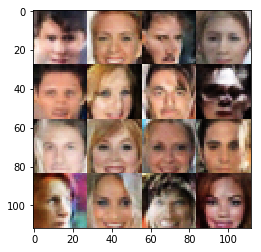

Epoch 23/25... Discriminator Loss: 0.4703... Generator Loss: 1.3513
Epoch 23/25... Discriminator Loss: 0.9673... Generator Loss: 0.7911
Epoch 23/25... Discriminator Loss: 0.3788... Generator Loss: 1.6556
Epoch 23/25... Discriminator Loss: 0.9615... Generator Loss: 0.8855
Epoch 23/25... Discriminator Loss: 0.1757... Generator Loss: 2.4314
Epoch 23/25... Discriminator Loss: 0.1859... Generator Loss: 2.4663
Epoch 23/25... Discriminator Loss: 0.1433... Generator Loss: 3.1075
Epoch 23/25... Discriminator Loss: 0.3374... Generator Loss: 1.8429
Epoch 24/25... Discriminator Loss: 0.3605... Generator Loss: 1.6884
Epoch 24/25... Discriminator Loss: 0.4548... Generator Loss: 1.4631


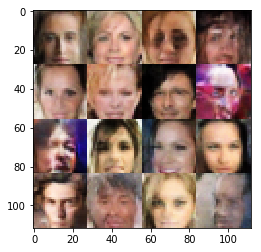

Epoch 24/25... Discriminator Loss: 0.2724... Generator Loss: 1.9239
Epoch 24/25... Discriminator Loss: 0.3507... Generator Loss: 1.6292
Epoch 24/25... Discriminator Loss: 0.1797... Generator Loss: 2.5883
Epoch 24/25... Discriminator Loss: 0.1530... Generator Loss: 2.5160
Epoch 24/25... Discriminator Loss: 0.5711... Generator Loss: 1.1712
Epoch 24/25... Discriminator Loss: 0.1050... Generator Loss: 3.1480
Epoch 24/25... Discriminator Loss: 0.2784... Generator Loss: 1.9164
Epoch 24/25... Discriminator Loss: 0.0729... Generator Loss: 3.0940
Epoch 24/25... Discriminator Loss: 0.0715... Generator Loss: 3.9865
Epoch 24/25... Discriminator Loss: 0.8113... Generator Loss: 4.2391


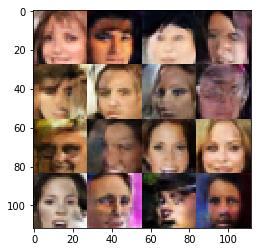

Epoch 24/25... Discriminator Loss: 0.9513... Generator Loss: 1.2011
Epoch 24/25... Discriminator Loss: 0.5714... Generator Loss: 1.9323
Epoch 24/25... Discriminator Loss: 0.4028... Generator Loss: 2.2657
Epoch 24/25... Discriminator Loss: 0.1929... Generator Loss: 2.4960
Epoch 24/25... Discriminator Loss: 0.8754... Generator Loss: 0.9376
Epoch 24/25... Discriminator Loss: 0.1571... Generator Loss: 3.3103
Epoch 24/25... Discriminator Loss: 0.6416... Generator Loss: 1.1687
Epoch 24/25... Discriminator Loss: 0.2391... Generator Loss: 2.1548
Epoch 24/25... Discriminator Loss: 0.4106... Generator Loss: 1.6893
Epoch 24/25... Discriminator Loss: 1.8577... Generator Loss: 0.2844


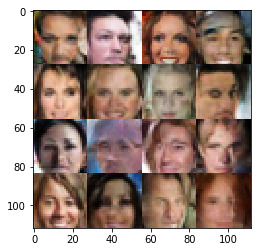

Epoch 24/25... Discriminator Loss: 0.2439... Generator Loss: 2.0736
Epoch 24/25... Discriminator Loss: 0.1565... Generator Loss: 2.5316
Epoch 24/25... Discriminator Loss: 0.6097... Generator Loss: 1.0880
Epoch 24/25... Discriminator Loss: 0.1575... Generator Loss: 2.5518
Epoch 24/25... Discriminator Loss: 0.3760... Generator Loss: 1.7517
Epoch 24/25... Discriminator Loss: 0.2065... Generator Loss: 2.2325
Epoch 24/25... Discriminator Loss: 0.2626... Generator Loss: 2.0304
Epoch 24/25... Discriminator Loss: 0.3626... Generator Loss: 1.7587
Epoch 24/25... Discriminator Loss: 0.1925... Generator Loss: 2.3591
Epoch 24/25... Discriminator Loss: 0.3266... Generator Loss: 1.7954


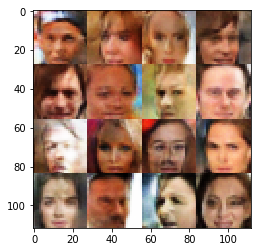

Epoch 24/25... Discriminator Loss: 0.3485... Generator Loss: 1.7446
Epoch 24/25... Discriminator Loss: 0.2477... Generator Loss: 2.1447
Epoch 24/25... Discriminator Loss: 0.2537... Generator Loss: 1.9203
Epoch 24/25... Discriminator Loss: 0.1630... Generator Loss: 2.5990
Epoch 24/25... Discriminator Loss: 0.0774... Generator Loss: 3.4947
Epoch 24/25... Discriminator Loss: 0.1677... Generator Loss: 2.5743
Epoch 24/25... Discriminator Loss: 0.2322... Generator Loss: 2.1323
Epoch 24/25... Discriminator Loss: 1.7591... Generator Loss: 5.6558
Epoch 24/25... Discriminator Loss: 0.3467... Generator Loss: 2.9150
Epoch 24/25... Discriminator Loss: 0.2608... Generator Loss: 2.6560


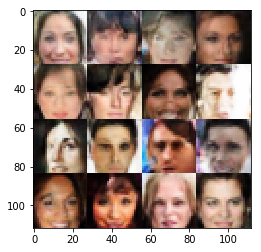

Epoch 24/25... Discriminator Loss: 0.2684... Generator Loss: 2.3375
Epoch 24/25... Discriminator Loss: 0.2559... Generator Loss: 3.0172
Epoch 24/25... Discriminator Loss: 0.2274... Generator Loss: 4.1094
Epoch 24/25... Discriminator Loss: 2.7058... Generator Loss: 0.1904
Epoch 24/25... Discriminator Loss: 0.9458... Generator Loss: 0.9042
Epoch 24/25... Discriminator Loss: 1.0397... Generator Loss: 0.8497
Epoch 24/25... Discriminator Loss: 0.4321... Generator Loss: 1.6000
Epoch 24/25... Discriminator Loss: 0.3246... Generator Loss: 2.5663
Epoch 24/25... Discriminator Loss: 0.9223... Generator Loss: 5.2046
Epoch 24/25... Discriminator Loss: 2.5325... Generator Loss: 0.2763


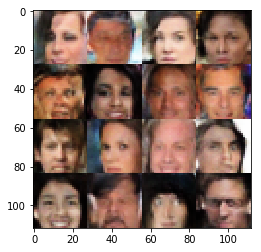

Epoch 24/25... Discriminator Loss: 0.3010... Generator Loss: 2.1626
Epoch 24/25... Discriminator Loss: 0.2510... Generator Loss: 3.6398
Epoch 24/25... Discriminator Loss: 0.2882... Generator Loss: 2.1745
Epoch 24/25... Discriminator Loss: 1.3472... Generator Loss: 0.6534
Epoch 24/25... Discriminator Loss: 0.9924... Generator Loss: 1.3295
Epoch 24/25... Discriminator Loss: 1.1439... Generator Loss: 0.7046
Epoch 24/25... Discriminator Loss: 0.9392... Generator Loss: 1.6282
Epoch 24/25... Discriminator Loss: 0.7865... Generator Loss: 1.1334
Epoch 24/25... Discriminator Loss: 0.7344... Generator Loss: 2.5908
Epoch 24/25... Discriminator Loss: 0.3967... Generator Loss: 2.1335


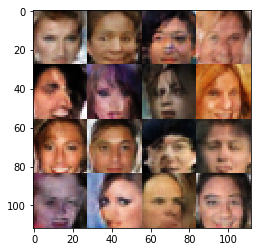

Epoch 24/25... Discriminator Loss: 0.3417... Generator Loss: 2.0616
Epoch 24/25... Discriminator Loss: 0.2018... Generator Loss: 2.4554
Epoch 24/25... Discriminator Loss: 0.3426... Generator Loss: 1.9199
Epoch 24/25... Discriminator Loss: 0.3714... Generator Loss: 1.7084
Epoch 24/25... Discriminator Loss: 1.7874... Generator Loss: 0.3840
Epoch 24/25... Discriminator Loss: 0.8202... Generator Loss: 3.7879
Epoch 24/25... Discriminator Loss: 0.3259... Generator Loss: 2.5172
Epoch 24/25... Discriminator Loss: 0.2838... Generator Loss: 2.2057
Epoch 24/25... Discriminator Loss: 0.4779... Generator Loss: 1.4435
Epoch 24/25... Discriminator Loss: 0.8696... Generator Loss: 0.9998


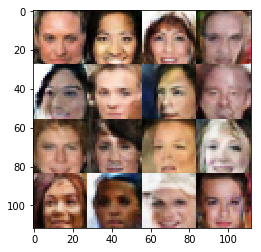

Epoch 24/25... Discriminator Loss: 0.5318... Generator Loss: 1.2532
Epoch 24/25... Discriminator Loss: 0.2183... Generator Loss: 2.3977
Epoch 24/25... Discriminator Loss: 0.1718... Generator Loss: 3.2991
Epoch 24/25... Discriminator Loss: 0.1908... Generator Loss: 2.3955
Epoch 24/25... Discriminator Loss: 0.5088... Generator Loss: 1.3069
Epoch 24/25... Discriminator Loss: 0.6443... Generator Loss: 1.1804
Epoch 24/25... Discriminator Loss: 1.0500... Generator Loss: 0.7013
Epoch 24/25... Discriminator Loss: 0.3800... Generator Loss: 1.6725
Epoch 24/25... Discriminator Loss: 0.4172... Generator Loss: 1.4659
Epoch 24/25... Discriminator Loss: 0.2731... Generator Loss: 4.3712


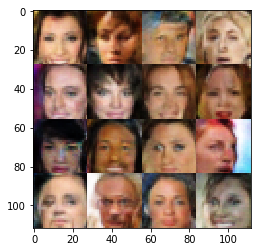

Epoch 24/25... Discriminator Loss: 0.5833... Generator Loss: 1.2881
Epoch 24/25... Discriminator Loss: 0.6489... Generator Loss: 1.0963
Epoch 24/25... Discriminator Loss: 0.1029... Generator Loss: 3.2208
Epoch 24/25... Discriminator Loss: 0.5219... Generator Loss: 1.2415
Epoch 24/25... Discriminator Loss: 0.1462... Generator Loss: 2.9389
Epoch 24/25... Discriminator Loss: 0.7332... Generator Loss: 1.0824
Epoch 24/25... Discriminator Loss: 0.3090... Generator Loss: 1.8650
Epoch 24/25... Discriminator Loss: 0.3370... Generator Loss: 1.7912
Epoch 24/25... Discriminator Loss: 0.1442... Generator Loss: 2.8481
Epoch 24/25... Discriminator Loss: 1.1368... Generator Loss: 0.6400


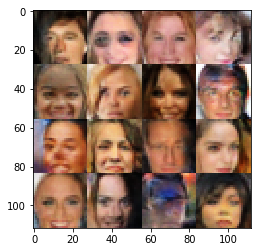

Epoch 24/25... Discriminator Loss: 0.0498... Generator Loss: 3.8975
Epoch 24/25... Discriminator Loss: 0.2322... Generator Loss: 2.1627
Epoch 24/25... Discriminator Loss: 0.1773... Generator Loss: 2.4100
Epoch 24/25... Discriminator Loss: 0.2990... Generator Loss: 1.9760
Epoch 24/25... Discriminator Loss: 0.1025... Generator Loss: 3.0805
Epoch 24/25... Discriminator Loss: 0.5302... Generator Loss: 1.2886
Epoch 24/25... Discriminator Loss: 0.3265... Generator Loss: 1.9086
Epoch 24/25... Discriminator Loss: 0.1228... Generator Loss: 3.2206
Epoch 24/25... Discriminator Loss: 0.3197... Generator Loss: 1.7393
Epoch 24/25... Discriminator Loss: 0.3167... Generator Loss: 1.7564


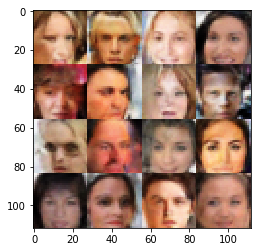

Epoch 24/25... Discriminator Loss: 0.3231... Generator Loss: 1.7405
Epoch 24/25... Discriminator Loss: 0.5560... Generator Loss: 1.2052
Epoch 24/25... Discriminator Loss: 0.2376... Generator Loss: 2.2068
Epoch 24/25... Discriminator Loss: 0.3756... Generator Loss: 1.6822
Epoch 24/25... Discriminator Loss: 0.2212... Generator Loss: 2.1550
Epoch 24/25... Discriminator Loss: 0.2600... Generator Loss: 2.0398
Epoch 24/25... Discriminator Loss: 0.1062... Generator Loss: 3.0455
Epoch 24/25... Discriminator Loss: 0.2853... Generator Loss: 1.7908
Epoch 24/25... Discriminator Loss: 0.3564... Generator Loss: 1.6505
Epoch 24/25... Discriminator Loss: 0.1565... Generator Loss: 2.5928


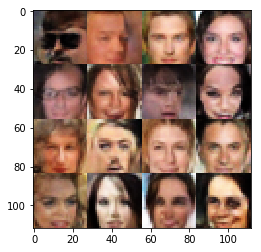

Epoch 24/25... Discriminator Loss: 0.1469... Generator Loss: 2.6293
Epoch 24/25... Discriminator Loss: 0.2945... Generator Loss: 1.8238
Epoch 24/25... Discriminator Loss: 1.1081... Generator Loss: 0.6794
Epoch 24/25... Discriminator Loss: 0.4613... Generator Loss: 1.9090
Epoch 24/25... Discriminator Loss: 0.3575... Generator Loss: 2.3497
Epoch 24/25... Discriminator Loss: 0.3515... Generator Loss: 2.1143
Epoch 24/25... Discriminator Loss: 0.1639... Generator Loss: 3.1936
Epoch 24/25... Discriminator Loss: 0.2344... Generator Loss: 2.4459
Epoch 24/25... Discriminator Loss: 0.1732... Generator Loss: 2.7173
Epoch 24/25... Discriminator Loss: 0.2703... Generator Loss: 2.1914


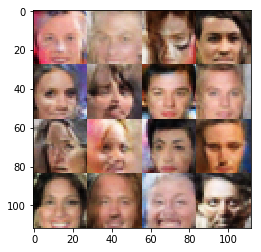

Epoch 24/25... Discriminator Loss: 0.1799... Generator Loss: 3.3189
Epoch 24/25... Discriminator Loss: 0.0934... Generator Loss: 3.3040
Epoch 24/25... Discriminator Loss: 0.2720... Generator Loss: 1.9954
Epoch 24/25... Discriminator Loss: 0.3506... Generator Loss: 1.8237
Epoch 24/25... Discriminator Loss: 0.2096... Generator Loss: 2.4369
Epoch 24/25... Discriminator Loss: 0.3064... Generator Loss: 1.8506
Epoch 24/25... Discriminator Loss: 0.1258... Generator Loss: 2.8282
Epoch 24/25... Discriminator Loss: 0.1568... Generator Loss: 2.6540
Epoch 24/25... Discriminator Loss: 0.3401... Generator Loss: 1.8689
Epoch 24/25... Discriminator Loss: 0.2544... Generator Loss: 2.0843


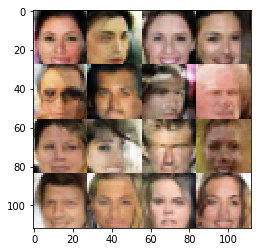

Epoch 24/25... Discriminator Loss: 0.2747... Generator Loss: 1.8618
Epoch 24/25... Discriminator Loss: 0.0822... Generator Loss: 3.3558
Epoch 24/25... Discriminator Loss: 0.1246... Generator Loss: 2.7729
Epoch 24/25... Discriminator Loss: 0.4277... Generator Loss: 1.6129
Epoch 24/25... Discriminator Loss: 0.1485... Generator Loss: 2.6139
Epoch 24/25... Discriminator Loss: 0.7814... Generator Loss: 1.0045
Epoch 24/25... Discriminator Loss: 0.1752... Generator Loss: 2.5004
Epoch 24/25... Discriminator Loss: 0.2393... Generator Loss: 2.0605
Epoch 24/25... Discriminator Loss: 0.3076... Generator Loss: 1.8300
Epoch 24/25... Discriminator Loss: 0.3765... Generator Loss: 1.5925


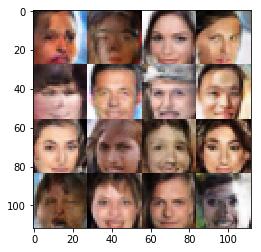

Epoch 24/25... Discriminator Loss: 0.1147... Generator Loss: 3.1419
Epoch 24/25... Discriminator Loss: 0.0639... Generator Loss: 3.5629
Epoch 24/25... Discriminator Loss: 0.4681... Generator Loss: 1.4535
Epoch 24/25... Discriminator Loss: 0.1388... Generator Loss: 2.5278
Epoch 24/25... Discriminator Loss: 0.3409... Generator Loss: 1.7410
Epoch 24/25... Discriminator Loss: 0.2360... Generator Loss: 2.0812
Epoch 24/25... Discriminator Loss: 0.2799... Generator Loss: 1.8783
Epoch 24/25... Discriminator Loss: 0.1223... Generator Loss: 2.7529
Epoch 24/25... Discriminator Loss: 0.3637... Generator Loss: 1.6715
Epoch 24/25... Discriminator Loss: 0.4279... Generator Loss: 1.5711


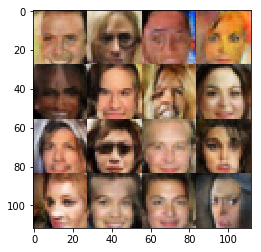

Epoch 24/25... Discriminator Loss: 0.1859... Generator Loss: 2.4190
Epoch 24/25... Discriminator Loss: 0.1068... Generator Loss: 2.9566
Epoch 24/25... Discriminator Loss: 0.1517... Generator Loss: 2.5708
Epoch 24/25... Discriminator Loss: 0.3436... Generator Loss: 1.7376
Epoch 24/25... Discriminator Loss: 0.2146... Generator Loss: 2.2829
Epoch 24/25... Discriminator Loss: 0.2080... Generator Loss: 2.2077
Epoch 25/25... Discriminator Loss: 0.2242... Generator Loss: 2.1485
Epoch 25/25... Discriminator Loss: 0.4545... Generator Loss: 1.5947
Epoch 25/25... Discriminator Loss: 0.1863... Generator Loss: 2.3373
Epoch 25/25... Discriminator Loss: 0.0707... Generator Loss: 3.3964


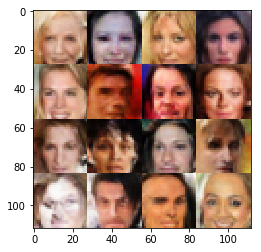

Epoch 25/25... Discriminator Loss: 0.1380... Generator Loss: 2.6874
Epoch 25/25... Discriminator Loss: 0.1097... Generator Loss: 2.9046
Epoch 25/25... Discriminator Loss: 0.3150... Generator Loss: 1.9059
Epoch 25/25... Discriminator Loss: 0.2614... Generator Loss: 1.9350
Epoch 25/25... Discriminator Loss: 0.2737... Generator Loss: 1.9828
Epoch 25/25... Discriminator Loss: 0.1134... Generator Loss: 2.8647
Epoch 25/25... Discriminator Loss: 0.3955... Generator Loss: 1.6551
Epoch 25/25... Discriminator Loss: 0.0146... Generator Loss: 5.8290
Epoch 25/25... Discriminator Loss: 3.7916... Generator Loss: 0.0831
Epoch 25/25... Discriminator Loss: 1.1519... Generator Loss: 0.6189


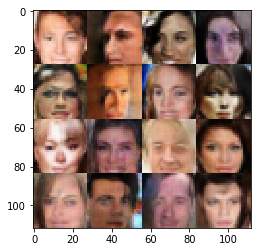

Epoch 25/25... Discriminator Loss: 0.6772... Generator Loss: 1.3107
Epoch 25/25... Discriminator Loss: 0.3479... Generator Loss: 1.9641
Epoch 25/25... Discriminator Loss: 0.2388... Generator Loss: 2.8189
Epoch 25/25... Discriminator Loss: 0.2454... Generator Loss: 2.6667
Epoch 25/25... Discriminator Loss: 0.4655... Generator Loss: 1.3585
Epoch 25/25... Discriminator Loss: 0.2679... Generator Loss: 2.4867
Epoch 25/25... Discriminator Loss: 1.3683... Generator Loss: 0.5613
Epoch 25/25... Discriminator Loss: 0.2324... Generator Loss: 2.4821
Epoch 25/25... Discriminator Loss: 0.2447... Generator Loss: 2.0108
Epoch 25/25... Discriminator Loss: 1.4760... Generator Loss: 0.5045


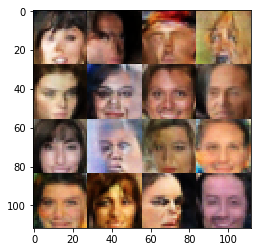

Epoch 25/25... Discriminator Loss: 0.4986... Generator Loss: 2.4537
Epoch 25/25... Discriminator Loss: 0.2489... Generator Loss: 3.1825
Epoch 25/25... Discriminator Loss: 0.2332... Generator Loss: 3.6782
Epoch 25/25... Discriminator Loss: 0.6209... Generator Loss: 1.2491
Epoch 25/25... Discriminator Loss: 0.3345... Generator Loss: 1.9055
Epoch 25/25... Discriminator Loss: 0.3621... Generator Loss: 1.7139
Epoch 25/25... Discriminator Loss: 1.2412... Generator Loss: 0.6301
Epoch 25/25... Discriminator Loss: 0.2722... Generator Loss: 2.0472
Epoch 25/25... Discriminator Loss: 0.4745... Generator Loss: 1.4496
Epoch 25/25... Discriminator Loss: 0.4045... Generator Loss: 1.5501


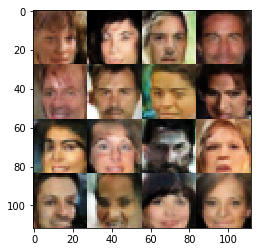

Epoch 25/25... Discriminator Loss: 0.1819... Generator Loss: 2.4432
Epoch 25/25... Discriminator Loss: 0.4502... Generator Loss: 1.5326
Epoch 25/25... Discriminator Loss: 0.1489... Generator Loss: 2.6183
Epoch 25/25... Discriminator Loss: 0.1780... Generator Loss: 2.6574
Epoch 25/25... Discriminator Loss: 0.3179... Generator Loss: 1.7932
Epoch 25/25... Discriminator Loss: 0.2911... Generator Loss: 2.0454
Epoch 25/25... Discriminator Loss: 0.2844... Generator Loss: 1.8932
Epoch 25/25... Discriminator Loss: 0.3995... Generator Loss: 1.5798
Epoch 25/25... Discriminator Loss: 0.2887... Generator Loss: 1.8906
Epoch 25/25... Discriminator Loss: 0.3107... Generator Loss: 1.7894


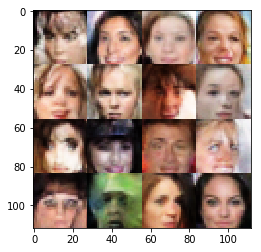

Epoch 25/25... Discriminator Loss: 0.1910... Generator Loss: 2.3179
Epoch 25/25... Discriminator Loss: 0.3622... Generator Loss: 1.6702
Epoch 25/25... Discriminator Loss: 0.3346... Generator Loss: 1.7013
Epoch 25/25... Discriminator Loss: 0.1908... Generator Loss: 2.5461
Epoch 25/25... Discriminator Loss: 0.3705... Generator Loss: 1.7754
Epoch 25/25... Discriminator Loss: 0.5231... Generator Loss: 1.3168
Epoch 25/25... Discriminator Loss: 0.4739... Generator Loss: 1.4508
Epoch 25/25... Discriminator Loss: 0.4307... Generator Loss: 1.4931
Epoch 25/25... Discriminator Loss: 0.1093... Generator Loss: 2.8247
Epoch 25/25... Discriminator Loss: 0.2425... Generator Loss: 2.0238


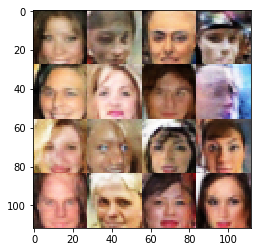

Epoch 25/25... Discriminator Loss: 0.0980... Generator Loss: 2.9731
Epoch 25/25... Discriminator Loss: 0.3796... Generator Loss: 1.6570
Epoch 25/25... Discriminator Loss: 0.4329... Generator Loss: 1.4953
Epoch 25/25... Discriminator Loss: 1.1088... Generator Loss: 0.6562
Epoch 25/25... Discriminator Loss: 0.2058... Generator Loss: 2.1946
Epoch 25/25... Discriminator Loss: 0.3592... Generator Loss: 1.6832
Epoch 25/25... Discriminator Loss: 0.1286... Generator Loss: 2.7353
Epoch 25/25... Discriminator Loss: 0.1305... Generator Loss: 2.7757
Epoch 25/25... Discriminator Loss: 0.1878... Generator Loss: 2.4270
Epoch 25/25... Discriminator Loss: 0.1408... Generator Loss: 2.5400


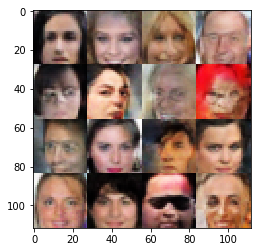

Epoch 25/25... Discriminator Loss: 0.2268... Generator Loss: 2.2603
Epoch 25/25... Discriminator Loss: 0.1773... Generator Loss: 2.6269
Epoch 25/25... Discriminator Loss: 0.1885... Generator Loss: 2.4485
Epoch 25/25... Discriminator Loss: 0.0838... Generator Loss: 3.6022
Epoch 25/25... Discriminator Loss: 0.1318... Generator Loss: 2.7176
Epoch 25/25... Discriminator Loss: 0.5061... Generator Loss: 1.3665
Epoch 25/25... Discriminator Loss: 0.1183... Generator Loss: 2.8852
Epoch 25/25... Discriminator Loss: 0.3205... Generator Loss: 1.8222
Epoch 25/25... Discriminator Loss: 0.3154... Generator Loss: 1.8335
Epoch 25/25... Discriminator Loss: 2.2423... Generator Loss: 2.9808


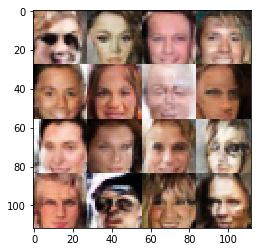

Epoch 25/25... Discriminator Loss: 1.2851... Generator Loss: 1.3145
Epoch 25/25... Discriminator Loss: 0.9879... Generator Loss: 0.9023
Epoch 25/25... Discriminator Loss: 0.7827... Generator Loss: 1.0609
Epoch 25/25... Discriminator Loss: 0.9427... Generator Loss: 1.5271
Epoch 25/25... Discriminator Loss: 0.7891... Generator Loss: 3.0222
Epoch 25/25... Discriminator Loss: 0.4265... Generator Loss: 1.6647
Epoch 25/25... Discriminator Loss: 0.3822... Generator Loss: 1.7620
Epoch 25/25... Discriminator Loss: 1.7325... Generator Loss: 0.3425
Epoch 25/25... Discriminator Loss: 0.4447... Generator Loss: 1.5198
Epoch 25/25... Discriminator Loss: 0.3534... Generator Loss: 1.7254


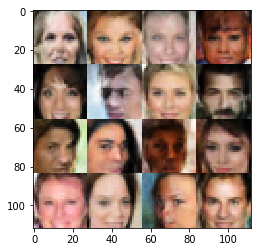

Epoch 25/25... Discriminator Loss: 0.7553... Generator Loss: 1.1115
Epoch 25/25... Discriminator Loss: 0.5472... Generator Loss: 1.3668
Epoch 25/25... Discriminator Loss: 1.4116... Generator Loss: 2.4152
Epoch 25/25... Discriminator Loss: 0.7325... Generator Loss: 1.3965
Epoch 25/25... Discriminator Loss: 0.6408... Generator Loss: 1.2135
Epoch 25/25... Discriminator Loss: 0.3912... Generator Loss: 1.8705
Epoch 25/25... Discriminator Loss: 0.3844... Generator Loss: 1.7309
Epoch 25/25... Discriminator Loss: 0.2153... Generator Loss: 2.9732
Epoch 25/25... Discriminator Loss: 0.3181... Generator Loss: 1.9373
Epoch 25/25... Discriminator Loss: 0.4174... Generator Loss: 1.6850


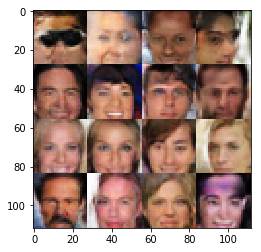

Epoch 25/25... Discriminator Loss: 0.3121... Generator Loss: 1.9593
Epoch 25/25... Discriminator Loss: 0.5039... Generator Loss: 1.3894
Epoch 25/25... Discriminator Loss: 0.2920... Generator Loss: 1.9841
Epoch 25/25... Discriminator Loss: 0.8158... Generator Loss: 0.9416
Epoch 25/25... Discriminator Loss: 0.1523... Generator Loss: 2.6473
Epoch 25/25... Discriminator Loss: 0.4099... Generator Loss: 1.5420
Epoch 25/25... Discriminator Loss: 0.2940... Generator Loss: 2.0298
Epoch 25/25... Discriminator Loss: 0.3541... Generator Loss: 1.7136
Epoch 25/25... Discriminator Loss: 3.1573... Generator Loss: 0.1157
Epoch 25/25... Discriminator Loss: 1.0062... Generator Loss: 2.0095


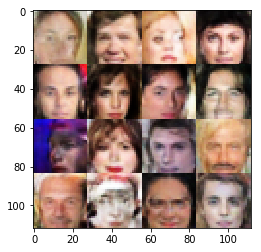

Epoch 25/25... Discriminator Loss: 0.5529... Generator Loss: 1.5596
Epoch 25/25... Discriminator Loss: 0.2719... Generator Loss: 2.5907
Epoch 25/25... Discriminator Loss: 0.5343... Generator Loss: 2.8848
Epoch 25/25... Discriminator Loss: 0.1650... Generator Loss: 2.9239
Epoch 25/25... Discriminator Loss: 1.4369... Generator Loss: 0.5822
Epoch 25/25... Discriminator Loss: 0.3624... Generator Loss: 1.8528
Epoch 25/25... Discriminator Loss: 0.1510... Generator Loss: 2.8153
Epoch 25/25... Discriminator Loss: 0.1890... Generator Loss: 2.4018
Epoch 25/25... Discriminator Loss: 1.0630... Generator Loss: 0.7258
Epoch 25/25... Discriminator Loss: 0.2716... Generator Loss: 1.9533


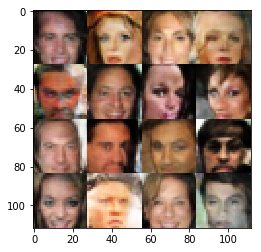

Epoch 25/25... Discriminator Loss: 0.9603... Generator Loss: 0.8544
Epoch 25/25... Discriminator Loss: 1.0944... Generator Loss: 1.6414
Epoch 25/25... Discriminator Loss: 0.4748... Generator Loss: 2.1662
Epoch 25/25... Discriminator Loss: 0.2617... Generator Loss: 2.3973
Epoch 25/25... Discriminator Loss: 0.4301... Generator Loss: 1.5033
Epoch 25/25... Discriminator Loss: 0.5604... Generator Loss: 1.3593
Epoch 25/25... Discriminator Loss: 0.6702... Generator Loss: 1.0164
Epoch 25/25... Discriminator Loss: 0.6585... Generator Loss: 1.1778
Epoch 25/25... Discriminator Loss: 0.1445... Generator Loss: 2.7648
Epoch 25/25... Discriminator Loss: 0.7140... Generator Loss: 1.1350


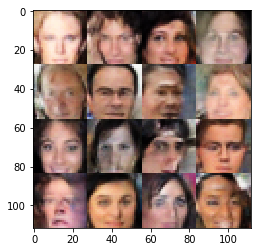

Epoch 25/25... Discriminator Loss: 0.4345... Generator Loss: 1.5738
Epoch 25/25... Discriminator Loss: 0.4002... Generator Loss: 1.9631
Epoch 25/25... Discriminator Loss: 0.2916... Generator Loss: 2.9552
Epoch 25/25... Discriminator Loss: 0.2703... Generator Loss: 3.3858
Epoch 25/25... Discriminator Loss: 0.1920... Generator Loss: 2.6426
Epoch 25/25... Discriminator Loss: 0.2568... Generator Loss: 2.4907
Epoch 25/25... Discriminator Loss: 0.9068... Generator Loss: 0.9086
Epoch 25/25... Discriminator Loss: 0.3089... Generator Loss: 1.9721
Epoch 25/25... Discriminator Loss: 0.4103... Generator Loss: 1.6291
Epoch 25/25... Discriminator Loss: 0.3965... Generator Loss: 1.6214


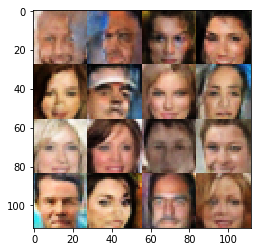

Epoch 25/25... Discriminator Loss: 0.3318... Generator Loss: 1.9065
Epoch 25/25... Discriminator Loss: 0.2118... Generator Loss: 2.1840
Epoch 25/25... Discriminator Loss: 0.1403... Generator Loss: 2.7461
Epoch 25/25... Discriminator Loss: 0.3095... Generator Loss: 1.7977
Epoch 25/25... Discriminator Loss: 0.0893... Generator Loss: 3.3839
Epoch 25/25... Discriminator Loss: 0.1334... Generator Loss: 2.7930
Epoch 25/25... Discriminator Loss: 0.3010... Generator Loss: 1.7962
Epoch 25/25... Discriminator Loss: 0.0940... Generator Loss: 3.0407
Epoch 25/25... Discriminator Loss: 0.1096... Generator Loss: 2.7745
Epoch 25/25... Discriminator Loss: 0.0718... Generator Loss: 3.6000


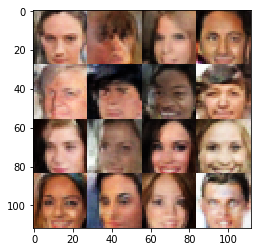

Epoch 25/25... Discriminator Loss: 0.2335... Generator Loss: 2.1523
Epoch 25/25... Discriminator Loss: 0.1629... Generator Loss: 2.8074
Epoch 25/25... Discriminator Loss: 0.1173... Generator Loss: 2.9792
Epoch 25/25... Discriminator Loss: 0.3363... Generator Loss: 1.7298
Epoch 25/25... Discriminator Loss: 0.1060... Generator Loss: 3.2037
Epoch 25/25... Discriminator Loss: 0.1535... Generator Loss: 2.6082
Epoch 25/25... Discriminator Loss: 0.2967... Generator Loss: 1.9112
Epoch 25/25... Discriminator Loss: 0.2445... Generator Loss: 2.1151
Epoch 25/25... Discriminator Loss: 0.1735... Generator Loss: 2.4322
Epoch 25/25... Discriminator Loss: 0.2563... Generator Loss: 2.0574


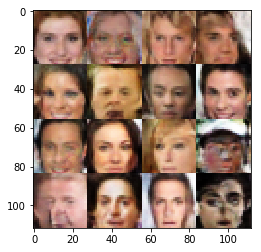

Epoch 25/25... Discriminator Loss: 0.2014... Generator Loss: 2.2758
Epoch 25/25... Discriminator Loss: 0.1499... Generator Loss: 2.7464
Epoch 25/25... Discriminator Loss: 0.1703... Generator Loss: 2.4385
Epoch 25/25... Discriminator Loss: 0.0990... Generator Loss: 3.0351
Epoch 25/25... Discriminator Loss: 0.1571... Generator Loss: 2.4704


In [ ]:
batch_size = 128
z_dim = 100
learning_rate = 0.0002
beta1 = 0.5


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
epochs = 25

celeba_dataset = helper.Dataset('celeba', glob(os.path.join(data_dir, 'img_align_celeba/*.jpg')))
with tf.Graph().as_default():
    train(epochs, batch_size, z_dim, learning_rate, beta1, celeba_dataset.get_batches,
          celeba_dataset.shape, celeba_dataset.image_mode)

Epoch 1/50... Discriminator Loss: 0.2060... Generator Loss: 2.4033
Epoch 1/50... Discriminator Loss: 0.3241... Generator Loss: 1.8473
Epoch 1/50... Discriminator Loss: 0.2090... Generator Loss: 2.3226
Epoch 1/50... Discriminator Loss: 0.1047... Generator Loss: 3.1427
Epoch 1/50... Discriminator Loss: 0.4248... Generator Loss: 3.7299
Epoch 1/50... Discriminator Loss: 1.2260... Generator Loss: 5.5000
Epoch 1/50... Discriminator Loss: 1.2948... Generator Loss: 0.4476
Epoch 1/50... Discriminator Loss: 0.6321... Generator Loss: 2.2522
Epoch 1/50... Discriminator Loss: 0.7088... Generator Loss: 1.3573
Epoch 1/50... Discriminator Loss: 0.8265... Generator Loss: 3.0801


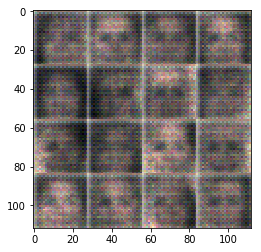

Epoch 1/50... Discriminator Loss: 0.5886... Generator Loss: 2.1132
Epoch 1/50... Discriminator Loss: 0.7396... Generator Loss: 0.9115
Epoch 1/50... Discriminator Loss: 0.6893... Generator Loss: 0.9627
Epoch 1/50... Discriminator Loss: 0.4808... Generator Loss: 1.8232
Epoch 1/50... Discriminator Loss: 1.8503... Generator Loss: 5.5314
Epoch 1/50... Discriminator Loss: 0.7992... Generator Loss: 0.8956
Epoch 1/50... Discriminator Loss: 0.5712... Generator Loss: 1.8560
Epoch 1/50... Discriminator Loss: 0.8789... Generator Loss: 0.7404
Epoch 1/50... Discriminator Loss: 0.6418... Generator Loss: 1.5865
Epoch 1/50... Discriminator Loss: 0.4715... Generator Loss: 1.6238


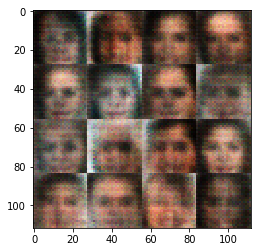

Epoch 1/50... Discriminator Loss: 0.4820... Generator Loss: 1.5316
Epoch 1/50... Discriminator Loss: 0.4744... Generator Loss: 1.9913
Epoch 1/50... Discriminator Loss: 0.6944... Generator Loss: 2.2430
Epoch 1/50... Discriminator Loss: 1.1266... Generator Loss: 0.6446
Epoch 1/50... Discriminator Loss: 0.6711... Generator Loss: 1.9227
Epoch 1/50... Discriminator Loss: 0.8532... Generator Loss: 2.3674
Epoch 1/50... Discriminator Loss: 0.9286... Generator Loss: 0.8739
Epoch 1/50... Discriminator Loss: 0.8013... Generator Loss: 0.8685
Epoch 1/50... Discriminator Loss: 0.7968... Generator Loss: 1.5922
Epoch 1/50... Discriminator Loss: 0.6052... Generator Loss: 1.2761


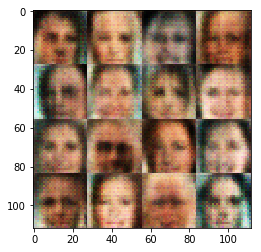

Epoch 1/50... Discriminator Loss: 0.8541... Generator Loss: 0.8013
Epoch 1/50... Discriminator Loss: 1.9906... Generator Loss: 0.2463
Epoch 1/50... Discriminator Loss: 0.9672... Generator Loss: 0.7495
Epoch 1/50... Discriminator Loss: 1.3258... Generator Loss: 0.4726
Epoch 1/50... Discriminator Loss: 0.9674... Generator Loss: 0.7854
Epoch 1/50... Discriminator Loss: 1.1264... Generator Loss: 1.5890
Epoch 1/50... Discriminator Loss: 0.7428... Generator Loss: 1.1138
Epoch 1/50... Discriminator Loss: 0.7926... Generator Loss: 1.1120
Epoch 1/50... Discriminator Loss: 0.7589... Generator Loss: 1.0661
Epoch 1/50... Discriminator Loss: 0.8308... Generator Loss: 1.1735


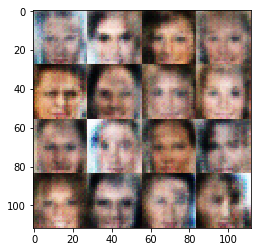

Epoch 1/50... Discriminator Loss: 1.3536... Generator Loss: 0.7625
Epoch 1/50... Discriminator Loss: 1.0297... Generator Loss: 1.2721
Epoch 1/50... Discriminator Loss: 1.6607... Generator Loss: 0.3094
Epoch 1/50... Discriminator Loss: 1.0102... Generator Loss: 0.8584
Epoch 1/50... Discriminator Loss: 1.1603... Generator Loss: 1.5642
Epoch 1/50... Discriminator Loss: 1.1239... Generator Loss: 1.2955
Epoch 1/50... Discriminator Loss: 0.8896... Generator Loss: 1.1061
Epoch 1/50... Discriminator Loss: 0.9160... Generator Loss: 1.2211
Epoch 1/50... Discriminator Loss: 1.0494... Generator Loss: 0.7984
Epoch 1/50... Discriminator Loss: 0.9929... Generator Loss: 1.7525


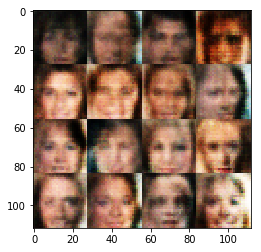

Epoch 1/50... Discriminator Loss: 1.2208... Generator Loss: 0.6053
Epoch 1/50... Discriminator Loss: 0.9686... Generator Loss: 0.9106
Epoch 1/50... Discriminator Loss: 0.8883... Generator Loss: 1.0736
Epoch 1/50... Discriminator Loss: 1.0380... Generator Loss: 0.7902
Epoch 1/50... Discriminator Loss: 0.7897... Generator Loss: 1.3921
Epoch 1/50... Discriminator Loss: 1.1099... Generator Loss: 1.5829
Epoch 1/50... Discriminator Loss: 0.8750... Generator Loss: 1.1045
Epoch 1/50... Discriminator Loss: 0.9998... Generator Loss: 1.5145
Epoch 1/50... Discriminator Loss: 0.8096... Generator Loss: 1.3113
Epoch 1/50... Discriminator Loss: 1.0057... Generator Loss: 1.8674


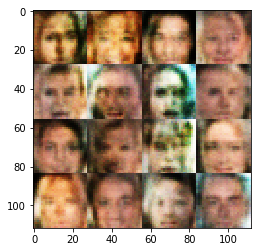

Epoch 1/50... Discriminator Loss: 1.0245... Generator Loss: 0.9333
Epoch 1/50... Discriminator Loss: 0.8587... Generator Loss: 1.7961
Epoch 1/50... Discriminator Loss: 1.1345... Generator Loss: 0.6460
Epoch 1/50... Discriminator Loss: 1.0332... Generator Loss: 1.1140
Epoch 1/50... Discriminator Loss: 0.8418... Generator Loss: 1.0960
Epoch 1/50... Discriminator Loss: 0.9859... Generator Loss: 1.5491
Epoch 1/50... Discriminator Loss: 1.2519... Generator Loss: 2.1491
Epoch 1/50... Discriminator Loss: 1.0072... Generator Loss: 0.8948
Epoch 1/50... Discriminator Loss: 0.7675... Generator Loss: 1.4187
Epoch 1/50... Discriminator Loss: 0.9894... Generator Loss: 1.0707


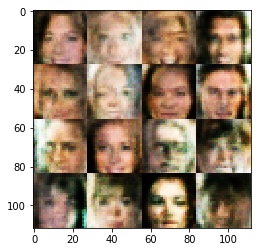

Epoch 1/50... Discriminator Loss: 0.8116... Generator Loss: 1.3161
Epoch 1/50... Discriminator Loss: 0.7590... Generator Loss: 1.1033
Epoch 1/50... Discriminator Loss: 0.8849... Generator Loss: 1.1994
Epoch 1/50... Discriminator Loss: 0.8419... Generator Loss: 1.0174
Epoch 1/50... Discriminator Loss: 1.0683... Generator Loss: 0.6354
Epoch 1/50... Discriminator Loss: 0.9626... Generator Loss: 0.6838
Epoch 1/50... Discriminator Loss: 0.7220... Generator Loss: 1.0646
Epoch 1/50... Discriminator Loss: 0.9576... Generator Loss: 0.6858
Epoch 1/50... Discriminator Loss: 0.8947... Generator Loss: 1.4111
Epoch 1/50... Discriminator Loss: 0.8303... Generator Loss: 0.9959


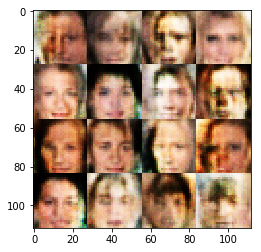

Epoch 1/50... Discriminator Loss: 0.8794... Generator Loss: 0.8565
Epoch 1/50... Discriminator Loss: 0.8300... Generator Loss: 1.5510
Epoch 1/50... Discriminator Loss: 0.8483... Generator Loss: 1.1310
Epoch 1/50... Discriminator Loss: 0.8537... Generator Loss: 0.9610
Epoch 1/50... Discriminator Loss: 0.6199... Generator Loss: 1.2644
Epoch 1/50... Discriminator Loss: 0.7365... Generator Loss: 1.0430
Epoch 1/50... Discriminator Loss: 1.7769... Generator Loss: 0.2584
Epoch 1/50... Discriminator Loss: 0.5175... Generator Loss: 1.4302
Epoch 1/50... Discriminator Loss: 0.8222... Generator Loss: 2.4665
Epoch 1/50... Discriminator Loss: 0.8883... Generator Loss: 0.7029


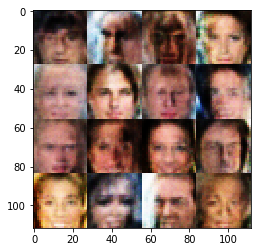

Epoch 1/50... Discriminator Loss: 0.5202... Generator Loss: 1.2784
Epoch 1/50... Discriminator Loss: 0.5181... Generator Loss: 1.1468
Epoch 1/50... Discriminator Loss: 1.5354... Generator Loss: 0.3327
Epoch 1/50... Discriminator Loss: 0.1903... Generator Loss: 3.0514
Epoch 1/50... Discriminator Loss: 0.3307... Generator Loss: 4.5905
Epoch 1/50... Discriminator Loss: 0.2255... Generator Loss: 4.3061
Epoch 1/50... Discriminator Loss: 0.9901... Generator Loss: 0.6334
Epoch 1/50... Discriminator Loss: 0.3246... Generator Loss: 1.8011
Epoch 1/50... Discriminator Loss: 0.2559... Generator Loss: 4.3370
Epoch 1/50... Discriminator Loss: 0.4922... Generator Loss: 1.1787


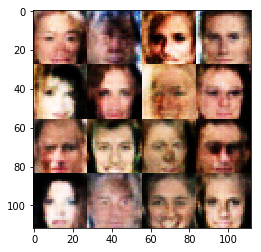

Epoch 1/50... Discriminator Loss: 0.1604... Generator Loss: 3.8574
Epoch 1/50... Discriminator Loss: 1.0465... Generator Loss: 0.5826
Epoch 1/50... Discriminator Loss: 1.2676... Generator Loss: 11.1721
Epoch 1/50... Discriminator Loss: 1.0625... Generator Loss: 3.5373
Epoch 1/50... Discriminator Loss: 1.5998... Generator Loss: 5.8752
Epoch 1/50... Discriminator Loss: 0.4206... Generator Loss: 7.0243
Epoch 1/50... Discriminator Loss: 0.1747... Generator Loss: 8.2494
Epoch 1/50... Discriminator Loss: 0.8016... Generator Loss: 0.7172
Epoch 1/50... Discriminator Loss: 0.7031... Generator Loss: 4.7420
Epoch 1/50... Discriminator Loss: 0.1910... Generator Loss: 7.2219


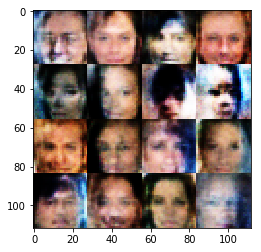

Epoch 1/50... Discriminator Loss: 0.2378... Generator Loss: 1.9205
Epoch 1/50... Discriminator Loss: 1.1036... Generator Loss: 0.5154
Epoch 1/50... Discriminator Loss: 0.1973... Generator Loss: 3.3142
Epoch 1/50... Discriminator Loss: 0.1417... Generator Loss: 4.3777
Epoch 1/50... Discriminator Loss: 0.1136... Generator Loss: 4.7697
Epoch 1/50... Discriminator Loss: 0.1982... Generator Loss: 2.3409
Epoch 1/50... Discriminator Loss: 0.2249... Generator Loss: 6.2528
Epoch 1/50... Discriminator Loss: 0.6997... Generator Loss: 0.8865
Epoch 1/50... Discriminator Loss: 0.6029... Generator Loss: 1.1963
Epoch 1/50... Discriminator Loss: 0.3556... Generator Loss: 7.5712


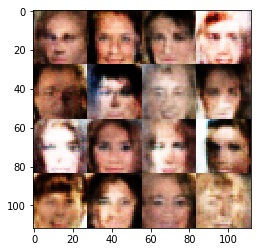

Epoch 1/50... Discriminator Loss: 0.8287... Generator Loss: 0.7149
Epoch 1/50... Discriminator Loss: 0.0568... Generator Loss: 5.2173
Epoch 1/50... Discriminator Loss: 0.2239... Generator Loss: 4.1816
Epoch 1/50... Discriminator Loss: 0.8574... Generator Loss: 10.1834
Epoch 1/50... Discriminator Loss: 0.3748... Generator Loss: 1.5795
Epoch 1/50... Discriminator Loss: 0.2418... Generator Loss: 1.9771
Epoch 1/50... Discriminator Loss: 1.1973... Generator Loss: 0.4727
Epoch 1/50... Discriminator Loss: 0.8294... Generator Loss: 0.7294
Epoch 1/50... Discriminator Loss: 0.4472... Generator Loss: 1.3174
Epoch 1/50... Discriminator Loss: 0.2976... Generator Loss: 1.7211


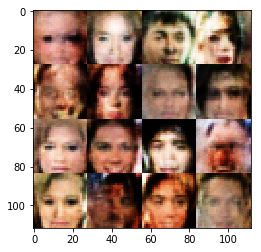

Epoch 1/50... Discriminator Loss: 0.2451... Generator Loss: 2.0846
Epoch 1/50... Discriminator Loss: 0.0520... Generator Loss: 4.4164
Epoch 1/50... Discriminator Loss: 0.1337... Generator Loss: 2.7262
Epoch 1/50... Discriminator Loss: 0.3089... Generator Loss: 1.8344
Epoch 1/50... Discriminator Loss: 0.0639... Generator Loss: 4.1292
Epoch 1/50... Discriminator Loss: 1.6455... Generator Loss: 7.6869
Epoch 1/50... Discriminator Loss: 1.2398... Generator Loss: 0.4400
Epoch 1/50... Discriminator Loss: 0.1645... Generator Loss: 2.6722
Epoch 1/50... Discriminator Loss: 0.5849... Generator Loss: 1.0253
Epoch 1/50... Discriminator Loss: 0.0649... Generator Loss: 3.9794


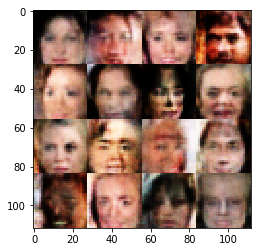

Epoch 1/50... Discriminator Loss: 0.2031... Generator Loss: 6.0862
Epoch 1/50... Discriminator Loss: 0.1897... Generator Loss: 2.1907
Epoch 1/50... Discriminator Loss: 0.2257... Generator Loss: 2.4920
Epoch 1/50... Discriminator Loss: 0.0579... Generator Loss: 4.4746
Epoch 1/50... Discriminator Loss: 0.2201... Generator Loss: 2.2809
Epoch 1/50... Discriminator Loss: 0.0896... Generator Loss: 3.2642
Epoch 1/50... Discriminator Loss: 0.1534... Generator Loss: 4.7307
Epoch 1/50... Discriminator Loss: 0.4342... Generator Loss: 6.4524
Epoch 1/50... Discriminator Loss: 1.2978... Generator Loss: 2.1748
Epoch 1/50... Discriminator Loss: 1.5533... Generator Loss: 0.3471


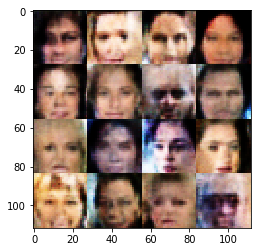

Epoch 1/50... Discriminator Loss: 0.1318... Generator Loss: 3.0421
Epoch 1/50... Discriminator Loss: 0.2142... Generator Loss: 2.6622
Epoch 1/50... Discriminator Loss: 0.6149... Generator Loss: 0.9292
Epoch 1/50... Discriminator Loss: 0.8431... Generator Loss: 0.8166
Epoch 1/50... Discriminator Loss: 0.0634... Generator Loss: 4.8432
Epoch 1/50... Discriminator Loss: 0.0632... Generator Loss: 4.7145
Epoch 1/50... Discriminator Loss: 0.2810... Generator Loss: 1.8514
Epoch 1/50... Discriminator Loss: 0.1356... Generator Loss: 2.5831
Epoch 2/50... Discriminator Loss: 0.2572... Generator Loss: 1.7851
Epoch 2/50... Discriminator Loss: 0.1777... Generator Loss: 2.1867


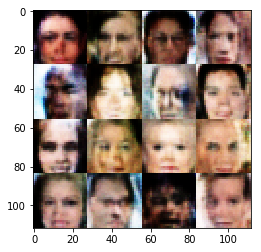

Epoch 2/50... Discriminator Loss: 0.2561... Generator Loss: 2.3940
Epoch 2/50... Discriminator Loss: 1.2249... Generator Loss: 8.3404
Epoch 2/50... Discriminator Loss: 1.5258... Generator Loss: 0.3045
Epoch 2/50... Discriminator Loss: 0.7860... Generator Loss: 5.2323
Epoch 2/50... Discriminator Loss: 0.1582... Generator Loss: 3.4746
Epoch 2/50... Discriminator Loss: 0.0731... Generator Loss: 4.2799
Epoch 2/50... Discriminator Loss: 0.2464... Generator Loss: 2.1844
Epoch 2/50... Discriminator Loss: 0.1086... Generator Loss: 2.9524
Epoch 2/50... Discriminator Loss: 0.1488... Generator Loss: 2.4317
Epoch 2/50... Discriminator Loss: 0.1077... Generator Loss: 5.4083


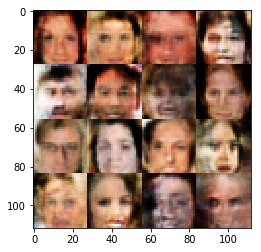

Epoch 2/50... Discriminator Loss: 0.1469... Generator Loss: 7.4411
Epoch 2/50... Discriminator Loss: 0.0839... Generator Loss: 5.2437
Epoch 2/50... Discriminator Loss: 0.3832... Generator Loss: 1.3976
Epoch 2/50... Discriminator Loss: 0.5144... Generator Loss: 1.0524
Epoch 2/50... Discriminator Loss: 0.3883... Generator Loss: 1.3486
Epoch 2/50... Discriminator Loss: 0.1195... Generator Loss: 6.6770
Epoch 2/50... Discriminator Loss: 0.1284... Generator Loss: 6.1757
Epoch 2/50... Discriminator Loss: 0.2912... Generator Loss: 1.7123
Epoch 2/50... Discriminator Loss: 0.8856... Generator Loss: 0.7510
Epoch 2/50... Discriminator Loss: 0.3046... Generator Loss: 1.6262


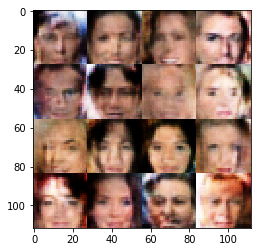

Epoch 2/50... Discriminator Loss: 0.4796... Generator Loss: 1.1739
Epoch 2/50... Discriminator Loss: 0.1171... Generator Loss: 4.1232
Epoch 2/50... Discriminator Loss: 0.0799... Generator Loss: 5.3843
Epoch 2/50... Discriminator Loss: 0.1195... Generator Loss: 4.6411
Epoch 2/50... Discriminator Loss: 0.5791... Generator Loss: 6.5711
Epoch 2/50... Discriminator Loss: 0.0910... Generator Loss: 4.0228
Epoch 2/50... Discriminator Loss: 1.3395... Generator Loss: 6.4705
Epoch 2/50... Discriminator Loss: 0.1209... Generator Loss: 3.5398
Epoch 2/50... Discriminator Loss: 0.6285... Generator Loss: 3.2945
Epoch 2/50... Discriminator Loss: 0.7375... Generator Loss: 5.4007


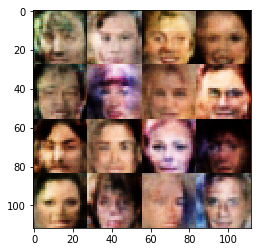

Epoch 2/50... Discriminator Loss: 0.1622... Generator Loss: 2.9500
Epoch 2/50... Discriminator Loss: 0.0599... Generator Loss: 4.7626
Epoch 2/50... Discriminator Loss: 0.1712... Generator Loss: 2.5889
Epoch 2/50... Discriminator Loss: 0.7830... Generator Loss: 0.7802
Epoch 2/50... Discriminator Loss: 0.1173... Generator Loss: 2.9895
Epoch 2/50... Discriminator Loss: 0.5413... Generator Loss: 5.3601
Epoch 2/50... Discriminator Loss: 0.0443... Generator Loss: 5.8314
Epoch 2/50... Discriminator Loss: 0.0599... Generator Loss: 4.4878
Epoch 2/50... Discriminator Loss: 0.4555... Generator Loss: 7.1998
Epoch 2/50... Discriminator Loss: 0.1054... Generator Loss: 3.2609


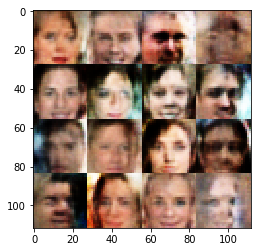

Epoch 2/50... Discriminator Loss: 0.0435... Generator Loss: 6.8323
Epoch 2/50... Discriminator Loss: 0.5375... Generator Loss: 5.8161
Epoch 2/50... Discriminator Loss: 0.1033... Generator Loss: 3.2453
Epoch 2/50... Discriminator Loss: 0.5597... Generator Loss: 1.0647
Epoch 2/50... Discriminator Loss: 0.0656... Generator Loss: 3.5308
Epoch 2/50... Discriminator Loss: 0.1973... Generator Loss: 2.1260
Epoch 2/50... Discriminator Loss: 0.0218... Generator Loss: 6.8557
Epoch 2/50... Discriminator Loss: 1.4983... Generator Loss: 6.9005
Epoch 2/50... Discriminator Loss: 0.7609... Generator Loss: 1.9722
Epoch 2/50... Discriminator Loss: 0.6544... Generator Loss: 1.1184


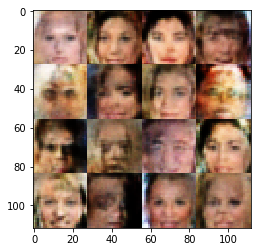

Epoch 2/50... Discriminator Loss: 0.2112... Generator Loss: 2.4744
Epoch 2/50... Discriminator Loss: 0.2245... Generator Loss: 2.6447
Epoch 2/50... Discriminator Loss: 0.2631... Generator Loss: 1.8884
Epoch 2/50... Discriminator Loss: 0.0865... Generator Loss: 5.7249
Epoch 2/50... Discriminator Loss: 0.6937... Generator Loss: 0.8775
Epoch 2/50... Discriminator Loss: 0.0291... Generator Loss: 5.0144
Epoch 2/50... Discriminator Loss: 0.2966... Generator Loss: 7.4653
Epoch 2/50... Discriminator Loss: 0.0561... Generator Loss: 4.1149
Epoch 2/50... Discriminator Loss: 0.6288... Generator Loss: 1.0122
Epoch 2/50... Discriminator Loss: 0.8112... Generator Loss: 0.7511


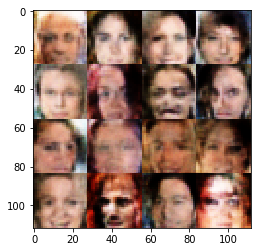

Epoch 2/50... Discriminator Loss: 0.0477... Generator Loss: 3.8905
Epoch 2/50... Discriminator Loss: 0.0740... Generator Loss: 3.4959
Epoch 2/50... Discriminator Loss: 0.1687... Generator Loss: 2.7043
Epoch 2/50... Discriminator Loss: 0.1897... Generator Loss: 2.1086
Epoch 2/50... Discriminator Loss: 1.2843... Generator Loss: 0.5198
Epoch 2/50... Discriminator Loss: 0.2671... Generator Loss: 2.0920
Epoch 2/50... Discriminator Loss: 0.2004... Generator Loss: 3.1876
Epoch 2/50... Discriminator Loss: 0.0754... Generator Loss: 5.4152
Epoch 2/50... Discriminator Loss: 0.0605... Generator Loss: 5.6904
Epoch 2/50... Discriminator Loss: 0.7334... Generator Loss: 6.9128


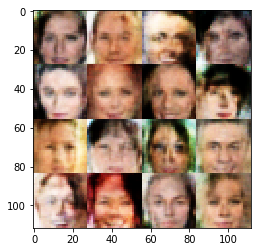

Epoch 2/50... Discriminator Loss: 0.0579... Generator Loss: 5.9812
Epoch 2/50... Discriminator Loss: 0.0691... Generator Loss: 3.3870
Epoch 2/50... Discriminator Loss: 0.0709... Generator Loss: 3.9864
Epoch 2/50... Discriminator Loss: 0.2376... Generator Loss: 4.6861
Epoch 2/50... Discriminator Loss: 0.0910... Generator Loss: 2.8647
Epoch 2/50... Discriminator Loss: 0.0429... Generator Loss: 5.5471
Epoch 2/50... Discriminator Loss: 0.2478... Generator Loss: 2.1096
Epoch 2/50... Discriminator Loss: 0.1014... Generator Loss: 5.0891
Epoch 2/50... Discriminator Loss: 0.0683... Generator Loss: 3.6314
Epoch 2/50... Discriminator Loss: 0.0499... Generator Loss: 5.8068


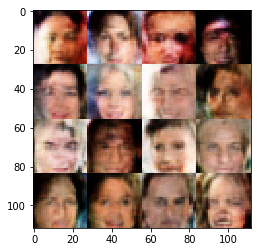

Epoch 2/50... Discriminator Loss: 0.0234... Generator Loss: 7.6167
Epoch 2/50... Discriminator Loss: 0.1759... Generator Loss: 6.0051
Epoch 2/50... Discriminator Loss: 0.0969... Generator Loss: 2.8937
Epoch 2/50... Discriminator Loss: 0.0345... Generator Loss: 4.0312
Epoch 2/50... Discriminator Loss: 0.0603... Generator Loss: 4.8496
Epoch 2/50... Discriminator Loss: 0.1182... Generator Loss: 2.5773
Epoch 2/50... Discriminator Loss: 0.1514... Generator Loss: 5.7833
Epoch 2/50... Discriminator Loss: 0.0733... Generator Loss: 6.9007
Epoch 2/50... Discriminator Loss: 0.0602... Generator Loss: 7.3066
Epoch 2/50... Discriminator Loss: 7.9001... Generator Loss: 10.9062


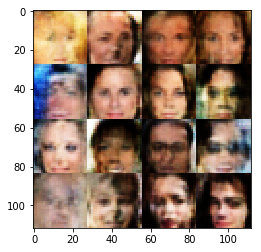

Epoch 2/50... Discriminator Loss: 0.7994... Generator Loss: 1.1344
Epoch 2/50... Discriminator Loss: 0.1056... Generator Loss: 3.2257
Epoch 2/50... Discriminator Loss: 0.1174... Generator Loss: 3.9085
Epoch 2/50... Discriminator Loss: 0.1930... Generator Loss: 2.8304
Epoch 2/50... Discriminator Loss: 0.2636... Generator Loss: 2.0452
Epoch 2/50... Discriminator Loss: 0.0413... Generator Loss: 5.2837
Epoch 2/50... Discriminator Loss: 0.3059... Generator Loss: 1.8164
Epoch 2/50... Discriminator Loss: 0.0224... Generator Loss: 6.1901
Epoch 2/50... Discriminator Loss: 0.4058... Generator Loss: 1.5303
Epoch 2/50... Discriminator Loss: 0.0727... Generator Loss: 3.4518


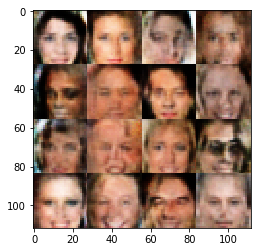

Epoch 2/50... Discriminator Loss: 2.2185... Generator Loss: 0.2277
Epoch 2/50... Discriminator Loss: 0.6103... Generator Loss: 3.4292
Epoch 2/50... Discriminator Loss: 0.1626... Generator Loss: 3.0067
Epoch 2/50... Discriminator Loss: 0.2671... Generator Loss: 4.2293
Epoch 2/50... Discriminator Loss: 0.1138... Generator Loss: 2.8240
Epoch 2/50... Discriminator Loss: 0.1810... Generator Loss: 3.2299
Epoch 2/50... Discriminator Loss: 0.0875... Generator Loss: 5.3626
Epoch 2/50... Discriminator Loss: 0.1636... Generator Loss: 5.6349
Epoch 2/50... Discriminator Loss: 0.2467... Generator Loss: 5.7741
Epoch 2/50... Discriminator Loss: 0.0613... Generator Loss: 6.7397


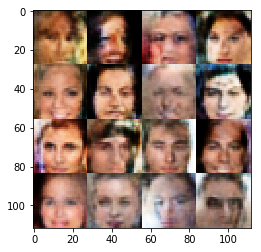

Epoch 2/50... Discriminator Loss: 0.0607... Generator Loss: 4.4317
Epoch 2/50... Discriminator Loss: 0.3443... Generator Loss: 1.6094
Epoch 2/50... Discriminator Loss: 0.1391... Generator Loss: 3.6142
Epoch 2/50... Discriminator Loss: 0.1527... Generator Loss: 2.7643
Epoch 2/50... Discriminator Loss: 0.0527... Generator Loss: 4.4849
Epoch 2/50... Discriminator Loss: 0.1491... Generator Loss: 2.2200
Epoch 2/50... Discriminator Loss: 0.0757... Generator Loss: 7.7103
Epoch 2/50... Discriminator Loss: 0.1283... Generator Loss: 2.7224
Epoch 2/50... Discriminator Loss: 0.1778... Generator Loss: 2.3941
Epoch 2/50... Discriminator Loss: 0.0485... Generator Loss: 4.3114


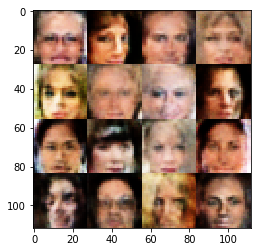

Epoch 2/50... Discriminator Loss: 0.0232... Generator Loss: 6.7444
Epoch 2/50... Discriminator Loss: 0.0903... Generator Loss: 2.8841
Epoch 2/50... Discriminator Loss: 0.0286... Generator Loss: 4.8668
Epoch 2/50... Discriminator Loss: 0.0971... Generator Loss: 7.8966
Epoch 2/50... Discriminator Loss: 0.0270... Generator Loss: 6.3868
Epoch 2/50... Discriminator Loss: 0.6682... Generator Loss: 5.4966
Epoch 2/50... Discriminator Loss: 1.8142... Generator Loss: 0.4633
Epoch 2/50... Discriminator Loss: 1.5577... Generator Loss: 0.5870
Epoch 2/50... Discriminator Loss: 1.0142... Generator Loss: 2.4284
Epoch 2/50... Discriminator Loss: 1.3993... Generator Loss: 0.3967


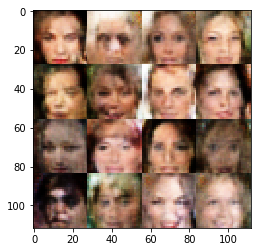

Epoch 2/50... Discriminator Loss: 0.5582... Generator Loss: 1.6218
Epoch 2/50... Discriminator Loss: 0.3123... Generator Loss: 2.0339
Epoch 2/50... Discriminator Loss: 0.2448... Generator Loss: 3.5815
Epoch 2/50... Discriminator Loss: 1.2031... Generator Loss: 0.4617
Epoch 2/50... Discriminator Loss: 0.3591... Generator Loss: 1.5931
Epoch 2/50... Discriminator Loss: 0.2376... Generator Loss: 2.2367
Epoch 2/50... Discriminator Loss: 0.2528... Generator Loss: 4.6173
Epoch 2/50... Discriminator Loss: 0.0896... Generator Loss: 3.8100
Epoch 2/50... Discriminator Loss: 0.0801... Generator Loss: 4.7350
Epoch 2/50... Discriminator Loss: 0.0780... Generator Loss: 3.2846


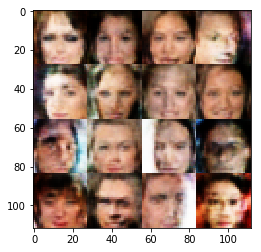

Epoch 2/50... Discriminator Loss: 0.8532... Generator Loss: 8.0976
Epoch 2/50... Discriminator Loss: 3.0821... Generator Loss: 4.5333
Epoch 2/50... Discriminator Loss: 0.5807... Generator Loss: 1.2097
Epoch 2/50... Discriminator Loss: 0.6354... Generator Loss: 2.3680
Epoch 2/50... Discriminator Loss: 0.0716... Generator Loss: 4.3003
Epoch 2/50... Discriminator Loss: 0.8402... Generator Loss: 4.9041
Epoch 2/50... Discriminator Loss: 0.2743... Generator Loss: 1.9340
Epoch 2/50... Discriminator Loss: 0.2662... Generator Loss: 1.7360
Epoch 2/50... Discriminator Loss: 0.0845... Generator Loss: 3.6027
Epoch 2/50... Discriminator Loss: 0.1377... Generator Loss: 3.4703


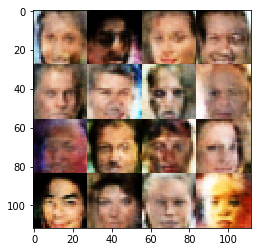

Epoch 2/50... Discriminator Loss: 0.1472... Generator Loss: 3.0219
Epoch 2/50... Discriminator Loss: 0.1625... Generator Loss: 2.2820
Epoch 2/50... Discriminator Loss: 0.0800... Generator Loss: 6.1751
Epoch 2/50... Discriminator Loss: 0.0841... Generator Loss: 3.4486
Epoch 2/50... Discriminator Loss: 0.7081... Generator Loss: 4.4898
Epoch 2/50... Discriminator Loss: 0.0313... Generator Loss: 5.0309
Epoch 3/50... Discriminator Loss: 0.1144... Generator Loss: 6.3707
Epoch 3/50... Discriminator Loss: 0.3065... Generator Loss: 1.6086
Epoch 3/50... Discriminator Loss: 0.0998... Generator Loss: 3.5722
Epoch 3/50... Discriminator Loss: 0.1587... Generator Loss: 8.8925


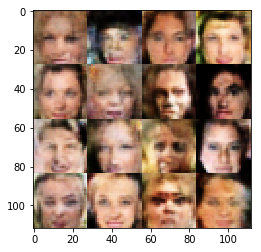

Epoch 3/50... Discriminator Loss: 0.4085... Generator Loss: 1.4633
Epoch 3/50... Discriminator Loss: 2.0005... Generator Loss: 2.4273
Epoch 3/50... Discriminator Loss: 0.2921... Generator Loss: 1.6460
Epoch 3/50... Discriminator Loss: 0.4065... Generator Loss: 3.7120
Epoch 3/50... Discriminator Loss: 0.0815... Generator Loss: 3.4505
Epoch 3/50... Discriminator Loss: 0.1787... Generator Loss: 6.9096
Epoch 3/50... Discriminator Loss: 0.1629... Generator Loss: 2.3171
Epoch 3/50... Discriminator Loss: 0.1258... Generator Loss: 2.6212
Epoch 3/50... Discriminator Loss: 0.0506... Generator Loss: 5.2647
Epoch 3/50... Discriminator Loss: 0.1159... Generator Loss: 2.8996


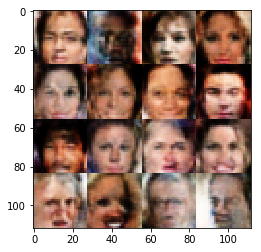

Epoch 3/50... Discriminator Loss: 0.2169... Generator Loss: 2.0717
Epoch 3/50... Discriminator Loss: 0.0544... Generator Loss: 4.1215
Epoch 3/50... Discriminator Loss: 0.1464... Generator Loss: 2.5532
Epoch 3/50... Discriminator Loss: 0.1889... Generator Loss: 2.1571
Epoch 3/50... Discriminator Loss: 0.1401... Generator Loss: 6.2430
Epoch 3/50... Discriminator Loss: 0.6835... Generator Loss: 8.2538
Epoch 3/50... Discriminator Loss: 0.0323... Generator Loss: 5.2831
Epoch 3/50... Discriminator Loss: 0.0593... Generator Loss: 5.7440
Epoch 3/50... Discriminator Loss: 0.0680... Generator Loss: 3.1258
Epoch 3/50... Discriminator Loss: 0.0150... Generator Loss: 5.4127


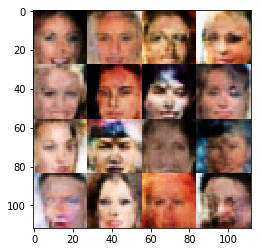

Epoch 3/50... Discriminator Loss: 0.8764... Generator Loss: 0.7214
Epoch 3/50... Discriminator Loss: 0.0327... Generator Loss: 7.6879
Epoch 3/50... Discriminator Loss: 0.0194... Generator Loss: 6.8857
Epoch 3/50... Discriminator Loss: 0.0434... Generator Loss: 4.2192
Epoch 3/50... Discriminator Loss: 0.0547... Generator Loss: 4.0517
Epoch 3/50... Discriminator Loss: 0.0474... Generator Loss: 4.2037
Epoch 3/50... Discriminator Loss: 0.0691... Generator Loss: 8.1763
Epoch 3/50... Discriminator Loss: 2.5337... Generator Loss: 2.7128
Epoch 3/50... Discriminator Loss: 0.8932... Generator Loss: 0.8742
Epoch 3/50... Discriminator Loss: 0.4757... Generator Loss: 4.7827


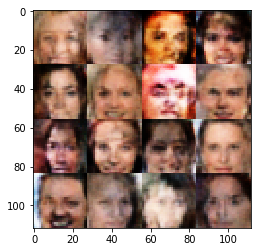

Epoch 3/50... Discriminator Loss: 1.3981... Generator Loss: 0.4695
Epoch 3/50... Discriminator Loss: 1.5402... Generator Loss: 4.4505
Epoch 3/50... Discriminator Loss: 0.5079... Generator Loss: 1.7527
Epoch 3/50... Discriminator Loss: 0.3697... Generator Loss: 1.6491
Epoch 3/50... Discriminator Loss: 0.1738... Generator Loss: 2.4264
Epoch 3/50... Discriminator Loss: 0.1123... Generator Loss: 4.9328
Epoch 3/50... Discriminator Loss: 0.1337... Generator Loss: 3.5558
Epoch 3/50... Discriminator Loss: 0.3412... Generator Loss: 1.5967
Epoch 3/50... Discriminator Loss: 0.1020... Generator Loss: 3.2340
Epoch 3/50... Discriminator Loss: 0.0945... Generator Loss: 5.2188


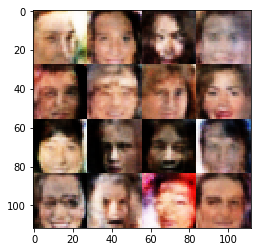

Epoch 3/50... Discriminator Loss: 0.0446... Generator Loss: 5.0173
Epoch 3/50... Discriminator Loss: 0.0582... Generator Loss: 4.8931
Epoch 3/50... Discriminator Loss: 0.0680... Generator Loss: 3.7121
Epoch 3/50... Discriminator Loss: 0.0487... Generator Loss: 4.0048
Epoch 3/50... Discriminator Loss: 0.7286... Generator Loss: 0.8645
Epoch 3/50... Discriminator Loss: 1.6476... Generator Loss: 0.3195
Epoch 3/50... Discriminator Loss: 1.3024... Generator Loss: 0.4405
Epoch 3/50... Discriminator Loss: 0.4778... Generator Loss: 1.8919
Epoch 3/50... Discriminator Loss: 0.3685... Generator Loss: 2.5284
Epoch 3/50... Discriminator Loss: 0.5702... Generator Loss: 1.2021


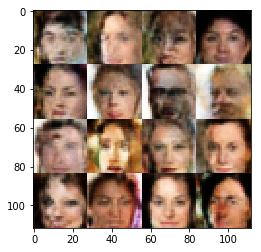

Epoch 3/50... Discriminator Loss: 0.1106... Generator Loss: 3.5716
Epoch 3/50... Discriminator Loss: 0.0526... Generator Loss: 4.8306
Epoch 3/50... Discriminator Loss: 0.3782... Generator Loss: 1.5394
Epoch 3/50... Discriminator Loss: 2.0581... Generator Loss: 4.7802
Epoch 3/50... Discriminator Loss: 0.6201... Generator Loss: 1.1351
Epoch 3/50... Discriminator Loss: 0.3593... Generator Loss: 1.5295
Epoch 3/50... Discriminator Loss: 0.1852... Generator Loss: 2.3867
Epoch 3/50... Discriminator Loss: 0.1177... Generator Loss: 3.1715
Epoch 3/50... Discriminator Loss: 1.5014... Generator Loss: 0.3499
Epoch 3/50... Discriminator Loss: 0.1418... Generator Loss: 4.1146


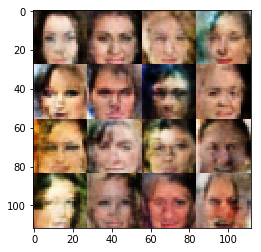

Epoch 3/50... Discriminator Loss: 0.0465... Generator Loss: 4.9246
Epoch 3/50... Discriminator Loss: 0.1312... Generator Loss: 3.7710
Epoch 3/50... Discriminator Loss: 0.0705... Generator Loss: 4.5653
Epoch 3/50... Discriminator Loss: 0.0420... Generator Loss: 4.7990
Epoch 3/50... Discriminator Loss: 0.3861... Generator Loss: 1.4375
Epoch 3/50... Discriminator Loss: 0.1382... Generator Loss: 2.6218
Epoch 3/50... Discriminator Loss: 1.2582... Generator Loss: 0.4627
Epoch 3/50... Discriminator Loss: 0.7128... Generator Loss: 1.7378
Epoch 3/50... Discriminator Loss: 0.3464... Generator Loss: 2.2131
Epoch 3/50... Discriminator Loss: 0.1310... Generator Loss: 3.0561


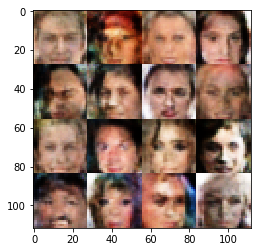

Epoch 3/50... Discriminator Loss: 0.1827... Generator Loss: 2.6548
Epoch 3/50... Discriminator Loss: 0.1461... Generator Loss: 2.7838
Epoch 3/50... Discriminator Loss: 0.0404... Generator Loss: 5.0605
Epoch 3/50... Discriminator Loss: 0.3358... Generator Loss: 2.0243
Epoch 3/50... Discriminator Loss: 0.1071... Generator Loss: 4.6508
Epoch 3/50... Discriminator Loss: 0.0853... Generator Loss: 3.5791
Epoch 3/50... Discriminator Loss: 0.2267... Generator Loss: 5.9169
Epoch 3/50... Discriminator Loss: 0.1399... Generator Loss: 2.6886
Epoch 3/50... Discriminator Loss: 0.3895... Generator Loss: 7.8028
Epoch 3/50... Discriminator Loss: 0.1093... Generator Loss: 2.9840


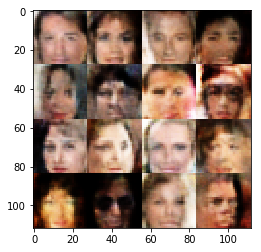

Epoch 3/50... Discriminator Loss: 0.0963... Generator Loss: 5.4229
Epoch 3/50... Discriminator Loss: 0.3184... Generator Loss: 1.6875
Epoch 3/50... Discriminator Loss: 0.0422... Generator Loss: 4.2836
Epoch 3/50... Discriminator Loss: 0.1650... Generator Loss: 2.3659
Epoch 3/50... Discriminator Loss: 0.0922... Generator Loss: 4.3697
Epoch 3/50... Discriminator Loss: 1.9030... Generator Loss: 0.2711
Epoch 3/50... Discriminator Loss: 1.0487... Generator Loss: 0.5965
Epoch 3/50... Discriminator Loss: 0.2869... Generator Loss: 2.1608
Epoch 3/50... Discriminator Loss: 0.5136... Generator Loss: 1.2445
Epoch 3/50... Discriminator Loss: 0.1044... Generator Loss: 3.4112


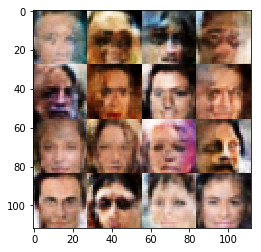

Epoch 3/50... Discriminator Loss: 0.4280... Generator Loss: 1.2936
Epoch 3/50... Discriminator Loss: 0.1190... Generator Loss: 2.7998
Epoch 3/50... Discriminator Loss: 0.9903... Generator Loss: 0.6473
Epoch 3/50... Discriminator Loss: 1.2130... Generator Loss: 2.8229
Epoch 3/50... Discriminator Loss: 0.4590... Generator Loss: 3.7464
Epoch 3/50... Discriminator Loss: 0.8614... Generator Loss: 0.7481
Epoch 3/50... Discriminator Loss: 0.1419... Generator Loss: 2.6407
Epoch 3/50... Discriminator Loss: 0.2116... Generator Loss: 2.2344
Epoch 3/50... Discriminator Loss: 0.2064... Generator Loss: 3.3605
Epoch 3/50... Discriminator Loss: 0.5354... Generator Loss: 1.1595


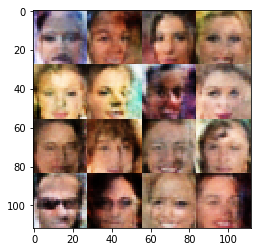

Epoch 3/50... Discriminator Loss: 0.1266... Generator Loss: 3.4995
Epoch 3/50... Discriminator Loss: 0.0498... Generator Loss: 5.7866
Epoch 3/50... Discriminator Loss: 0.0689... Generator Loss: 4.1276
Epoch 3/50... Discriminator Loss: 0.1129... Generator Loss: 3.5507
Epoch 3/50... Discriminator Loss: 0.0496... Generator Loss: 5.2684
Epoch 3/50... Discriminator Loss: 1.1543... Generator Loss: 0.6480
Epoch 3/50... Discriminator Loss: 0.4896... Generator Loss: 1.4833
Epoch 3/50... Discriminator Loss: 0.1684... Generator Loss: 2.3524
Epoch 3/50... Discriminator Loss: 0.0613... Generator Loss: 5.7019
Epoch 3/50... Discriminator Loss: 0.1848... Generator Loss: 2.2910


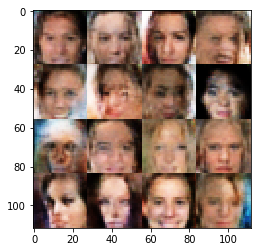

Epoch 3/50... Discriminator Loss: 0.0838... Generator Loss: 4.2263
Epoch 3/50... Discriminator Loss: 0.1706... Generator Loss: 2.4186
Epoch 3/50... Discriminator Loss: 0.0734... Generator Loss: 4.2703
Epoch 3/50... Discriminator Loss: 0.1409... Generator Loss: 2.7722
Epoch 3/50... Discriminator Loss: 0.0504... Generator Loss: 4.3658
Epoch 3/50... Discriminator Loss: 0.0228... Generator Loss: 4.9493
Epoch 3/50... Discriminator Loss: 0.0849... Generator Loss: 6.2758
Epoch 3/50... Discriminator Loss: 0.0781... Generator Loss: 4.9052
Epoch 3/50... Discriminator Loss: 0.0815... Generator Loss: 5.6075
Epoch 3/50... Discriminator Loss: 0.0615... Generator Loss: 4.8613


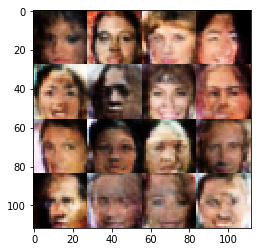

Epoch 3/50... Discriminator Loss: 0.0302... Generator Loss: 7.5582
Epoch 3/50... Discriminator Loss: 1.5721... Generator Loss: 0.3613
Epoch 3/50... Discriminator Loss: 0.8419... Generator Loss: 2.1339
Epoch 3/50... Discriminator Loss: 0.1208... Generator Loss: 4.8285
Epoch 3/50... Discriminator Loss: 0.1490... Generator Loss: 3.1813
Epoch 3/50... Discriminator Loss: 0.0494... Generator Loss: 4.8302
Epoch 3/50... Discriminator Loss: 0.0398... Generator Loss: 4.5257
Epoch 3/50... Discriminator Loss: 0.0814... Generator Loss: 4.3016
Epoch 3/50... Discriminator Loss: 0.4446... Generator Loss: 1.4155
Epoch 3/50... Discriminator Loss: 0.0525... Generator Loss: 4.5488


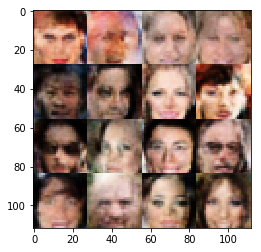

Epoch 3/50... Discriminator Loss: 0.1731... Generator Loss: 2.3102
Epoch 3/50... Discriminator Loss: 0.0600... Generator Loss: 4.1456
Epoch 3/50... Discriminator Loss: 0.1253... Generator Loss: 2.8957
Epoch 3/50... Discriminator Loss: 0.0791... Generator Loss: 6.3532
Epoch 3/50... Discriminator Loss: 1.2821... Generator Loss: 0.6427
Epoch 3/50... Discriminator Loss: 0.8958... Generator Loss: 1.7990
Epoch 3/50... Discriminator Loss: 0.8937... Generator Loss: 0.7501
Epoch 3/50... Discriminator Loss: 0.3730... Generator Loss: 1.8649
Epoch 3/50... Discriminator Loss: 0.3170... Generator Loss: 5.6444
Epoch 3/50... Discriminator Loss: 0.1041... Generator Loss: 3.9604


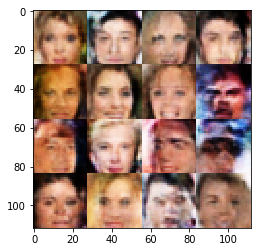

Epoch 3/50... Discriminator Loss: 1.1149... Generator Loss: 1.9589
Epoch 3/50... Discriminator Loss: 1.2596... Generator Loss: 0.5015
Epoch 3/50... Discriminator Loss: 0.7571... Generator Loss: 1.0252
Epoch 3/50... Discriminator Loss: 0.0660... Generator Loss: 5.3617
Epoch 3/50... Discriminator Loss: 0.2275... Generator Loss: 2.1665
Epoch 3/50... Discriminator Loss: 0.0942... Generator Loss: 3.6064
Epoch 3/50... Discriminator Loss: 0.1056... Generator Loss: 5.2224
Epoch 3/50... Discriminator Loss: 1.3403... Generator Loss: 0.4779
Epoch 3/50... Discriminator Loss: 0.9930... Generator Loss: 1.9973
Epoch 3/50... Discriminator Loss: 0.3018... Generator Loss: 2.5825


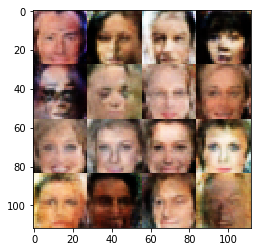

Epoch 3/50... Discriminator Loss: 0.0801... Generator Loss: 3.5198
Epoch 3/50... Discriminator Loss: 0.1133... Generator Loss: 3.5150
Epoch 3/50... Discriminator Loss: 0.1052... Generator Loss: 3.9607
Epoch 3/50... Discriminator Loss: 0.0624... Generator Loss: 4.2894
Epoch 4/50... Discriminator Loss: 0.1541... Generator Loss: 2.8977
Epoch 4/50... Discriminator Loss: 0.1034... Generator Loss: 2.9378
Epoch 4/50... Discriminator Loss: 0.1636... Generator Loss: 2.4495
Epoch 4/50... Discriminator Loss: 0.0653... Generator Loss: 4.0904
Epoch 4/50... Discriminator Loss: 0.3633... Generator Loss: 1.5034
Epoch 4/50... Discriminator Loss: 0.5791... Generator Loss: 1.0801


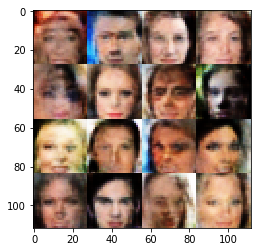

Epoch 4/50... Discriminator Loss: 0.1412... Generator Loss: 3.3580
Epoch 4/50... Discriminator Loss: 0.0496... Generator Loss: 4.5081
Epoch 4/50... Discriminator Loss: 0.0373... Generator Loss: 6.5120
Epoch 4/50... Discriminator Loss: 0.2249... Generator Loss: 1.9771
Epoch 4/50... Discriminator Loss: 0.2582... Generator Loss: 1.9479
Epoch 4/50... Discriminator Loss: 0.0664... Generator Loss: 3.7304
Epoch 4/50... Discriminator Loss: 0.0305... Generator Loss: 7.2396
Epoch 4/50... Discriminator Loss: 0.0763... Generator Loss: 4.1234
Epoch 4/50... Discriminator Loss: 0.1285... Generator Loss: 6.7098
Epoch 4/50... Discriminator Loss: 0.0691... Generator Loss: 4.4692


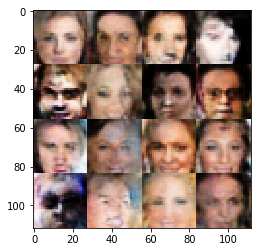

Epoch 4/50... Discriminator Loss: 0.0923... Generator Loss: 4.2579
Epoch 4/50... Discriminator Loss: 0.1066... Generator Loss: 4.7930
Epoch 4/50... Discriminator Loss: 0.0208... Generator Loss: 7.0564
Epoch 4/50... Discriminator Loss: 0.3507... Generator Loss: 1.5089
Epoch 4/50... Discriminator Loss: 0.0893... Generator Loss: 4.5965
Epoch 4/50... Discriminator Loss: 0.4156... Generator Loss: 1.3818
Epoch 4/50... Discriminator Loss: 0.0817... Generator Loss: 3.5192
Epoch 4/50... Discriminator Loss: 0.0547... Generator Loss: 3.6880
Epoch 4/50... Discriminator Loss: 0.3696... Generator Loss: 1.4512
Epoch 4/50... Discriminator Loss: 1.2884... Generator Loss: 6.8266


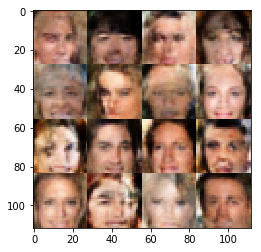

Epoch 4/50... Discriminator Loss: 0.8563... Generator Loss: 2.2894
Epoch 4/50... Discriminator Loss: 0.7903... Generator Loss: 0.8768
Epoch 4/50... Discriminator Loss: 0.4614... Generator Loss: 3.0186
Epoch 4/50... Discriminator Loss: 0.1684... Generator Loss: 2.4097
Epoch 4/50... Discriminator Loss: 1.5690... Generator Loss: 0.3470
Epoch 4/50... Discriminator Loss: 0.1049... Generator Loss: 3.1277
Epoch 4/50... Discriminator Loss: 0.1104... Generator Loss: 3.1196
Epoch 4/50... Discriminator Loss: 0.0824... Generator Loss: 3.3167
Epoch 4/50... Discriminator Loss: 0.1036... Generator Loss: 3.0643
Epoch 4/50... Discriminator Loss: 0.5514... Generator Loss: 1.0910


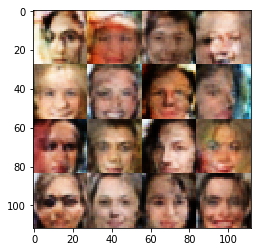

Epoch 4/50... Discriminator Loss: 0.1614... Generator Loss: 6.1252
Epoch 4/50... Discriminator Loss: 0.1121... Generator Loss: 3.1326
Epoch 4/50... Discriminator Loss: 0.3182... Generator Loss: 1.6382
Epoch 4/50... Discriminator Loss: 1.8717... Generator Loss: 8.2583
Epoch 4/50... Discriminator Loss: 0.2617... Generator Loss: 2.0238
Epoch 4/50... Discriminator Loss: 1.2944... Generator Loss: 1.8271
Epoch 4/50... Discriminator Loss: 0.7543... Generator Loss: 1.0509
Epoch 4/50... Discriminator Loss: 0.4956... Generator Loss: 1.5995
Epoch 4/50... Discriminator Loss: 1.8455... Generator Loss: 0.2507
Epoch 4/50... Discriminator Loss: 0.1642... Generator Loss: 3.7427


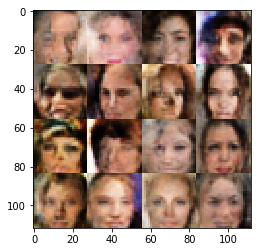

Epoch 4/50... Discriminator Loss: 0.1210... Generator Loss: 4.2527
Epoch 4/50... Discriminator Loss: 0.1772... Generator Loss: 2.3168
Epoch 4/50... Discriminator Loss: 0.2029... Generator Loss: 2.2803
Epoch 4/50... Discriminator Loss: 0.1056... Generator Loss: 3.4918
Epoch 4/50... Discriminator Loss: 0.3024... Generator Loss: 1.6445
Epoch 4/50... Discriminator Loss: 0.5455... Generator Loss: 1.1189
Epoch 4/50... Discriminator Loss: 0.1070... Generator Loss: 3.8643
Epoch 4/50... Discriminator Loss: 0.0753... Generator Loss: 4.5581
Epoch 4/50... Discriminator Loss: 0.0506... Generator Loss: 4.5183
Epoch 4/50... Discriminator Loss: 0.2160... Generator Loss: 2.2360


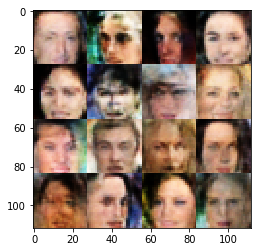

Epoch 4/50... Discriminator Loss: 0.1906... Generator Loss: 2.2174
Epoch 4/50... Discriminator Loss: 0.1107... Generator Loss: 3.0654
Epoch 4/50... Discriminator Loss: 0.0498... Generator Loss: 5.4382
Epoch 4/50... Discriminator Loss: 0.0458... Generator Loss: 5.8608
Epoch 4/50... Discriminator Loss: 0.4108... Generator Loss: 1.3692
Epoch 4/50... Discriminator Loss: 0.1571... Generator Loss: 2.4292
Epoch 4/50... Discriminator Loss: 2.9382... Generator Loss: 4.9270
Epoch 4/50... Discriminator Loss: 0.9323... Generator Loss: 0.9511
Epoch 4/50... Discriminator Loss: 1.9488... Generator Loss: 0.2208
Epoch 4/50... Discriminator Loss: 0.6781... Generator Loss: 2.1479


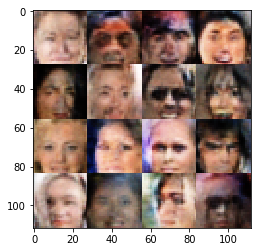

Epoch 4/50... Discriminator Loss: 0.4465... Generator Loss: 1.6299
Epoch 4/50... Discriminator Loss: 0.2828... Generator Loss: 1.9766
Epoch 4/50... Discriminator Loss: 0.1246... Generator Loss: 3.1125
Epoch 4/50... Discriminator Loss: 0.3874... Generator Loss: 3.2337
Epoch 4/50... Discriminator Loss: 0.5424... Generator Loss: 1.3302
Epoch 4/50... Discriminator Loss: 1.1537... Generator Loss: 0.5272
Epoch 4/50... Discriminator Loss: 0.3824... Generator Loss: 2.1302
Epoch 4/50... Discriminator Loss: 0.1128... Generator Loss: 3.7183
Epoch 4/50... Discriminator Loss: 0.1894... Generator Loss: 3.3775
Epoch 4/50... Discriminator Loss: 0.1668... Generator Loss: 5.7444


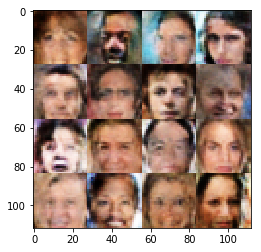

Epoch 4/50... Discriminator Loss: 0.4116... Generator Loss: 1.4020
Epoch 4/50... Discriminator Loss: 0.1364... Generator Loss: 4.0537
Epoch 4/50... Discriminator Loss: 0.2543... Generator Loss: 5.3408
Epoch 4/50... Discriminator Loss: 0.0927... Generator Loss: 4.4256
Epoch 4/50... Discriminator Loss: 0.0973... Generator Loss: 4.0107
Epoch 4/50... Discriminator Loss: 0.0514... Generator Loss: 4.3530
Epoch 4/50... Discriminator Loss: 0.1597... Generator Loss: 2.4011
Epoch 4/50... Discriminator Loss: 0.0467... Generator Loss: 5.6608
Epoch 4/50... Discriminator Loss: 0.0757... Generator Loss: 3.7724
Epoch 4/50... Discriminator Loss: 0.1252... Generator Loss: 4.0838


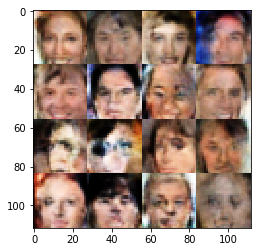

Epoch 4/50... Discriminator Loss: 0.0787... Generator Loss: 3.7272
Epoch 4/50... Discriminator Loss: 0.0564... Generator Loss: 3.5834
Epoch 4/50... Discriminator Loss: 0.0369... Generator Loss: 5.6991
Epoch 4/50... Discriminator Loss: 0.1438... Generator Loss: 2.6859
Epoch 4/50... Discriminator Loss: 0.2697... Generator Loss: 1.9612
Epoch 4/50... Discriminator Loss: 0.2437... Generator Loss: 2.3446
Epoch 4/50... Discriminator Loss: 0.2864... Generator Loss: 1.6714
Epoch 4/50... Discriminator Loss: 0.0134... Generator Loss: 6.8775
Epoch 4/50... Discriminator Loss: 0.0522... Generator Loss: 4.0732
Epoch 4/50... Discriminator Loss: 0.1364... Generator Loss: 3.4546


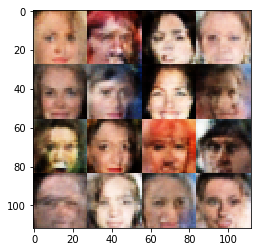

Epoch 4/50... Discriminator Loss: 0.1655... Generator Loss: 2.3998
Epoch 4/50... Discriminator Loss: 0.0788... Generator Loss: 3.8485
Epoch 4/50... Discriminator Loss: 0.4258... Generator Loss: 1.3407
Epoch 4/50... Discriminator Loss: 0.1790... Generator Loss: 2.8023
Epoch 4/50... Discriminator Loss: 0.0805... Generator Loss: 3.2025
Epoch 4/50... Discriminator Loss: 0.1433... Generator Loss: 5.5084
Epoch 4/50... Discriminator Loss: 0.0869... Generator Loss: 3.6303
Epoch 4/50... Discriminator Loss: 0.6961... Generator Loss: 0.9320
Epoch 4/50... Discriminator Loss: 2.4725... Generator Loss: 0.2230
Epoch 4/50... Discriminator Loss: 0.7454... Generator Loss: 1.3114


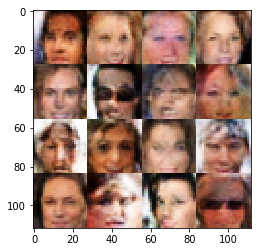

Epoch 4/50... Discriminator Loss: 1.6572... Generator Loss: 0.3307
Epoch 4/50... Discriminator Loss: 0.3946... Generator Loss: 1.8314
Epoch 4/50... Discriminator Loss: 0.3084... Generator Loss: 2.2708
Epoch 4/50... Discriminator Loss: 0.2414... Generator Loss: 5.1809
Epoch 4/50... Discriminator Loss: 0.1099... Generator Loss: 3.0565
Epoch 4/50... Discriminator Loss: 0.1641... Generator Loss: 4.5544
Epoch 4/50... Discriminator Loss: 0.3634... Generator Loss: 1.6215
Epoch 4/50... Discriminator Loss: 0.0850... Generator Loss: 3.6723
Epoch 4/50... Discriminator Loss: 0.1061... Generator Loss: 3.3893
Epoch 4/50... Discriminator Loss: 0.1115... Generator Loss: 2.9189


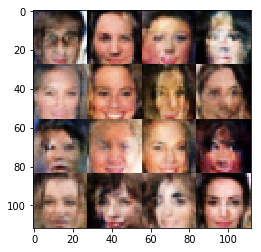

Epoch 4/50... Discriminator Loss: 0.2002... Generator Loss: 2.3574
Epoch 4/50... Discriminator Loss: 1.5625... Generator Loss: 0.3523
Epoch 4/50... Discriminator Loss: 0.5231... Generator Loss: 2.6276
Epoch 4/50... Discriminator Loss: 0.6241... Generator Loss: 1.3229
Epoch 4/50... Discriminator Loss: 0.4178... Generator Loss: 1.4795
Epoch 4/50... Discriminator Loss: 0.1963... Generator Loss: 3.3233
Epoch 4/50... Discriminator Loss: 0.1179... Generator Loss: 2.6433
Epoch 4/50... Discriminator Loss: 0.3741... Generator Loss: 1.4913
Epoch 4/50... Discriminator Loss: 0.6485... Generator Loss: 1.0044
Epoch 4/50... Discriminator Loss: 0.2925... Generator Loss: 2.1802


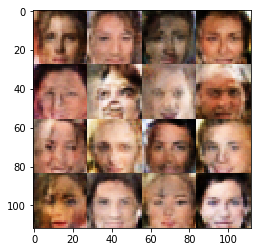

Epoch 4/50... Discriminator Loss: 0.2489... Generator Loss: 1.9477
Epoch 4/50... Discriminator Loss: 0.1446... Generator Loss: 2.7602
Epoch 4/50... Discriminator Loss: 0.1182... Generator Loss: 2.9676
Epoch 4/50... Discriminator Loss: 0.0526... Generator Loss: 4.6112
Epoch 4/50... Discriminator Loss: 0.1360... Generator Loss: 5.3915
Epoch 4/50... Discriminator Loss: 2.3553... Generator Loss: 0.1940
Epoch 4/50... Discriminator Loss: 0.5011... Generator Loss: 1.4472
Epoch 4/50... Discriminator Loss: 0.1148... Generator Loss: 4.4022
Epoch 4/50... Discriminator Loss: 0.4118... Generator Loss: 1.4266
Epoch 4/50... Discriminator Loss: 0.2045... Generator Loss: 2.2297


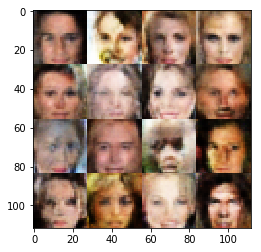

Epoch 4/50... Discriminator Loss: 0.1046... Generator Loss: 4.0317
Epoch 4/50... Discriminator Loss: 0.4121... Generator Loss: 1.4686
Epoch 4/50... Discriminator Loss: 0.0539... Generator Loss: 3.9784
Epoch 4/50... Discriminator Loss: 0.2621... Generator Loss: 1.9007
Epoch 4/50... Discriminator Loss: 0.1089... Generator Loss: 3.2138
Epoch 4/50... Discriminator Loss: 0.2345... Generator Loss: 1.9906
Epoch 4/50... Discriminator Loss: 0.2144... Generator Loss: 2.1607
Epoch 4/50... Discriminator Loss: 0.4388... Generator Loss: 1.3906
Epoch 4/50... Discriminator Loss: 0.1032... Generator Loss: 3.5630
Epoch 4/50... Discriminator Loss: 0.0223... Generator Loss: 6.2227


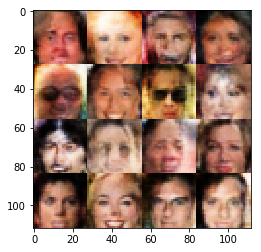

Epoch 4/50... Discriminator Loss: 0.6746... Generator Loss: 4.0410
Epoch 4/50... Discriminator Loss: 0.3676... Generator Loss: 5.0944
Epoch 4/50... Discriminator Loss: 0.0732... Generator Loss: 4.6107
Epoch 4/50... Discriminator Loss: 0.1068... Generator Loss: 4.0264
Epoch 4/50... Discriminator Loss: 0.3661... Generator Loss: 1.5133
Epoch 4/50... Discriminator Loss: 0.0422... Generator Loss: 4.3906
Epoch 4/50... Discriminator Loss: 0.2474... Generator Loss: 3.6302
Epoch 4/50... Discriminator Loss: 0.2529... Generator Loss: 1.8921
Epoch 4/50... Discriminator Loss: 0.1206... Generator Loss: 2.7877
Epoch 4/50... Discriminator Loss: 0.0538... Generator Loss: 4.4232


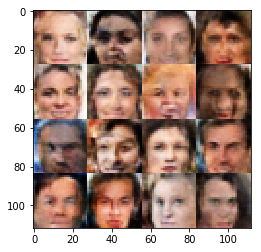

Epoch 4/50... Discriminator Loss: 0.1148... Generator Loss: 2.6727
Epoch 4/50... Discriminator Loss: 0.1064... Generator Loss: 4.2733
Epoch 5/50... Discriminator Loss: 0.3970... Generator Loss: 1.4097
Epoch 5/50... Discriminator Loss: 0.1313... Generator Loss: 3.4147
Epoch 5/50... Discriminator Loss: 0.3375... Generator Loss: 1.5866
Epoch 5/50... Discriminator Loss: 4.8884... Generator Loss: 0.0338
Epoch 5/50... Discriminator Loss: 1.0251... Generator Loss: 0.7193
Epoch 5/50... Discriminator Loss: 1.1658... Generator Loss: 0.5935
Epoch 5/50... Discriminator Loss: 0.5836... Generator Loss: 1.2414
Epoch 5/50... Discriminator Loss: 0.8393... Generator Loss: 2.8298


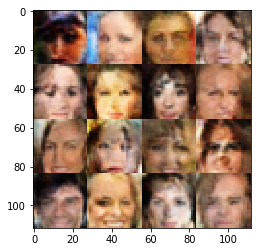

Epoch 5/50... Discriminator Loss: 0.4238... Generator Loss: 1.5600
Epoch 5/50... Discriminator Loss: 0.6203... Generator Loss: 1.1765
Epoch 5/50... Discriminator Loss: 0.1896... Generator Loss: 2.7671
Epoch 5/50... Discriminator Loss: 0.2084... Generator Loss: 3.0475
Epoch 5/50... Discriminator Loss: 0.4535... Generator Loss: 2.0237
Epoch 5/50... Discriminator Loss: 0.1013... Generator Loss: 4.0748
Epoch 5/50... Discriminator Loss: 0.1317... Generator Loss: 3.2726
Epoch 5/50... Discriminator Loss: 0.2503... Generator Loss: 2.3449
Epoch 5/50... Discriminator Loss: 0.0519... Generator Loss: 5.9801
Epoch 5/50... Discriminator Loss: 0.2807... Generator Loss: 1.8014


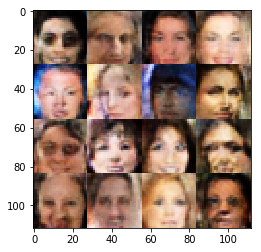

Epoch 5/50... Discriminator Loss: 0.1299... Generator Loss: 3.4987
Epoch 5/50... Discriminator Loss: 0.1434... Generator Loss: 3.7682
Epoch 5/50... Discriminator Loss: 0.0672... Generator Loss: 6.1004
Epoch 5/50... Discriminator Loss: 0.0536... Generator Loss: 4.7343
Epoch 5/50... Discriminator Loss: 0.0521... Generator Loss: 4.8004
Epoch 5/50... Discriminator Loss: 0.0613... Generator Loss: 4.3056
Epoch 5/50... Discriminator Loss: 0.2499... Generator Loss: 1.9831
Epoch 5/50... Discriminator Loss: 0.2909... Generator Loss: 2.9055
Epoch 5/50... Discriminator Loss: 0.1485... Generator Loss: 3.0870
Epoch 5/50... Discriminator Loss: 0.4201... Generator Loss: 5.9207


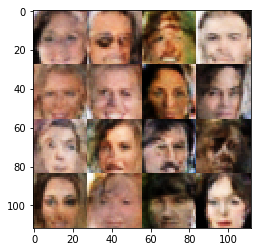

Epoch 5/50... Discriminator Loss: 0.0735... Generator Loss: 3.5970
Epoch 5/50... Discriminator Loss: 0.4579... Generator Loss: 1.2765
Epoch 5/50... Discriminator Loss: 0.1976... Generator Loss: 2.1650
Epoch 5/50... Discriminator Loss: 0.9528... Generator Loss: 6.8086
Epoch 5/50... Discriminator Loss: 0.7567... Generator Loss: 1.9431
Epoch 5/50... Discriminator Loss: 0.9918... Generator Loss: 2.7546
Epoch 5/50... Discriminator Loss: 0.6185... Generator Loss: 1.1453
Epoch 5/50... Discriminator Loss: 0.1377... Generator Loss: 2.8448
Epoch 5/50... Discriminator Loss: 0.2911... Generator Loss: 3.9056
Epoch 5/50... Discriminator Loss: 0.1791... Generator Loss: 2.7452


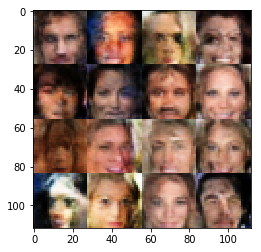

Epoch 5/50... Discriminator Loss: 0.1383... Generator Loss: 2.9129
Epoch 5/50... Discriminator Loss: 0.5555... Generator Loss: 1.3190
Epoch 5/50... Discriminator Loss: 0.9154... Generator Loss: 0.7523
Epoch 5/50... Discriminator Loss: 0.0716... Generator Loss: 6.9824
Epoch 5/50... Discriminator Loss: 0.2361... Generator Loss: 2.2936
Epoch 5/50... Discriminator Loss: 0.1583... Generator Loss: 2.6972
Epoch 5/50... Discriminator Loss: 0.1520... Generator Loss: 4.4451
Epoch 5/50... Discriminator Loss: 0.9522... Generator Loss: 0.6944
Epoch 5/50... Discriminator Loss: 4.8905... Generator Loss: 6.5310
Epoch 5/50... Discriminator Loss: 0.5905... Generator Loss: 1.5921


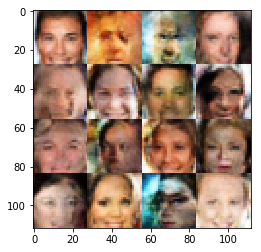

Epoch 5/50... Discriminator Loss: 0.4081... Generator Loss: 7.4096
Epoch 5/50... Discriminator Loss: 0.1909... Generator Loss: 2.4139
Epoch 5/50... Discriminator Loss: 0.3455... Generator Loss: 1.9627
Epoch 5/50... Discriminator Loss: 0.1282... Generator Loss: 3.2897
Epoch 5/50... Discriminator Loss: 0.3110... Generator Loss: 1.8482
Epoch 5/50... Discriminator Loss: 0.2839... Generator Loss: 1.8338
Epoch 5/50... Discriminator Loss: 0.2408... Generator Loss: 2.0339
Epoch 5/50... Discriminator Loss: 0.4470... Generator Loss: 1.3527
Epoch 5/50... Discriminator Loss: 0.3883... Generator Loss: 6.0578
Epoch 5/50... Discriminator Loss: 0.3937... Generator Loss: 1.4961


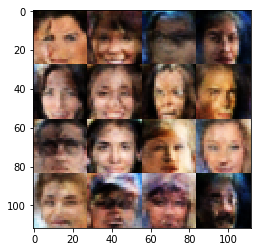

Epoch 5/50... Discriminator Loss: 0.1409... Generator Loss: 2.5170
Epoch 5/50... Discriminator Loss: 0.1754... Generator Loss: 2.5264
Epoch 5/50... Discriminator Loss: 0.1811... Generator Loss: 2.4379
Epoch 5/50... Discriminator Loss: 0.1482... Generator Loss: 2.6502
Epoch 5/50... Discriminator Loss: 0.3471... Generator Loss: 1.5742
Epoch 5/50... Discriminator Loss: 0.2556... Generator Loss: 1.9646
Epoch 5/50... Discriminator Loss: 0.2121... Generator Loss: 5.2010
Epoch 5/50... Discriminator Loss: 0.1391... Generator Loss: 2.6029
Epoch 5/50... Discriminator Loss: 0.2782... Generator Loss: 2.0275
Epoch 5/50... Discriminator Loss: 1.3877... Generator Loss: 0.5911


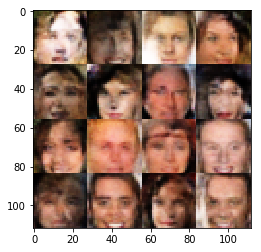

Epoch 5/50... Discriminator Loss: 0.4496... Generator Loss: 1.8810
Epoch 5/50... Discriminator Loss: 0.5212... Generator Loss: 1.8590
Epoch 5/50... Discriminator Loss: 0.4647... Generator Loss: 3.2159
Epoch 5/50... Discriminator Loss: 1.0658... Generator Loss: 4.4429
Epoch 5/50... Discriminator Loss: 0.0782... Generator Loss: 3.6487
Epoch 5/50... Discriminator Loss: 0.1006... Generator Loss: 3.1223
Epoch 5/50... Discriminator Loss: 0.1833... Generator Loss: 2.5511
Epoch 5/50... Discriminator Loss: 0.2164... Generator Loss: 2.0735
Epoch 5/50... Discriminator Loss: 0.0666... Generator Loss: 5.3602
Epoch 5/50... Discriminator Loss: 0.0637... Generator Loss: 4.2138


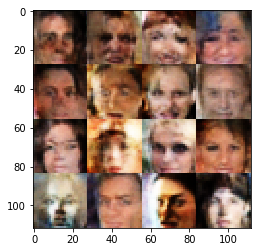

Epoch 5/50... Discriminator Loss: 0.3634... Generator Loss: 2.0268
Epoch 5/50... Discriminator Loss: 0.0935... Generator Loss: 4.0022
Epoch 5/50... Discriminator Loss: 0.1678... Generator Loss: 2.5271
Epoch 5/50... Discriminator Loss: 0.1579... Generator Loss: 2.5475
Epoch 5/50... Discriminator Loss: 0.1231... Generator Loss: 2.9091
Epoch 5/50... Discriminator Loss: 0.6815... Generator Loss: 0.9785
Epoch 5/50... Discriminator Loss: 0.1677... Generator Loss: 2.3658
Epoch 5/50... Discriminator Loss: 0.0965... Generator Loss: 3.1422
Epoch 5/50... Discriminator Loss: 0.1189... Generator Loss: 2.8431
Epoch 5/50... Discriminator Loss: 0.0431... Generator Loss: 3.9931


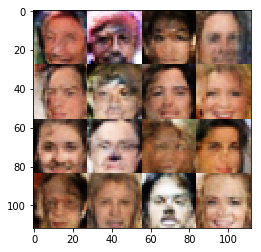

Epoch 5/50... Discriminator Loss: 0.0571... Generator Loss: 3.9653
Epoch 5/50... Discriminator Loss: 0.5490... Generator Loss: 1.1925
Epoch 5/50... Discriminator Loss: 0.4660... Generator Loss: 1.4287
Epoch 5/50... Discriminator Loss: 0.0780... Generator Loss: 3.5959
Epoch 5/50... Discriminator Loss: 0.0787... Generator Loss: 4.0081
Epoch 5/50... Discriminator Loss: 0.1156... Generator Loss: 4.2592
Epoch 5/50... Discriminator Loss: 0.1663... Generator Loss: 2.8038
Epoch 5/50... Discriminator Loss: 0.0481... Generator Loss: 4.3365
Epoch 5/50... Discriminator Loss: 0.1257... Generator Loss: 2.6563
Epoch 5/50... Discriminator Loss: 0.3500... Generator Loss: 4.0300


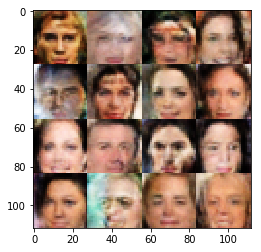

Epoch 5/50... Discriminator Loss: 1.5126... Generator Loss: 0.4112
Epoch 5/50... Discriminator Loss: 1.1803... Generator Loss: 1.0014
Epoch 5/50... Discriminator Loss: 1.5068... Generator Loss: 1.4566
Epoch 5/50... Discriminator Loss: 1.1693... Generator Loss: 1.2749
Epoch 5/50... Discriminator Loss: 0.9442... Generator Loss: 1.0543
Epoch 5/50... Discriminator Loss: 0.5296... Generator Loss: 1.5874
Epoch 5/50... Discriminator Loss: 1.9267... Generator Loss: 4.7993
Epoch 5/50... Discriminator Loss: 0.5736... Generator Loss: 1.9438
Epoch 5/50... Discriminator Loss: 0.4395... Generator Loss: 1.5586
Epoch 5/50... Discriminator Loss: 0.2792... Generator Loss: 1.9640


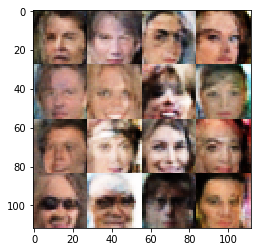

Epoch 5/50... Discriminator Loss: 4.1364... Generator Loss: 5.8155
Epoch 5/50... Discriminator Loss: 1.1272... Generator Loss: 0.6770
Epoch 5/50... Discriminator Loss: 0.9721... Generator Loss: 0.7598
Epoch 5/50... Discriminator Loss: 0.8080... Generator Loss: 1.7609
Epoch 5/50... Discriminator Loss: 0.8454... Generator Loss: 2.5223
Epoch 5/50... Discriminator Loss: 0.6427... Generator Loss: 1.0320
Epoch 5/50... Discriminator Loss: 1.1458... Generator Loss: 0.5409
Epoch 5/50... Discriminator Loss: 0.2584... Generator Loss: 2.1722
Epoch 5/50... Discriminator Loss: 0.2074... Generator Loss: 2.4353
Epoch 5/50... Discriminator Loss: 0.5704... Generator Loss: 1.1367


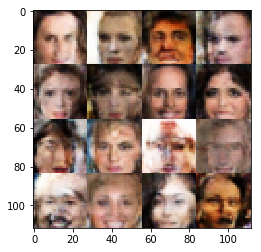

Epoch 5/50... Discriminator Loss: 1.5834... Generator Loss: 0.3872
Epoch 5/50... Discriminator Loss: 1.1020... Generator Loss: 0.5624
Epoch 5/50... Discriminator Loss: 0.5074... Generator Loss: 1.9995
Epoch 5/50... Discriminator Loss: 0.4698... Generator Loss: 1.9061
Epoch 5/50... Discriminator Loss: 0.2290... Generator Loss: 2.4039
Epoch 5/50... Discriminator Loss: 0.3020... Generator Loss: 2.0076
Epoch 5/50... Discriminator Loss: 0.4650... Generator Loss: 1.3525
Epoch 5/50... Discriminator Loss: 0.8502... Generator Loss: 0.7127
Epoch 5/50... Discriminator Loss: 0.1629... Generator Loss: 2.7839
Epoch 5/50... Discriminator Loss: 0.0509... Generator Loss: 4.7852


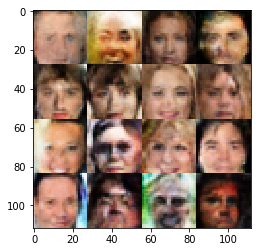

Epoch 5/50... Discriminator Loss: 0.1238... Generator Loss: 3.1294
Epoch 5/50... Discriminator Loss: 0.5672... Generator Loss: 1.1833
Epoch 5/50... Discriminator Loss: 0.3820... Generator Loss: 1.7904
Epoch 5/50... Discriminator Loss: 0.1474... Generator Loss: 2.7337
Epoch 5/50... Discriminator Loss: 0.2078... Generator Loss: 2.5316
Epoch 5/50... Discriminator Loss: 0.1101... Generator Loss: 3.3361
Epoch 5/50... Discriminator Loss: 0.1623... Generator Loss: 2.8004
Epoch 5/50... Discriminator Loss: 0.1766... Generator Loss: 2.2946
Epoch 5/50... Discriminator Loss: 0.0802... Generator Loss: 4.2108
Epoch 5/50... Discriminator Loss: 0.0877... Generator Loss: 4.6675


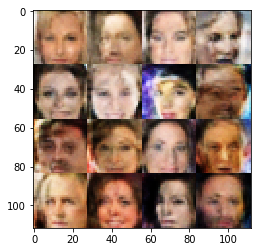

Epoch 5/50... Discriminator Loss: 0.1672... Generator Loss: 3.1882
Epoch 5/50... Discriminator Loss: 0.0734... Generator Loss: 3.8470
Epoch 5/50... Discriminator Loss: 0.3329... Generator Loss: 1.5986
Epoch 5/50... Discriminator Loss: 0.1118... Generator Loss: 3.4557
Epoch 5/50... Discriminator Loss: 0.0709... Generator Loss: 3.6133
Epoch 5/50... Discriminator Loss: 0.1823... Generator Loss: 2.4923
Epoch 5/50... Discriminator Loss: 0.1373... Generator Loss: 2.5876
Epoch 5/50... Discriminator Loss: 0.1975... Generator Loss: 2.2972
Epoch 5/50... Discriminator Loss: 0.1115... Generator Loss: 2.7159
Epoch 5/50... Discriminator Loss: 0.1426... Generator Loss: 2.6530


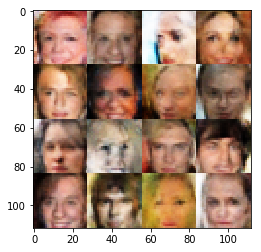

Epoch 5/50... Discriminator Loss: 0.0578... Generator Loss: 4.3172
Epoch 5/50... Discriminator Loss: 0.2603... Generator Loss: 1.8309
Epoch 5/50... Discriminator Loss: 0.2775... Generator Loss: 1.9503
Epoch 5/50... Discriminator Loss: 0.2352... Generator Loss: 2.0019
Epoch 5/50... Discriminator Loss: 1.5035... Generator Loss: 0.6079
Epoch 5/50... Discriminator Loss: 1.2443... Generator Loss: 1.0463
Epoch 5/50... Discriminator Loss: 1.2064... Generator Loss: 0.7856
Epoch 5/50... Discriminator Loss: 1.2918... Generator Loss: 1.1972
Epoch 5/50... Discriminator Loss: 1.3280... Generator Loss: 1.3872
Epoch 5/50... Discriminator Loss: 1.1050... Generator Loss: 1.3346


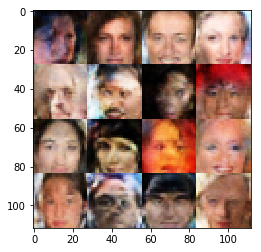

Epoch 5/50... Discriminator Loss: 0.9824... Generator Loss: 1.0589
Epoch 6/50... Discriminator Loss: 1.1488... Generator Loss: 1.1925
Epoch 6/50... Discriminator Loss: 0.7896... Generator Loss: 0.9813
Epoch 6/50... Discriminator Loss: 0.6220... Generator Loss: 2.4763
Epoch 6/50... Discriminator Loss: 1.8380... Generator Loss: 4.0370
Epoch 6/50... Discriminator Loss: 0.6327... Generator Loss: 1.9688
Epoch 6/50... Discriminator Loss: 1.0881... Generator Loss: 3.5907
Epoch 6/50... Discriminator Loss: 0.5533... Generator Loss: 1.9423
Epoch 6/50... Discriminator Loss: 0.4365... Generator Loss: 1.6873
Epoch 6/50... Discriminator Loss: 0.4120... Generator Loss: 1.6334


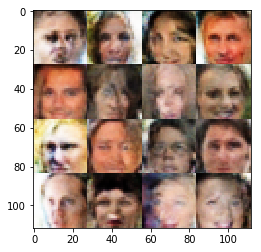

Epoch 6/50... Discriminator Loss: 0.1414... Generator Loss: 2.6161
Epoch 6/50... Discriminator Loss: 1.7917... Generator Loss: 0.3134
Epoch 6/50... Discriminator Loss: 4.5558... Generator Loss: 0.0300
Epoch 6/50... Discriminator Loss: 0.9629... Generator Loss: 1.1574
Epoch 6/50... Discriminator Loss: 0.5639... Generator Loss: 1.4142
Epoch 6/50... Discriminator Loss: 0.5194... Generator Loss: 1.4726
Epoch 6/50... Discriminator Loss: 0.5857... Generator Loss: 1.9851
Epoch 6/50... Discriminator Loss: 0.6856... Generator Loss: 1.7290
Epoch 6/50... Discriminator Loss: 0.5514... Generator Loss: 1.1580
Epoch 6/50... Discriminator Loss: 0.2934... Generator Loss: 1.9113


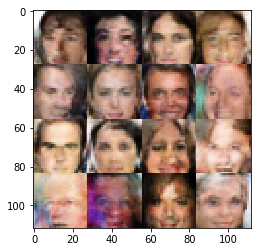

Epoch 6/50... Discriminator Loss: 0.5814... Generator Loss: 1.1096
Epoch 6/50... Discriminator Loss: 0.2389... Generator Loss: 2.1866
Epoch 6/50... Discriminator Loss: 0.9856... Generator Loss: 0.6356
Epoch 6/50... Discriminator Loss: 0.2057... Generator Loss: 2.2709
Epoch 6/50... Discriminator Loss: 0.3866... Generator Loss: 1.6641
Epoch 6/50... Discriminator Loss: 0.2897... Generator Loss: 1.7812
Epoch 6/50... Discriminator Loss: 0.6750... Generator Loss: 2.8163
Epoch 6/50... Discriminator Loss: 0.1938... Generator Loss: 2.9741
Epoch 6/50... Discriminator Loss: 0.1114... Generator Loss: 2.7922
Epoch 6/50... Discriminator Loss: 0.2039... Generator Loss: 2.1423


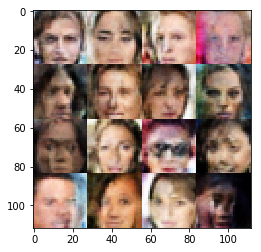

Epoch 6/50... Discriminator Loss: 0.1120... Generator Loss: 3.0569
Epoch 6/50... Discriminator Loss: 0.1565... Generator Loss: 2.5217
Epoch 6/50... Discriminator Loss: 0.0664... Generator Loss: 4.0876
Epoch 6/50... Discriminator Loss: 0.5526... Generator Loss: 1.1386
Epoch 6/50... Discriminator Loss: 0.3145... Generator Loss: 1.6990
Epoch 6/50... Discriminator Loss: 0.1092... Generator Loss: 2.9049
Epoch 6/50... Discriminator Loss: 0.1702... Generator Loss: 2.8511
Epoch 6/50... Discriminator Loss: 0.2483... Generator Loss: 1.9427
Epoch 6/50... Discriminator Loss: 0.1180... Generator Loss: 2.9309
Epoch 6/50... Discriminator Loss: 0.1541... Generator Loss: 2.6794


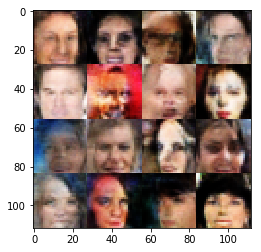

Epoch 6/50... Discriminator Loss: 6.4023... Generator Loss: 9.4235
Epoch 6/50... Discriminator Loss: 1.3027... Generator Loss: 0.6514
Epoch 6/50... Discriminator Loss: 0.9489... Generator Loss: 0.9293
Epoch 6/50... Discriminator Loss: 1.0946... Generator Loss: 0.5925
Epoch 6/50... Discriminator Loss: 0.5356... Generator Loss: 1.4382
Epoch 6/50... Discriminator Loss: 0.4851... Generator Loss: 1.6729
Epoch 6/50... Discriminator Loss: 0.3167... Generator Loss: 1.9312
Epoch 6/50... Discriminator Loss: 0.1839... Generator Loss: 2.4452
Epoch 6/50... Discriminator Loss: 0.2654... Generator Loss: 4.2104
Epoch 6/50... Discriminator Loss: 0.4151... Generator Loss: 1.4838


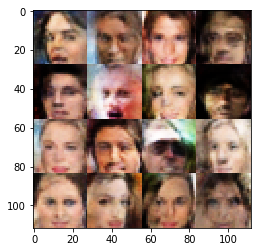

Epoch 6/50... Discriminator Loss: 0.1797... Generator Loss: 2.5767
Epoch 6/50... Discriminator Loss: 0.4189... Generator Loss: 1.3951
Epoch 6/50... Discriminator Loss: 0.2036... Generator Loss: 5.9982
Epoch 6/50... Discriminator Loss: 0.3955... Generator Loss: 1.5799
Epoch 6/50... Discriminator Loss: 0.7895... Generator Loss: 1.2951
Epoch 6/50... Discriminator Loss: 1.4618... Generator Loss: 1.9067
Epoch 6/50... Discriminator Loss: 0.8069... Generator Loss: 1.0984
Epoch 6/50... Discriminator Loss: 0.9292... Generator Loss: 0.8109
Epoch 6/50... Discriminator Loss: 0.6684... Generator Loss: 1.0270
Epoch 6/50... Discriminator Loss: 1.0535... Generator Loss: 0.6590


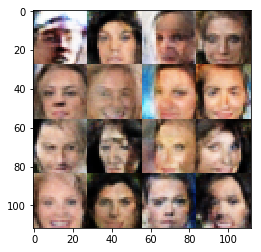

Epoch 6/50... Discriminator Loss: 0.6619... Generator Loss: 1.0403
Epoch 6/50... Discriminator Loss: 0.6012... Generator Loss: 1.2023
Epoch 6/50... Discriminator Loss: 0.2213... Generator Loss: 2.2185
Epoch 6/50... Discriminator Loss: 0.4235... Generator Loss: 1.4326
Epoch 6/50... Discriminator Loss: 0.3988... Generator Loss: 1.5476
Epoch 6/50... Discriminator Loss: 0.2072... Generator Loss: 2.1946
Epoch 6/50... Discriminator Loss: 0.3068... Generator Loss: 1.8140
Epoch 6/50... Discriminator Loss: 0.2002... Generator Loss: 2.9019
Epoch 6/50... Discriminator Loss: 0.2682... Generator Loss: 1.8851
Epoch 6/50... Discriminator Loss: 0.1617... Generator Loss: 3.4403


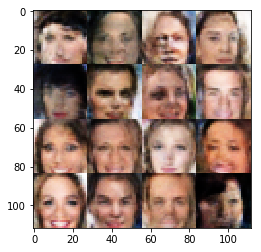

Epoch 6/50... Discriminator Loss: 0.2948... Generator Loss: 1.6397
Epoch 6/50... Discriminator Loss: 0.2242... Generator Loss: 2.1925
Epoch 6/50... Discriminator Loss: 0.4881... Generator Loss: 1.2392
Epoch 6/50... Discriminator Loss: 0.0936... Generator Loss: 3.4884
Epoch 6/50... Discriminator Loss: 0.0953... Generator Loss: 3.6851
Epoch 6/50... Discriminator Loss: 0.1914... Generator Loss: 2.3690
Epoch 6/50... Discriminator Loss: 0.1264... Generator Loss: 2.7337
Epoch 6/50... Discriminator Loss: 0.2126... Generator Loss: 2.4093
Epoch 6/50... Discriminator Loss: 0.1130... Generator Loss: 3.2502
Epoch 6/50... Discriminator Loss: 0.1645... Generator Loss: 2.4937


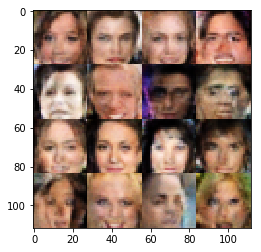

Epoch 6/50... Discriminator Loss: 0.3176... Generator Loss: 1.5929
Epoch 6/50... Discriminator Loss: 0.2420... Generator Loss: 1.9060
Epoch 6/50... Discriminator Loss: 0.1054... Generator Loss: 2.9467
Epoch 6/50... Discriminator Loss: 0.1495... Generator Loss: 2.5653
Epoch 6/50... Discriminator Loss: 0.0810... Generator Loss: 4.1581
Epoch 6/50... Discriminator Loss: 0.1587... Generator Loss: 2.6830
Epoch 6/50... Discriminator Loss: 4.8474... Generator Loss: 8.2561
Epoch 6/50... Discriminator Loss: 1.0657... Generator Loss: 1.7253
Epoch 6/50... Discriminator Loss: 0.8450... Generator Loss: 0.9598
Epoch 6/50... Discriminator Loss: 0.4372... Generator Loss: 1.6569


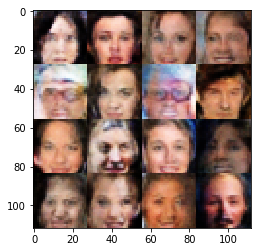

Epoch 6/50... Discriminator Loss: 0.3675... Generator Loss: 2.1984
Epoch 6/50... Discriminator Loss: 0.5536... Generator Loss: 3.0685
Epoch 6/50... Discriminator Loss: 1.4118... Generator Loss: 0.7243
Epoch 6/50... Discriminator Loss: 1.4650... Generator Loss: 1.4806
Epoch 6/50... Discriminator Loss: 1.0430... Generator Loss: 0.9797
Epoch 6/50... Discriminator Loss: 1.2905... Generator Loss: 0.4915
Epoch 6/50... Discriminator Loss: 0.6984... Generator Loss: 2.1781
Epoch 6/50... Discriminator Loss: 0.5157... Generator Loss: 1.3827
Epoch 6/50... Discriminator Loss: 1.2277... Generator Loss: 0.4971
Epoch 6/50... Discriminator Loss: 0.8796... Generator Loss: 0.7686


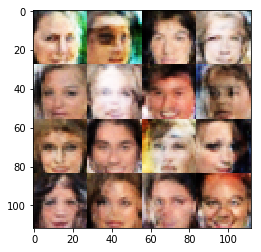

Epoch 6/50... Discriminator Loss: 0.3879... Generator Loss: 1.6806
Epoch 6/50... Discriminator Loss: 0.3425... Generator Loss: 2.2048
Epoch 6/50... Discriminator Loss: 0.5685... Generator Loss: 1.1209
Epoch 6/50... Discriminator Loss: 0.4409... Generator Loss: 1.4639
Epoch 6/50... Discriminator Loss: 0.2503... Generator Loss: 1.9270
Epoch 6/50... Discriminator Loss: 0.0854... Generator Loss: 3.5823
Epoch 6/50... Discriminator Loss: 0.2267... Generator Loss: 2.9509
Epoch 6/50... Discriminator Loss: 0.2074... Generator Loss: 2.5142
Epoch 6/50... Discriminator Loss: 0.1937... Generator Loss: 2.2012
Epoch 6/50... Discriminator Loss: 0.2765... Generator Loss: 2.7217


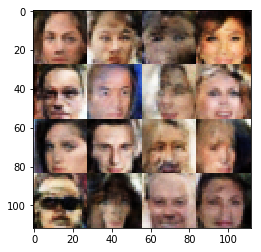

Epoch 6/50... Discriminator Loss: 1.1212... Generator Loss: 0.5448
Epoch 6/50... Discriminator Loss: 0.2042... Generator Loss: 2.3265
Epoch 6/50... Discriminator Loss: 0.1776... Generator Loss: 2.7305
Epoch 6/50... Discriminator Loss: 0.3158... Generator Loss: 1.6943
Epoch 6/50... Discriminator Loss: 0.3089... Generator Loss: 1.8329
Epoch 6/50... Discriminator Loss: 0.5781... Generator Loss: 1.1368
Epoch 6/50... Discriminator Loss: 0.2554... Generator Loss: 1.8290
Epoch 6/50... Discriminator Loss: 0.1957... Generator Loss: 2.2748
Epoch 6/50... Discriminator Loss: 0.6907... Generator Loss: 0.9572
Epoch 6/50... Discriminator Loss: 0.0727... Generator Loss: 4.4974


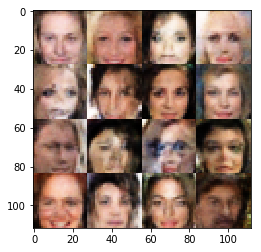

Epoch 6/50... Discriminator Loss: 0.2521... Generator Loss: 1.9671
Epoch 6/50... Discriminator Loss: 0.1398... Generator Loss: 2.7666
Epoch 6/50... Discriminator Loss: 0.0322... Generator Loss: 4.8055
Epoch 6/50... Discriminator Loss: 1.0163... Generator Loss: 0.7658
Epoch 6/50... Discriminator Loss: 0.5968... Generator Loss: 1.5313
Epoch 6/50... Discriminator Loss: 0.5673... Generator Loss: 1.1493
Epoch 6/50... Discriminator Loss: 0.9168... Generator Loss: 0.7386
Epoch 6/50... Discriminator Loss: 0.6674... Generator Loss: 1.0271
Epoch 6/50... Discriminator Loss: 0.2664... Generator Loss: 1.8580
Epoch 6/50... Discriminator Loss: 0.1641... Generator Loss: 2.5817


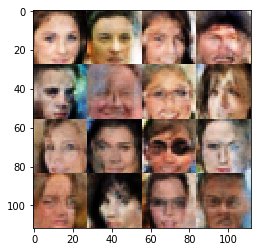

Epoch 6/50... Discriminator Loss: 0.1643... Generator Loss: 2.8430
Epoch 6/50... Discriminator Loss: 1.7370... Generator Loss: 4.3333
Epoch 6/50... Discriminator Loss: 0.4276... Generator Loss: 2.1414
Epoch 6/50... Discriminator Loss: 0.4437... Generator Loss: 1.4504
Epoch 6/50... Discriminator Loss: 0.3714... Generator Loss: 1.5471
Epoch 6/50... Discriminator Loss: 0.1910... Generator Loss: 2.6025
Epoch 6/50... Discriminator Loss: 0.3632... Generator Loss: 1.4710
Epoch 6/50... Discriminator Loss: 0.1316... Generator Loss: 4.0850
Epoch 6/50... Discriminator Loss: 0.1024... Generator Loss: 3.4749
Epoch 6/50... Discriminator Loss: 0.4771... Generator Loss: 1.3277


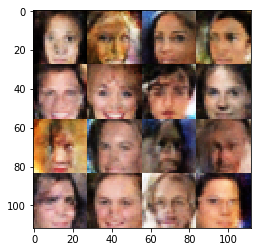

Epoch 6/50... Discriminator Loss: 0.0784... Generator Loss: 3.3611
Epoch 6/50... Discriminator Loss: 0.1093... Generator Loss: 3.0997
Epoch 6/50... Discriminator Loss: 0.3745... Generator Loss: 1.5531
Epoch 6/50... Discriminator Loss: 0.1093... Generator Loss: 4.6121
Epoch 6/50... Discriminator Loss: 0.0192... Generator Loss: 5.0253
Epoch 6/50... Discriminator Loss: 0.2918... Generator Loss: 1.8106
Epoch 6/50... Discriminator Loss: 0.1300... Generator Loss: 4.9016
Epoch 6/50... Discriminator Loss: 0.1232... Generator Loss: 4.3579
Epoch 6/50... Discriminator Loss: 0.0382... Generator Loss: 5.1347
Epoch 6/50... Discriminator Loss: 0.0748... Generator Loss: 4.4235


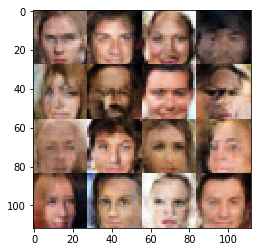

Epoch 6/50... Discriminator Loss: 0.1021... Generator Loss: 4.0388
Epoch 6/50... Discriminator Loss: 0.0237... Generator Loss: 4.5549
Epoch 6/50... Discriminator Loss: 0.2172... Generator Loss: 1.9844
Epoch 6/50... Discriminator Loss: 0.0804... Generator Loss: 3.5348
Epoch 6/50... Discriminator Loss: 0.0754... Generator Loss: 3.3517
Epoch 6/50... Discriminator Loss: 0.2173... Generator Loss: 2.1084
Epoch 6/50... Discriminator Loss: 0.1843... Generator Loss: 2.9734
Epoch 6/50... Discriminator Loss: 0.1253... Generator Loss: 3.0763
Epoch 6/50... Discriminator Loss: 0.0672... Generator Loss: 3.6873
Epoch 7/50... Discriminator Loss: 0.3740... Generator Loss: 1.5233


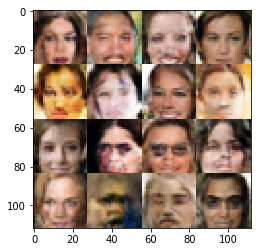

Epoch 7/50... Discriminator Loss: 1.2257... Generator Loss: 0.7441
Epoch 7/50... Discriminator Loss: 1.1011... Generator Loss: 0.7506
Epoch 7/50... Discriminator Loss: 1.0100... Generator Loss: 1.9122
Epoch 7/50... Discriminator Loss: 0.5668... Generator Loss: 1.4468
Epoch 7/50... Discriminator Loss: 1.1337... Generator Loss: 3.8237
Epoch 7/50... Discriminator Loss: 0.4688... Generator Loss: 2.7394
Epoch 7/50... Discriminator Loss: 0.5783... Generator Loss: 1.2561
Epoch 7/50... Discriminator Loss: 0.6411... Generator Loss: 1.0349
Epoch 7/50... Discriminator Loss: 0.3106... Generator Loss: 1.9298
Epoch 7/50... Discriminator Loss: 0.2834... Generator Loss: 2.0956


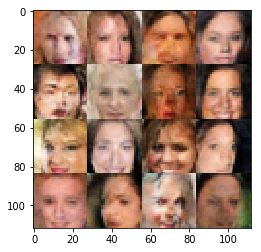

Epoch 7/50... Discriminator Loss: 0.6328... Generator Loss: 3.1420
Epoch 7/50... Discriminator Loss: 1.0685... Generator Loss: 0.6285
Epoch 7/50... Discriminator Loss: 0.3215... Generator Loss: 1.7263
Epoch 7/50... Discriminator Loss: 0.3137... Generator Loss: 4.4050
Epoch 7/50... Discriminator Loss: 0.1385... Generator Loss: 2.7386
Epoch 7/50... Discriminator Loss: 0.1044... Generator Loss: 3.9136
Epoch 7/50... Discriminator Loss: 0.0656... Generator Loss: 4.8949
Epoch 7/50... Discriminator Loss: 0.0766... Generator Loss: 3.8503
Epoch 7/50... Discriminator Loss: 0.3196... Generator Loss: 1.7502
Epoch 7/50... Discriminator Loss: 0.3123... Generator Loss: 5.3098


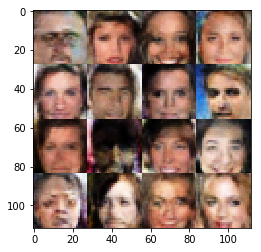

Epoch 7/50... Discriminator Loss: 0.2812... Generator Loss: 3.6139
Epoch 7/50... Discriminator Loss: 1.0163... Generator Loss: 0.7024
Epoch 7/50... Discriminator Loss: 0.7877... Generator Loss: 1.6394
Epoch 7/50... Discriminator Loss: 0.3242... Generator Loss: 2.1716
Epoch 7/50... Discriminator Loss: 0.5859... Generator Loss: 1.4140
Epoch 7/50... Discriminator Loss: 0.3099... Generator Loss: 1.8147
Epoch 7/50... Discriminator Loss: 0.6939... Generator Loss: 1.0483
Epoch 7/50... Discriminator Loss: 0.8491... Generator Loss: 0.8046
Epoch 7/50... Discriminator Loss: 0.0698... Generator Loss: 3.6169
Epoch 7/50... Discriminator Loss: 0.4063... Generator Loss: 4.2696


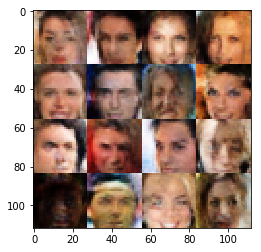

Epoch 7/50... Discriminator Loss: 1.5429... Generator Loss: 4.2173
Epoch 7/50... Discriminator Loss: 0.6215... Generator Loss: 1.1351
Epoch 7/50... Discriminator Loss: 0.5834... Generator Loss: 1.2131
Epoch 7/50... Discriminator Loss: 0.2955... Generator Loss: 1.9944
Epoch 7/50... Discriminator Loss: 0.3320... Generator Loss: 1.7298
Epoch 7/50... Discriminator Loss: 0.2594... Generator Loss: 2.8781
Epoch 7/50... Discriminator Loss: 0.3133... Generator Loss: 1.7621
Epoch 7/50... Discriminator Loss: 0.2341... Generator Loss: 2.1322
Epoch 7/50... Discriminator Loss: 0.1521... Generator Loss: 3.1127
Epoch 7/50... Discriminator Loss: 0.1594... Generator Loss: 2.6497


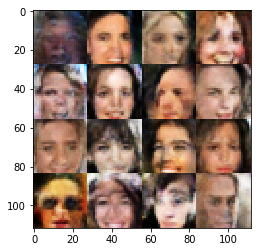

Epoch 7/50... Discriminator Loss: 0.2927... Generator Loss: 1.8269
Epoch 7/50... Discriminator Loss: 0.1410... Generator Loss: 2.6478
Epoch 7/50... Discriminator Loss: 0.2730... Generator Loss: 1.8903
Epoch 7/50... Discriminator Loss: 0.2504... Generator Loss: 1.9685
Epoch 7/50... Discriminator Loss: 0.1274... Generator Loss: 2.8336
Epoch 7/50... Discriminator Loss: 0.1058... Generator Loss: 3.0125
Epoch 7/50... Discriminator Loss: 0.0807... Generator Loss: 4.7686
Epoch 7/50... Discriminator Loss: 0.2002... Generator Loss: 2.3659
Epoch 7/50... Discriminator Loss: 0.1288... Generator Loss: 2.7577
Epoch 7/50... Discriminator Loss: 0.1247... Generator Loss: 2.6150


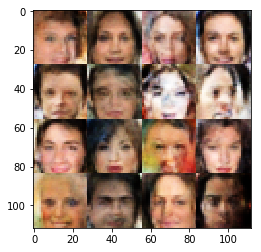

Epoch 7/50... Discriminator Loss: 0.5392... Generator Loss: 1.1705
Epoch 7/50... Discriminator Loss: 0.4676... Generator Loss: 1.3103
Epoch 7/50... Discriminator Loss: 0.1031... Generator Loss: 3.0910
Epoch 7/50... Discriminator Loss: 0.3529... Generator Loss: 1.5461
Epoch 7/50... Discriminator Loss: 0.0795... Generator Loss: 3.6186
Epoch 7/50... Discriminator Loss: 0.1841... Generator Loss: 2.2651
Epoch 7/50... Discriminator Loss: 0.1442... Generator Loss: 2.4179
Epoch 7/50... Discriminator Loss: 0.1862... Generator Loss: 2.2072
Epoch 7/50... Discriminator Loss: 0.0820... Generator Loss: 3.2970
Epoch 7/50... Discriminator Loss: 2.3828... Generator Loss: 0.1481


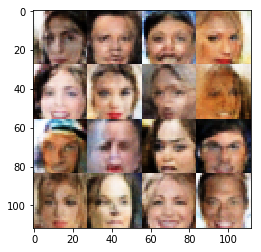

Epoch 7/50... Discriminator Loss: 0.6354... Generator Loss: 1.3946
Epoch 7/50... Discriminator Loss: 0.5581... Generator Loss: 1.7443
Epoch 7/50... Discriminator Loss: 1.3549... Generator Loss: 0.4454
Epoch 7/50... Discriminator Loss: 0.5361... Generator Loss: 1.2912
Epoch 7/50... Discriminator Loss: 0.2993... Generator Loss: 1.9421
Epoch 7/50... Discriminator Loss: 0.2695... Generator Loss: 3.8248
Epoch 7/50... Discriminator Loss: 0.4177... Generator Loss: 1.6473
Epoch 7/50... Discriminator Loss: 1.2659... Generator Loss: 4.2123
Epoch 7/50... Discriminator Loss: 0.5635... Generator Loss: 1.2263
Epoch 7/50... Discriminator Loss: 0.6283... Generator Loss: 1.1135


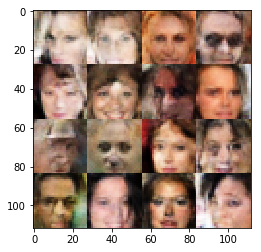

Epoch 7/50... Discriminator Loss: 0.2010... Generator Loss: 2.3176
Epoch 7/50... Discriminator Loss: 0.1075... Generator Loss: 3.4170
Epoch 7/50... Discriminator Loss: 0.0717... Generator Loss: 3.9395
Epoch 7/50... Discriminator Loss: 0.2530... Generator Loss: 1.9374
Epoch 7/50... Discriminator Loss: 0.0643... Generator Loss: 3.6356
Epoch 7/50... Discriminator Loss: 0.1961... Generator Loss: 2.4635
Epoch 7/50... Discriminator Loss: 0.2895... Generator Loss: 1.8207
Epoch 7/50... Discriminator Loss: 0.1231... Generator Loss: 2.7313
Epoch 7/50... Discriminator Loss: 0.3098... Generator Loss: 1.7541
Epoch 7/50... Discriminator Loss: 0.3351... Generator Loss: 1.7317


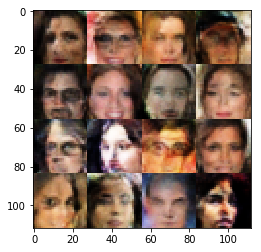

Epoch 7/50... Discriminator Loss: 0.2469... Generator Loss: 2.0260
Epoch 7/50... Discriminator Loss: 0.1254... Generator Loss: 3.1198
Epoch 7/50... Discriminator Loss: 0.2244... Generator Loss: 2.4083
Epoch 7/50... Discriminator Loss: 0.0884... Generator Loss: 3.6595
Epoch 7/50... Discriminator Loss: 0.2147... Generator Loss: 2.0678
Epoch 7/50... Discriminator Loss: 0.0819... Generator Loss: 4.4859
Epoch 7/50... Discriminator Loss: 0.1866... Generator Loss: 2.3252
Epoch 7/50... Discriminator Loss: 0.1967... Generator Loss: 2.2274
Epoch 7/50... Discriminator Loss: 0.1335... Generator Loss: 2.9189
Epoch 7/50... Discriminator Loss: 0.0936... Generator Loss: 3.3041


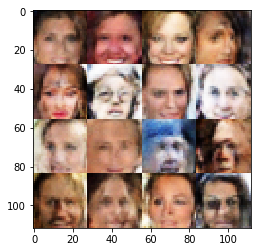

Epoch 7/50... Discriminator Loss: 0.3067... Generator Loss: 1.7489
Epoch 7/50... Discriminator Loss: 0.0416... Generator Loss: 4.9773
Epoch 7/50... Discriminator Loss: 0.2246... Generator Loss: 5.3164
Epoch 7/50... Discriminator Loss: 0.5051... Generator Loss: 1.3839
Epoch 7/50... Discriminator Loss: 0.2918... Generator Loss: 1.7672
Epoch 7/50... Discriminator Loss: 1.4461... Generator Loss: 0.3722
Epoch 7/50... Discriminator Loss: 0.1512... Generator Loss: 2.5673
Epoch 7/50... Discriminator Loss: 0.0768... Generator Loss: 3.2494
Epoch 7/50... Discriminator Loss: 0.1320... Generator Loss: 2.7157
Epoch 7/50... Discriminator Loss: 0.1619... Generator Loss: 3.7650


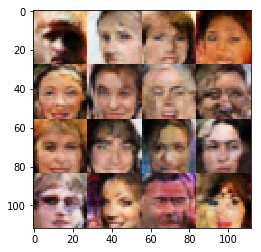

Epoch 7/50... Discriminator Loss: 0.0866... Generator Loss: 3.2836
Epoch 7/50... Discriminator Loss: 0.0891... Generator Loss: 3.2508
Epoch 7/50... Discriminator Loss: 0.0859... Generator Loss: 3.0126
Epoch 7/50... Discriminator Loss: 0.0567... Generator Loss: 3.7592
Epoch 7/50... Discriminator Loss: 0.7768... Generator Loss: 0.8422
Epoch 7/50... Discriminator Loss: 0.1114... Generator Loss: 2.9051
Epoch 7/50... Discriminator Loss: 4.6374... Generator Loss: 0.0395
Epoch 7/50... Discriminator Loss: 1.0554... Generator Loss: 1.3302
Epoch 7/50... Discriminator Loss: 0.7335... Generator Loss: 1.5819
Epoch 7/50... Discriminator Loss: 1.2885... Generator Loss: 0.5383


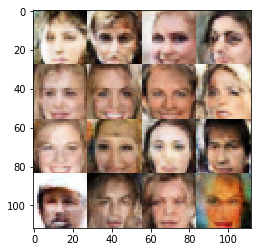

Epoch 7/50... Discriminator Loss: 0.3096... Generator Loss: 2.5693
Epoch 7/50... Discriminator Loss: 0.7836... Generator Loss: 0.8720
Epoch 7/50... Discriminator Loss: 0.8168... Generator Loss: 0.8102
Epoch 7/50... Discriminator Loss: 0.9172... Generator Loss: 0.7721
Epoch 7/50... Discriminator Loss: 0.1184... Generator Loss: 3.1592
Epoch 7/50... Discriminator Loss: 0.2483... Generator Loss: 2.9461
Epoch 7/50... Discriminator Loss: 0.1080... Generator Loss: 3.2774
Epoch 7/50... Discriminator Loss: 0.5526... Generator Loss: 1.2551
Epoch 7/50... Discriminator Loss: 0.5379... Generator Loss: 1.2400
Epoch 7/50... Discriminator Loss: 2.7888... Generator Loss: 0.1050


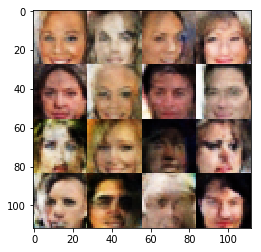

Epoch 7/50... Discriminator Loss: 1.0898... Generator Loss: 0.6962
Epoch 7/50... Discriminator Loss: 0.4414... Generator Loss: 2.3701
Epoch 7/50... Discriminator Loss: 0.1263... Generator Loss: 2.8562
Epoch 7/50... Discriminator Loss: 0.1143... Generator Loss: 3.8930
Epoch 7/50... Discriminator Loss: 0.1594... Generator Loss: 2.3732
Epoch 7/50... Discriminator Loss: 0.1978... Generator Loss: 2.5880
Epoch 7/50... Discriminator Loss: 1.5146... Generator Loss: 4.9811
Epoch 7/50... Discriminator Loss: 0.4907... Generator Loss: 1.3112
Epoch 7/50... Discriminator Loss: 0.7499... Generator Loss: 0.9743
Epoch 7/50... Discriminator Loss: 0.0910... Generator Loss: 3.4001


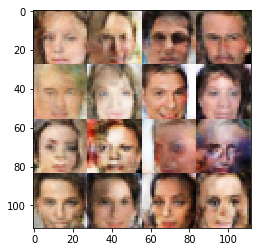

Epoch 7/50... Discriminator Loss: 0.1599... Generator Loss: 2.9989
Epoch 7/50... Discriminator Loss: 0.0724... Generator Loss: 3.2847
Epoch 7/50... Discriminator Loss: 0.0627... Generator Loss: 3.9930
Epoch 7/50... Discriminator Loss: 0.1296... Generator Loss: 2.6760
Epoch 7/50... Discriminator Loss: 0.1213... Generator Loss: 2.7886
Epoch 7/50... Discriminator Loss: 1.0426... Generator Loss: 0.6602
Epoch 7/50... Discriminator Loss: 0.0742... Generator Loss: 3.8403
Epoch 7/50... Discriminator Loss: 0.2907... Generator Loss: 1.7334
Epoch 7/50... Discriminator Loss: 0.0911... Generator Loss: 3.1857
Epoch 7/50... Discriminator Loss: 0.4596... Generator Loss: 1.3484


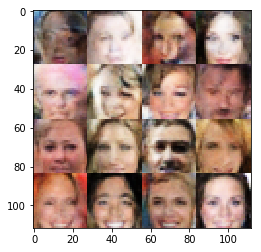

Epoch 7/50... Discriminator Loss: 0.0959... Generator Loss: 3.0930
Epoch 7/50... Discriminator Loss: 0.1495... Generator Loss: 2.8763
Epoch 7/50... Discriminator Loss: 0.0909... Generator Loss: 3.0546
Epoch 7/50... Discriminator Loss: 0.0670... Generator Loss: 3.4620
Epoch 7/50... Discriminator Loss: 0.1458... Generator Loss: 3.3593
Epoch 7/50... Discriminator Loss: 1.1613... Generator Loss: 0.5377
Epoch 7/50... Discriminator Loss: 0.1579... Generator Loss: 2.5313
Epoch 7/50... Discriminator Loss: 0.7122... Generator Loss: 0.9112
Epoch 7/50... Discriminator Loss: 0.1516... Generator Loss: 3.1113
Epoch 7/50... Discriminator Loss: 0.1577... Generator Loss: 2.4166


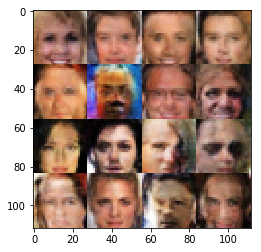

Epoch 7/50... Discriminator Loss: 0.1495... Generator Loss: 3.7626
Epoch 7/50... Discriminator Loss: 0.3461... Generator Loss: 1.5803
Epoch 7/50... Discriminator Loss: 0.0351... Generator Loss: 4.4649
Epoch 7/50... Discriminator Loss: 0.1215... Generator Loss: 2.6866
Epoch 7/50... Discriminator Loss: 0.3018... Generator Loss: 1.7007
Epoch 7/50... Discriminator Loss: 0.2659... Generator Loss: 1.9546
Epoch 7/50... Discriminator Loss: 0.3018... Generator Loss: 1.8257
Epoch 8/50... Discriminator Loss: 0.1132... Generator Loss: 2.9137
Epoch 8/50... Discriminator Loss: 0.2274... Generator Loss: 2.1086
Epoch 8/50... Discriminator Loss: 0.0735... Generator Loss: 3.3100


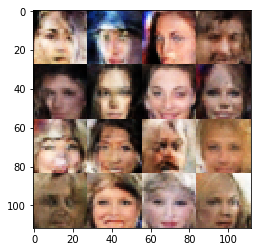

Epoch 8/50... Discriminator Loss: 0.0456... Generator Loss: 3.8841
Epoch 8/50... Discriminator Loss: 0.1433... Generator Loss: 2.4831
Epoch 8/50... Discriminator Loss: 0.0828... Generator Loss: 3.2025
Epoch 8/50... Discriminator Loss: 0.0654... Generator Loss: 3.8827
Epoch 8/50... Discriminator Loss: 0.4299... Generator Loss: 1.3998
Epoch 8/50... Discriminator Loss: 0.1417... Generator Loss: 2.6120
Epoch 8/50... Discriminator Loss: 0.0189... Generator Loss: 6.4076
Epoch 8/50... Discriminator Loss: 0.0682... Generator Loss: 3.6438
Epoch 8/50... Discriminator Loss: 5.6014... Generator Loss: 7.0342
Epoch 8/50... Discriminator Loss: 1.0540... Generator Loss: 1.3777


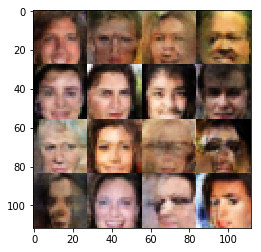

Epoch 8/50... Discriminator Loss: 0.6531... Generator Loss: 2.0016
Epoch 8/50... Discriminator Loss: 2.9891... Generator Loss: 0.0981
Epoch 8/50... Discriminator Loss: 0.3661... Generator Loss: 2.0717
Epoch 8/50... Discriminator Loss: 0.3853... Generator Loss: 2.0951
Epoch 8/50... Discriminator Loss: 1.3233... Generator Loss: 3.3702
Epoch 8/50... Discriminator Loss: 0.4752... Generator Loss: 3.7115
Epoch 8/50... Discriminator Loss: 0.3235... Generator Loss: 2.0720
Epoch 8/50... Discriminator Loss: 0.5094... Generator Loss: 1.4217
Epoch 8/50... Discriminator Loss: 0.3820... Generator Loss: 1.5377
Epoch 8/50... Discriminator Loss: 0.6352... Generator Loss: 1.0406


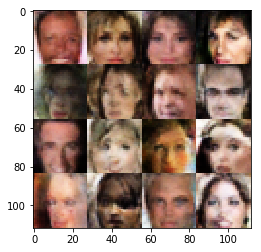

Epoch 8/50... Discriminator Loss: 0.3049... Generator Loss: 1.9344
Epoch 8/50... Discriminator Loss: 0.3583... Generator Loss: 1.5697
Epoch 8/50... Discriminator Loss: 0.2043... Generator Loss: 2.6754
Epoch 8/50... Discriminator Loss: 2.0351... Generator Loss: 3.9158
Epoch 8/50... Discriminator Loss: 1.0922... Generator Loss: 1.6307
Epoch 8/50... Discriminator Loss: 0.7929... Generator Loss: 1.0357
Epoch 8/50... Discriminator Loss: 0.6844... Generator Loss: 1.5394
Epoch 8/50... Discriminator Loss: 0.7901... Generator Loss: 2.5638
Epoch 8/50... Discriminator Loss: 0.7091... Generator Loss: 0.9589
Epoch 8/50... Discriminator Loss: 0.7476... Generator Loss: 0.9289


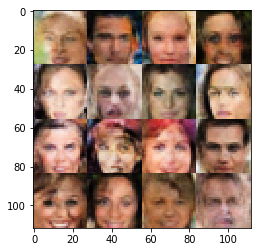

Epoch 8/50... Discriminator Loss: 0.4358... Generator Loss: 1.3960
Epoch 8/50... Discriminator Loss: 0.3631... Generator Loss: 1.6820
Epoch 8/50... Discriminator Loss: 0.3008... Generator Loss: 2.1442
Epoch 8/50... Discriminator Loss: 0.3295... Generator Loss: 1.7229
Epoch 8/50... Discriminator Loss: 0.2789... Generator Loss: 2.1381
Epoch 8/50... Discriminator Loss: 0.3833... Generator Loss: 1.6029
Epoch 8/50... Discriminator Loss: 0.6213... Generator Loss: 1.1064
Epoch 8/50... Discriminator Loss: 0.0540... Generator Loss: 4.1545
Epoch 8/50... Discriminator Loss: 0.3946... Generator Loss: 1.4499
Epoch 8/50... Discriminator Loss: 0.2657... Generator Loss: 2.0571


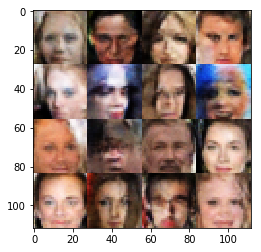

Epoch 8/50... Discriminator Loss: 0.0311... Generator Loss: 4.7927
Epoch 8/50... Discriminator Loss: 1.2521... Generator Loss: 0.5166
Epoch 8/50... Discriminator Loss: 2.8061... Generator Loss: 0.1328
Epoch 8/50... Discriminator Loss: 0.8279... Generator Loss: 1.4264
Epoch 8/50... Discriminator Loss: 0.5502... Generator Loss: 1.6824
Epoch 8/50... Discriminator Loss: 0.7393... Generator Loss: 0.9602
Epoch 8/50... Discriminator Loss: 0.3947... Generator Loss: 1.7053
Epoch 8/50... Discriminator Loss: 0.3150... Generator Loss: 2.7571
Epoch 8/50... Discriminator Loss: 3.8055... Generator Loss: 0.0412
Epoch 8/50... Discriminator Loss: 0.9741... Generator Loss: 1.0025


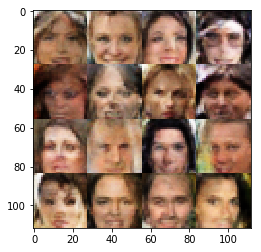

Epoch 8/50... Discriminator Loss: 1.0209... Generator Loss: 1.0456
Epoch 8/50... Discriminator Loss: 0.9618... Generator Loss: 0.8005
Epoch 8/50... Discriminator Loss: 1.0243... Generator Loss: 0.7360
Epoch 8/50... Discriminator Loss: 0.6269... Generator Loss: 1.1580
Epoch 8/50... Discriminator Loss: 0.8729... Generator Loss: 3.8039
Epoch 8/50... Discriminator Loss: 0.5880... Generator Loss: 1.2445
Epoch 8/50... Discriminator Loss: 0.3821... Generator Loss: 2.1544
Epoch 8/50... Discriminator Loss: 0.6041... Generator Loss: 1.2955
Epoch 8/50... Discriminator Loss: 0.5285... Generator Loss: 1.2426
Epoch 8/50... Discriminator Loss: 0.3524... Generator Loss: 1.6064


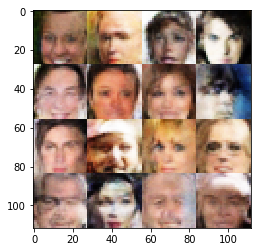

Epoch 8/50... Discriminator Loss: 0.4776... Generator Loss: 1.3285
Epoch 8/50... Discriminator Loss: 0.2531... Generator Loss: 2.0136
Epoch 8/50... Discriminator Loss: 0.1384... Generator Loss: 2.6029
Epoch 8/50... Discriminator Loss: 0.1955... Generator Loss: 3.4351
Epoch 8/50... Discriminator Loss: 0.7948... Generator Loss: 0.9788
Epoch 8/50... Discriminator Loss: 0.4948... Generator Loss: 1.3874
Epoch 8/50... Discriminator Loss: 0.4403... Generator Loss: 1.6064
Epoch 8/50... Discriminator Loss: 0.2123... Generator Loss: 2.4231
Epoch 8/50... Discriminator Loss: 0.5330... Generator Loss: 1.2701
Epoch 8/50... Discriminator Loss: 0.1998... Generator Loss: 2.2322


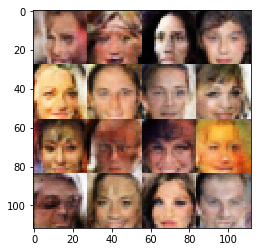

Epoch 8/50... Discriminator Loss: 0.4837... Generator Loss: 1.4522
Epoch 8/50... Discriminator Loss: 0.1748... Generator Loss: 2.4419
Epoch 8/50... Discriminator Loss: 0.4393... Generator Loss: 1.4882
Epoch 8/50... Discriminator Loss: 0.1505... Generator Loss: 2.5012
Epoch 8/50... Discriminator Loss: 0.2478... Generator Loss: 2.0951
Epoch 8/50... Discriminator Loss: 0.1244... Generator Loss: 3.1068
Epoch 8/50... Discriminator Loss: 0.2453... Generator Loss: 2.0067
Epoch 8/50... Discriminator Loss: 0.3612... Generator Loss: 1.5801
Epoch 8/50... Discriminator Loss: 0.1542... Generator Loss: 2.6066
Epoch 8/50... Discriminator Loss: 0.1854... Generator Loss: 2.3495


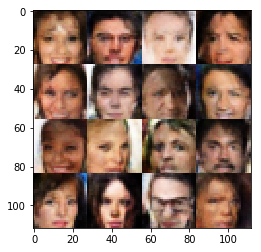

Epoch 8/50... Discriminator Loss: 0.8913... Generator Loss: 0.7061
Epoch 8/50... Discriminator Loss: 0.2043... Generator Loss: 2.2888
Epoch 8/50... Discriminator Loss: 0.1756... Generator Loss: 2.8566
Epoch 8/50... Discriminator Loss: 0.3443... Generator Loss: 1.6046
Epoch 8/50... Discriminator Loss: 0.6470... Generator Loss: 1.0222
Epoch 8/50... Discriminator Loss: 0.1203... Generator Loss: 3.4980
Epoch 8/50... Discriminator Loss: 0.2865... Generator Loss: 1.8175
Epoch 8/50... Discriminator Loss: 0.4247... Generator Loss: 1.4194
Epoch 8/50... Discriminator Loss: 0.1321... Generator Loss: 2.7374
Epoch 8/50... Discriminator Loss: 0.1281... Generator Loss: 2.7970


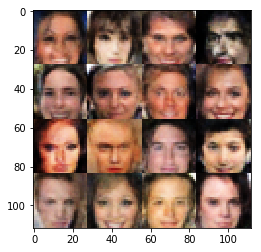

Epoch 8/50... Discriminator Loss: 0.2680... Generator Loss: 1.9472
Epoch 8/50... Discriminator Loss: 0.2631... Generator Loss: 1.9712
Epoch 8/50... Discriminator Loss: 0.2680... Generator Loss: 1.9955
Epoch 8/50... Discriminator Loss: 0.1317... Generator Loss: 3.3504
Epoch 8/50... Discriminator Loss: 0.2036... Generator Loss: 2.2056
Epoch 8/50... Discriminator Loss: 0.1845... Generator Loss: 2.3256
Epoch 8/50... Discriminator Loss: 0.1057... Generator Loss: 3.3044
Epoch 8/50... Discriminator Loss: 0.1876... Generator Loss: 5.4157
Epoch 8/50... Discriminator Loss: 0.1430... Generator Loss: 2.4739
Epoch 8/50... Discriminator Loss: 0.1116... Generator Loss: 2.8466


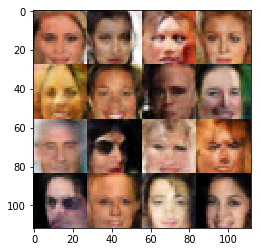

Epoch 8/50... Discriminator Loss: 0.2342... Generator Loss: 2.0930
Epoch 8/50... Discriminator Loss: 0.0457... Generator Loss: 4.2130
Epoch 8/50... Discriminator Loss: 0.1208... Generator Loss: 2.8477
Epoch 8/50... Discriminator Loss: 0.1009... Generator Loss: 2.9178
Epoch 8/50... Discriminator Loss: 0.1341... Generator Loss: 2.5331
Epoch 8/50... Discriminator Loss: 0.1668... Generator Loss: 2.5063
Epoch 8/50... Discriminator Loss: 0.1894... Generator Loss: 2.2937
Epoch 8/50... Discriminator Loss: 0.1734... Generator Loss: 2.4201
Epoch 8/50... Discriminator Loss: 0.0786... Generator Loss: 3.2084
Epoch 8/50... Discriminator Loss: 0.4329... Generator Loss: 1.3195


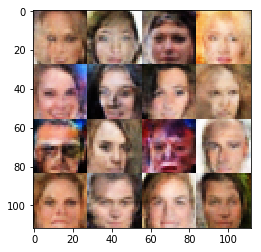

Epoch 8/50... Discriminator Loss: 0.1416... Generator Loss: 2.5691
Epoch 8/50... Discriminator Loss: 0.3773... Generator Loss: 1.4852
Epoch 8/50... Discriminator Loss: 0.1675... Generator Loss: 2.5282
Epoch 8/50... Discriminator Loss: 0.9365... Generator Loss: 4.8135
Epoch 8/50... Discriminator Loss: 0.6111... Generator Loss: 1.1524
Epoch 8/50... Discriminator Loss: 0.5354... Generator Loss: 1.2314
Epoch 8/50... Discriminator Loss: 1.8187... Generator Loss: 0.3007
Epoch 8/50... Discriminator Loss: 0.2991... Generator Loss: 3.0216
Epoch 8/50... Discriminator Loss: 0.3625... Generator Loss: 1.6535
Epoch 8/50... Discriminator Loss: 0.4873... Generator Loss: 1.3136


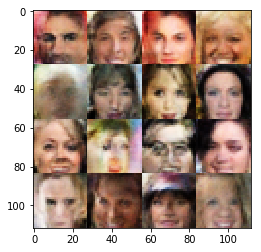

Epoch 8/50... Discriminator Loss: 0.2422... Generator Loss: 2.7162
Epoch 8/50... Discriminator Loss: 0.0938... Generator Loss: 3.3893
Epoch 8/50... Discriminator Loss: 0.4898... Generator Loss: 1.3911
Epoch 8/50... Discriminator Loss: 0.5543... Generator Loss: 1.1507
Epoch 8/50... Discriminator Loss: 0.4682... Generator Loss: 1.4569
Epoch 8/50... Discriminator Loss: 1.5962... Generator Loss: 0.3956
Epoch 8/50... Discriminator Loss: 0.3066... Generator Loss: 1.7019
Epoch 8/50... Discriminator Loss: 0.2322... Generator Loss: 2.3654
Epoch 8/50... Discriminator Loss: 0.2082... Generator Loss: 2.5109
Epoch 8/50... Discriminator Loss: 0.2068... Generator Loss: 2.1973


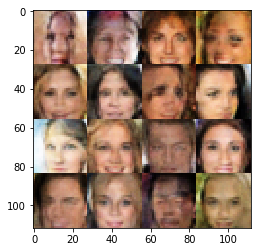

Epoch 8/50... Discriminator Loss: 0.0799... Generator Loss: 3.3767
Epoch 8/50... Discriminator Loss: 0.0877... Generator Loss: 3.5097
Epoch 8/50... Discriminator Loss: 0.2555... Generator Loss: 1.9806
Epoch 8/50... Discriminator Loss: 0.1706... Generator Loss: 2.8469
Epoch 8/50... Discriminator Loss: 3.5400... Generator Loss: 0.0622
Epoch 8/50... Discriminator Loss: 1.0970... Generator Loss: 0.6864
Epoch 8/50... Discriminator Loss: 1.6275... Generator Loss: 0.3335
Epoch 8/50... Discriminator Loss: 0.9498... Generator Loss: 1.1398
Epoch 8/50... Discriminator Loss: 1.7984... Generator Loss: 0.2962
Epoch 8/50... Discriminator Loss: 0.8525... Generator Loss: 1.0811


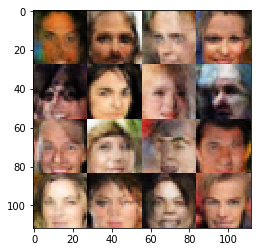

Epoch 8/50... Discriminator Loss: 0.5749... Generator Loss: 1.5119
Epoch 8/50... Discriminator Loss: 0.7219... Generator Loss: 1.0447
Epoch 8/50... Discriminator Loss: 1.3806... Generator Loss: 0.5028
Epoch 8/50... Discriminator Loss: 0.6251... Generator Loss: 1.2105
Epoch 8/50... Discriminator Loss: 0.3175... Generator Loss: 2.7872
Epoch 8/50... Discriminator Loss: 0.3038... Generator Loss: 1.8459
Epoch 8/50... Discriminator Loss: 0.3257... Generator Loss: 1.9593
Epoch 8/50... Discriminator Loss: 1.0001... Generator Loss: 0.6897
Epoch 8/50... Discriminator Loss: 1.8622... Generator Loss: 0.2679
Epoch 8/50... Discriminator Loss: 0.2635... Generator Loss: 2.2289


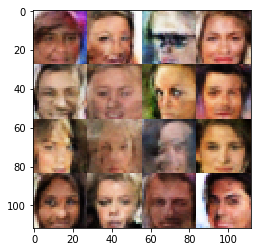

Epoch 8/50... Discriminator Loss: 0.7199... Generator Loss: 0.9783
Epoch 8/50... Discriminator Loss: 0.2948... Generator Loss: 1.9404
Epoch 8/50... Discriminator Loss: 1.0399... Generator Loss: 4.4093
Epoch 8/50... Discriminator Loss: 0.2297... Generator Loss: 2.1480
Epoch 8/50... Discriminator Loss: 0.1360... Generator Loss: 3.0088
Epoch 9/50... Discriminator Loss: 0.6409... Generator Loss: 1.2165
Epoch 9/50... Discriminator Loss: 0.1995... Generator Loss: 2.5981
Epoch 9/50... Discriminator Loss: 0.2354... Generator Loss: 2.1732
Epoch 9/50... Discriminator Loss: 0.2281... Generator Loss: 1.9521
Epoch 9/50... Discriminator Loss: 0.8886... Generator Loss: 0.7913


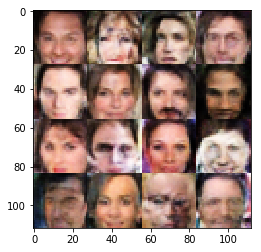

Epoch 9/50... Discriminator Loss: 0.2578... Generator Loss: 2.0840
Epoch 9/50... Discriminator Loss: 0.1820... Generator Loss: 2.3872
Epoch 9/50... Discriminator Loss: 7.6261... Generator Loss: 8.8067
Epoch 9/50... Discriminator Loss: 1.1587... Generator Loss: 1.1451
Epoch 9/50... Discriminator Loss: 1.4386... Generator Loss: 0.5310
Epoch 9/50... Discriminator Loss: 1.1824... Generator Loss: 0.9455
Epoch 9/50... Discriminator Loss: 1.1932... Generator Loss: 0.7465
Epoch 9/50... Discriminator Loss: 1.2378... Generator Loss: 1.0945
Epoch 9/50... Discriminator Loss: 1.2519... Generator Loss: 0.6644
Epoch 9/50... Discriminator Loss: 1.1721... Generator Loss: 0.8424


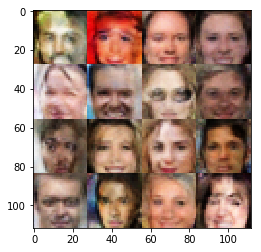

Epoch 9/50... Discriminator Loss: 1.3266... Generator Loss: 1.4598
Epoch 9/50... Discriminator Loss: 1.1948... Generator Loss: 0.8373
Epoch 9/50... Discriminator Loss: 1.1446... Generator Loss: 1.1461
Epoch 9/50... Discriminator Loss: 1.0282... Generator Loss: 1.3478
Epoch 9/50... Discriminator Loss: 0.9592... Generator Loss: 1.0555
Epoch 9/50... Discriminator Loss: 1.0042... Generator Loss: 1.0250
Epoch 9/50... Discriminator Loss: 0.9396... Generator Loss: 1.2021
Epoch 9/50... Discriminator Loss: 0.6767... Generator Loss: 1.7387
Epoch 9/50... Discriminator Loss: 0.9600... Generator Loss: 0.7387
Epoch 9/50... Discriminator Loss: 0.7163... Generator Loss: 2.7868


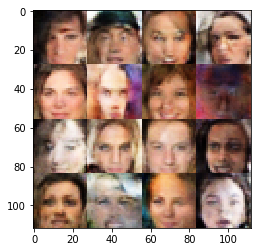

Epoch 9/50... Discriminator Loss: 4.4649... Generator Loss: 7.3658
Epoch 9/50... Discriminator Loss: 0.7886... Generator Loss: 1.2834
Epoch 9/50... Discriminator Loss: 1.6431... Generator Loss: 4.5059
Epoch 9/50... Discriminator Loss: 0.4180... Generator Loss: 1.6599
Epoch 9/50... Discriminator Loss: 0.3253... Generator Loss: 1.7932
Epoch 9/50... Discriminator Loss: 0.4360... Generator Loss: 1.4711
Epoch 9/50... Discriminator Loss: 0.4500... Generator Loss: 1.4897
Epoch 9/50... Discriminator Loss: 0.1648... Generator Loss: 2.4256
Epoch 9/50... Discriminator Loss: 0.1822... Generator Loss: 4.1237
Epoch 9/50... Discriminator Loss: 0.2040... Generator Loss: 2.3766


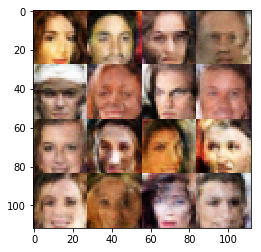

Epoch 9/50... Discriminator Loss: 0.2184... Generator Loss: 2.1660
Epoch 9/50... Discriminator Loss: 0.4398... Generator Loss: 1.3143
Epoch 9/50... Discriminator Loss: 0.1928... Generator Loss: 2.4295
Epoch 9/50... Discriminator Loss: 0.1802... Generator Loss: 2.5463
Epoch 9/50... Discriminator Loss: 0.5374... Generator Loss: 1.1885
Epoch 9/50... Discriminator Loss: 0.1962... Generator Loss: 2.5325
Epoch 9/50... Discriminator Loss: 0.2123... Generator Loss: 2.3200
Epoch 9/50... Discriminator Loss: 0.3941... Generator Loss: 1.4472
Epoch 9/50... Discriminator Loss: 0.4884... Generator Loss: 1.2622
Epoch 9/50... Discriminator Loss: 0.3733... Generator Loss: 1.5365


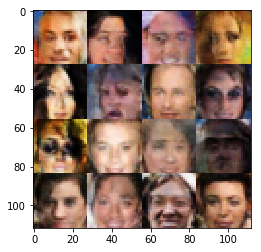

Epoch 9/50... Discriminator Loss: 0.0613... Generator Loss: 3.8132
Epoch 9/50... Discriminator Loss: 0.2137... Generator Loss: 2.1041
Epoch 9/50... Discriminator Loss: 0.2410... Generator Loss: 1.9109
Epoch 9/50... Discriminator Loss: 0.3496... Generator Loss: 1.5655
Epoch 9/50... Discriminator Loss: 0.5400... Generator Loss: 1.2172
Epoch 9/50... Discriminator Loss: 0.6698... Generator Loss: 0.9632
Epoch 9/50... Discriminator Loss: 0.7125... Generator Loss: 0.9096
Epoch 9/50... Discriminator Loss: 0.2832... Generator Loss: 1.8537
Epoch 9/50... Discriminator Loss: 0.1803... Generator Loss: 2.3655
Epoch 9/50... Discriminator Loss: 0.1472... Generator Loss: 2.6379


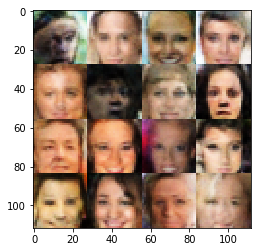

Epoch 9/50... Discriminator Loss: 0.2198... Generator Loss: 2.2224
Epoch 9/50... Discriminator Loss: 0.2547... Generator Loss: 1.9331
Epoch 9/50... Discriminator Loss: 0.0593... Generator Loss: 4.0629
Epoch 9/50... Discriminator Loss: 0.2976... Generator Loss: 1.8578
Epoch 9/50... Discriminator Loss: 0.0374... Generator Loss: 4.3461
Epoch 9/50... Discriminator Loss: 0.1489... Generator Loss: 2.6969
Epoch 9/50... Discriminator Loss: 0.0441... Generator Loss: 4.2710
Epoch 9/50... Discriminator Loss: 0.5329... Generator Loss: 1.1577
Epoch 9/50... Discriminator Loss: 0.0569... Generator Loss: 3.9366
Epoch 9/50... Discriminator Loss: 0.9557... Generator Loss: 0.7057


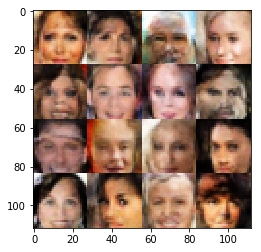

Epoch 9/50... Discriminator Loss: 0.0721... Generator Loss: 3.3460
Epoch 9/50... Discriminator Loss: 0.1257... Generator Loss: 2.7579
Epoch 9/50... Discriminator Loss: 1.9420... Generator Loss: 0.4418
Epoch 9/50... Discriminator Loss: 1.1779... Generator Loss: 0.9814
Epoch 9/50... Discriminator Loss: 1.2566... Generator Loss: 1.3140
Epoch 9/50... Discriminator Loss: 0.9522... Generator Loss: 1.2803
Epoch 9/50... Discriminator Loss: 1.0611... Generator Loss: 0.6618
Epoch 9/50... Discriminator Loss: 0.8385... Generator Loss: 1.0430
Epoch 9/50... Discriminator Loss: 0.5905... Generator Loss: 1.2380
Epoch 9/50... Discriminator Loss: 0.5298... Generator Loss: 1.2678


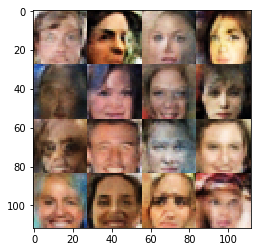

Epoch 9/50... Discriminator Loss: 0.7935... Generator Loss: 3.4049
Epoch 9/50... Discriminator Loss: 0.0704... Generator Loss: 3.9734
Epoch 9/50... Discriminator Loss: 0.4609... Generator Loss: 1.5145
Epoch 9/50... Discriminator Loss: 0.5618... Generator Loss: 1.2697
Epoch 9/50... Discriminator Loss: 0.4117... Generator Loss: 1.9538
Epoch 9/50... Discriminator Loss: 0.5317... Generator Loss: 1.2834
Epoch 9/50... Discriminator Loss: 0.3444... Generator Loss: 1.7292
Epoch 9/50... Discriminator Loss: 0.1288... Generator Loss: 3.1214
Epoch 9/50... Discriminator Loss: 0.2860... Generator Loss: 2.0876
Epoch 9/50... Discriminator Loss: 0.7219... Generator Loss: 2.0391


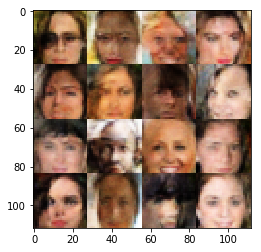

Epoch 9/50... Discriminator Loss: 0.5688... Generator Loss: 1.7752
Epoch 9/50... Discriminator Loss: 0.4216... Generator Loss: 1.9237
Epoch 9/50... Discriminator Loss: 0.3510... Generator Loss: 2.2740
Epoch 9/50... Discriminator Loss: 0.5481... Generator Loss: 1.5223
Epoch 9/50... Discriminator Loss: 0.2418... Generator Loss: 2.2274
Epoch 9/50... Discriminator Loss: 0.3255... Generator Loss: 1.9749
Epoch 9/50... Discriminator Loss: 0.0644... Generator Loss: 3.5051
Epoch 9/50... Discriminator Loss: 0.3314... Generator Loss: 1.7271
Epoch 9/50... Discriminator Loss: 0.2899... Generator Loss: 1.8790
Epoch 9/50... Discriminator Loss: 0.3966... Generator Loss: 1.5526


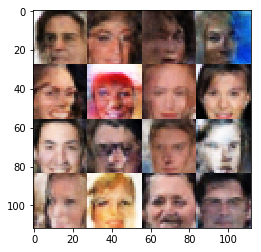

Epoch 9/50... Discriminator Loss: 0.4113... Generator Loss: 1.3893
Epoch 9/50... Discriminator Loss: 0.2292... Generator Loss: 2.0604
Epoch 9/50... Discriminator Loss: 0.1487... Generator Loss: 2.4357
Epoch 9/50... Discriminator Loss: 0.2272... Generator Loss: 2.1272
Epoch 9/50... Discriminator Loss: 0.2801... Generator Loss: 1.9024
Epoch 9/50... Discriminator Loss: 0.3124... Generator Loss: 1.7825
Epoch 9/50... Discriminator Loss: 0.2739... Generator Loss: 1.8347
Epoch 9/50... Discriminator Loss: 0.2949... Generator Loss: 1.7759
Epoch 9/50... Discriminator Loss: 0.5029... Generator Loss: 1.2586
Epoch 9/50... Discriminator Loss: 0.4554... Generator Loss: 1.4160


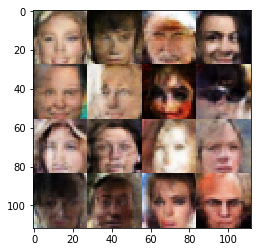

Epoch 9/50... Discriminator Loss: 0.2388... Generator Loss: 2.0917
Epoch 9/50... Discriminator Loss: 0.0761... Generator Loss: 3.6434
Epoch 9/50... Discriminator Loss: 2.3022... Generator Loss: 0.3251
Epoch 9/50... Discriminator Loss: 0.7573... Generator Loss: 1.0771
Epoch 9/50... Discriminator Loss: 0.3784... Generator Loss: 2.0958
Epoch 9/50... Discriminator Loss: 0.3207... Generator Loss: 1.8531
Epoch 9/50... Discriminator Loss: 0.4271... Generator Loss: 1.6413
Epoch 9/50... Discriminator Loss: 0.2868... Generator Loss: 1.9952
Epoch 9/50... Discriminator Loss: 0.2441... Generator Loss: 2.1446
Epoch 9/50... Discriminator Loss: 0.4483... Generator Loss: 1.4648


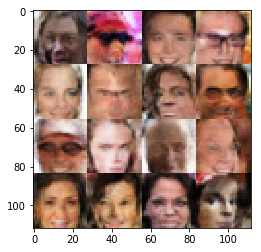

Epoch 9/50... Discriminator Loss: 0.2613... Generator Loss: 2.0750
Epoch 9/50... Discriminator Loss: 0.4112... Generator Loss: 1.4477
Epoch 9/50... Discriminator Loss: 0.1955... Generator Loss: 2.3984
Epoch 9/50... Discriminator Loss: 0.1962... Generator Loss: 2.2210
Epoch 9/50... Discriminator Loss: 0.5871... Generator Loss: 1.1521
Epoch 9/50... Discriminator Loss: 0.0685... Generator Loss: 3.4153
Epoch 9/50... Discriminator Loss: 0.2198... Generator Loss: 5.1570
Epoch 9/50... Discriminator Loss: 0.5256... Generator Loss: 1.2507
Epoch 9/50... Discriminator Loss: 0.4186... Generator Loss: 1.4537
Epoch 9/50... Discriminator Loss: 0.1162... Generator Loss: 3.0520


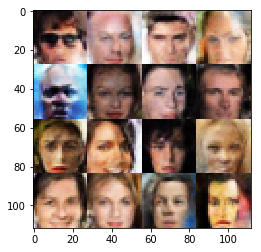

Epoch 9/50... Discriminator Loss: 0.1616... Generator Loss: 2.6538
Epoch 9/50... Discriminator Loss: 0.1099... Generator Loss: 3.1162
Epoch 9/50... Discriminator Loss: 0.1416... Generator Loss: 2.6336
Epoch 9/50... Discriminator Loss: 0.2166... Generator Loss: 2.0391
Epoch 9/50... Discriminator Loss: 1.4335... Generator Loss: 1.5553
Epoch 9/50... Discriminator Loss: 1.3924... Generator Loss: 0.5713
Epoch 9/50... Discriminator Loss: 1.2984... Generator Loss: 0.9772
Epoch 9/50... Discriminator Loss: 1.2554... Generator Loss: 1.3045
Epoch 9/50... Discriminator Loss: 1.2789... Generator Loss: 0.4817
Epoch 9/50... Discriminator Loss: 1.2679... Generator Loss: 2.2455


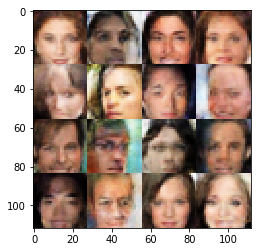

Epoch 9/50... Discriminator Loss: 0.8816... Generator Loss: 1.0469
Epoch 9/50... Discriminator Loss: 1.3236... Generator Loss: 3.7611
Epoch 9/50... Discriminator Loss: 0.8544... Generator Loss: 0.7821
Epoch 9/50... Discriminator Loss: 0.4021... Generator Loss: 2.6030
Epoch 9/50... Discriminator Loss: 1.6959... Generator Loss: 0.3410
Epoch 9/50... Discriminator Loss: 0.4850... Generator Loss: 1.5612
Epoch 9/50... Discriminator Loss: 0.3618... Generator Loss: 1.8335
Epoch 9/50... Discriminator Loss: 1.1384... Generator Loss: 0.5720
Epoch 9/50... Discriminator Loss: 0.5717... Generator Loss: 1.1765
Epoch 9/50... Discriminator Loss: 0.4326... Generator Loss: 1.4102


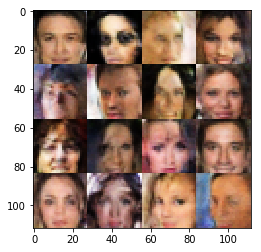

Epoch 9/50... Discriminator Loss: 0.2283... Generator Loss: 2.7383
Epoch 9/50... Discriminator Loss: 0.2852... Generator Loss: 1.8131
Epoch 9/50... Discriminator Loss: 0.2058... Generator Loss: 2.2651
Epoch 9/50... Discriminator Loss: 0.4268... Generator Loss: 1.4377
Epoch 9/50... Discriminator Loss: 0.4575... Generator Loss: 1.2708
Epoch 9/50... Discriminator Loss: 0.1775... Generator Loss: 2.9862
Epoch 9/50... Discriminator Loss: 0.2744... Generator Loss: 1.8370
Epoch 9/50... Discriminator Loss: 0.1972... Generator Loss: 2.2578
Epoch 9/50... Discriminator Loss: 0.1379... Generator Loss: 2.6161
Epoch 9/50... Discriminator Loss: 0.6280... Generator Loss: 1.0501


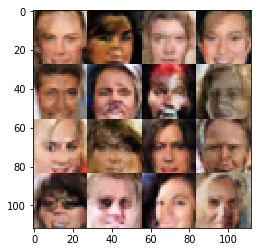

Epoch 9/50... Discriminator Loss: 0.1814... Generator Loss: 2.2739
Epoch 9/50... Discriminator Loss: 0.3455... Generator Loss: 1.5826
Epoch 9/50... Discriminator Loss: 0.2282... Generator Loss: 2.1634
Epoch 10/50... Discriminator Loss: 0.1172... Generator Loss: 2.8679
Epoch 10/50... Discriminator Loss: 0.5195... Generator Loss: 1.2000
Epoch 10/50... Discriminator Loss: 0.2743... Generator Loss: 1.8074
Epoch 10/50... Discriminator Loss: 0.4663... Generator Loss: 1.3669
Epoch 10/50... Discriminator Loss: 0.3292... Generator Loss: 1.6123
Epoch 10/50... Discriminator Loss: 0.0821... Generator Loss: 3.2785
Epoch 10/50... Discriminator Loss: 0.3932... Generator Loss: 1.5406


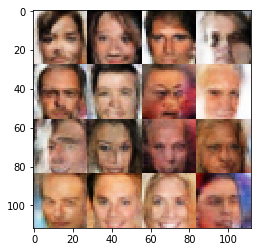

Epoch 10/50... Discriminator Loss: 0.1314... Generator Loss: 2.8496
Epoch 10/50... Discriminator Loss: 0.4699... Generator Loss: 1.2473
Epoch 10/50... Discriminator Loss: 0.1017... Generator Loss: 3.4157
Epoch 10/50... Discriminator Loss: 0.1151... Generator Loss: 2.8293
Epoch 10/50... Discriminator Loss: 0.2774... Generator Loss: 1.8090
Epoch 10/50... Discriminator Loss: 6.4466... Generator Loss: 0.0244
Epoch 10/50... Discriminator Loss: 0.8520... Generator Loss: 0.8274
Epoch 10/50... Discriminator Loss: 0.6758... Generator Loss: 1.1563
Epoch 10/50... Discriminator Loss: 0.4353... Generator Loss: 1.5108
Epoch 10/50... Discriminator Loss: 0.2779... Generator Loss: 2.0252


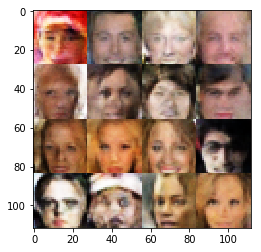

Epoch 10/50... Discriminator Loss: 0.4400... Generator Loss: 2.0323
Epoch 10/50... Discriminator Loss: 0.5518... Generator Loss: 1.2583
Epoch 10/50... Discriminator Loss: 0.2037... Generator Loss: 2.3999
Epoch 10/50... Discriminator Loss: 0.2954... Generator Loss: 1.9812
Epoch 10/50... Discriminator Loss: 0.2947... Generator Loss: 1.7997
Epoch 10/50... Discriminator Loss: 0.6035... Generator Loss: 1.0780
Epoch 10/50... Discriminator Loss: 0.2772... Generator Loss: 1.9823
Epoch 10/50... Discriminator Loss: 0.1455... Generator Loss: 2.4214
Epoch 10/50... Discriminator Loss: 0.7433... Generator Loss: 3.4894
Epoch 10/50... Discriminator Loss: 0.6584... Generator Loss: 1.7964


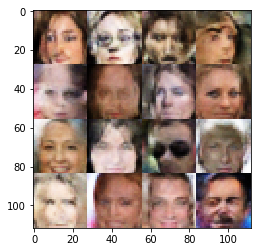

Epoch 10/50... Discriminator Loss: 0.4392... Generator Loss: 1.6981
Epoch 10/50... Discriminator Loss: 0.3616... Generator Loss: 1.8396
Epoch 10/50... Discriminator Loss: 0.4970... Generator Loss: 1.5177
Epoch 10/50... Discriminator Loss: 0.3482... Generator Loss: 1.6628
Epoch 10/50... Discriminator Loss: 0.2376... Generator Loss: 2.1830
Epoch 10/50... Discriminator Loss: 0.3380... Generator Loss: 1.7363
Epoch 10/50... Discriminator Loss: 0.3350... Generator Loss: 1.9966
Epoch 10/50... Discriminator Loss: 0.3295... Generator Loss: 1.7495
Epoch 10/50... Discriminator Loss: 0.7238... Generator Loss: 0.9377
Epoch 10/50... Discriminator Loss: 0.0903... Generator Loss: 3.4320


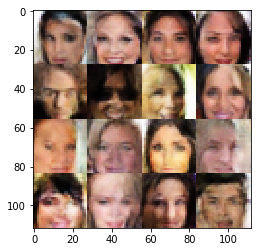

Epoch 10/50... Discriminator Loss: 0.4476... Generator Loss: 1.3920
Epoch 10/50... Discriminator Loss: 0.2439... Generator Loss: 1.9905
Epoch 10/50... Discriminator Loss: 0.2865... Generator Loss: 1.9918
Epoch 10/50... Discriminator Loss: 0.2693... Generator Loss: 1.9613
Epoch 10/50... Discriminator Loss: 0.1797... Generator Loss: 2.3253
Epoch 10/50... Discriminator Loss: 0.2033... Generator Loss: 2.5671
Epoch 10/50... Discriminator Loss: 0.2100... Generator Loss: 2.6932
Epoch 10/50... Discriminator Loss: 0.1852... Generator Loss: 2.3047
Epoch 10/50... Discriminator Loss: 2.4049... Generator Loss: 4.1545
Epoch 10/50... Discriminator Loss: 0.7229... Generator Loss: 1.0722


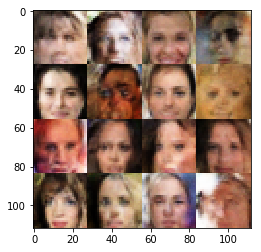

Epoch 10/50... Discriminator Loss: 1.2506... Generator Loss: 0.5157
Epoch 10/50... Discriminator Loss: 0.3729... Generator Loss: 1.5982
Epoch 10/50... Discriminator Loss: 0.8559... Generator Loss: 0.7145
Epoch 10/50... Discriminator Loss: 0.2986... Generator Loss: 1.8606
Epoch 10/50... Discriminator Loss: 0.1477... Generator Loss: 2.7384
Epoch 10/50... Discriminator Loss: 0.4754... Generator Loss: 1.4519
Epoch 10/50... Discriminator Loss: 0.2411... Generator Loss: 1.9955
Epoch 10/50... Discriminator Loss: 0.1970... Generator Loss: 2.2583
Epoch 10/50... Discriminator Loss: 0.4125... Generator Loss: 1.5285
Epoch 10/50... Discriminator Loss: 0.0887... Generator Loss: 3.0401


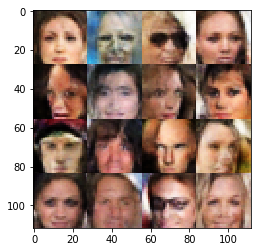

Epoch 10/50... Discriminator Loss: 1.3183... Generator Loss: 0.4843
Epoch 10/50... Discriminator Loss: 0.2441... Generator Loss: 1.9881
Epoch 10/50... Discriminator Loss: 0.7075... Generator Loss: 0.9664
Epoch 10/50... Discriminator Loss: 0.4175... Generator Loss: 1.4729
Epoch 10/50... Discriminator Loss: 0.2442... Generator Loss: 2.0212
Epoch 10/50... Discriminator Loss: 0.3911... Generator Loss: 1.5012
Epoch 10/50... Discriminator Loss: 0.0868... Generator Loss: 3.1139
Epoch 10/50... Discriminator Loss: 0.1546... Generator Loss: 2.6704
Epoch 10/50... Discriminator Loss: 0.1698... Generator Loss: 2.6550
Epoch 10/50... Discriminator Loss: 0.1277... Generator Loss: 2.8722


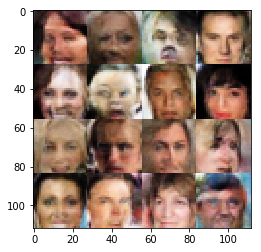

Epoch 10/50... Discriminator Loss: 0.2731... Generator Loss: 1.8135
Epoch 10/50... Discriminator Loss: 0.2432... Generator Loss: 2.4016
Epoch 10/50... Discriminator Loss: 0.4660... Generator Loss: 1.3384
Epoch 10/50... Discriminator Loss: 0.3885... Generator Loss: 1.4331
Epoch 10/50... Discriminator Loss: 0.2074... Generator Loss: 2.0959
Epoch 10/50... Discriminator Loss: 0.1936... Generator Loss: 2.1701
Epoch 10/50... Discriminator Loss: 0.2675... Generator Loss: 1.8881
Epoch 10/50... Discriminator Loss: 0.6468... Generator Loss: 0.9723
Epoch 10/50... Discriminator Loss: 0.5388... Generator Loss: 5.2950
Epoch 10/50... Discriminator Loss: 0.3629... Generator Loss: 1.6800


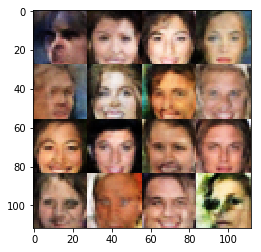

Epoch 10/50... Discriminator Loss: 0.2502... Generator Loss: 1.9449
Epoch 10/50... Discriminator Loss: 0.5435... Generator Loss: 1.1280
Epoch 10/50... Discriminator Loss: 0.1819... Generator Loss: 2.3397
Epoch 10/50... Discriminator Loss: 0.0973... Generator Loss: 3.4871
Epoch 10/50... Discriminator Loss: 0.3683... Generator Loss: 1.5880
Epoch 10/50... Discriminator Loss: 0.1432... Generator Loss: 2.6471
Epoch 10/50... Discriminator Loss: 0.3431... Generator Loss: 1.5767
Epoch 10/50... Discriminator Loss: 0.1915... Generator Loss: 2.3217
Epoch 10/50... Discriminator Loss: 0.1872... Generator Loss: 2.2776
Epoch 10/50... Discriminator Loss: 0.2659... Generator Loss: 1.9302


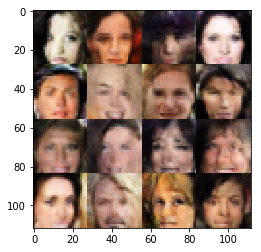

Epoch 10/50... Discriminator Loss: 0.2429... Generator Loss: 2.0122
Epoch 10/50... Discriminator Loss: 0.2467... Generator Loss: 2.0176
Epoch 10/50... Discriminator Loss: 0.2980... Generator Loss: 1.8943
Epoch 10/50... Discriminator Loss: 0.7438... Generator Loss: 0.9786
Epoch 10/50... Discriminator Loss: 0.4453... Generator Loss: 1.3629
Epoch 10/50... Discriminator Loss: 0.4125... Generator Loss: 1.4613
Epoch 10/50... Discriminator Loss: 0.4191... Generator Loss: 1.4771
Epoch 10/50... Discriminator Loss: 0.1255... Generator Loss: 2.6784
Epoch 10/50... Discriminator Loss: 0.0655... Generator Loss: 3.5949
Epoch 10/50... Discriminator Loss: 9.7569... Generator Loss: 0.0010


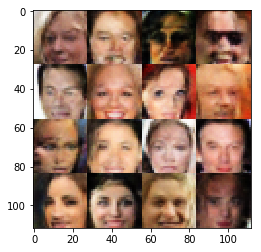

Epoch 10/50... Discriminator Loss: 1.1036... Generator Loss: 1.1408
Epoch 10/50... Discriminator Loss: 1.1998... Generator Loss: 0.6571
Epoch 10/50... Discriminator Loss: 1.0428... Generator Loss: 0.7500
Epoch 10/50... Discriminator Loss: 0.6312... Generator Loss: 1.1381
Epoch 10/50... Discriminator Loss: 0.3606... Generator Loss: 2.1482
Epoch 10/50... Discriminator Loss: 1.7337... Generator Loss: 0.3655
Epoch 10/50... Discriminator Loss: 0.7646... Generator Loss: 0.9941
Epoch 10/50... Discriminator Loss: 0.5665... Generator Loss: 1.2286
Epoch 10/50... Discriminator Loss: 0.5919... Generator Loss: 1.2209
Epoch 10/50... Discriminator Loss: 3.2259... Generator Loss: 0.0916


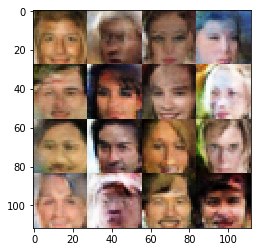

Epoch 10/50... Discriminator Loss: 0.5203... Generator Loss: 1.3485
Epoch 10/50... Discriminator Loss: 0.8979... Generator Loss: 2.8334
Epoch 10/50... Discriminator Loss: 0.4120... Generator Loss: 1.5143
Epoch 10/50... Discriminator Loss: 0.4899... Generator Loss: 1.3722
Epoch 10/50... Discriminator Loss: 1.0796... Generator Loss: 4.4285
Epoch 10/50... Discriminator Loss: 0.8425... Generator Loss: 1.3315
Epoch 10/50... Discriminator Loss: 0.6501... Generator Loss: 2.1714
Epoch 10/50... Discriminator Loss: 0.5770... Generator Loss: 1.2904
Epoch 10/50... Discriminator Loss: 0.6780... Generator Loss: 1.0775
Epoch 10/50... Discriminator Loss: 0.3395... Generator Loss: 2.2733


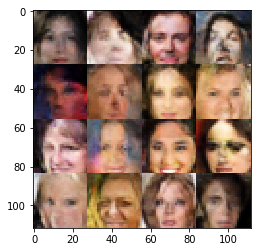

Epoch 10/50... Discriminator Loss: 0.3020... Generator Loss: 2.0165
Epoch 10/50... Discriminator Loss: 0.3566... Generator Loss: 1.9309
Epoch 10/50... Discriminator Loss: 0.0532... Generator Loss: 4.4857
Epoch 10/50... Discriminator Loss: 0.3036... Generator Loss: 2.0907
Epoch 10/50... Discriminator Loss: 0.4422... Generator Loss: 1.4345
Epoch 10/50... Discriminator Loss: 0.1656... Generator Loss: 2.4658
Epoch 10/50... Discriminator Loss: 0.5447... Generator Loss: 1.2815
Epoch 10/50... Discriminator Loss: 0.6644... Generator Loss: 0.9769
Epoch 10/50... Discriminator Loss: 0.4893... Generator Loss: 1.2979
Epoch 10/50... Discriminator Loss: 0.1348... Generator Loss: 2.9151


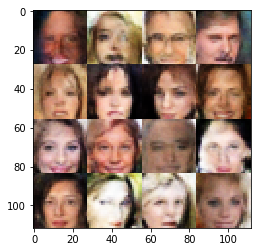

Epoch 10/50... Discriminator Loss: 0.1087... Generator Loss: 3.2016
Epoch 10/50... Discriminator Loss: 0.4688... Generator Loss: 1.3280
Epoch 10/50... Discriminator Loss: 0.5984... Generator Loss: 1.1312
Epoch 10/50... Discriminator Loss: 0.5052... Generator Loss: 1.2684
Epoch 10/50... Discriminator Loss: 0.0849... Generator Loss: 3.5686
Epoch 10/50... Discriminator Loss: 0.2329... Generator Loss: 2.2578


In [ ]:
batch_size = 128
z_dim = 100
learning_rate = 0.0002
beta1 = 0.5


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
epochs = 50

celeba_dataset = helper.Dataset('celeba', glob(os.path.join(data_dir, 'img_align_celeba/*.jpg')))
with tf.Graph().as_default():
    train(epochs, batch_size, z_dim, learning_rate, beta1, celeba_dataset.get_batches,
          celeba_dataset.shape, celeba_dataset.image_mode)

### Submitting This Project
When submitting this project, make sure to run all the cells before saving the notebook. Save the notebook file as "dlnd_face_generation.ipynb" and save it as a HTML file under "File" -> "Download as". Include the "helper.py" and "problem_unittests.py" files in your submission.